In [1]:
import pandas as pd
import numpy as np

from datetime import datetime

%matplotlib inline
pd.set_option('display.max_rows', 500)

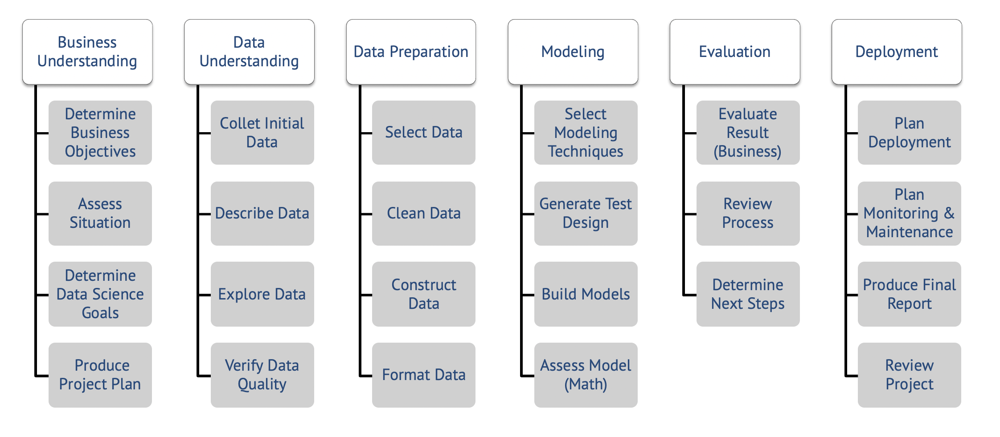

Data Preparation
- focus is always to understand the final data structure
- support each step by visual analytics

In [2]:
datapath = '../data/raw/COVID-19/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
pd_raw = pd.read_csv (datapath)

In [3]:
pd_raw.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,8/26/20,8/27/20,8/28/20,8/29/20,8/30/20,8/31/20,9/1/20,9/2/20,9/3/20,9/4/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,38113,38129,38140,38143,38162,38165,38196,38243,38288,38304
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,8927,9083,9195,9279,9380,9513,9606,9728,9844,9967
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,42619,43016,43403,43781,44146,44494,44833,45158,45469,45773
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,1098,1098,1124,1124,1124,1176,1184,1199,1199,1215
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,2332,2415,2471,2551,2624,2654,2729,2777,2805,2876


In [164]:
pd_raw.columns[4:]

Index(['1/22/20', '1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       '1/28/20', '1/29/20', '1/30/20', '1/31/20',
       ...
       '8/23/20', '8/24/20', '8/25/20', '8/26/20', '8/27/20', '8/28/20',
       '8/29/20', '8/30/20', '8/31/20', '9/1/20'],
      dtype='object', length=224)

In [165]:
time_idx=pd_raw.columns[4:]

In [166]:
df_plot = pd.DataFrame({
    'date':time_idx})
df_plot.head()

,date
0,1/22/20
1,1/23/20
2,1/24/20
3,1/25/20
4,1/26/20


In [167]:
pd_raw['Country/Region']

0                           Afghanistan
1                               Albania
2                               Algeria
3                               Andorra
4                                Angola
5                   Antigua and Barbuda
6                             Argentina
7                               Armenia
8                             Australia
9                             Australia
10                            Australia
11                            Australia
12                            Australia
13                            Australia
14                            Australia
15                            Australia
16                              Austria
17                           Azerbaijan
18                              Bahamas
19                              Bahrain
20                           Bangladesh
21                             Barbados
22                              Belarus
23                              Belgium
24                               Belize


In [168]:
pd_raw[pd_raw['Country/Region']=='Germany'].iloc[:,4::].sum(axis=0)[0:4]

1/22/20    0
1/23/20    0
1/24/20    0
1/25/20    0
dtype: int64

In [169]:
country_list=['Italy',
              'US',
              'Spain',
              'Germany',
              'Korea, South',
             ]

In [170]:
for each in country_list:
    df_plot[each]=np.array(pd_raw[pd_raw['Country/Region']==each].iloc[:,4::].sum(axis=0))

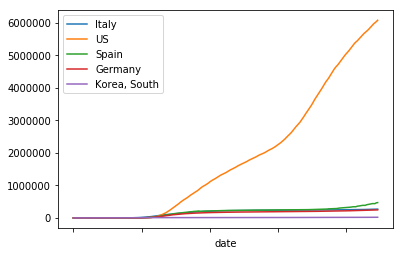

In [171]:
%matplotlib inline
df_plot.set_index('date').plot()

Data Type Date

In [172]:
df_plot.head()

,date,Italy,US,Spain,Germany,"Korea, South"
0,1/22/20,0,1,0,0,1
1,1/23/20,0,1,0,0,1
2,1/24/20,0,2,0,0,2
3,1/25/20,0,2,0,0,2
4,1/26/20,0,5,0,0,3


In [173]:
time_idx=[datetime.strptime( each,"%m/%d/%y") for each in df_plot.date] # convert to datetime
time_str=[each.strftime('%Y-%m-%d') for each in time_idx] # convert back to date ISO norm (str)

In [174]:
df_plot['date']=time_idx
type(df_plot['date'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [175]:
df_plot.head()

,date,Italy,US,Spain,Germany,"Korea, South"
0,2020-01-22,0,1,0,0,1
1,2020-01-23,0,1,0,0,1
2,2020-01-24,0,2,0,0,2
3,2020-01-25,0,2,0,0,2
4,2020-01-26,0,5,0,0,3


In [176]:
df_plot.to_csv('../data/processed/COVID_small_flat_table.csv',sep=';',index=False)

In [177]:
# updating the large relational file

Relational data model - defining a primary key

In the relational model of databases, a primary key is a specific choice of a minimal set of attributes (columns) that uniquely specify a tuple (row) in a relation (table) (source: wiki)

A primary key’s main features are:

- It must contain a unique value for each row of data.
- It cannot contain null values.

In [178]:
data_path='../data/raw/COVID-19/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
pd_raw=pd.read_csv(data_path)
pd_raw.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,8/23/20,8/24/20,8/25/20,8/26/20,8/27/20,8/28/20,8/29/20,8/30/20,8/31/20,9/1/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,37999,38054,38070,38113,38129,38140,38143,38162,38165,38196
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,8427,8605,8759,8927,9083,9195,9279,9380,9513,9606
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,41460,41858,42228,42619,43016,43403,43781,44146,44494,44833
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,1045,1060,1060,1098,1098,1124,1124,1124,1176,1184
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,2171,2222,2283,2332,2415,2471,2551,2624,2654,2729


In [179]:
pd_data_base=pd_raw.rename(columns={'Country/Region':'country',
                      'Province/State':'state'})
pd_data_base['state']=pd_data_base['state'].fillna('no')  #ensure a string, important for indexing

In [180]:
pd_data_base=pd_data_base.drop(['Lat','Long'],axis=1)
pd_data_base.head()

,state,country,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,8/23/20,8/24/20,8/25/20,8/26/20,8/27/20,8/28/20,8/29/20,8/30/20,8/31/20,9/1/20
0,no,Afghanistan,0,0,0,0,0,0,0,0,...,37999,38054,38070,38113,38129,38140,38143,38162,38165,38196
1,no,Albania,0,0,0,0,0,0,0,0,...,8427,8605,8759,8927,9083,9195,9279,9380,9513,9606
2,no,Algeria,0,0,0,0,0,0,0,0,...,41460,41858,42228,42619,43016,43403,43781,44146,44494,44833
3,no,Andorra,0,0,0,0,0,0,0,0,...,1045,1060,1060,1098,1098,1124,1124,1124,1176,1184
4,no,Angola,0,0,0,0,0,0,0,0,...,2171,2222,2283,2332,2415,2471,2551,2624,2654,2729


In [181]:
test_pd=pd_data_base.set_index(['state','country']).T

In [182]:
test_pd.columns

MultiIndex(levels=[['Alberta', 'Anguilla', 'Anhui', 'Aruba', 'Australian Capital Territory', 'Beijing', 'Bermuda', 'Bonaire, Sint Eustatius and Saba', 'British Columbia', 'British Virgin Islands', 'Cayman Islands', 'Channel Islands', 'Chongqing', 'Curacao', 'Diamond Princess', 'Falkland Islands (Malvinas)', 'Faroe Islands', 'French Guiana', 'French Polynesia', 'Fujian', 'Gansu', 'Gibraltar', 'Grand Princess', 'Greenland', 'Guadeloupe', 'Guangdong', 'Guangxi', 'Guizhou', 'Hainan', 'Hebei', 'Heilongjiang', 'Henan', 'Hong Kong', 'Hubei', 'Hunan', 'Inner Mongolia', 'Isle of Man', 'Jiangsu', 'Jiangxi', 'Jilin', 'Liaoning', 'Macau', 'Manitoba', 'Martinique', 'Mayotte', 'Montserrat', 'New Brunswick', 'New Caledonia', 'New South Wales', 'Newfoundland and Labrador', 'Ningxia', 'Northern Territory', 'Northwest Territories', 'Nova Scotia', 'Ontario', 'Prince Edward Island', 'Qinghai', 'Quebec', 'Queensland', 'Reunion', 'Saint Barthelemy', 'Saint Pierre and Miquelon', 'Saskatchewan', 'Shaanxi', 'S

In [183]:
test_pd.stack(level=[0,1]).reset_index()

,level_0,state,country,0
0,1/22/20,Alberta,Canada,0.0
1,1/22/20,Anguilla,United Kingdom,0.0
2,1/22/20,Anhui,China,1.0
3,1/22/20,Aruba,Netherlands,0.0
4,1/22/20,Australian Capital Territory,Australia,0.0
5,1/22/20,Beijing,China,14.0
6,1/22/20,Bermuda,United Kingdom,0.0
7,1/22/20,"Bonaire, Sint Eustatius and Saba",Netherlands,0.0
8,1/22/20,British Columbia,Canada,0.0
9,1/22/20,British Virgin Islands,United Kingdom,0.0


In [184]:
df_plot.to_csv('../data/processed/COVID_relational_confirmed.csv',sep=';')

In [185]:
pd_relational_model=pd_data_base.set_index(['state','country']) \
                                .T                              \
                                .stack(level=[0,1])             \
                                .reset_index()                  \
                                .rename(columns={'level_0':'date',
                                                   0:'confirmed'},
                                                  )
pd_relational_model.head()

,date,state,country,confirmed
0,1/22/20,Alberta,Canada,0.0
1,1/22/20,Anguilla,United Kingdom,0.0
2,1/22/20,Anhui,China,1.0
3,1/22/20,Aruba,Netherlands,0.0
4,1/22/20,Australian Capital Territory,Australia,0.0


In [186]:
pd_relational_model.dtypes

date          object
state         object
country       object
confirmed    float64
dtype: object

In [187]:
pd_relational_model['date']=pd_relational_model.date.astype('datetime64[ns]')

In [188]:
pd_relational_model.dtypes

date         datetime64[ns]
state                object
country              object
confirmed           float64
dtype: object

In [189]:
pd_relational_model.confirmed=pd_relational_model.confirmed.astype(int)

pd_relational_model.to_csv('../data/processed/COVID_relational_confirmed.csv',sep=';',index=False)

In [190]:
print(pd_relational_model[pd_relational_model['country']=='US'].tail())

            date state country  confirmed
58506 2020-08-28    no      US    5913941
58772 2020-08-29    no      US    5961094
59038 2020-08-30    no      US    5996431
59304 2020-08-31    no      US    6030587
59570 2020-09-01    no      US    6073840


# Groupby apply on large (relational) data set

In [191]:
pd_JH_data=pd.read_csv('../data/processed/COVID_relational_confirmed.csv',sep=';',parse_dates=[0])
pd_JH_data=pd_JH_data.sort_values('date',ascending=True).reset_index(drop=True).copy()
pd_JH_data.head()

,date,state,country,confirmed
0,2020-01-22,Alberta,Canada,0
1,2020-01-22,no,"Korea, South",1
2,2020-01-22,no,Kosovo,0
3,2020-01-22,no,Kuwait,0
4,2020-01-22,no,Kyrgyzstan,0


# Test data

In [192]:
test_data = pd_JH_data[((pd_JH_data['country']=='US')|
                      (pd_JH_data['country']=='Germany'))&
                     (pd_JH_data['date']>'2020-03-20')]

In [193]:
test_data

,date,state,country,confirmed
15737,2020-03-21,no,Germany,22213
15777,2020-03-21,no,US,24508
16001,2020-03-22,no,Germany,24873
16041,2020-03-22,no,US,33152
16268,2020-03-23,no,Germany,29056
16309,2020-03-23,no,US,43850
16534,2020-03-24,no,Germany,32986
16589,2020-03-24,no,US,54112
16800,2020-03-25,no,Germany,37323
16840,2020-03-25,no,US,66055


In [194]:
test_data.groupby(['country']).agg(np.max)

,date,state,confirmed
country,,,
Germany,2020-09-01,no,246015
US,2020-09-01,no,6073840


In [203]:
# %load ../src/features/build_features.py

import numpy as np
from sklearn import linear_model
reg = linear_model.LinearRegression(fit_intercept=True)
import pandas as pd

from scipy import signal


def get_doubling_time_via_regression(in_array):
    ''' Use a linear regression to approximate the doubling rate
        Parameters:
        ----------
        in_array : pandas.series
        Returns:
        ----------
        Doubling rate: double
    '''
    print(in_array)
    print(type(in_array))
    y = np.array(in_array)
    X = np.arange(-1,2).reshape(-1, 1)

    assert len(in_array)==3
    reg.fit(X,y)
    intercept=reg.intercept_
    slope=reg.coef_

    return intercept/slope


def savgol_filter(df_input,column='confirmed',window=5):
    ''' Savgol Filter which can be used in groupby apply function (data structure kept)
        parameters:
        ----------
        df_input : pandas.series
        column : str
        window : int
            used data points to calculate the filter result
        Returns:
        ----------
        df_result: pd.DataFrame
            the index of the df_input has to be preserved in result
    '''

    degree=1
    df_result=df_input

    filter_in=df_input[column].fillna(0) # attention with the neutral element here

    result=signal.savgol_filter(np.array(filter_in),
                           window, # window size used for filtering
                           1)
    df_result[str(column+'_filtered')]=result
    return df_result

def rolling_reg(df_input,col='confirmed'):
    ''' Rolling Regression to approximate the doubling time'
        Parameters:
        ----------
        df_input: pd.DataFrame
        col: str
            defines the used column
        Returns:
        ----------
        result: pd.DataFrame
    '''
    days_back=3
    result=df_input[col].rolling(
                window=days_back,
                min_periods=days_back).apply(get_doubling_time_via_regression,raw=False)



    return result




def calc_filtered_data(df_input,filter_on='confirmed'):
    '''  Calculate savgol filter and return merged data frame
        Parameters:
        ----------
        df_input: pd.DataFrame
        filter_on: str
            defines the used column
        Returns:
        ----------
        df_output: pd.DataFrame
            the result will be joined as a new column on the input data frame
    '''

    must_contain=set(['state','country',filter_on])
    assert must_contain.issubset(set(df_input.columns)), ' Erro in calc_filtered_data not all columns in data frame'

    df_output=df_input.copy() # we need a copy here otherwise the filter_on column will be overwritten

    pd_filtered_result=df_output[['state','country',filter_on]].groupby(['state','country']).apply(savgol_filter)#.reset_index()

    #print('--+++ after group by apply')
    #print(pd_filtered_result[pd_filtered_result['country']=='Germany'].tail())

    #df_output=pd.merge(df_output,pd_filtered_result[['index',str(filter_on+'_filtered')]],on=['index'],how='left')
    df_output=pd.merge(df_output,pd_filtered_result[[str(filter_on+'_filtered')]],left_index=True,right_index=True,how='left')
    #print(df_output[df_output['country']=='Germany'].tail())
    return df_output.copy()





def calc_doubling_rate(df_input,filter_on='confirmed'):
    ''' Calculate approximated doubling rate and return merged data frame
        Parameters:
        ----------
        df_input: pd.DataFrame
        filter_on: str
            defines the used column
        Returns:
        ----------
        df_output: pd.DataFrame
            the result will be joined as a new column on the input data frame
    '''

    must_contain=set(['state','country',filter_on])
    assert must_contain.issubset(set(df_input.columns)), ' Erro in calc_filtered_data not all columns in data frame'


    pd_DR_result= df_input.groupby(['state','country']).apply(rolling_reg,filter_on).reset_index()

    pd_DR_result=pd_DR_result.rename(columns={filter_on:filter_on+'_DR',
                             'level_2':'index'})

    #we do the merge on the index of our big table and on the index column after groupby
    df_output=pd.merge(df_input,pd_DR_result[['index',str(filter_on+'_DR')]],left_index=True,right_on=['index'],how='left')
    df_output=df_output.drop(columns=['index'])


    return df_output


if __name__ == '__main__':
    test_data_reg=np.array([2,4,6])
    result=get_doubling_time_via_regression(test_data_reg)
    print('the test slope is: '+str(result))

    pd_JH_data=pd.read_csv('../data/processed/COVID_relational_confirmed.csv',sep=';',parse_dates=[0])
    pd_JH_data=pd_JH_data.sort_values('date',ascending=True).copy()

    #test_structure=pd_JH_data[((pd_JH_data['country']=='US')|
    #                  (pd_JH_data['country']=='Germany'))]

    pd_result_larg=calc_filtered_data(pd_JH_data)
    pd_result_larg=calc_doubling_rate(pd_result_larg)
    pd_result_larg=calc_doubling_rate(pd_result_larg,'confirmed_filtered')


    mask=pd_result_larg['confirmed']>100
    pd_result_larg['confirmed_filtered_DR']=pd_result_larg['confirmed_filtered_DR'].where(mask, other=np.NaN)
    pd_result_larg.to_csv('../data/processed/COVID_final_set.csv',sep=';',index=False)
    print(pd_result_larg[pd_result_larg['country']=='Germany'].tail())


[2 4 6]
<class 'numpy.ndarray'>
the test slope is: [2.]


C:\Users\ADMIN\Anaconda3\lib\site-packages\scipy\signal\_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


0      0.0
266    0.0
532    0.0
dtype: float64
<class 'pandas.core.series.Series'>
266    0.0
532    0.0
798    0.0
dtype: float64
<class 'pandas.core.series.Series'>
532     0.0
798     0.0
1064    0.0
dtype: float64
<class 'pandas.core.series.Series'>
798     0.0
1064    0.0
1330    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1064    0.0
1330    0.0
1596    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1330    0.0
1596    0.0
1862    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1596    0.0
1862    0.0
2128    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1862    0.0
2128    0.0
2394    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2128    0.0
2394    0.0
2660    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2394    0.0
2660    0.0
2926    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2660    0.0
2926    0.0
3192    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2926    0.0
3192    0.0
3458    0.0
dtype: float6

52668    11430.0
52934    11430.0
53200    11430.0
dtype: float64
<class 'pandas.core.series.Series'>
52934    11430.0
53200    11430.0
53466    11687.0
dtype: float64
<class 'pandas.core.series.Series'>
53200    11430.0
53466    11687.0
53732    11772.0
dtype: float64
<class 'pandas.core.series.Series'>
53466    11687.0
53732    11772.0
53998    11893.0
dtype: float64
<class 'pandas.core.series.Series'>
53732    11772.0
53998    11893.0
54264    11969.0
dtype: float64
<class 'pandas.core.series.Series'>
53998    11893.0
54264    11969.0
54530    12053.0
dtype: float64
<class 'pandas.core.series.Series'>
54264    11969.0
54530    12053.0
54796    12053.0
dtype: float64
<class 'pandas.core.series.Series'>
54530    12053.0
54796    12053.0
55062    12053.0
dtype: float64
<class 'pandas.core.series.Series'>
54796    12053.0
55062    12053.0
55328    12053.0
dtype: float64
<class 'pandas.core.series.Series'>
55062    12053.0
55328    12053.0
55594    12419.0
dtype: float64
<class 'pandas.c

dtype: float64
<class 'pandas.core.series.Series'>
47082    9219.0
47348    9219.0
47614    9219.0
dtype: float64
<class 'pandas.core.series.Series'>
47348    9219.0
47614    9219.0
47880    9587.0
dtype: float64
<class 'pandas.core.series.Series'>
47614    9219.0
47880    9587.0
48146    9728.0
dtype: float64
<class 'pandas.core.series.Series'>
47880    9587.0
48146    9728.0
48412    9728.0
dtype: float64
<class 'pandas.core.series.Series'>
48146    9728.0
48412    9728.0
48678    9975.0
dtype: float64
<class 'pandas.core.series.Series'>
48412     9728.0
48678     9975.0
48944    10086.0
dtype: float64
<class 'pandas.core.series.Series'>
48678     9975.0
48944    10086.0
49210    10086.0
dtype: float64
<class 'pandas.core.series.Series'>
48944    10086.0
49210    10086.0
49476    10086.0
dtype: float64
<class 'pandas.core.series.Series'>
49210    10086.0
49476    10086.0
49742    10390.0
dtype: float64
<class 'pandas.core.series.Series'>
49476    10086.0
49742    10390.0
50008    104

<class 'pandas.core.series.Series'>
30325    3.0
30591    3.0
30857    3.0
dtype: float64
<class 'pandas.core.series.Series'>
30591    3.0
30857    3.0
31123    3.0
dtype: float64
<class 'pandas.core.series.Series'>
30857    3.0
31123    3.0
31389    3.0
dtype: float64
<class 'pandas.core.series.Series'>
31123    3.0
31389    3.0
31655    3.0
dtype: float64
<class 'pandas.core.series.Series'>
31389    3.0
31655    3.0
31921    3.0
dtype: float64
<class 'pandas.core.series.Series'>
31655    3.0
31921    3.0
32187    3.0
dtype: float64
<class 'pandas.core.series.Series'>
31921    3.0
32187    3.0
32453    3.0
dtype: float64
<class 'pandas.core.series.Series'>
32187    3.0
32453    3.0
32719    3.0
dtype: float64
<class 'pandas.core.series.Series'>
32453    3.0
32719    3.0
32985    3.0
dtype: float64
<class 'pandas.core.series.Series'>
32719    3.0
32985    3.0
33251    3.0
dtype: float64
<class 'pandas.core.series.Series'>
32985    3.0
33251    3.0
33517    3.0
dtype: float64
<class 'pa

24474    991.0
24740    991.0
25006    991.0
dtype: float64
<class 'pandas.core.series.Series'>
24740    991.0
25006    991.0
25272    991.0
dtype: float64
<class 'pandas.core.series.Series'>
25006    991.0
25272    991.0
25538    991.0
dtype: float64
<class 'pandas.core.series.Series'>
25272    991.0
25538    991.0
25804    991.0
dtype: float64
<class 'pandas.core.series.Series'>
25538    991.0
25804    991.0
26070    991.0
dtype: float64
<class 'pandas.core.series.Series'>
25804    991.0
26070    991.0
26336    991.0
dtype: float64
<class 'pandas.core.series.Series'>
26070    991.0
26336    991.0
26602    991.0
dtype: float64
<class 'pandas.core.series.Series'>
26336    991.0
26602    991.0
26868    991.0
dtype: float64
<class 'pandas.core.series.Series'>
26602    991.0
26868    991.0
27134    991.0
dtype: float64
<class 'pandas.core.series.Series'>
26868    991.0
27134    991.0
27400    991.0
dtype: float64
<class 'pandas.core.series.Series'>
27134    991.0
27400    991.0
27666    9

dtype: float64
<class 'pandas.core.series.Series'>
11175    0.0
11441    0.0
11707    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11441    0.0
11707    0.0
11973    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11707    0.0
11973    0.0
12239    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11973    0.0
12239    0.0
12505    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12239    0.0
12505    0.0
12771    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12505    0.0
12771    0.0
13037    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12771    0.0
13037    0.0
13303    0.0
dtype: float64
<class 'pandas.core.series.Series'>
13037    0.0
13303    0.0
13569    2.0
dtype: float64
<class 'pandas.core.series.Series'>
13303    0.0
13569    2.0
13835    2.0
dtype: float64
<class 'pandas.core.series.Series'>
13569    2.0
13835    2.0
14101    2.0
dtype: float64
<class 'pandas.core.series.Series'>
13835    2.0
14101    2.0
14367    2.0
dtype: flo

1334    0.0
1600    0.0
1866    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1600    0.0
1866    0.0
2132    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1866    0.0
2132    0.0
2398    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2132    0.0
2398    0.0
2664    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2398    0.0
2664    0.0
2930    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2664    0.0
2930    0.0
3196    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2930    0.0
3196    0.0
3462    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3196    0.0
3462    0.0
3728    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3462    0.0
3728    0.0
3994    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3728    0.0
3994    0.0
4260    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3994    0.0
4260    0.0
4526    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4260    0.0
4526    0.0
4792    0.0
dtype: 

<class 'pandas.core.series.Series'>
52406    113.0
52672    113.0
52938    113.0
dtype: float64
<class 'pandas.core.series.Series'>
52672    113.0
52938    113.0
53204    113.0
dtype: float64
<class 'pandas.core.series.Series'>
52938    113.0
53204    113.0
53470    113.0
dtype: float64
<class 'pandas.core.series.Series'>
53204    113.0
53470    113.0
53736    113.0
dtype: float64
<class 'pandas.core.series.Series'>
53470    113.0
53736    113.0
54002    113.0
dtype: float64
<class 'pandas.core.series.Series'>
53736    113.0
54002    113.0
54268    113.0
dtype: float64
<class 'pandas.core.series.Series'>
54002    113.0
54268    113.0
54534    113.0
dtype: float64
<class 'pandas.core.series.Series'>
54268    113.0
54534    113.0
54800    113.0
dtype: float64
<class 'pandas.core.series.Series'>
54534    113.0
54800    113.0
55066    113.0
dtype: float64
<class 'pandas.core.series.Series'>
54800    113.0
55066    113.0
55332    113.0
dtype: float64
<class 'pandas.core.series.Series'>
5506

dtype: float64
<class 'pandas.core.series.Series'>
51875    934.0
52141    934.0
52407    935.0
dtype: float64
<class 'pandas.core.series.Series'>
52141    934.0
52407    935.0
52673    935.0
dtype: float64
<class 'pandas.core.series.Series'>
52407    935.0
52673    935.0
52939    935.0
dtype: float64
<class 'pandas.core.series.Series'>
52673    935.0
52939    935.0
53205    935.0
dtype: float64
<class 'pandas.core.series.Series'>
52939    935.0
53205    935.0
53471    935.0
dtype: float64
<class 'pandas.core.series.Series'>
53205    935.0
53471    935.0
53737    935.0
dtype: float64
<class 'pandas.core.series.Series'>
53471    935.0
53737    935.0
54003    935.0
dtype: float64
<class 'pandas.core.series.Series'>
53737    935.0
54003    935.0
54269    935.0
dtype: float64
<class 'pandas.core.series.Series'>
54003    935.0
54269    935.0
54535    935.0
dtype: float64
<class 'pandas.core.series.Series'>
54269    935.0
54535    935.0
54801    935.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
43098    146.0
43364    146.0
43630    146.0
dtype: float64
<class 'pandas.core.series.Series'>
43364    146.0
43630    146.0
43896    146.0
dtype: float64
<class 'pandas.core.series.Series'>
43630    146.0
43896    146.0
44162    146.0
dtype: float64
<class 'pandas.core.series.Series'>
43896    146.0
44162    146.0
44428    148.0
dtype: float64
<class 'pandas.core.series.Series'>
44162    146.0
44428    148.0
44694    149.0
dtype: float64
<class 'pandas.core.series.Series'>
44428    148.0
44694    149.0
44960    149.0
dtype: float64
<class 'pandas.core.series.Series'>
44694    149.0
44960    149.0
45226    150.0
dtype: float64
<class 'pandas.core.series.Series'>
44960    149.0
45226    150.0
45492    150.0
dtype: float64
<class 'pandas.core.series.Series'>
45226    150.0
45492    150.0
45758    150.0
dtype: float64
<class 'pandas.core.series.Series'>
45492    150.0
45758    150.0
46024    150.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
54271    13.0
54537    13.0
54803    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54537    13.0
54803    13.0
55069    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54803    13.0
55069    13.0
55335    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55069    13.0
55335    13.0
55601    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55335    13.0
55601    13.0
55867    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55601    13.0
55867    13.0
56133    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55867    13.0
56133    13.0
56399    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56133    13.0
56399    13.0
56665    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56399    13.0
56665    13.0
56931    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56665    13.0
56931    13.0
57197    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56931    13.0
57197

dtype: float64
<class 'pandas.core.series.Series'>
43632    2947.0
43898    2947.0
44164    2978.0
dtype: float64
<class 'pandas.core.series.Series'>
43898    2947.0
44164    2978.0
44430    2990.0
dtype: float64
<class 'pandas.core.series.Series'>
44164    2978.0
44430    2990.0
44696    3008.0
dtype: float64
<class 'pandas.core.series.Series'>
44430    2990.0
44696    3008.0
44962    3028.0
dtype: float64
<class 'pandas.core.series.Series'>
44696    3008.0
44962    3028.0
45228    3053.0
dtype: float64
<class 'pandas.core.series.Series'>
44962    3028.0
45228    3053.0
45494    3053.0
dtype: float64
<class 'pandas.core.series.Series'>
45228    3053.0
45494    3053.0
45760    3053.0
dtype: float64
<class 'pandas.core.series.Series'>
45494    3053.0
45760    3053.0
46026    3053.0
dtype: float64
<class 'pandas.core.series.Series'>
45760    3053.0
46026    3053.0
46292    3128.0
dtype: float64
<class 'pandas.core.series.Series'>
46026    3053.0
46292    3128.0
46558    3149.0
dtype: flo

38845    8.0
39111    8.0
39377    8.0
dtype: float64
<class 'pandas.core.series.Series'>
39111    8.0
39377    8.0
39643    8.0
dtype: float64
<class 'pandas.core.series.Series'>
39377    8.0
39643    8.0
39909    8.0
dtype: float64
<class 'pandas.core.series.Series'>
39643    8.0
39909    8.0
40175    8.0
dtype: float64
<class 'pandas.core.series.Series'>
39909    8.0
40175    8.0
40441    8.0
dtype: float64
<class 'pandas.core.series.Series'>
40175    8.0
40441    8.0
40707    8.0
dtype: float64
<class 'pandas.core.series.Series'>
40441    8.0
40707    8.0
40973    8.0
dtype: float64
<class 'pandas.core.series.Series'>
40707    8.0
40973    8.0
41239    8.0
dtype: float64
<class 'pandas.core.series.Series'>
40973    8.0
41239    8.0
41505    8.0
dtype: float64
<class 'pandas.core.series.Series'>
41239    8.0
41505    8.0
41771    8.0
dtype: float64
<class 'pandas.core.series.Series'>
41505    8.0
41771    8.0
42037    8.0
dtype: float64
<class 'pandas.core.series.Series'>
41771    8

dtype: float64
<class 'pandas.core.series.Series'>
30334    94.0
30600    94.0
30866    94.0
dtype: float64
<class 'pandas.core.series.Series'>
30600    94.0
30866    94.0
31132    94.0
dtype: float64
<class 'pandas.core.series.Series'>
30866     94.0
31132     94.0
31398    111.0
dtype: float64
<class 'pandas.core.series.Series'>
31132     94.0
31398    111.0
31664    111.0
dtype: float64
<class 'pandas.core.series.Series'>
31398    111.0
31664    111.0
31930    121.0
dtype: float64
<class 'pandas.core.series.Series'>
31664    111.0
31930    121.0
32196    129.0
dtype: float64
<class 'pandas.core.series.Series'>
31930    121.0
32196    129.0
32462    129.0
dtype: float64
<class 'pandas.core.series.Series'>
32196    129.0
32462    129.0
32728    129.0
dtype: float64
<class 'pandas.core.series.Series'>
32462    129.0
32728    129.0
32994    134.0
dtype: float64
<class 'pandas.core.series.Series'>
32728    129.0
32994    134.0
33260    137.0
dtype: float64
<class 'pandas.core.series.Seri

dtype: float64
<class 'pandas.core.series.Series'>
32729    558.0
32995    559.0
33261    559.0
dtype: float64
<class 'pandas.core.series.Series'>
32995    559.0
33261    559.0
33527    560.0
dtype: float64
<class 'pandas.core.series.Series'>
33261    559.0
33527    560.0
33793    560.0
dtype: float64
<class 'pandas.core.series.Series'>
33527    560.0
33793    560.0
34059    560.0
dtype: float64
<class 'pandas.core.series.Series'>
33793    560.0
34059    560.0
34325    560.0
dtype: float64
<class 'pandas.core.series.Series'>
34059    560.0
34325    560.0
34591    560.0
dtype: float64
<class 'pandas.core.series.Series'>
34325    560.0
34591    560.0
34857    560.0
dtype: float64
<class 'pandas.core.series.Series'>
34591    560.0
34857    560.0
35123    560.0
dtype: float64
<class 'pandas.core.series.Series'>
34857    560.0
35123    560.0
35389    561.0
dtype: float64
<class 'pandas.core.series.Series'>
35123    560.0
35389    561.0
35655    561.0
dtype: float64
<class 'pandas.core.serie

24218    579.0
24484    579.0
24750    579.0
dtype: float64
<class 'pandas.core.series.Series'>
24484    579.0
24750    579.0
25016    579.0
dtype: float64
<class 'pandas.core.series.Series'>
24750    579.0
25016    579.0
25282    579.0
dtype: float64
<class 'pandas.core.series.Series'>
25016    579.0
25282    579.0
25548    579.0
dtype: float64
<class 'pandas.core.series.Series'>
25282    579.0
25548    579.0
25814    579.0
dtype: float64
<class 'pandas.core.series.Series'>
25548    579.0
25814    579.0
26080    579.0
dtype: float64
<class 'pandas.core.series.Series'>
25814    579.0
26080    579.0
26346    579.0
dtype: float64
<class 'pandas.core.series.Series'>
26080    579.0
26346    579.0
26612    579.0
dtype: float64
<class 'pandas.core.series.Series'>
26346    579.0
26612    579.0
26878    579.0
dtype: float64
<class 'pandas.core.series.Series'>
26612    579.0
26878    579.0
27144    579.0
dtype: float64
<class 'pandas.core.series.Series'>
26878    579.0
27144    579.0
27410    5

dtype: float64
<class 'pandas.core.series.Series'>
20229    13.0
20495    14.0
20761    14.0
dtype: float64
<class 'pandas.core.series.Series'>
20495    14.0
20761    14.0
21027    14.0
dtype: float64
<class 'pandas.core.series.Series'>
20761    14.0
21027    14.0
21293    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21027    14.0
21293    14.0
21559    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21293    14.0
21559    14.0
21825    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21559    14.0
21825    14.0
22091    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21825    14.0
22091    14.0
22357    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22091    14.0
22357    14.0
22623    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22357    14.0
22623    14.0
22889    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22623    14.0
22889    14.0
23155    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22889    14.0
23155

dtype: float64
<class 'pandas.core.series.Series'>
15442    0.0
15708    0.0
15974    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15708    0.0
15974    0.0
16240    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15974    0.0
16240    0.0
16506    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16240    0.0
16506    0.0
16772    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16506    0.0
16772    0.0
17038    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16772    0.0
17038    0.0
17304    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17038    0.0
17304    0.0
17570    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17304    0.0
17570    0.0
17836    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17570    0.0
17836    0.0
18102    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17836    0.0
18102    0.0
18368    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18102    0.0
18368    0.0
18634    0.0
dtype: flo

14379    0.0
14645    0.0
14911    0.0
dtype: float64
<class 'pandas.core.series.Series'>
14645    0.0
14911    0.0
15177    0.0
dtype: float64
<class 'pandas.core.series.Series'>
14911    0.0
15177    0.0
15443    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15177    0.0
15443    0.0
15709    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15443    0.0
15709    0.0
15975    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15709    0.0
15975    0.0
16241    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15975    0.0
16241    0.0
16507    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16241    0.0
16507    0.0
16773    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16507    0.0
16773    0.0
17039    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16773    0.0
17039    0.0
17305    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17039    0.0
17305    0.0
17571    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17305    0

<class 'pandas.core.series.Series'>
7996    0.0
8262    0.0
8528    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8262    0.0
8528    0.0
8794    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8528    0.0
8794    0.0
9060    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8794    0.0
9060    0.0
9326    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9060    0.0
9326    0.0
9592    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9326    0.0
9592    0.0
9858    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9592     0.0
9858     0.0
10124    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9858     0.0
10124    0.0
10390    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10124    0.0
10390    0.0
10656    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10390    0.0
10656    0.0
10922    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10656    0.0
10922    0.0
11188    1.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
15445    15.0
15711    18.0
15977    18.0
dtype: float64
<class 'pandas.core.series.Series'>
15711    18.0
15977    18.0
16243    20.0
dtype: float64
<class 'pandas.core.series.Series'>
15977    18.0
16243    20.0
16509    23.0
dtype: float64
<class 'pandas.core.series.Series'>
16243    20.0
16509    23.0
16775    28.0
dtype: float64
<class 'pandas.core.series.Series'>
16509    23.0
16775    28.0
17041    28.0
dtype: float64
<class 'pandas.core.series.Series'>
16775    28.0
17041    28.0
17307    28.0
dtype: float64
<class 'pandas.core.series.Series'>
17041    28.0
17307    28.0
17573    28.0
dtype: float64
<class 'pandas.core.series.Series'>
17307    28.0
17573    28.0
17839    28.0
dtype: float64
<class 'pandas.core.series.Series'>
17573    28.0
17839    28.0
18105    43.0
dtype: float64
<class 'pandas.core.series.Series'>
17839    28.0
18105    43.0
18371    43.0
dtype: float64
<class 'pandas.core.series.Series'>
18105    43.0
18371    43.0
18637 

dtype: float64
<class 'pandas.core.series.Series'>
22894    55.0
23160    55.0
23426    55.0
dtype: float64
<class 'pandas.core.series.Series'>
23160    55.0
23426    55.0
23692    56.0
dtype: float64
<class 'pandas.core.series.Series'>
23426    55.0
23692    56.0
23958    56.0
dtype: float64
<class 'pandas.core.series.Series'>
23692    56.0
23958    56.0
24224    57.0
dtype: float64
<class 'pandas.core.series.Series'>
23958    56.0
24224    57.0
24490    57.0
dtype: float64
<class 'pandas.core.series.Series'>
24224    57.0
24490    57.0
24756    57.0
dtype: float64
<class 'pandas.core.series.Series'>
24490    57.0
24756    57.0
25022    57.0
dtype: float64
<class 'pandas.core.series.Series'>
24756    57.0
25022    57.0
25288    57.0
dtype: float64
<class 'pandas.core.series.Series'>
25022    57.0
25288    57.0
25554    57.0
dtype: float64
<class 'pandas.core.series.Series'>
25288    57.0
25554    57.0
25820    58.0
dtype: float64
<class 'pandas.core.series.Series'>
25554    57.0
25820

22629    353.0
22895    354.0
23161    355.0
dtype: float64
<class 'pandas.core.series.Series'>
22895    354.0
23161    355.0
23427    355.0
dtype: float64
<class 'pandas.core.series.Series'>
23161    355.0
23427    355.0
23693    355.0
dtype: float64
<class 'pandas.core.series.Series'>
23427    355.0
23693    355.0
23959    355.0
dtype: float64
<class 'pandas.core.series.Series'>
23693    355.0
23959    355.0
24225    355.0
dtype: float64
<class 'pandas.core.series.Series'>
23959    355.0
24225    355.0
24491    355.0
dtype: float64
<class 'pandas.core.series.Series'>
24225    355.0
24491    355.0
24757    355.0
dtype: float64
<class 'pandas.core.series.Series'>
24491    355.0
24757    355.0
25023    355.0
dtype: float64
<class 'pandas.core.series.Series'>
24757    355.0
25023    355.0
25289    355.0
dtype: float64
<class 'pandas.core.series.Series'>
25023    355.0
25289    355.0
25555    355.0
dtype: float64
<class 'pandas.core.series.Series'>
25289    355.0
25555    355.0
25821    3

18640    138.0
18906    138.0
19172    138.0
dtype: float64
<class 'pandas.core.series.Series'>
18906    138.0
19172    138.0
19438    138.0
dtype: float64
<class 'pandas.core.series.Series'>
19172    138.0
19438    138.0
19704    138.0
dtype: float64
<class 'pandas.core.series.Series'>
19438    138.0
19704    138.0
19970    139.0
dtype: float64
<class 'pandas.core.series.Series'>
19704    138.0
19970    139.0
20236    139.0
dtype: float64
<class 'pandas.core.series.Series'>
19970    139.0
20236    139.0
20502    139.0
dtype: float64
<class 'pandas.core.series.Series'>
20236    139.0
20502    139.0
20768    139.0
dtype: float64
<class 'pandas.core.series.Series'>
20502    139.0
20768    139.0
21034    139.0
dtype: float64
<class 'pandas.core.series.Series'>
20768    139.0
21034    139.0
21300    139.0
dtype: float64
<class 'pandas.core.series.Series'>
21034    139.0
21300    139.0
21566    139.0
dtype: float64
<class 'pandas.core.series.Series'>
21300    139.0
21566    139.0
21832    1

dtype: float64
<class 'pandas.core.series.Series'>
5873    0.0
6139    0.0
6405    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6139    0.0
6405    0.0
6671    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6405    0.0
6671    0.0
6937    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6671    0.0
6937    0.0
7203    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6937    0.0
7203    0.0
7469    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7203    0.0
7469    0.0
7735    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7469    0.0
7735    0.0
8001    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7735    0.0
8001    0.0
8267    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8001    0.0
8267    0.0
8533    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8267    0.0
8533    0.0
8799    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8533    0.0
8799    0.0
9065    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
7470    0.0
7736    0.0
8002    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7736    0.0
8002    0.0
8268    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8002    0.0
8268    0.0
8534    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8268    0.0
8534    0.0
8800    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8534    0.0
8800    0.0
9066    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8800    0.0
9066    0.0
9332    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9066    0.0
9332    0.0
9598    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9332    0.0
9598    0.0
9864    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9598     0.0
9864     0.0
10130    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9864     0.0
10130    0.0
10396    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10130    0.0
10396    0.0
10662    0.0
dtype: float64
<class 'pandas.core

52158    13.0
52424    13.0
52690    13.0
dtype: float64
<class 'pandas.core.series.Series'>
52424    13.0
52690    13.0
52956    13.0
dtype: float64
<class 'pandas.core.series.Series'>
52690    13.0
52956    13.0
53222    13.0
dtype: float64
<class 'pandas.core.series.Series'>
52956    13.0
53222    13.0
53488    13.0
dtype: float64
<class 'pandas.core.series.Series'>
53222    13.0
53488    13.0
53754    13.0
dtype: float64
<class 'pandas.core.series.Series'>
53488    13.0
53754    13.0
54020    13.0
dtype: float64
<class 'pandas.core.series.Series'>
53754    13.0
54020    13.0
54286    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54020    13.0
54286    13.0
54552    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54286    13.0
54552    13.0
54818    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54552    13.0
54818    13.0
55084    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54818    13.0
55084    13.0
55350    13.0
dtype: float64
<class 'panda

56415    14.0
56681    14.0
56947    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56681    14.0
56947    14.0
57213    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56947    14.0
57213    14.0
57479    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57213    14.0
57479    14.0
57745    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57479    14.0
57745    14.0
58011    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57745    14.0
58011    14.0
58277    14.0
dtype: float64
<class 'pandas.core.series.Series'>
58011    14.0
58277    14.0
58543    14.0
dtype: float64
<class 'pandas.core.series.Series'>
58277    14.0
58543    14.0
58809    14.0
dtype: float64
<class 'pandas.core.series.Series'>
58543    14.0
58809    14.0
59075    14.0
dtype: float64
<class 'pandas.core.series.Series'>
58809    14.0
59075    14.0
59341    14.0
dtype: float64
<class 'pandas.core.series.Series'>
24     0.0
290    0.0
556    0.0
dtype: float64
<class 'pandas.core.se

<class 'pandas.core.series.Series'>
8005    1333.0
8271    1339.0
8537    1342.0
dtype: float64
<class 'pandas.core.series.Series'>
8271    1339.0
8537    1342.0
8803    1345.0
dtype: float64
<class 'pandas.core.series.Series'>
8537    1342.0
8803    1345.0
9069    1347.0
dtype: float64
<class 'pandas.core.series.Series'>
8803    1345.0
9069    1347.0
9335    1347.0
dtype: float64
<class 'pandas.core.series.Series'>
9069    1347.0
9335    1347.0
9601    1347.0
dtype: float64
<class 'pandas.core.series.Series'>
9335    1347.0
9601    1347.0
9867    1348.0
dtype: float64
<class 'pandas.core.series.Series'>
9601     1347.0
9867     1348.0
10133    1349.0
dtype: float64
<class 'pandas.core.series.Series'>
9867     1348.0
10133    1349.0
10399    1349.0
dtype: float64
<class 'pandas.core.series.Series'>
10133    1349.0
10399    1349.0
10665    1350.0
dtype: float64
<class 'pandas.core.series.Series'>
10399    1349.0
10665    1350.0
10931    1350.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15454    254.0
15720    254.0
15986    254.0
dtype: float64
<class 'pandas.core.series.Series'>
15720    254.0
15986    254.0
16252    254.0
dtype: float64
<class 'pandas.core.series.Series'>
15986    254.0
16252    254.0
16518    254.0
dtype: float64
<class 'pandas.core.series.Series'>
16252    254.0
16518    254.0
16784    254.0
dtype: float64
<class 'pandas.core.series.Series'>
16518    254.0
16784    254.0
17050    254.0
dtype: float64
<class 'pandas.core.series.Series'>
16784    254.0
17050    254.0
17316    254.0
dtype: float64
<class 'pandas.core.series.Series'>
17050    254.0
17316    254.0
17582    254.0
dtype: float64
<class 'pandas.core.series.Series'>
17316    254.0
17582    254.0
17848    254.0
dtype: float64
<class 'pandas.core.series.Series'>
17582    254.0
17848    254.0
18114    254.0
dtype: float64
<class 'pandas.core.series.Series'>
17848    254.0
18114    254.0
18380    254.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
20509    146.0
20775    146.0
21041    146.0
dtype: float64
<class 'pandas.core.series.Series'>
20775    146.0
21041    146.0
21307    146.0
dtype: float64
<class 'pandas.core.series.Series'>
21041    146.0
21307    146.0
21573    146.0
dtype: float64
<class 'pandas.core.series.Series'>
21307    146.0
21573    146.0
21839    146.0
dtype: float64
<class 'pandas.core.series.Series'>
21573    146.0
21839    146.0
22105    146.0
dtype: float64
<class 'pandas.core.series.Series'>
21839    146.0
22105    146.0
22371    146.0
dtype: float64
<class 'pandas.core.series.Series'>
22105    146.0
22371    146.0
22637    146.0
dtype: float64
<class 'pandas.core.series.Series'>
22371    146.0
22637    146.0
22903    146.0
dtype: float64
<class 'pandas.core.series.Series'>
22637    146.0
22903    146.0
23169    146.0
dtype: float64
<class 'pandas.core.series.Series'>
22903    146.0
23169    146.0
23435    147.0
dtype: float64
<class 'pandas.core.serie

25298    168.0
25564    168.0
25830    168.0
dtype: float64
<class 'pandas.core.series.Series'>
25564    168.0
25830    168.0
26096    168.0
dtype: float64
<class 'pandas.core.series.Series'>
25830    168.0
26096    168.0
26362    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26096    168.0
26362    168.0
26628    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26362    168.0
26628    168.0
26894    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26628    168.0
26894    168.0
27160    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26894    168.0
27160    168.0
27426    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27160    168.0
27426    168.0
27692    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27426    168.0
27692    168.0
27958    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27692    168.0
27958    168.0
28224    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27958    168.0
28224    168.0
28490    1

dtype: float64
<class 'pandas.core.series.Series'>
26363    328.0
26629    328.0
26895    328.0
dtype: float64
<class 'pandas.core.series.Series'>
26629    328.0
26895    328.0
27161    328.0
dtype: float64
<class 'pandas.core.series.Series'>
26895    328.0
27161    328.0
27427    328.0
dtype: float64
<class 'pandas.core.series.Series'>
27161    328.0
27427    328.0
27693    328.0
dtype: float64
<class 'pandas.core.series.Series'>
27427    328.0
27693    328.0
27959    328.0
dtype: float64
<class 'pandas.core.series.Series'>
27693    328.0
27959    328.0
28225    328.0
dtype: float64
<class 'pandas.core.series.Series'>
27959    328.0
28225    328.0
28491    328.0
dtype: float64
<class 'pandas.core.series.Series'>
28225    328.0
28491    328.0
28757    328.0
dtype: float64
<class 'pandas.core.series.Series'>
28491    328.0
28757    328.0
29023    328.0
dtype: float64
<class 'pandas.core.series.Series'>
28757    328.0
29023    328.0
29289    328.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
26364    944.0
26630    944.0
26896    944.0
dtype: float64
<class 'pandas.core.series.Series'>
26630    944.0
26896    944.0
27162    944.0
dtype: float64
<class 'pandas.core.series.Series'>
26896    944.0
27162    944.0
27428    944.0
dtype: float64
<class 'pandas.core.series.Series'>
27162    944.0
27428    944.0
27694    944.0
dtype: float64
<class 'pandas.core.series.Series'>
27428    944.0
27694    944.0
27960    944.0
dtype: float64
<class 'pandas.core.series.Series'>
27694    944.0
27960    944.0
28226    944.0
dtype: float64
<class 'pandas.core.series.Series'>
27960    944.0
28226    944.0
28492    944.0
dtype: float64
<class 'pandas.core.series.Series'>
28226    944.0
28492    944.0
28758    944.0
dtype: float64
<class 'pandas.core.series.Series'>
28492    944.0
28758    944.0
29024    945.0
dtype: float64
<class 'pandas.core.series.Series'>
28758    944.0
29024    945.0
29290    945.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
28227    1276.0
28493    1276.0
28759    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
28493    1276.0
28759    1276.0
29025    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
28759    1276.0
29025    1276.0
29291    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
29025    1276.0
29291    1276.0
29557    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
29291    1276.0
29557    1276.0
29823    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
29557    1276.0
29823    1276.0
30089    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
29823    1276.0
30089    1276.0
30355    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
30089    1276.0
30355    1276.0
30621    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
30355    1276.0
30621    1276.0
30887    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
30621    1276.0
30887    1276.0
31153    1276.0
dtype: flo

dtype: float64
<class 'pandas.core.series.Series'>
35144    1093.0
35410    1093.0
35676    1099.0
dtype: float64
<class 'pandas.core.series.Series'>
35410    1093.0
35676    1099.0
35942    1102.0
dtype: float64
<class 'pandas.core.series.Series'>
35676    1099.0
35942    1102.0
36208    1105.0
dtype: float64
<class 'pandas.core.series.Series'>
35942    1102.0
36208    1105.0
36474    1106.0
dtype: float64
<class 'pandas.core.series.Series'>
36208    1105.0
36474    1106.0
36740    1107.0
dtype: float64
<class 'pandas.core.series.Series'>
36474    1106.0
36740    1107.0
37006    1107.0
dtype: float64
<class 'pandas.core.series.Series'>
36740    1107.0
37006    1107.0
37272    1107.0
dtype: float64
<class 'pandas.core.series.Series'>
37006    1107.0
37272    1107.0
37538    1107.0
dtype: float64
<class 'pandas.core.series.Series'>
37272    1107.0
37538    1107.0
37804    1108.0
dtype: float64
<class 'pandas.core.series.Series'>
37538    1107.0
37804    1108.0
38070    1109.0
dtype: flo

dtype: float64
<class 'pandas.core.series.Series'>
35411    68135.0
35677    68135.0
35943    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
35677    68135.0
35943    68135.0
36209    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
35943    68135.0
36209    68135.0
36475    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
36209    68135.0
36475    68135.0
36741    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
36475    68135.0
36741    68135.0
37007    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
36741    68135.0
37007    68135.0
37273    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
37007    68135.0
37273    68135.0
37539    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
37273    68135.0
37539    68135.0
37805    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
37539    68135.0
37805    68135.0
38071    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
37805    68135.0
38071    68135

43126    1019.0
43392    1019.0
43658    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
43392    1019.0
43658    1019.0
43924    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
43658    1019.0
43924    1019.0
44190    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
43924    1019.0
44190    1019.0
44456    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
44190    1019.0
44456    1019.0
44722    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
44456    1019.0
44722    1019.0
44988    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
44722    1019.0
44988    1019.0
45254    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
44988    1019.0
45254    1019.0
45520    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
45254    1019.0
45520    1019.0
45786    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
45520    1019.0
45786    1019.0
46052    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
45786    1

43127    238.0
43393    238.0
43659    238.0
dtype: float64
<class 'pandas.core.series.Series'>
43393    238.0
43659    238.0
43925    239.0
dtype: float64
<class 'pandas.core.series.Series'>
43659    238.0
43925    239.0
44191    240.0
dtype: float64
<class 'pandas.core.series.Series'>
43925    239.0
44191    240.0
44457    244.0
dtype: float64
<class 'pandas.core.series.Series'>
44191    240.0
44457    244.0
44723    244.0
dtype: float64
<class 'pandas.core.series.Series'>
44457    244.0
44723    244.0
44989    244.0
dtype: float64
<class 'pandas.core.series.Series'>
44723    244.0
44989    244.0
45255    244.0
dtype: float64
<class 'pandas.core.series.Series'>
44989    244.0
45255    244.0
45521    245.0
dtype: float64
<class 'pandas.core.series.Series'>
45255    244.0
45521    245.0
45787    249.0
dtype: float64
<class 'pandas.core.series.Series'>
45521    245.0
45787    249.0
46053    249.0
dtype: float64
<class 'pandas.core.series.Series'>
45787    249.0
46053    249.0
46319    2

44724    336.0
44990    336.0
45256    336.0
dtype: float64
<class 'pandas.core.series.Series'>
44990    336.0
45256    336.0
45522    336.0
dtype: float64
<class 'pandas.core.series.Series'>
45256    336.0
45522    336.0
45788    336.0
dtype: float64
<class 'pandas.core.series.Series'>
45522    336.0
45788    336.0
46054    336.0
dtype: float64
<class 'pandas.core.series.Series'>
45788    336.0
46054    336.0
46320    336.0
dtype: float64
<class 'pandas.core.series.Series'>
46054    336.0
46320    336.0
46586    336.0
dtype: float64
<class 'pandas.core.series.Series'>
46320    336.0
46586    336.0
46852    336.0
dtype: float64
<class 'pandas.core.series.Series'>
46586    336.0
46852    336.0
47118    336.0
dtype: float64
<class 'pandas.core.series.Series'>
46852    336.0
47118    336.0
47384    336.0
dtype: float64
<class 'pandas.core.series.Series'>
47118    336.0
47384    336.0
47650    336.0
dtype: float64
<class 'pandas.core.series.Series'>
47384    336.0
47650    336.0
47916    3

dtype: float64
<class 'pandas.core.series.Series'>
5624    844.0
5890    872.0
6156    900.0
dtype: float64
<class 'pandas.core.series.Series'>
5890    872.0
6156    900.0
6422    913.0
dtype: float64
<class 'pandas.core.series.Series'>
6156    900.0
6422    913.0
6688    925.0
dtype: float64
<class 'pandas.core.series.Series'>
6422    913.0
6688    925.0
6954    930.0
dtype: float64
<class 'pandas.core.series.Series'>
6688    925.0
6954    930.0
7220    933.0
dtype: float64
<class 'pandas.core.series.Series'>
6954    930.0
7220    933.0
7486    934.0
dtype: float64
<class 'pandas.core.series.Series'>
7220    933.0
7486    934.0
7752    934.0
dtype: float64
<class 'pandas.core.series.Series'>
7486    934.0
7752    934.0
8018    934.0
dtype: float64
<class 'pandas.core.series.Series'>
7752    934.0
8018    934.0
8284    934.0
dtype: float64
<class 'pandas.core.series.Series'>
8018    934.0
8284    934.0
8550    934.0
dtype: float64
<class 'pandas.core.series.Series'>
8284    934.0
8550 

dtype: float64
<class 'pandas.core.series.Series'>
14403    93.0
14669    93.0
14935    93.0
dtype: float64
<class 'pandas.core.series.Series'>
14669    93.0
14935    93.0
15201    93.0
dtype: float64
<class 'pandas.core.series.Series'>
14935    93.0
15201    93.0
15467    93.0
dtype: float64
<class 'pandas.core.series.Series'>
15201    93.0
15467    93.0
15733    93.0
dtype: float64
<class 'pandas.core.series.Series'>
15467    93.0
15733    93.0
15999    93.0
dtype: float64
<class 'pandas.core.series.Series'>
15733    93.0
15999    93.0
16265    93.0
dtype: float64
<class 'pandas.core.series.Series'>
15999    93.0
16265    93.0
16531    93.0
dtype: float64
<class 'pandas.core.series.Series'>
16265    93.0
16531    93.0
16797    94.0
dtype: float64
<class 'pandas.core.series.Series'>
16531    93.0
16797    94.0
17063    95.0
dtype: float64
<class 'pandas.core.series.Series'>
16797    94.0
17063    95.0
17329    95.0
dtype: float64
<class 'pandas.core.series.Series'>
17063    95.0
17329

18128    136.0
18394    139.0
18660    140.0
dtype: float64
<class 'pandas.core.series.Series'>
18394    139.0
18660    140.0
18926    141.0
dtype: float64
<class 'pandas.core.series.Series'>
18660    140.0
18926    141.0
19192    141.0
dtype: float64
<class 'pandas.core.series.Series'>
18926    141.0
19192    141.0
19458    141.0
dtype: float64
<class 'pandas.core.series.Series'>
19192    141.0
19458    141.0
19724    142.0
dtype: float64
<class 'pandas.core.series.Series'>
19458    141.0
19724    142.0
19990    142.0
dtype: float64
<class 'pandas.core.series.Series'>
19724    142.0
19990    142.0
20256    144.0
dtype: float64
<class 'pandas.core.series.Series'>
19990    142.0
20256    144.0
20522    144.0
dtype: float64
<class 'pandas.core.series.Series'>
20256    144.0
20522    144.0
20788    144.0
dtype: float64
<class 'pandas.core.series.Series'>
20522    144.0
20788    144.0
21054    144.0
dtype: float64
<class 'pandas.core.series.Series'>
20788    144.0
21054    144.0
21320    1

dtype: float64
<class 'pandas.core.series.Series'>
28503    45.0
28769    45.0
29035    45.0
dtype: float64
<class 'pandas.core.series.Series'>
28769    45.0
29035    45.0
29301    45.0
dtype: float64
<class 'pandas.core.series.Series'>
29035    45.0
29301    45.0
29567    45.0
dtype: float64
<class 'pandas.core.series.Series'>
29301    45.0
29567    45.0
29833    45.0
dtype: float64
<class 'pandas.core.series.Series'>
29567    45.0
29833    45.0
30099    45.0
dtype: float64
<class 'pandas.core.series.Series'>
29833    45.0
30099    45.0
30365    45.0
dtype: float64
<class 'pandas.core.series.Series'>
30099    45.0
30365    45.0
30631    45.0
dtype: float64
<class 'pandas.core.series.Series'>
30365    45.0
30631    45.0
30897    45.0
dtype: float64
<class 'pandas.core.series.Series'>
30631    45.0
30897    45.0
31163    45.0
dtype: float64
<class 'pandas.core.series.Series'>
30897    45.0
31163    45.0
31429    45.0
dtype: float64
<class 'pandas.core.series.Series'>
31163    45.0
31429

33824    294.0
34090    294.0
34356    294.0
dtype: float64
<class 'pandas.core.series.Series'>
34090    294.0
34356    294.0
34622    295.0
dtype: float64
<class 'pandas.core.series.Series'>
34356    294.0
34622    295.0
34888    295.0
dtype: float64
<class 'pandas.core.series.Series'>
34622    295.0
34888    295.0
35154    297.0
dtype: float64
<class 'pandas.core.series.Series'>
34888    295.0
35154    297.0
35420    298.0
dtype: float64
<class 'pandas.core.series.Series'>
35154    297.0
35420    298.0
35686    298.0
dtype: float64
<class 'pandas.core.series.Series'>
35420    298.0
35686    298.0
35952    300.0
dtype: float64
<class 'pandas.core.series.Series'>
35686    298.0
35952    300.0
36218    300.0
dtype: float64
<class 'pandas.core.series.Series'>
35952    300.0
36218    300.0
36484    300.0
dtype: float64
<class 'pandas.core.series.Series'>
36218    300.0
36484    300.0
36750    300.0
dtype: float64
<class 'pandas.core.series.Series'>
36484    300.0
36750    300.0
37016    3

dtype: float64
<class 'pandas.core.series.Series'>
38347    202.0
38613    202.0
38879    202.0
dtype: float64
<class 'pandas.core.series.Series'>
38613    202.0
38879    202.0
39145    202.0
dtype: float64
<class 'pandas.core.series.Series'>
38879    202.0
39145    202.0
39411    221.0
dtype: float64
<class 'pandas.core.series.Series'>
39145    202.0
39411    221.0
39677    236.0
dtype: float64
<class 'pandas.core.series.Series'>
39411    221.0
39677    236.0
39943    236.0
dtype: float64
<class 'pandas.core.series.Series'>
39677    236.0
39943    236.0
40209    236.0
dtype: float64
<class 'pandas.core.series.Series'>
39943    236.0
40209    236.0
40475    236.0
dtype: float64
<class 'pandas.core.series.Series'>
40209    236.0
40475    236.0
40741    236.0
dtype: float64
<class 'pandas.core.series.Series'>
40475    236.0
40741    236.0
41007    236.0
dtype: float64
<class 'pandas.core.series.Series'>
40741    236.0
41007    236.0
41273    236.0
dtype: float64
<class 'pandas.core.serie

44732    2688.0
44998    2702.0
45264    2711.0
dtype: float64
<class 'pandas.core.series.Series'>
44998    2702.0
45264    2711.0
45530    2711.0
dtype: float64
<class 'pandas.core.series.Series'>
45264    2711.0
45530    2711.0
45796    2711.0
dtype: float64
<class 'pandas.core.series.Series'>
45530    2711.0
45796    2711.0
46062    2724.0
dtype: float64
<class 'pandas.core.series.Series'>
45796    2711.0
46062    2724.0
46328    2724.0
dtype: float64
<class 'pandas.core.series.Series'>
46062    2724.0
46328    2724.0
46594    2743.0
dtype: float64
<class 'pandas.core.series.Series'>
46328    2724.0
46594    2743.0
46860    2778.0
dtype: float64
<class 'pandas.core.series.Series'>
46594    2743.0
46860    2778.0
47126    2782.0
dtype: float64
<class 'pandas.core.series.Series'>
46860    2778.0
47126    2782.0
47392    2782.0
dtype: float64
<class 'pandas.core.series.Series'>
47126    2782.0
47392    2782.0
47658    2782.0
dtype: float64
<class 'pandas.core.series.Series'>
47392    2

dtype: float64
<class 'pandas.core.series.Series'>
10420    0.0
10686    0.0
10952    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10686    0.0
10952    0.0
11218    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10952    0.0
11218    0.0
11484    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11218    0.0
11484    0.0
11750    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11484    0.0
11750    0.0
12016    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11750    0.0
12016    0.0
12282    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12016    0.0
12282    0.0
12548    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12282    0.0
12548    0.0
12814    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12548    0.0
12814    0.0
13080    1.0
dtype: float64
<class 'pandas.core.series.Series'>
12814    0.0
13080    1.0
13346    1.0
dtype: float64
<class 'pandas.core.series.Series'>
13080    1.0
13346    1.0
13612    1.0
dtype: flo

dtype: float64
<class 'pandas.core.series.Series'>
14145    0.0
14411    0.0
14677    0.0
dtype: float64
<class 'pandas.core.series.Series'>
14411    0.0
14677    0.0
14943    0.0
dtype: float64
<class 'pandas.core.series.Series'>
14677    0.0
14943    0.0
15209    2.0
dtype: float64
<class 'pandas.core.series.Series'>
14943    0.0
15209    2.0
15475    2.0
dtype: float64
<class 'pandas.core.series.Series'>
15209    2.0
15475    2.0
15741    4.0
dtype: float64
<class 'pandas.core.series.Series'>
15475    2.0
15741    4.0
16007    4.0
dtype: float64
<class 'pandas.core.series.Series'>
15741    4.0
16007    4.0
16273    8.0
dtype: float64
<class 'pandas.core.series.Series'>
16007     4.0
16273     8.0
16539    10.0
dtype: float64
<class 'pandas.core.series.Series'>
16273     8.0
16539    10.0
16805    14.0
dtype: float64
<class 'pandas.core.series.Series'>
16539    10.0
16805    14.0
17071    14.0
dtype: float64
<class 'pandas.core.series.Series'>
16805    14.0
17071    14.0
17337    15.

31170    3078.0
31436    3081.0
31702    3082.0
dtype: float64
<class 'pandas.core.series.Series'>
31436    3081.0
31702    3082.0
31968    3084.0
dtype: float64
<class 'pandas.core.series.Series'>
31702    3082.0
31968    3084.0
32234    3086.0
dtype: float64
<class 'pandas.core.series.Series'>
31968    3084.0
32234    3086.0
32500    3087.0
dtype: float64
<class 'pandas.core.series.Series'>
32234    3086.0
32500    3087.0
32766    3090.0
dtype: float64
<class 'pandas.core.series.Series'>
32500    3087.0
32766    3090.0
33032    3092.0
dtype: float64
<class 'pandas.core.series.Series'>
32766    3090.0
33032    3092.0
33298    3089.0
dtype: float64
<class 'pandas.core.series.Series'>
33032    3092.0
33298    3089.0
33564    3090.0
dtype: float64
<class 'pandas.core.series.Series'>
33298    3089.0
33564    3090.0
33830    3092.0
dtype: float64
<class 'pandas.core.series.Series'>
33564    3090.0
33830    3092.0
34096    3092.0
dtype: float64
<class 'pandas.core.series.Series'>
33830    3

dtype: float64
<class 'pandas.core.series.Series'>
45535    262.0
45801    262.0
46067    262.0
dtype: float64
<class 'pandas.core.series.Series'>
45801    262.0
46067    262.0
46333    262.0
dtype: float64
<class 'pandas.core.series.Series'>
46067    262.0
46333    262.0
46599    262.0
dtype: float64
<class 'pandas.core.series.Series'>
46333    262.0
46599    262.0
46865    262.0
dtype: float64
<class 'pandas.core.series.Series'>
46599    262.0
46865    262.0
47131    262.0
dtype: float64
<class 'pandas.core.series.Series'>
46865    262.0
47131    262.0
47397    262.0
dtype: float64
<class 'pandas.core.series.Series'>
47131    262.0
47397    262.0
47663    262.0
dtype: float64
<class 'pandas.core.series.Series'>
47397    262.0
47663    262.0
47929    262.0
dtype: float64
<class 'pandas.core.series.Series'>
47663    262.0
47929    262.0
48195    263.0
dtype: float64
<class 'pandas.core.series.Series'>
47929    262.0
48195    263.0
48461    264.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
583     0.0
849     0.0
1115    0.0
dtype: float64
<class 'pandas.core.series.Series'>
849     0.0
1115    0.0
1381    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1115    0.0
1381    0.0
1647    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1381    0.0
1647    0.0
1913    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1647    0.0
1913    0.0
2179    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1913    0.0
2179    0.0
2445    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2179    0.0
2445    0.0
2711    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2445    0.0
2711    0.0
2977    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2711    0.0
2977    0.0
3243    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2977    0.0
3243    0.0
3509    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3243    0.0
3509    0.0
3775    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3509   

<class 'pandas.core.series.Series'>
8032    0.0
8298    0.0
8564    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8298    0.0
8564    0.0
8830    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8564    0.0
8830    0.0
9096    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8830    0.0
9096    0.0
9362    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9096    0.0
9362    0.0
9628    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9362    0.0
9628    0.0
9894    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9628     0.0
9894     0.0
10160    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9894     0.0
10160    0.0
10426    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10160    0.0
10426    0.0
10692    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10426    0.0
10692    0.0
10958    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10692    0.0
10958    0.0
11224    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15481    15.0
15747    21.0
16013    28.0
dtype: float64
<class 'pandas.core.series.Series'>
15747    21.0
16013    28.0
16279    41.0
dtype: float64
<class 'pandas.core.series.Series'>
16013    28.0
16279    41.0
16545    51.0
dtype: float64
<class 'pandas.core.series.Series'>
16279    41.0
16545    51.0
16811    68.0
dtype: float64
<class 'pandas.core.series.Series'>
16545    51.0
16811    68.0
17077    73.0
dtype: float64
<class 'pandas.core.series.Series'>
16811    68.0
17077    73.0
17343    90.0
dtype: float64
<class 'pandas.core.series.Series'>
17077     73.0
17343     90.0
17609    110.0
dtype: float64
<class 'pandas.core.series.Series'>
17343     90.0
17609    110.0
17875    122.0
dtype: float64
<class 'pandas.core.series.Series'>
17609    110.0
17875    122.0
18141    127.0
dtype: float64
<class 'pandas.core.series.Series'>
17875    122.0
18141    127.0
18407    147.0
dtype: float64
<class 'pandas.core.series.Series'>
18141  

22664     9840.0
22930    10456.0
23196    11013.0
dtype: float64
<class 'pandas.core.series.Series'>
22930    10456.0
23196    11013.0
23462    11561.0
dtype: float64
<class 'pandas.core.series.Series'>
23196    11013.0
23462    11561.0
23728    12063.0
dtype: float64
<class 'pandas.core.series.Series'>
23462    11561.0
23728    12063.0
23994    12715.0
dtype: float64
<class 'pandas.core.series.Series'>
23728    12063.0
23994    12715.0
24260    13718.0
dtype: float64
<class 'pandas.core.series.Series'>
23994    12715.0
24260    13718.0
24526    14068.0
dtype: float64
<class 'pandas.core.series.Series'>
24260    13718.0
24526    14068.0
24792    14550.0
dtype: float64
<class 'pandas.core.series.Series'>
24526    14068.0
24792    14550.0
25058    15012.0
dtype: float64
<class 'pandas.core.series.Series'>
24792    14550.0
25058    15012.0
25324    15568.0
dtype: float64
<class 'pandas.core.series.Series'>
25058    15012.0
25324    15568.0
25590    15970.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
30113    27.0
30379    27.0
30645    27.0
dtype: float64
<class 'pandas.core.series.Series'>
30379    27.0
30645    27.0
30911    27.0
dtype: float64
<class 'pandas.core.series.Series'>
30645    27.0
30911    27.0
31177    27.0
dtype: float64
<class 'pandas.core.series.Series'>
30911    27.0
31177    27.0
31443    27.0
dtype: float64
<class 'pandas.core.series.Series'>
31177    27.0
31443    27.0
31709    27.0
dtype: float64
<class 'pandas.core.series.Series'>
31443    27.0
31709    27.0
31975    27.0
dtype: float64
<class 'pandas.core.series.Series'>
31709    27.0
31975    27.0
32241    27.0
dtype: float64
<class 'pandas.core.series.Series'>
31975    27.0
32241    27.0
32507    27.0
dtype: float64
<class 'pandas.core.series.Series'>
32241    27.0
32507    27.0
32773    27.0
dtype: float64
<class 'pandas.core.series.Series'>
32507    27.0
32773    27.0
33039    27.0
dtype: float64
<class 'pandas.core.series.Series'>
32773    27.0
33039    27.0
33305 

<class 'pandas.core.series.Series'>
37562    18.0
37828    18.0
38094    18.0
dtype: float64
<class 'pandas.core.series.Series'>
37828    18.0
38094    18.0
38360    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38094    18.0
38360    18.0
38626    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38360    18.0
38626    18.0
38892    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38626    18.0
38892    18.0
39158    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38892    18.0
39158    18.0
39424    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39158    18.0
39424    18.0
39690    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39424    18.0
39690    18.0
39956    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39690    18.0
39956    18.0
40222    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39956    18.0
40222    18.0
40488    18.0
dtype: float64
<class 'pandas.core.series.Series'>
40222    18.0
40488    18.0
40754 

dtype: float64
<class 'pandas.core.series.Series'>
45011    56216.0
45277    56316.0
45543    56407.0
dtype: float64
<class 'pandas.core.series.Series'>
45277    56316.0
45543    56407.0
45809    56521.0
dtype: float64
<class 'pandas.core.series.Series'>
45543    56407.0
45809    56521.0
46075    56621.0
dtype: float64
<class 'pandas.core.series.Series'>
45809    56521.0
46075    56621.0
46341    56730.0
dtype: float64
<class 'pandas.core.series.Series'>
46075    56621.0
46341    56730.0
46607    56859.0
dtype: float64
<class 'pandas.core.series.Series'>
46341    56730.0
46607    56859.0
46873    57001.0
dtype: float64
<class 'pandas.core.series.Series'>
46607    56859.0
46873    57001.0
47139    57142.0
dtype: float64
<class 'pandas.core.series.Series'>
46873    57001.0
47139    57142.0
47405    57300.0
dtype: float64
<class 'pandas.core.series.Series'>
47139    57142.0
47405    57300.0
47671    57466.0
dtype: float64
<class 'pandas.core.series.Series'>
47405    57300.0
47671    57466

52194    1088.0
52460    1087.0
52726    1088.0
dtype: float64
<class 'pandas.core.series.Series'>
52460    1087.0
52726    1088.0
52992    1088.0
dtype: float64
<class 'pandas.core.series.Series'>
52726    1088.0
52992    1088.0
53258    1089.0
dtype: float64
<class 'pandas.core.series.Series'>
52992    1088.0
53258    1089.0
53524    1089.0
dtype: float64
<class 'pandas.core.series.Series'>
53258    1089.0
53524    1089.0
53790    1089.0
dtype: float64
<class 'pandas.core.series.Series'>
53524    1089.0
53790    1089.0
54056    1089.0
dtype: float64
<class 'pandas.core.series.Series'>
53790    1089.0
54056    1089.0
54322    1091.0
dtype: float64
<class 'pandas.core.series.Series'>
54056    1089.0
54322    1091.0
54588    1091.0
dtype: float64
<class 'pandas.core.series.Series'>
54322    1091.0
54588    1091.0
54854    1091.0
dtype: float64
<class 'pandas.core.series.Series'>
54588    1091.0
54854    1091.0
55120    1091.0
dtype: float64
<class 'pandas.core.series.Series'>
54854    1

<class 'pandas.core.series.Series'>
592     0.0
858     0.0
1124    0.0
dtype: float64
<class 'pandas.core.series.Series'>
858     0.0
1124    0.0
1390    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1124    0.0
1390    0.0
1656    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1390    0.0
1656    0.0
1922    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1656    0.0
1922    0.0
2188    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1922    0.0
2188    0.0
2454    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2188    0.0
2454    0.0
2720    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2454    0.0
2720    0.0
2986    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2720    0.0
2986    0.0
3252    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2986    0.0
3252    0.0
3518    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3252    0.0
3518    0.0
3784    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3518   

<class 'pandas.core.series.Series'>
8041    0.0
8307    0.0
8573    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8307    0.0
8573    0.0
8839    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8573    0.0
8839    0.0
9105    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8839    0.0
9105    0.0
9371    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9105    0.0
9371    0.0
9637    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9371    0.0
9637    0.0
9903    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9637     0.0
9903     0.0
10169    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9903     0.0
10169    0.0
10435    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10169    0.0
10435    0.0
10701    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10435    0.0
10701    0.0
10967    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10701    0.0
10967    0.0
11233    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15490    20.0
15756    26.0
16022    52.0
dtype: float64
<class 'pandas.core.series.Series'>
15756    26.0
16022    52.0
16288    66.0
dtype: float64
<class 'pandas.core.series.Series'>
16022    52.0
16288    66.0
16554    72.0
dtype: float64
<class 'pandas.core.series.Series'>
16288    66.0
16554    72.0
16820    72.0
dtype: float64
<class 'pandas.core.series.Series'>
16554    72.0
16820    72.0
17086    95.0
dtype: float64
<class 'pandas.core.series.Series'>
16820    72.0
17086    95.0
17352    95.0
dtype: float64
<class 'pandas.core.series.Series'>
17086     95.0
17352     95.0
17618    134.0
dtype: float64
<class 'pandas.core.series.Series'>
17352     95.0
17618    134.0
17884    156.0
dtype: float64
<class 'pandas.core.series.Series'>
17618    134.0
17884    156.0
18150    156.0
dtype: float64
<class 'pandas.core.series.Series'>
17884    156.0
18150    156.0
18416    184.0
dtype: float64
<class 'pandas.core.series.Series'>
18150  

22673    256.0
22939    256.0
23205    256.0
dtype: float64
<class 'pandas.core.series.Series'>
22939    256.0
23205    256.0
23471    256.0
dtype: float64
<class 'pandas.core.series.Series'>
23205    256.0
23471    256.0
23737    256.0
dtype: float64
<class 'pandas.core.series.Series'>
23471    256.0
23737    256.0
24003    277.0
dtype: float64
<class 'pandas.core.series.Series'>
23737    256.0
24003    277.0
24269    279.0
dtype: float64
<class 'pandas.core.series.Series'>
24003    277.0
24269    279.0
24535    279.0
dtype: float64
<class 'pandas.core.series.Series'>
24269    279.0
24535    279.0
24801    286.0
dtype: float64
<class 'pandas.core.series.Series'>
24535    279.0
24801    286.0
25067    286.0
dtype: float64
<class 'pandas.core.series.Series'>
24801    286.0
25067    286.0
25333    286.0
dtype: float64
<class 'pandas.core.series.Series'>
25067    286.0
25333    286.0
25599    286.0
dtype: float64
<class 'pandas.core.series.Series'>
25333    286.0
25599    286.0
25865    3

<class 'pandas.core.series.Series'>
30122    788.0
30388    788.0
30654    788.0
dtype: float64
<class 'pandas.core.series.Series'>
30388    788.0
30654    788.0
30920    788.0
dtype: float64
<class 'pandas.core.series.Series'>
30654    788.0
30920    788.0
31186    788.0
dtype: float64
<class 'pandas.core.series.Series'>
30920    788.0
31186    788.0
31452    788.0
dtype: float64
<class 'pandas.core.series.Series'>
31186    788.0
31452    788.0
31718    788.0
dtype: float64
<class 'pandas.core.series.Series'>
31452    788.0
31718    788.0
31984    788.0
dtype: float64
<class 'pandas.core.series.Series'>
31718    788.0
31984    788.0
32250    788.0
dtype: float64
<class 'pandas.core.series.Series'>
31984    788.0
32250    788.0
32516    788.0
dtype: float64
<class 'pandas.core.series.Series'>
32250    788.0
32516    788.0
32782    788.0
dtype: float64
<class 'pandas.core.series.Series'>
32516    788.0
32782    788.0
33048    788.0
dtype: float64
<class 'pandas.core.series.Series'>
3278

<class 'pandas.core.series.Series'>
37571    689.0
37837    690.0
38103    691.0
dtype: float64
<class 'pandas.core.series.Series'>
37837    690.0
38103    691.0
38369    692.0
dtype: float64
<class 'pandas.core.series.Series'>
38103    691.0
38369    692.0
38635    695.0
dtype: float64
<class 'pandas.core.series.Series'>
38369    692.0
38635    695.0
38901    695.0
dtype: float64
<class 'pandas.core.series.Series'>
38635    695.0
38901    695.0
39167    697.0
dtype: float64
<class 'pandas.core.series.Series'>
38901    695.0
39167    697.0
39433    697.0
dtype: float64
<class 'pandas.core.series.Series'>
39167    697.0
39433    697.0
39699    697.0
dtype: float64
<class 'pandas.core.series.Series'>
39433    697.0
39699    697.0
39965    698.0
dtype: float64
<class 'pandas.core.series.Series'>
39699    697.0
39965    698.0
40231    701.0
dtype: float64
<class 'pandas.core.series.Series'>
39965    698.0
40231    701.0
40497    701.0
dtype: float64
<class 'pandas.core.series.Series'>
4023

dtype: float64
<class 'pandas.core.series.Series'>
45020    199.0
45286    199.0
45552    200.0
dtype: float64
<class 'pandas.core.series.Series'>
45286    199.0
45552    200.0
45818    200.0
dtype: float64
<class 'pandas.core.series.Series'>
45552    200.0
45818    200.0
46084    200.0
dtype: float64
<class 'pandas.core.series.Series'>
45818    200.0
46084    200.0
46350    201.0
dtype: float64
<class 'pandas.core.series.Series'>
46084    200.0
46350    201.0
46616    201.0
dtype: float64
<class 'pandas.core.series.Series'>
46350    201.0
46616    201.0
46882    201.0
dtype: float64
<class 'pandas.core.series.Series'>
46616    201.0
46882    201.0
47148    201.0
dtype: float64
<class 'pandas.core.series.Series'>
46882    201.0
47148    201.0
47414    201.0
dtype: float64
<class 'pandas.core.series.Series'>
47148    201.0
47414    201.0
47680    201.0
dtype: float64
<class 'pandas.core.series.Series'>
47414    201.0
47680    201.0
47946    201.0
dtype: float64
<class 'pandas.core.serie

52203    610.0
52469    611.0
52735    611.0
dtype: float64
<class 'pandas.core.series.Series'>
52469    611.0
52735    611.0
53001    611.0
dtype: float64
<class 'pandas.core.series.Series'>
52735    611.0
53001    611.0
53267    615.0
dtype: float64
<class 'pandas.core.series.Series'>
53001    611.0
53267    615.0
53533    615.0
dtype: float64
<class 'pandas.core.series.Series'>
53267    615.0
53533    615.0
53799    616.0
dtype: float64
<class 'pandas.core.series.Series'>
53533    615.0
53799    616.0
54065    618.0
dtype: float64
<class 'pandas.core.series.Series'>
53799    616.0
54065    618.0
54331    619.0
dtype: float64
<class 'pandas.core.series.Series'>
54065    618.0
54331    619.0
54597    623.0
dtype: float64
<class 'pandas.core.series.Series'>
54331    619.0
54597    623.0
54863    624.0
dtype: float64
<class 'pandas.core.series.Series'>
54597    623.0
54863    624.0
55129    626.0
dtype: float64
<class 'pandas.core.series.Series'>
54863    624.0
55129    626.0
55395    6

<class 'pandas.core.series.Series'>
601     0.0
867     0.0
1133    0.0
dtype: float64
<class 'pandas.core.series.Series'>
867     0.0
1133    0.0
1399    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1133    0.0
1399    0.0
1665    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1399    0.0
1665    0.0
1931    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1665    0.0
1931    0.0
2197    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1931    0.0
2197    0.0
2463    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2197    0.0
2463    0.0
2729    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2463    0.0
2729    1.0
2995    2.0
dtype: float64
<class 'pandas.core.series.Series'>
2729    1.0
2995    2.0
3261    2.0
dtype: float64
<class 'pandas.core.series.Series'>
2995    2.0
3261    2.0
3527    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3261    2.0
3527    2.0
3793    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3527   

<class 'pandas.core.series.Series'>
8050    0.0
8316    0.0
8582    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8316    0.0
8582    0.0
8848    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8582    0.0
8848    0.0
9114    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8848    0.0
9114    0.0
9380    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9114    0.0
9380    0.0
9646    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9380    0.0
9646    0.0
9912    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9646     0.0
9912     0.0
10178    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9912     0.0
10178    0.0
10444    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10178    0.0
10444    0.0
10710    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10444    0.0
10710    0.0
10976    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10710    0.0
10976    0.0
11242    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15499    10.0
15765    16.0
16031    22.0
dtype: float64
<class 'pandas.core.series.Series'>
15765    16.0
16031    22.0
16297    28.0
dtype: float64
<class 'pandas.core.series.Series'>
16031    22.0
16297    28.0
16563    28.0
dtype: float64
<class 'pandas.core.series.Series'>
16297    28.0
16563    28.0
16829    36.0
dtype: float64
<class 'pandas.core.series.Series'>
16563    28.0
16829    36.0
17095    47.0
dtype: float64
<class 'pandas.core.series.Series'>
16829    36.0
17095    47.0
17361    47.0
dtype: float64
<class 'pandas.core.series.Series'>
17095    47.0
17361    47.0
17627    62.0
dtype: float64
<class 'pandas.core.series.Series'>
17361    47.0
17627    62.0
17893    66.0
dtype: float64
<class 'pandas.core.series.Series'>
17627    62.0
17893    66.0
18159    66.0
dtype: float64
<class 'pandas.core.series.Series'>
17893    66.0
18159    66.0
18425    69.0
dtype: float64
<class 'pandas.core.series.Series'>
18159    66.0
18425

22682    186.0
22948    189.0
23214    189.0
dtype: float64
<class 'pandas.core.series.Series'>
22948    189.0
23214    189.0
23480    189.0
dtype: float64
<class 'pandas.core.series.Series'>
23214    189.0
23480    189.0
23746    189.0
dtype: float64
<class 'pandas.core.series.Series'>
23480    189.0
23746    189.0
24012    189.0
dtype: float64
<class 'pandas.core.series.Series'>
23746    189.0
24012    189.0
24278    189.0
dtype: float64
<class 'pandas.core.series.Series'>
24012    189.0
24278    189.0
24544    189.0
dtype: float64
<class 'pandas.core.series.Series'>
24278    189.0
24544    189.0
24810    190.0
dtype: float64
<class 'pandas.core.series.Series'>
24544    189.0
24810    190.0
25076    190.0
dtype: float64
<class 'pandas.core.series.Series'>
24810    190.0
25076    190.0
25342    190.0
dtype: float64
<class 'pandas.core.series.Series'>
25076    190.0
25342    190.0
25608    190.0
dtype: float64
<class 'pandas.core.series.Series'>
25342    190.0
25608    190.0
25874    1

<class 'pandas.core.series.Series'>
30131    1.0
30397    1.0
30663    1.0
dtype: float64
<class 'pandas.core.series.Series'>
30397    1.0
30663    1.0
30929    1.0
dtype: float64
<class 'pandas.core.series.Series'>
30663    1.0
30929    1.0
31195    1.0
dtype: float64
<class 'pandas.core.series.Series'>
30929    1.0
31195    1.0
31461    1.0
dtype: float64
<class 'pandas.core.series.Series'>
31195    1.0
31461    1.0
31727    1.0
dtype: float64
<class 'pandas.core.series.Series'>
31461    1.0
31727    1.0
31993    1.0
dtype: float64
<class 'pandas.core.series.Series'>
31727    1.0
31993    1.0
32259    1.0
dtype: float64
<class 'pandas.core.series.Series'>
31993    1.0
32259    1.0
32525    1.0
dtype: float64
<class 'pandas.core.series.Series'>
32259    1.0
32525    1.0
32791    1.0
dtype: float64
<class 'pandas.core.series.Series'>
32525    1.0
32791    1.0
33057    1.0
dtype: float64
<class 'pandas.core.series.Series'>
32791    1.0
33057    1.0
33323    1.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37580    12.0
37846    12.0
38112    12.0
dtype: float64
<class 'pandas.core.series.Series'>
37846    12.0
38112    12.0
38378    12.0
dtype: float64
<class 'pandas.core.series.Series'>
38112    12.0
38378    12.0
38644    12.0
dtype: float64
<class 'pandas.core.series.Series'>
38378    12.0
38644    12.0
38910    12.0
dtype: float64
<class 'pandas.core.series.Series'>
38644    12.0
38910    12.0
39176    12.0
dtype: float64
<class 'pandas.core.series.Series'>
38910    12.0
39176    12.0
39442    12.0
dtype: float64
<class 'pandas.core.series.Series'>
39176    12.0
39442    12.0
39708    12.0
dtype: float64
<class 'pandas.core.series.Series'>
39442    12.0
39708    12.0
39974    12.0
dtype: float64
<class 'pandas.core.series.Series'>
39708    12.0
39974    12.0
40240    14.0
dtype: float64
<class 'pandas.core.series.Series'>
39974    12.0
40240    14.0
40506    14.0
dtype: float64
<class 'pandas.core.series.Series'>
40240    14.0
40506    14.0
40772 

dtype: float64
<class 'pandas.core.series.Series'>
45029    3397.0
45295    3560.0
45561    3799.0
dtype: float64
<class 'pandas.core.series.Series'>
45295    3560.0
45561    3799.0
45827    3967.0
dtype: float64
<class 'pandas.core.series.Series'>
45561    3799.0
45827    3967.0
46093    4224.0
dtype: float64
<class 'pandas.core.series.Series'>
45827    3967.0
46093    4224.0
46359    4448.0
dtype: float64
<class 'pandas.core.series.Series'>
46093    4224.0
46359    4448.0
46625    4750.0
dtype: float64
<class 'pandas.core.series.Series'>
46359    4448.0
46625    4750.0
46891    5165.0
dtype: float64
<class 'pandas.core.series.Series'>
46625    4750.0
46891    5165.0
47157    5353.0
dtype: float64
<class 'pandas.core.series.Series'>
46891    5165.0
47157    5353.0
47423    5696.0
dtype: float64
<class 'pandas.core.series.Series'>
47157    5353.0
47423    5696.0
47689    5942.0
dtype: float64
<class 'pandas.core.series.Series'>
47423    5696.0
47689    5942.0
47955    6289.0
dtype: flo

52212    670.0
52478    642.0
52744    642.0
dtype: float64
<class 'pandas.core.series.Series'>
52478    642.0
52744    642.0
53010    642.0
dtype: float64
<class 'pandas.core.series.Series'>
52744    642.0
53010    642.0
53276    642.0
dtype: float64
<class 'pandas.core.series.Series'>
53010    642.0
53276    642.0
53542    642.0
dtype: float64
<class 'pandas.core.series.Series'>
53276    642.0
53542    642.0
53808    642.0
dtype: float64
<class 'pandas.core.series.Series'>
53542    642.0
53808    642.0
54074    644.0
dtype: float64
<class 'pandas.core.series.Series'>
53808    642.0
54074    644.0
54340    645.0
dtype: float64
<class 'pandas.core.series.Series'>
54074    644.0
54340    645.0
54606    646.0
dtype: float64
<class 'pandas.core.series.Series'>
54340    645.0
54606    646.0
54872    646.0
dtype: float64
<class 'pandas.core.series.Series'>
54606    646.0
54872    646.0
55138    646.0
dtype: float64
<class 'pandas.core.series.Series'>
54872    646.0
55138    646.0
55404    6

<class 'pandas.core.series.Series'>
610     0.0
876     0.0
1142    0.0
dtype: float64
<class 'pandas.core.series.Series'>
876     0.0
1142    0.0
1408    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1142    0.0
1408    0.0
1674    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1408    0.0
1674    0.0
1940    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1674    0.0
1940    0.0
2206    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1940    0.0
2206    0.0
2472    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2206    0.0
2472    0.0
2738    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2472    0.0
2738    0.0
3004    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2738    0.0
3004    0.0
3270    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3004    0.0
3270    0.0
3536    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3270    0.0
3536    0.0
3802    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3536   

<class 'pandas.core.series.Series'>
8059    174.0
8325    174.0
8591    174.0
dtype: float64
<class 'pandas.core.series.Series'>
8325    174.0
8591    174.0
8857    174.0
dtype: float64
<class 'pandas.core.series.Series'>
8591    174.0
8857    174.0
9123    174.0
dtype: float64
<class 'pandas.core.series.Series'>
8857    174.0
9123    174.0
9389    174.0
dtype: float64
<class 'pandas.core.series.Series'>
9123    174.0
9389    174.0
9655    174.0
dtype: float64
<class 'pandas.core.series.Series'>
9389    174.0
9655    174.0
9921    174.0
dtype: float64
<class 'pandas.core.series.Series'>
9655     174.0
9921     174.0
10187    174.0
dtype: float64
<class 'pandas.core.series.Series'>
9921     174.0
10187    174.0
10453    174.0
dtype: float64
<class 'pandas.core.series.Series'>
10187    174.0
10453    174.0
10719    174.0
dtype: float64
<class 'pandas.core.series.Series'>
10453    174.0
10719    174.0
10985    174.0
dtype: float64
<class 'pandas.core.series.Series'>
10719    174.0
10985  

dtype: float64
<class 'pandas.core.series.Series'>
15508    1234.0
15774    1236.0
16040    1238.0
dtype: float64
<class 'pandas.core.series.Series'>
15774    1236.0
16040    1238.0
16306    1238.0
dtype: float64
<class 'pandas.core.series.Series'>
16040    1238.0
16306    1238.0
16572    1240.0
dtype: float64
<class 'pandas.core.series.Series'>
16306    1238.0
16572    1240.0
16838    1241.0
dtype: float64
<class 'pandas.core.series.Series'>
16572    1240.0
16838    1241.0
17104    1243.0
dtype: float64
<class 'pandas.core.series.Series'>
16838    1241.0
17104    1243.0
17370    1247.0
dtype: float64
<class 'pandas.core.series.Series'>
17104    1243.0
17370    1247.0
17636    1251.0
dtype: float64
<class 'pandas.core.series.Series'>
17370    1247.0
17636    1251.0
17902    1254.0
dtype: float64
<class 'pandas.core.series.Series'>
17636    1251.0
17902    1254.0
18168    1255.0
dtype: float64
<class 'pandas.core.series.Series'>
17902    1254.0
18168    1255.0
18434    1257.0
dtype: flo

22691    840.0
22957    906.0
23223    933.0
dtype: float64
<class 'pandas.core.series.Series'>
22957    906.0
23223    933.0
23489    996.0
dtype: float64
<class 'pandas.core.series.Series'>
23223     933.0
23489     996.0
23755    1026.0
dtype: float64
<class 'pandas.core.series.Series'>
23489     996.0
23755    1026.0
24021    1092.0
dtype: float64
<class 'pandas.core.series.Series'>
23755    1026.0
24021    1092.0
24287    1176.0
dtype: float64
<class 'pandas.core.series.Series'>
24021    1092.0
24287    1176.0
24553    1279.0
dtype: float64
<class 'pandas.core.series.Series'>
24287    1176.0
24553    1279.0
24819    1351.0
dtype: float64
<class 'pandas.core.series.Series'>
24553    1279.0
24819    1351.0
25085    1463.0
dtype: float64
<class 'pandas.core.series.Series'>
24819    1351.0
25085    1463.0
25351    1531.0
dtype: float64
<class 'pandas.core.series.Series'>
25085    1463.0
25351    1531.0
25617    1703.0
dtype: float64
<class 'pandas.core.series.Series'>
25351    1531.0


<class 'pandas.core.series.Series'>
30140    898.0
30406    916.0
30672    933.0
dtype: float64
<class 'pandas.core.series.Series'>
30406    916.0
30672    933.0
30938    946.0
dtype: float64
<class 'pandas.core.series.Series'>
30672    933.0
30938    946.0
31204    948.0
dtype: float64
<class 'pandas.core.series.Series'>
30938    946.0
31204    948.0
31470    949.0
dtype: float64
<class 'pandas.core.series.Series'>
31204    948.0
31470    949.0
31736    964.0
dtype: float64
<class 'pandas.core.series.Series'>
31470    949.0
31736    964.0
32002    969.0
dtype: float64
<class 'pandas.core.series.Series'>
31736    964.0
32002    969.0
32268    981.0
dtype: float64
<class 'pandas.core.series.Series'>
32002    969.0
32268    981.0
32534    989.0
dtype: float64
<class 'pandas.core.series.Series'>
32268    981.0
32534    989.0
32800    998.0
dtype: float64
<class 'pandas.core.series.Series'>
32534     989.0
32800     998.0
33066    1004.0
dtype: float64
<class 'pandas.core.series.Series'>
3

<class 'pandas.core.series.Series'>
37589    10589.0
37855    10698.0
38121    10810.0
dtype: float64
<class 'pandas.core.series.Series'>
37855    10698.0
38121    10810.0
38387    10919.0
dtype: float64
<class 'pandas.core.series.Series'>
38121    10810.0
38387    10919.0
38653    11031.0
dtype: float64
<class 'pandas.core.series.Series'>
38387    10919.0
38653    11031.0
38919    11147.0
dtype: float64
<class 'pandas.core.series.Series'>
38653    11031.0
38919    11147.0
39185    11268.0
dtype: float64
<class 'pandas.core.series.Series'>
38919    11147.0
39185    11268.0
39451    11385.0
dtype: float64
<class 'pandas.core.series.Series'>
39185    11268.0
39451    11385.0
39717    11504.0
dtype: float64
<class 'pandas.core.series.Series'>
39451    11385.0
39717    11504.0
39983    11631.0
dtype: float64
<class 'pandas.core.series.Series'>
39717    11504.0
39983    11631.0
40249    11771.0
dtype: float64
<class 'pandas.core.series.Series'>
39983    11631.0
40249    11771.0
40515    119

dtype: float64
<class 'pandas.core.series.Series'>
45038    855.0
45304    855.0
45570    855.0
dtype: float64
<class 'pandas.core.series.Series'>
45304    855.0
45570    855.0
45836    855.0
dtype: float64
<class 'pandas.core.series.Series'>
45570    855.0
45836    855.0
46102    858.0
dtype: float64
<class 'pandas.core.series.Series'>
45836    855.0
46102    858.0
46368    861.0
dtype: float64
<class 'pandas.core.series.Series'>
46102    858.0
46368    861.0
46634    862.0
dtype: float64
<class 'pandas.core.series.Series'>
46368    861.0
46634    862.0
46900    877.0
dtype: float64
<class 'pandas.core.series.Series'>
46634    862.0
46900    877.0
47166    880.0
dtype: float64
<class 'pandas.core.series.Series'>
46900    877.0
47166    880.0
47432    880.0
dtype: float64
<class 'pandas.core.series.Series'>
47166    880.0
47432    880.0
47698    880.0
dtype: float64
<class 'pandas.core.series.Series'>
47432    880.0
47698    880.0
47964    884.0
dtype: float64
<class 'pandas.core.serie

52221    1395.0
52487    1483.0
52753    1538.0
dtype: float64
<class 'pandas.core.series.Series'>
52487    1483.0
52753    1538.0
53019    1572.0
dtype: float64
<class 'pandas.core.series.Series'>
52753    1538.0
53019    1572.0
53285    1672.0
dtype: float64
<class 'pandas.core.series.Series'>
53019    1572.0
53285    1672.0
53551    1679.0
dtype: float64
<class 'pandas.core.series.Series'>
53285    1672.0
53551    1679.0
53817    1735.0
dtype: float64
<class 'pandas.core.series.Series'>
53551    1679.0
53817    1735.0
54083    1762.0
dtype: float64
<class 'pandas.core.series.Series'>
53817    1735.0
54083    1762.0
54349    1815.0
dtype: float64
<class 'pandas.core.series.Series'>
54083    1762.0
54349    1815.0
54615    1852.0
dtype: float64
<class 'pandas.core.series.Series'>
54349    1815.0
54615    1852.0
54881    1879.0
dtype: float64
<class 'pandas.core.series.Series'>
54615    1852.0
54881    1879.0
55147    1906.0
dtype: float64
<class 'pandas.core.series.Series'>
54881    1

<class 'pandas.core.series.Series'>
619     0.0
885     0.0
1151    0.0
dtype: float64
<class 'pandas.core.series.Series'>
885     0.0
1151    0.0
1417    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1151    0.0
1417    0.0
1683    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1417    0.0
1683    0.0
1949    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1683    0.0
1949    0.0
2215    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1949    0.0
2215    0.0
2481    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2215    0.0
2481    0.0
2747    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2481    0.0
2747    0.0
3013    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2747    0.0
3013    0.0
3279    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3013    0.0
3279    0.0
3545    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3279    0.0
3545    0.0
3811    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3545   

<class 'pandas.core.series.Series'>
8068    0.0
8334    0.0
8600    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8334    0.0
8600    0.0
8866    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8600    0.0
8866    0.0
9132    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8866    0.0
9132    0.0
9398    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9132    0.0
9398    0.0
9664    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9398    0.0
9664    0.0
9930    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9664     0.0
9930     0.0
10196    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9930     0.0
10196    0.0
10462    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10196    0.0
10462    1.0
10728    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10462    1.0
10728    1.0
10994    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10728    1.0
10994    1.0
11260    1.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15517    2388.0
15783    2814.0
16049    3582.0
dtype: float64
<class 'pandas.core.series.Series'>
15783    2814.0
16049    3582.0
16315    4474.0
dtype: float64
<class 'pandas.core.series.Series'>
16049    3582.0
16315    4474.0
16581    5283.0
dtype: float64
<class 'pandas.core.series.Series'>
16315    4474.0
16581    5283.0
16847    5588.0
dtype: float64
<class 'pandas.core.series.Series'>
16581    5283.0
16847    5588.0
17113    6909.0
dtype: float64
<class 'pandas.core.series.Series'>
16847    5588.0
17113    6909.0
17379    7657.0
dtype: float64
<class 'pandas.core.series.Series'>
17113    6909.0
17379    7657.0
17645    8271.0
dtype: float64
<class 'pandas.core.series.Series'>
17379    7657.0
17645    8271.0
17911    8788.0
dtype: float64
<class 'pandas.core.series.Series'>
17645    8271.0
17911    8788.0
18177    9618.0
dtype: float64
<class 'pandas.core.series.Series'>
17911     8788.0
18177     9618.0
18443    10180.0
dtype: 

22700    1283.0
22966    1340.0
23232    1373.0
dtype: float64
<class 'pandas.core.series.Series'>
22966    1340.0
23232    1373.0
23498    1398.0
dtype: float64
<class 'pandas.core.series.Series'>
23232    1373.0
23498    1398.0
23764    1436.0
dtype: float64
<class 'pandas.core.series.Series'>
23498    1398.0
23764    1436.0
24030    1480.0
dtype: float64
<class 'pandas.core.series.Series'>
23764    1436.0
24030    1480.0
24296    1518.0
dtype: float64
<class 'pandas.core.series.Series'>
24030    1480.0
24296    1518.0
24562    1548.0
dtype: float64
<class 'pandas.core.series.Series'>
24296    1518.0
24562    1548.0
24828    1592.0
dtype: float64
<class 'pandas.core.series.Series'>
24562    1548.0
24828    1592.0
25094    1617.0
dtype: float64
<class 'pandas.core.series.Series'>
24828    1592.0
25094    1617.0
25360    1645.0
dtype: float64
<class 'pandas.core.series.Series'>
25094    1617.0
25360    1645.0
25626    1678.0
dtype: float64
<class 'pandas.core.series.Series'>
25360    1

<class 'pandas.core.series.Series'>
30149    96.0
30415    96.0
30681    96.0
dtype: float64
<class 'pandas.core.series.Series'>
30415    96.0
30681    96.0
30947    96.0
dtype: float64
<class 'pandas.core.series.Series'>
30681    96.0
30947    96.0
31213    96.0
dtype: float64
<class 'pandas.core.series.Series'>
30947    96.0
31213    96.0
31479    96.0
dtype: float64
<class 'pandas.core.series.Series'>
31213    96.0
31479    96.0
31745    97.0
dtype: float64
<class 'pandas.core.series.Series'>
31479    96.0
31745    97.0
32011    97.0
dtype: float64
<class 'pandas.core.series.Series'>
31745    97.0
32011    97.0
32277    97.0
dtype: float64
<class 'pandas.core.series.Series'>
32011     97.0
32277     97.0
32543    100.0
dtype: float64
<class 'pandas.core.series.Series'>
32277     97.0
32543    100.0
32809    100.0
dtype: float64
<class 'pandas.core.series.Series'>
32543    100.0
32809    100.0
33075    100.0
dtype: float64
<class 'pandas.core.series.Series'>
32809    100.0
33075    1

<class 'pandas.core.series.Series'>
37598    16667.0
37864    17269.0
38130    17713.0
dtype: float64
<class 'pandas.core.series.Series'>
37864    17269.0
38130    17713.0
38396    18227.0
dtype: float64
<class 'pandas.core.series.Series'>
38130    17713.0
38396    18227.0
38662    19013.0
dtype: float64
<class 'pandas.core.series.Series'>
38396    18227.0
38662    19013.0
38928    19553.0
dtype: float64
<class 'pandas.core.series.Series'>
38662    19013.0
38928    19553.0
39194    19961.0
dtype: float64
<class 'pandas.core.series.Series'>
38928    19553.0
39194    19961.0
39460    20430.0
dtype: float64
<class 'pandas.core.series.Series'>
39194    19961.0
39460    20430.0
39726    20916.0
dtype: float64
<class 'pandas.core.series.Series'>
39460    20430.0
39726    20916.0
39992    21331.0
dtype: float64
<class 'pandas.core.series.Series'>
39726    20916.0
39992    21331.0
40258    21764.0
dtype: float64
<class 'pandas.core.series.Series'>
39992    21331.0
40258    21764.0
40524    224

dtype: float64
<class 'pandas.core.series.Series'>
45047    175494.0
45313    178443.0
45579    181129.0
dtype: float64
<class 'pandas.core.series.Series'>
45313    178443.0
45579    181129.0
45845    183795.0
dtype: float64
<class 'pandas.core.series.Series'>
45579    181129.0
45845    183795.0
46111    186894.0
dtype: float64
<class 'pandas.core.series.Series'>
45845    183795.0
46111    186894.0
46377    190057.0
dtype: float64
<class 'pandas.core.series.Series'>
46111    186894.0
46377    190057.0
46643    193590.0
dtype: float64
<class 'pandas.core.series.Series'>
46377    190057.0
46643    193590.0
46909    196323.0
dtype: float64
<class 'pandas.core.series.Series'>
46643    193590.0
46909    196323.0
47175    199357.0
dtype: float64
<class 'pandas.core.series.Series'>
46909    196323.0
47175    199357.0
47441    202066.0
dtype: float64
<class 'pandas.core.series.Series'>
47175    199357.0
47441    202066.0
47707    204525.0
dtype: float64
<class 'pandas.core.series.Series'>
4744

52230    133.0
52496    133.0
52762    138.0
dtype: float64
<class 'pandas.core.series.Series'>
52496    133.0
52762    138.0
53028    138.0
dtype: float64
<class 'pandas.core.series.Series'>
52762    138.0
53028    138.0
53294    142.0
dtype: float64
<class 'pandas.core.series.Series'>
53028    138.0
53294    142.0
53560    142.0
dtype: float64
<class 'pandas.core.series.Series'>
53294    142.0
53560    142.0
53826    143.0
dtype: float64
<class 'pandas.core.series.Series'>
53560    142.0
53826    143.0
54092    144.0
dtype: float64
<class 'pandas.core.series.Series'>
53826    143.0
54092    144.0
54358    144.0
dtype: float64
<class 'pandas.core.series.Series'>
54092    144.0
54358    144.0
54624    148.0
dtype: float64
<class 'pandas.core.series.Series'>
54358    144.0
54624    148.0
54890    150.0
dtype: float64
<class 'pandas.core.series.Series'>
54624    148.0
54890    150.0
55156    151.0
dtype: float64
<class 'pandas.core.series.Series'>
54890    150.0
55156    151.0
55422    1

<class 'pandas.core.series.Series'>
628     0.0
894     0.0
1160    0.0
dtype: float64
<class 'pandas.core.series.Series'>
894     0.0
1160    0.0
1426    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1160    0.0
1426    0.0
1692    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1426    0.0
1692    0.0
1958    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1692    0.0
1958    0.0
2224    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1958    0.0
2224    0.0
2490    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2224    0.0
2490    0.0
2756    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2490    0.0
2756    0.0
3022    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2756    0.0
3022    0.0
3288    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3022    0.0
3288    0.0
3554    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3288    0.0
3554    1.0
3820    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3554   

<class 'pandas.core.series.Series'>
8077    0.0
8343    0.0
8609    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8343    0.0
8609    0.0
8875    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8609    0.0
8875    0.0
9141    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8875    0.0
9141    0.0
9407    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9141    0.0
9407    0.0
9673    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9407    0.0
9673    0.0
9939    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9673     0.0
9939     0.0
10205    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9939     0.0
10205    0.0
10471    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10205    0.0
10471    0.0
10737    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10471    0.0
10737    0.0
11003    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10737    0.0
11003    0.0
11269    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15526    2.0
15792    2.0
16058    2.0
dtype: float64
<class 'pandas.core.series.Series'>
15792    2.0
16058    2.0
16324    5.0
dtype: float64
<class 'pandas.core.series.Series'>
16058    2.0
16324    5.0
16590    6.0
dtype: float64
<class 'pandas.core.series.Series'>
16324    5.0
16590    6.0
16856    6.0
dtype: float64
<class 'pandas.core.series.Series'>
16590    6.0
16856    6.0
17122    6.0
dtype: float64
<class 'pandas.core.series.Series'>
16856    6.0
17122    6.0
17388    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17122    6.0
17388    6.0
17654    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17388    6.0
17654    6.0
17920    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17654    6.0
17920    6.0
18186    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17920    6.0
18186    6.0
18452    9.0
dtype: float64
<class 'pandas.core.series.Series'>
18186     6.0
18452     9.0
18718    13.0
dtype: 

22709    5.0
22975    5.0
23241    5.0
dtype: float64
<class 'pandas.core.series.Series'>
22975    5.0
23241    5.0
23507    5.0
dtype: float64
<class 'pandas.core.series.Series'>
23241    5.0
23507    5.0
23773    5.0
dtype: float64
<class 'pandas.core.series.Series'>
23507    5.0
23773    5.0
24039    6.0
dtype: float64
<class 'pandas.core.series.Series'>
23773    5.0
24039    6.0
24305    6.0
dtype: float64
<class 'pandas.core.series.Series'>
24039    6.0
24305    6.0
24571    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24305    6.0
24571    7.0
24837    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24571    7.0
24837    7.0
25103    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24837    7.0
25103    7.0
25369    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25103    7.0
25369    7.0
25635    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25369    7.0
25635    7.0
25901    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25635    7

<class 'pandas.core.series.Series'>
30158    3372.0
30424    3577.0
30690    3826.0
dtype: float64
<class 'pandas.core.series.Series'>
30424    3577.0
30690    3826.0
30956    4088.0
dtype: float64
<class 'pandas.core.series.Series'>
30690    3826.0
30956    4088.0
31222    4263.0
dtype: float64
<class 'pandas.core.series.Series'>
30956    4088.0
31222    4263.0
31488    4481.0
dtype: float64
<class 'pandas.core.series.Series'>
31222    4263.0
31488    4481.0
31754    4919.0
dtype: float64
<class 'pandas.core.series.Series'>
31488    4481.0
31754    4919.0
32020    5187.0
dtype: float64
<class 'pandas.core.series.Series'>
31754    4919.0
32020    5187.0
32286    5579.0
dtype: float64
<class 'pandas.core.series.Series'>
32020    5187.0
32286    5579.0
32552    5915.0
dtype: float64
<class 'pandas.core.series.Series'>
32286    5579.0
32552    5915.0
32818    6263.0
dtype: float64
<class 'pandas.core.series.Series'>
32552    5915.0
32818    6263.0
33084    6660.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37607    2832.0
37873    2893.0
38139    2893.0
dtype: float64
<class 'pandas.core.series.Series'>
37873    2893.0
38139    2893.0
38405    2893.0
dtype: float64
<class 'pandas.core.series.Series'>
38139    2893.0
38405    2893.0
38671    3040.0
dtype: float64
<class 'pandas.core.series.Series'>
38405    2893.0
38671    3040.0
38937    3085.0
dtype: float64
<class 'pandas.core.series.Series'>
38671    3040.0
38937    3085.0
39203    3141.0
dtype: float64
<class 'pandas.core.series.Series'>
38937    3085.0
39203    3141.0
39469    3174.0
dtype: float64
<class 'pandas.core.series.Series'>
39203    3141.0
39469    3174.0
39735    3273.0
dtype: float64
<class 'pandas.core.series.Series'>
39469    3174.0
39735    3273.0
40001    3273.0
dtype: float64
<class 'pandas.core.series.Series'>
39735    3273.0
40001    3273.0
40267    3273.0
dtype: float64
<class 'pandas.core.series.Series'>
40001    3273.0
40267    3273.0
40533    3525.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45056    314.0
45322    314.0
45588    314.0
dtype: float64
<class 'pandas.core.series.Series'>
45322    314.0
45588    314.0
45854    399.0
dtype: float64
<class 'pandas.core.series.Series'>
45588    314.0
45854    399.0
46120    399.0
dtype: float64
<class 'pandas.core.series.Series'>
45854    399.0
46120    399.0
46386    399.0
dtype: float64
<class 'pandas.core.series.Series'>
46120    399.0
46386    399.0
46652    399.0
dtype: float64
<class 'pandas.core.series.Series'>
46386    399.0
46652    399.0
46918    522.0
dtype: float64
<class 'pandas.core.series.Series'>
46652    399.0
46918    522.0
47184    522.0
dtype: float64
<class 'pandas.core.series.Series'>
46918    522.0
47184    522.0
47450    522.0
dtype: float64
<class 'pandas.core.series.Series'>
47184    522.0
47450    522.0
47716    522.0
dtype: float64
<class 'pandas.core.series.Series'>
47450    522.0
47716    522.0
47982    522.0
dtype: float64
<class 'pandas.core.serie

52239    2859073.0
52505    2912212.0
52771    2962442.0
dtype: float64
<class 'pandas.core.series.Series'>
52505    2912212.0
52771    2962442.0
53037    3012412.0
dtype: float64
<class 'pandas.core.series.Series'>
52771    2962442.0
53037    3012412.0
53303    3035422.0
dtype: float64
<class 'pandas.core.series.Series'>
53037    3012412.0
53303    3035422.0
53569    3057470.0
dtype: float64
<class 'pandas.core.series.Series'>
53303    3035422.0
53569    3057470.0
53835    3109630.0
dtype: float64
<class 'pandas.core.series.Series'>
53569    3057470.0
53835    3109630.0
54101    3164785.0
dtype: float64
<class 'pandas.core.series.Series'>
53835    3109630.0
54101    3164785.0
54367    3224876.0
dtype: float64
<class 'pandas.core.series.Series'>
54101    3164785.0
54367    3224876.0
54633    3275520.0
dtype: float64
<class 'pandas.core.series.Series'>
54367    3224876.0
54633    3275520.0
54899    3317096.0
dtype: float64
<class 'pandas.core.series.Series'>
54633    3275520.0
54899    

<class 'pandas.core.series.Series'>
637     0.0
903     0.0
1169    0.0
dtype: float64
<class 'pandas.core.series.Series'>
903     0.0
1169    0.0
1435    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1169    0.0
1435    0.0
1701    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1435    0.0
1701    0.0
1967    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1701    0.0
1967    0.0
2233    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1967    0.0
2233    0.0
2499    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2233    0.0
2499    0.0
2765    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2499    0.0
2765    0.0
3031    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2765    0.0
3031    0.0
3297    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3031    0.0
3297    0.0
3563    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3297    0.0
3563    0.0
3829    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3563   

<class 'pandas.core.series.Series'>
8086    0.0
8352    0.0
8618    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8352    0.0
8618    0.0
8884    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8618    0.0
8884    0.0
9150    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8884    0.0
9150    0.0
9416    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9150    0.0
9416    0.0
9682    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9416    0.0
9682    0.0
9948    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9682     0.0
9948     0.0
10214    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9948     0.0
10214    0.0
10480    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10214    0.0
10480    0.0
10746    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10480    0.0
10746    0.0
11012    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10746    0.0
11012    0.0
11278    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15535    0.0
15801    0.0
16067    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15801    0.0
16067    0.0
16333    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16067    0.0
16333    0.0
16599    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16333    0.0
16599    0.0
16865    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16599    0.0
16865    0.0
17131    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16865    0.0
17131    0.0
17397    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17131    0.0
17397    8.0
17663    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17397     8.0
17663     8.0
17929    10.0
dtype: float64
<class 'pandas.core.series.Series'>
17663     8.0
17929    10.0
18195    14.0
dtype: float64
<class 'pandas.core.series.Series'>
17929    10.0
18195    14.0
18461    15.0
dtype: float64
<class 'pandas.core.series.Series'>
18195    14.0
18461    15.0
18727    15.

22718    5.0
22984    5.0
23250    5.0
dtype: float64
<class 'pandas.core.series.Series'>
22984    5.0
23250    5.0
23516    5.0
dtype: float64
<class 'pandas.core.series.Series'>
23250    5.0
23516    5.0
23782    5.0
dtype: float64
<class 'pandas.core.series.Series'>
23516    5.0
23782    5.0
24048    5.0
dtype: float64
<class 'pandas.core.series.Series'>
23782     5.0
24048     5.0
24314    11.0
dtype: float64
<class 'pandas.core.series.Series'>
24048     5.0
24314    11.0
24580    11.0
dtype: float64
<class 'pandas.core.series.Series'>
24314    11.0
24580    11.0
24846    11.0
dtype: float64
<class 'pandas.core.series.Series'>
24580    11.0
24846    11.0
25112    11.0
dtype: float64
<class 'pandas.core.series.Series'>
24846    11.0
25112    11.0
25378    11.0
dtype: float64
<class 'pandas.core.series.Series'>
25112    11.0
25378    11.0
25644    11.0
dtype: float64
<class 'pandas.core.series.Series'>
25378    11.0
25644    11.0
25910    11.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
30167    315.0
30433    326.0
30699    328.0
dtype: float64
<class 'pandas.core.series.Series'>
30433    326.0
30699    328.0
30965    328.0
dtype: float64
<class 'pandas.core.series.Series'>
30699    328.0
30965    328.0
31231    328.0
dtype: float64
<class 'pandas.core.series.Series'>
30965    328.0
31231    328.0
31497    335.0
dtype: float64
<class 'pandas.core.series.Series'>
31231    328.0
31497    335.0
31763    349.0
dtype: float64
<class 'pandas.core.series.Series'>
31497    335.0
31763    349.0
32029    356.0
dtype: float64
<class 'pandas.core.series.Series'>
31763    349.0
32029    356.0
32295    362.0
dtype: float64
<class 'pandas.core.series.Series'>
32029    356.0
32295    362.0
32561    371.0
dtype: float64
<class 'pandas.core.series.Series'>
32295    362.0
32561    371.0
32827    380.0
dtype: float64
<class 'pandas.core.series.Series'>
32561    371.0
32827    380.0
33093    390.0
dtype: float64
<class 'pandas.core.series.Series'>
3282

<class 'pandas.core.series.Series'>
37616    126.0
37882    126.0
38148    128.0
dtype: float64
<class 'pandas.core.series.Series'>
37882    126.0
38148    128.0
38414    128.0
dtype: float64
<class 'pandas.core.series.Series'>
38148    128.0
38414    128.0
38680    128.0
dtype: float64
<class 'pandas.core.series.Series'>
38414    128.0
38680    128.0
38946    128.0
dtype: float64
<class 'pandas.core.series.Series'>
38680    128.0
38946    128.0
39212    128.0
dtype: float64
<class 'pandas.core.series.Series'>
38946    128.0
39212    128.0
39478    129.0
dtype: float64
<class 'pandas.core.series.Series'>
39212    128.0
39478    129.0
39744    129.0
dtype: float64
<class 'pandas.core.series.Series'>
39478    129.0
39744    129.0
40010    129.0
dtype: float64
<class 'pandas.core.series.Series'>
39744    129.0
40010    129.0
40276    129.0
dtype: float64
<class 'pandas.core.series.Series'>
40010    129.0
40276    129.0
40542    130.0
dtype: float64
<class 'pandas.core.series.Series'>
4027

dtype: float64
<class 'pandas.core.series.Series'>
45065    14916.0
45331    14916.0
45597    15173.0
dtype: float64
<class 'pandas.core.series.Series'>
45331    14916.0
45597    15173.0
45863    15173.0
dtype: float64
<class 'pandas.core.series.Series'>
45597    15173.0
45863    15173.0
46129    15173.0
dtype: float64
<class 'pandas.core.series.Series'>
45863    15173.0
46129    15173.0
46395    15173.0
dtype: float64
<class 'pandas.core.series.Series'>
46129    15173.0
46395    15173.0
46661    15173.0
dtype: float64
<class 'pandas.core.series.Series'>
46395    15173.0
46661    15173.0
46927    16157.0
dtype: float64
<class 'pandas.core.series.Series'>
46661    15173.0
46927    16157.0
47193    16157.0
dtype: float64
<class 'pandas.core.series.Series'>
46927    16157.0
47193    16157.0
47459    16157.0
dtype: float64
<class 'pandas.core.series.Series'>
47193    16157.0
47459    16157.0
47725    16157.0
dtype: float64
<class 'pandas.core.series.Series'>
47459    16157.0
47725    16157

52248    4618.0
52514    4620.0
52780    4641.0
dtype: float64
<class 'pandas.core.series.Series'>
52514    4620.0
52780    4641.0
53046    4641.0
dtype: float64
<class 'pandas.core.series.Series'>
52780    4641.0
53046    4641.0
53312    4641.0
dtype: float64
<class 'pandas.core.series.Series'>
53046    4641.0
53312    4641.0
53578    4641.0
dtype: float64
<class 'pandas.core.series.Series'>
53312    4641.0
53578    4641.0
53844    4645.0
dtype: float64
<class 'pandas.core.series.Series'>
53578    4641.0
53844    4645.0
54110    4652.0
dtype: float64
<class 'pandas.core.series.Series'>
53844    4645.0
54110    4652.0
54376    4652.0
dtype: float64
<class 'pandas.core.series.Series'>
54110    4652.0
54376    4652.0
54642    4652.0
dtype: float64
<class 'pandas.core.series.Series'>
54376    4652.0
54642    4652.0
54908    4652.0
dtype: float64
<class 'pandas.core.series.Series'>
54642    4652.0
54908    4652.0
55174    4652.0
dtype: float64
<class 'pandas.core.series.Series'>
54908    4

<class 'pandas.core.series.Series'>
646     0.0
912     0.0
1178    0.0
dtype: float64
<class 'pandas.core.series.Series'>
912     0.0
1178    0.0
1444    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1178    0.0
1444    0.0
1710    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1444    0.0
1710    0.0
1976    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1710    0.0
1976    0.0
2242    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1976    0.0
2242    0.0
2508    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2242    0.0
2508    0.0
2774    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2508    0.0
2774    0.0
3040    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2774    0.0
3040    0.0
3306    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3040    0.0
3306    0.0
3572    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3306    0.0
3572    0.0
3838    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3572   

<class 'pandas.core.series.Series'>
8095    0.0
8361    0.0
8627    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8361    0.0
8627    0.0
8893    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8627    0.0
8893    0.0
9159    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8893    0.0
9159    0.0
9425    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9159    0.0
9425    0.0
9691    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9425    0.0
9691    0.0
9957    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9691     0.0
9957     0.0
10223    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9957     0.0
10223    0.0
10489    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10223    0.0
10489    0.0
10755    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10489    0.0
10755    0.0
11021    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10755    0.0
11021    0.0
11287    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15544    0.0
15810    0.0
16076    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15810    0.0
16076    0.0
16342    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16076    0.0
16342    0.0
16608    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16342    0.0
16608    0.0
16874    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16608    0.0
16874    0.0
17140    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16874    0.0
17140    0.0
17406    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17140    0.0
17406    0.0
17672    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17406    0.0
17672    0.0
17938    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17672    0.0
17938    0.0
18204    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17938    0.0
18204    0.0
18470    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18204    0.0
18470    0.0
18736    0.0
dtype: flo

22727    117.0
22993    143.0
23259    143.0
dtype: float64
<class 'pandas.core.series.Series'>
22993    143.0
23259    143.0
23525    143.0
dtype: float64
<class 'pandas.core.series.Series'>
23259    143.0
23525    143.0
23791    160.0
dtype: float64
<class 'pandas.core.series.Series'>
23525    143.0
23791    160.0
24057    165.0
dtype: float64
<class 'pandas.core.series.Series'>
23791    160.0
24057    165.0
24323    186.0
dtype: float64
<class 'pandas.core.series.Series'>
24057    165.0
24323    186.0
24589    186.0
dtype: float64
<class 'pandas.core.series.Series'>
24323    186.0
24589    186.0
24855    200.0
dtype: float64
<class 'pandas.core.series.Series'>
24589    186.0
24855    200.0
25121    200.0
dtype: float64
<class 'pandas.core.series.Series'>
24855    200.0
25121    200.0
25387    200.0
dtype: float64
<class 'pandas.core.series.Series'>
25121    200.0
25387    200.0
25653    200.0
dtype: float64
<class 'pandas.core.series.Series'>
25387    200.0
25653    200.0
25919    2

<class 'pandas.core.series.Series'>
30176    1242.0
30442    1298.0
30708    1455.0
dtype: float64
<class 'pandas.core.series.Series'>
30442    1298.0
30708    1455.0
30974    1455.0
dtype: float64
<class 'pandas.core.series.Series'>
30708    1455.0
30974    1455.0
31240    1538.0
dtype: float64
<class 'pandas.core.series.Series'>
30974    1455.0
31240    1538.0
31506    1629.0
dtype: float64
<class 'pandas.core.series.Series'>
31240    1538.0
31506    1629.0
31772    1731.0
dtype: float64
<class 'pandas.core.series.Series'>
31506    1629.0
31772    1731.0
32038    1835.0
dtype: float64
<class 'pandas.core.series.Series'>
31772    1731.0
32038    1835.0
32304    1945.0
dtype: float64
<class 'pandas.core.series.Series'>
32038    1835.0
32304    1945.0
32570    2025.0
dtype: float64
<class 'pandas.core.series.Series'>
32304    1945.0
32570    2025.0
32836    2141.0
dtype: float64
<class 'pandas.core.series.Series'>
32570    2025.0
32836    2141.0
33102    2297.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37625    1538.0
37891    1612.0
38157    1662.0
dtype: float64
<class 'pandas.core.series.Series'>
37891    1612.0
38157    1662.0
38423    1715.0
dtype: float64
<class 'pandas.core.series.Series'>
38157    1662.0
38423    1715.0
38689    1744.0
dtype: float64
<class 'pandas.core.series.Series'>
38423    1715.0
38689    1744.0
38955    1796.0
dtype: float64
<class 'pandas.core.series.Series'>
38689    1744.0
38955    1796.0
39221    1871.0
dtype: float64
<class 'pandas.core.series.Series'>
38955    1796.0
39221    1871.0
39487    1939.0
dtype: float64
<class 'pandas.core.series.Series'>
39221    1871.0
39487    1939.0
39753    2058.0
dtype: float64
<class 'pandas.core.series.Series'>
39487    1939.0
39753    2058.0
40019    2127.0
dtype: float64
<class 'pandas.core.series.Series'>
39753    2058.0
40019    2127.0
40285    2213.0
dtype: float64
<class 'pandas.core.series.Series'>
40019    2127.0
40285    2213.0
40551    2277.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45074    11750.0
45340    12052.0
45606    12443.0
dtype: float64
<class 'pandas.core.series.Series'>
45340    12052.0
45606    12443.0
45872    12766.0
dtype: float64
<class 'pandas.core.series.Series'>
45606    12443.0
45872    12766.0
46138    12872.0
dtype: float64
<class 'pandas.core.series.Series'>
45872    12766.0
46138    12872.0
46404    13037.0
dtype: float64
<class 'pandas.core.series.Series'>
46138    12872.0
46404    13037.0
46670    13403.0
dtype: float64
<class 'pandas.core.series.Series'>
46404    13037.0
46670    13403.0
46936    13554.0
dtype: float64
<class 'pandas.core.series.Series'>
46670    13403.0
46936    13554.0
47202    13696.0
dtype: float64
<class 'pandas.core.series.Series'>
46936    13554.0
47202    13696.0
47468    13912.0
dtype: float64
<class 'pandas.core.series.Series'>
47202    13696.0
47468    13912.0
47734    14119.0
dtype: float64
<class 'pandas.core.series.Series'>
47468    13912.0
47734    14119

52257    5376.0
52523    5404.0
52789    5466.0
dtype: float64
<class 'pandas.core.series.Series'>
52523    5404.0
52789    5466.0
53055    5543.0
dtype: float64
<class 'pandas.core.series.Series'>
52789    5466.0
53055    5543.0
53321    5604.0
dtype: float64
<class 'pandas.core.series.Series'>
53055    5543.0
53321    5604.0
53587    5649.0
dtype: float64
<class 'pandas.core.series.Series'>
53321    5604.0
53587    5649.0
53853    5740.0
dtype: float64
<class 'pandas.core.series.Series'>
53587    5649.0
53853    5740.0
54119    5870.0
dtype: float64
<class 'pandas.core.series.Series'>
53853    5740.0
54119    5870.0
54385    6050.0
dtype: float64
<class 'pandas.core.series.Series'>
54119    5870.0
54385    6050.0
54651    6258.0
dtype: float64
<class 'pandas.core.series.Series'>
54385    6050.0
54651    6258.0
54917    6420.0
dtype: float64
<class 'pandas.core.series.Series'>
54651    6258.0
54917    6420.0
55183    6571.0
dtype: float64
<class 'pandas.core.series.Series'>
54917    6

<class 'pandas.core.series.Series'>
655     0.0
921     0.0
1187    0.0
dtype: float64
<class 'pandas.core.series.Series'>
921     0.0
1187    0.0
1453    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1187    0.0
1453    0.0
1719    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1453    0.0
1719    0.0
1985    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1719    0.0
1985    0.0
2251    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1985    0.0
2251    0.0
2517    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2251    0.0
2517    0.0
2783    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2517    0.0
2783    0.0
3049    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2783    0.0
3049    0.0
3315    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3049    0.0
3315    0.0
3581    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3315    0.0
3581    0.0
3847    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3581   

<class 'pandas.core.series.Series'>
8104    0.0
8370    0.0
8636    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8370    0.0
8636    0.0
8902    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8636    0.0
8902    0.0
9168    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8902    0.0
9168    0.0
9434    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9168    0.0
9434    0.0
9700    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9434    0.0
9700    0.0
9966    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9700     0.0
9966     0.0
10232    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9966     0.0
10232    0.0
10498    3.0
dtype: float64
<class 'pandas.core.series.Series'>
10232    0.0
10498    3.0
10764    3.0
dtype: float64
<class 'pandas.core.series.Series'>
10498    3.0
10764    3.0
11030    5.0
dtype: float64
<class 'pandas.core.series.Series'>
10764    3.0
11030    5.0
11296    8.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15553    1255.0
15819    1326.0
16085    1395.0
dtype: float64
<class 'pandas.core.series.Series'>
15819    1326.0
16085    1395.0
16351    1450.0
dtype: float64
<class 'pandas.core.series.Series'>
16085    1395.0
16351    1450.0
16617    1591.0
dtype: float64
<class 'pandas.core.series.Series'>
16351    1450.0
16617    1591.0
16883    1724.0
dtype: float64
<class 'pandas.core.series.Series'>
16617    1591.0
16883    1724.0
17149    1877.0
dtype: float64
<class 'pandas.core.series.Series'>
16883    1724.0
17149    1877.0
17415    2046.0
dtype: float64
<class 'pandas.core.series.Series'>
17149    1877.0
17415    2046.0
17681    2201.0
dtype: float64
<class 'pandas.core.series.Series'>
17415    2046.0
17681    2201.0
17947    2395.0
dtype: float64
<class 'pandas.core.series.Series'>
17681    2201.0
17947    2395.0
18213    2577.0
dtype: float64
<class 'pandas.core.series.Series'>
17947    2395.0
18213    2577.0
18479    2860.0
dtype: flo

22736    712.0
23002    712.0
23268    712.0
dtype: float64
<class 'pandas.core.series.Series'>
23002    712.0
23268    712.0
23534    712.0
dtype: float64
<class 'pandas.core.series.Series'>
23268    712.0
23534    712.0
23800    712.0
dtype: float64
<class 'pandas.core.series.Series'>
23534    712.0
23800    712.0
24066    712.0
dtype: float64
<class 'pandas.core.series.Series'>
23800    712.0
24066    712.0
24332    712.0
dtype: float64
<class 'pandas.core.series.Series'>
24066    712.0
24332    712.0
24598    712.0
dtype: float64
<class 'pandas.core.series.Series'>
24332    712.0
24598    712.0
24864    712.0
dtype: float64
<class 'pandas.core.series.Series'>
24598    712.0
24864    712.0
25130    712.0
dtype: float64
<class 'pandas.core.series.Series'>
24864    712.0
25130    712.0
25396    712.0
dtype: float64
<class 'pandas.core.series.Series'>
25130    712.0
25396    712.0
25662    712.0
dtype: float64
<class 'pandas.core.series.Series'>
25396    712.0
25662    712.0
25928    7

<class 'pandas.core.series.Series'>
30185    1284.0
30451    1309.0
30717    1331.0
dtype: float64
<class 'pandas.core.series.Series'>
30451    1309.0
30717    1331.0
30983    1401.0
dtype: float64
<class 'pandas.core.series.Series'>
30717    1331.0
30983    1401.0
31249    1518.0
dtype: float64
<class 'pandas.core.series.Series'>
30983    1401.0
31249    1518.0
31515    1618.0
dtype: float64
<class 'pandas.core.series.Series'>
31249    1518.0
31515    1618.0
31781    1828.0
dtype: float64
<class 'pandas.core.series.Series'>
31515    1618.0
31781    1828.0
32047    2047.0
dtype: float64
<class 'pandas.core.series.Series'>
31781    1828.0
32047    2047.0
32313    2270.0
dtype: float64
<class 'pandas.core.series.Series'>
32047    2047.0
32313    2270.0
32579    2270.0
dtype: float64
<class 'pandas.core.series.Series'>
32313    2270.0
32579    2270.0
32845    2270.0
dtype: float64
<class 'pandas.core.series.Series'>
32579    2270.0
32845    2270.0
33111    2468.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37634    18.0
37900    18.0
38166    18.0
dtype: float64
<class 'pandas.core.series.Series'>
37900    18.0
38166    18.0
38432    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38166    18.0
38432    18.0
38698    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38432    18.0
38698    18.0
38964    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38698    18.0
38964    18.0
39230    18.0
dtype: float64
<class 'pandas.core.series.Series'>
38964    18.0
39230    18.0
39496    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39230    18.0
39496    18.0
39762    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39496    18.0
39762    18.0
40028    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39762    18.0
40028    18.0
40294    18.0
dtype: float64
<class 'pandas.core.series.Series'>
40028    18.0
40294    18.0
40560    18.0
dtype: float64
<class 'pandas.core.series.Series'>
40294    18.0
40560    18.0
40826 

dtype: float64
<class 'pandas.core.series.Series'>
45083    40790.0
45349    41915.0
45615    43114.0
dtype: float64
<class 'pandas.core.series.Series'>
45349    41915.0
45615    43114.0
45881    44532.0
dtype: float64
<class 'pandas.core.series.Series'>
45615    43114.0
45881    44532.0
46147    45506.0
dtype: float64
<class 'pandas.core.series.Series'>
45881    44532.0
46147    45506.0
46413    46305.0
dtype: float64
<class 'pandas.core.series.Series'>
46147    45506.0
46413    46305.0
46679    47671.0
dtype: float64
<class 'pandas.core.series.Series'>
46413    46305.0
46679    47671.0
46945    48743.0
dtype: float64
<class 'pandas.core.series.Series'>
46679    47671.0
46945    48743.0
47211    50113.0
dtype: float64
<class 'pandas.core.series.Series'>
46945    48743.0
47211    50113.0
47477    51519.0
dtype: float64
<class 'pandas.core.series.Series'>
47211    50113.0
47477    51519.0
47743    52855.0
dtype: float64
<class 'pandas.core.series.Series'>
47477    51519.0
47743    52855

52266    88866.0
52532    90537.0
52798    91969.0
dtype: float64
<class 'pandas.core.series.Series'>
52532    90537.0
52798    91969.0
53064    93572.0
dtype: float64
<class 'pandas.core.series.Series'>
52798    91969.0
53064    93572.0
53330    94459.0
dtype: float64
<class 'pandas.core.series.Series'>
53064    93572.0
53330    94459.0
53596    94701.0
dtype: float64
<class 'pandas.core.series.Series'>
53330    94459.0
53596    94701.0
53862    95563.0
dtype: float64
<class 'pandas.core.series.Series'>
53596    94701.0
53862    95563.0
54128    97110.0
dtype: float64
<class 'pandas.core.series.Series'>
53862    95563.0
54128    97110.0
54394    98343.0
dtype: float64
<class 'pandas.core.series.Series'>
54128    97110.0
54394    98343.0
54660    99409.0
dtype: float64
<class 'pandas.core.series.Series'>
54394     98343.0
54660     99409.0
54926    100688.0
dtype: float64
<class 'pandas.core.series.Series'>
54660     99409.0
54926    100688.0
55192    101542.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
664     0.0
930     0.0
1196    0.0
dtype: float64
<class 'pandas.core.series.Series'>
930     0.0
1196    0.0
1462    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1196    0.0
1462    0.0
1728    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1462    0.0
1728    0.0
1994    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1728    0.0
1994    0.0
2260    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1994    0.0
2260    0.0
2526    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2260    0.0
2526    0.0
2792    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2526    0.0
2792    0.0
3058    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2792    0.0
3058    0.0
3324    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3058    0.0
3324    0.0
3590    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3324    0.0
3590    0.0
3856    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3590   

<class 'pandas.core.series.Series'>
8113    0.0
8379    0.0
8645    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8379    0.0
8645    0.0
8911    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8645    0.0
8911    0.0
9177    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8911    0.0
9177    0.0
9443    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9177    0.0
9443    0.0
9709    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9443    0.0
9709    0.0
9975    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9709     0.0
9975     0.0
10241    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9975     0.0
10241    0.0
10507    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10241    0.0
10507    0.0
10773    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10507    0.0
10773    0.0
11039    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10773    0.0
11039    0.0
11305    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15562    0.0
15828    1.0
16094    1.0
dtype: float64
<class 'pandas.core.series.Series'>
15828    1.0
16094    1.0
16360    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16094    1.0
16360    1.0
16626    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16360    1.0
16626    1.0
16892    4.0
dtype: float64
<class 'pandas.core.series.Series'>
16626    1.0
16892    4.0
17158    6.0
dtype: float64
<class 'pandas.core.series.Series'>
16892    4.0
17158    6.0
17424    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17158    6.0
17424    6.0
17690    6.0
dtype: float64
<class 'pandas.core.series.Series'>
17424     6.0
17690     6.0
17956    12.0
dtype: float64
<class 'pandas.core.series.Series'>
17690     6.0
17956    12.0
18222    12.0
dtype: float64
<class 'pandas.core.series.Series'>
17956    12.0
18222    12.0
18488    15.0
dtype: float64
<class 'pandas.core.series.Series'>
18222    12.0
18488    15.0
18754    15.

22745    1434.0
23011    1459.0
23277    1512.0
dtype: float64
<class 'pandas.core.series.Series'>
23011    1459.0
23277    1512.0
23543    1528.0
dtype: float64
<class 'pandas.core.series.Series'>
23277    1512.0
23543    1528.0
23809    1535.0
dtype: float64
<class 'pandas.core.series.Series'>
23543    1528.0
23809    1535.0
24075    1552.0
dtype: float64
<class 'pandas.core.series.Series'>
23809    1535.0
24075    1552.0
24341    1559.0
dtype: float64
<class 'pandas.core.series.Series'>
24075    1552.0
24341    1559.0
24607    1592.0
dtype: float64
<class 'pandas.core.series.Series'>
24341    1559.0
24607    1592.0
24873    1605.0
dtype: float64
<class 'pandas.core.series.Series'>
24607    1592.0
24873    1605.0
25139    1635.0
dtype: float64
<class 'pandas.core.series.Series'>
24873    1605.0
25139    1635.0
25405    1643.0
dtype: float64
<class 'pandas.core.series.Series'>
25139    1635.0
25405    1643.0
25671    1647.0
dtype: float64
<class 'pandas.core.series.Series'>
25405    1

<class 'pandas.core.series.Series'>
30194    187.0
30460    190.0
30726    202.0
dtype: float64
<class 'pandas.core.series.Series'>
30460    190.0
30726    202.0
30992    203.0
dtype: float64
<class 'pandas.core.series.Series'>
30726    202.0
30992    203.0
31258    205.0
dtype: float64
<class 'pandas.core.series.Series'>
30992    203.0
31258    205.0
31524    208.0
dtype: float64
<class 'pandas.core.series.Series'>
31258    205.0
31524    208.0
31790    217.0
dtype: float64
<class 'pandas.core.series.Series'>
31524    208.0
31790    217.0
32056    220.0
dtype: float64
<class 'pandas.core.series.Series'>
31790    217.0
32056    220.0
32322    225.0
dtype: float64
<class 'pandas.core.series.Series'>
32056    220.0
32322    225.0
32588    238.0
dtype: float64
<class 'pandas.core.series.Series'>
32322    225.0
32588    238.0
32854    250.0
dtype: float64
<class 'pandas.core.series.Series'>
32588    238.0
32854    250.0
33120    256.0
dtype: float64
<class 'pandas.core.series.Series'>
3285

<class 'pandas.core.series.Series'>
37643    2670.0
37909    2915.0
38175    3166.0
dtype: float64
<class 'pandas.core.series.Series'>
37909    2915.0
38175    3166.0
38441    3345.0
dtype: float64
<class 'pandas.core.series.Series'>
38175    3166.0
38441    3345.0
38707    3521.0
dtype: float64
<class 'pandas.core.series.Series'>
38441    3345.0
38707    3521.0
38973    3630.0
dtype: float64
<class 'pandas.core.series.Series'>
38707    3521.0
38973    3630.0
39239    3759.0
dtype: float64
<class 'pandas.core.series.Series'>
38973    3630.0
39239    3759.0
39505    3954.0
dtype: float64
<class 'pandas.core.series.Series'>
39239    3759.0
39505    3954.0
39771    4070.0
dtype: float64
<class 'pandas.core.series.Series'>
39505    3954.0
39771    4070.0
40037    4469.0
dtype: float64
<class 'pandas.core.series.Series'>
39771    4070.0
40037    4469.0
40303    4532.0
dtype: float64
<class 'pandas.core.series.Series'>
40037    4469.0
40303    4532.0
40569    4663.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45092    26.0
45358    26.0
45624    26.0
dtype: float64
<class 'pandas.core.series.Series'>
45358    26.0
45624    26.0
45890    26.0
dtype: float64
<class 'pandas.core.series.Series'>
45624    26.0
45890    26.0
46156    26.0
dtype: float64
<class 'pandas.core.series.Series'>
45890    26.0
46156    26.0
46422    26.0
dtype: float64
<class 'pandas.core.series.Series'>
46156    26.0
46422    26.0
46688    26.0
dtype: float64
<class 'pandas.core.series.Series'>
46422    26.0
46688    26.0
46954    26.0
dtype: float64
<class 'pandas.core.series.Series'>
46688    26.0
46954    26.0
47220    26.0
dtype: float64
<class 'pandas.core.series.Series'>
46954    26.0
47220    26.0
47486    26.0
dtype: float64
<class 'pandas.core.series.Series'>
47220    26.0
47486    26.0
47752    27.0
dtype: float64
<class 'pandas.core.series.Series'>
47486    26.0
47752    27.0
48018    27.0
dtype: float64
<class 'pandas.core.series.Series'>
47752    27.0
48018

52275    7512.0
52541    7532.0
52807    7554.0
dtype: float64
<class 'pandas.core.series.Series'>
52541    7532.0
52807    7554.0
53073    7568.0
dtype: float64
<class 'pandas.core.series.Series'>
52807    7554.0
53073    7568.0
53339    7584.0
dtype: float64
<class 'pandas.core.series.Series'>
53073    7568.0
53339    7584.0
53605    7601.0
dtype: float64
<class 'pandas.core.series.Series'>
53339    7584.0
53605    7601.0
53871    7623.0
dtype: float64
<class 'pandas.core.series.Series'>
53605    7601.0
53871    7623.0
54137    7642.0
dtype: float64
<class 'pandas.core.series.Series'>
53871    7623.0
54137    7642.0
54403    7683.0
dtype: float64
<class 'pandas.core.series.Series'>
54137    7642.0
54403    7683.0
54669    7700.0
dtype: float64
<class 'pandas.core.series.Series'>
54403    7683.0
54669    7700.0
54935    7720.0
dtype: float64
<class 'pandas.core.series.Series'>
54669    7700.0
54935    7720.0
55201    7731.0
dtype: float64
<class 'pandas.core.series.Series'>
54935    7

<class 'pandas.core.series.Series'>
673     0.0
939     0.0
1205    0.0
dtype: float64
<class 'pandas.core.series.Series'>
939     0.0
1205    0.0
1471    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1205    0.0
1471    0.0
1737    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1471    0.0
1737    0.0
2003    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1737    0.0
2003    0.0
2269    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2003    0.0
2269    0.0
2535    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2269    0.0
2535    0.0
2801    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2535    0.0
2801    0.0
3067    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2801    0.0
3067    0.0
3333    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3067    0.0
3333    0.0
3599    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3333    0.0
3599    0.0
3865    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3599   

<class 'pandas.core.series.Series'>
8122    0.0
8388    0.0
8654    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8388    0.0
8654    0.0
8920    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8654    0.0
8920    0.0
9186    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8920    0.0
9186    0.0
9452    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9186    0.0
9452    0.0
9718    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9452    0.0
9718    0.0
9984    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9718     0.0
9984     0.0
10250    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9984     0.0
10250    0.0
10516    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10250    0.0
10516    0.0
10782    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10516    0.0
10782    0.0
11048    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10782    0.0
11048    0.0
11314    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15571    43.0
15837    49.0
16103    54.0
dtype: float64
<class 'pandas.core.series.Series'>
15837    49.0
16103    54.0
16369    61.0
dtype: float64
<class 'pandas.core.series.Series'>
16103    54.0
16369    61.0
16635    70.0
dtype: float64
<class 'pandas.core.series.Series'>
16369    61.0
16635    70.0
16901    75.0
dtype: float64
<class 'pandas.core.series.Series'>
16635    70.0
16901    75.0
17167    79.0
dtype: float64
<class 'pandas.core.series.Series'>
16901    75.0
17167    79.0
17433    83.0
dtype: float64
<class 'pandas.core.series.Series'>
17167    79.0
17433    83.0
17699    90.0
dtype: float64
<class 'pandas.core.series.Series'>
17433    83.0
17699    90.0
17965    91.0
dtype: float64
<class 'pandas.core.series.Series'>
17699     90.0
17965     91.0
18231    103.0
dtype: float64
<class 'pandas.core.series.Series'>
17965     91.0
18231    103.0
18497    110.0
dtype: float64
<class 'pandas.core.series.Series'>
18231    103.

22754    137698.0
23020    141397.0
23286    143342.0
dtype: float64
<class 'pandas.core.series.Series'>
23020    141397.0
23286    143342.0
23552    145184.0
dtype: float64
<class 'pandas.core.series.Series'>
23286    143342.0
23552    145184.0
23818    147065.0
dtype: float64
<class 'pandas.core.series.Series'>
23552    145184.0
23818    147065.0
24084    148291.0
dtype: float64
<class 'pandas.core.series.Series'>
23818    147065.0
24084    148291.0
24350    150648.0
dtype: float64
<class 'pandas.core.series.Series'>
24084    148291.0
24350    150648.0
24616    153129.0
dtype: float64
<class 'pandas.core.series.Series'>
24350    150648.0
24616    153129.0
24882    154999.0
dtype: float64
<class 'pandas.core.series.Series'>
24616    153129.0
24882    154999.0
25148    156513.0
dtype: float64
<class 'pandas.core.series.Series'>
24882    154999.0
25148    156513.0
25414    157770.0
dtype: float64
<class 'pandas.core.series.Series'>
25148    156513.0
25414    157770.0
25680    158758.0
d

<class 'pandas.core.series.Series'>
30203    5530.0
30469    5638.0
30735    5735.0
dtype: float64
<class 'pandas.core.series.Series'>
30469    5638.0
30735    5735.0
31001    5735.0
dtype: float64
<class 'pandas.core.series.Series'>
30735    5735.0
31001    5735.0
31267    5735.0
dtype: float64
<class 'pandas.core.series.Series'>
31001    5735.0
31267    5735.0
31533    6096.0
dtype: float64
<class 'pandas.core.series.Series'>
31267    5735.0
31533    6096.0
31799    6269.0
dtype: float64
<class 'pandas.core.series.Series'>
31533    6096.0
31799    6269.0
32065    6269.0
dtype: float64
<class 'pandas.core.series.Series'>
31799    6269.0
32065    6269.0
32331    6486.0
dtype: float64
<class 'pandas.core.series.Series'>
32065    6269.0
32331    6486.0
32597    6617.0
dtype: float64
<class 'pandas.core.series.Series'>
32331    6486.0
32597    6617.0
32863    6683.0
dtype: float64
<class 'pandas.core.series.Series'>
32597    6617.0
32863    6683.0
33129    6808.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37652    3088.0
37918    3108.0
38184    3112.0
dtype: float64
<class 'pandas.core.series.Series'>
37918    3108.0
38184    3112.0
38450    3121.0
dtype: float64
<class 'pandas.core.series.Series'>
38184    3112.0
38450    3121.0
38716    3134.0
dtype: float64
<class 'pandas.core.series.Series'>
38450    3121.0
38716    3134.0
38982    3148.0
dtype: float64
<class 'pandas.core.series.Series'>
38716    3134.0
38982    3148.0
39248    3203.0
dtype: float64
<class 'pandas.core.series.Series'>
38982    3148.0
39248    3203.0
39514    3227.0
dtype: float64
<class 'pandas.core.series.Series'>
39248    3203.0
39514    3227.0
39780    3237.0
dtype: float64
<class 'pandas.core.series.Series'>
39514    3227.0
39780    3237.0
40046    3256.0
dtype: float64
<class 'pandas.core.series.Series'>
39780    3237.0
40046    3256.0
40312    3266.0
dtype: float64
<class 'pandas.core.series.Series'>
40046    3256.0
40312    3266.0
40578    3287.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45101    23.0
45367    23.0
45633    23.0
dtype: float64
<class 'pandas.core.series.Series'>
45367    23.0
45633    23.0
45899    23.0
dtype: float64
<class 'pandas.core.series.Series'>
45633    23.0
45899    23.0
46165    23.0
dtype: float64
<class 'pandas.core.series.Series'>
45899    23.0
46165    23.0
46431    23.0
dtype: float64
<class 'pandas.core.series.Series'>
46165    23.0
46431    23.0
46697    23.0
dtype: float64
<class 'pandas.core.series.Series'>
46431    23.0
46697    23.0
46963    23.0
dtype: float64
<class 'pandas.core.series.Series'>
46697    23.0
46963    23.0
47229    23.0
dtype: float64
<class 'pandas.core.series.Series'>
46963    23.0
47229    23.0
47495    23.0
dtype: float64
<class 'pandas.core.series.Series'>
47229    23.0
47495    23.0
47761    23.0
dtype: float64
<class 'pandas.core.series.Series'>
47495    23.0
47761    23.0
48027    23.0
dtype: float64
<class 'pandas.core.series.Series'>
47761    23.0
48027

52284    53509.0
52550    54339.0
52816    55270.0
dtype: float64
<class 'pandas.core.series.Series'>
52550    54339.0
52816    55270.0
53082    56189.0
dtype: float64
<class 'pandas.core.series.Series'>
52816    55270.0
53082    56189.0
53348    56605.0
dtype: float64
<class 'pandas.core.series.Series'>
53082    56189.0
53348    56605.0
53614    56987.0
dtype: float64
<class 'pandas.core.series.Series'>
53348    56605.0
53614    56987.0
53880    57966.0
dtype: float64
<class 'pandas.core.series.Series'>
53614    56987.0
53880    57966.0
54146    59089.0
dtype: float64
<class 'pandas.core.series.Series'>
53880    57966.0
54146    59089.0
54412    60284.0
dtype: float64
<class 'pandas.core.series.Series'>
54146    59089.0
54412    60284.0
54678    61428.0
dtype: float64
<class 'pandas.core.series.Series'>
54412    60284.0
54678    61428.0
54944    62313.0
dtype: float64
<class 'pandas.core.series.Series'>
54678    61428.0
54944    62313.0
55210    62562.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
682     0.0
948     0.0
1214    0.0
dtype: float64
<class 'pandas.core.series.Series'>
948     0.0
1214    0.0
1480    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1214    0.0
1480    0.0
1746    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1480    0.0
1746    0.0
2012    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1746    0.0
2012    0.0
2278    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2012    0.0
2278    0.0
2544    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2278    0.0
2544    0.0
2810    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2544    0.0
2810    0.0
3076    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2810    0.0
3076    0.0
3342    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3076    0.0
3342    0.0
3608    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3342    0.0
3608    0.0
3874    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3608   

<class 'pandas.core.series.Series'>
8131    0.0
8397    0.0
8663    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8397    0.0
8663    0.0
8929    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8663    0.0
8929    0.0
9195    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8929    0.0
9195    0.0
9461    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9195    0.0
9461    0.0
9727    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9461    0.0
9727    0.0
9993    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9727     0.0
9993     0.0
10259    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9993     0.0
10259    0.0
10525    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10259    0.0
10525    0.0
10791    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10525    0.0
10791    0.0
11057    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10791    0.0
11057    0.0
11323    0.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
15580    2.0
15846    2.0
16112    2.0
dtype: float64
<class 'pandas.core.series.Series'>
15846    2.0
16112    2.0
16378    6.0
dtype: float64
<class 'pandas.core.series.Series'>
16112    2.0
16378    6.0
16644    7.0
dtype: float64
<class 'pandas.core.series.Series'>
16378    6.0
16644    7.0
16910    8.0
dtype: float64
<class 'pandas.core.series.Series'>
16644    7.0
16910    8.0
17176    8.0
dtype: float64
<class 'pandas.core.series.Series'>
16910    8.0
17176    8.0
17442    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17176    8.0
17442    8.0
17708    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17442     8.0
17708     8.0
17974    15.0
dtype: float64
<class 'pandas.core.series.Series'>
17708     8.0
17974    15.0
18240    15.0
dtype: float64
<class 'pandas.core.series.Series'>
17974    15.0
18240    15.0
18506    15.0
dtype: float64
<class 'pandas.core.series.Series'>
18240    15.0
18506    15.0
18772    16.

22763    8.0
23029    8.0
23295    8.0
dtype: float64
<class 'pandas.core.series.Series'>
23029    8.0
23295    8.0
23561    8.0
dtype: float64
<class 'pandas.core.series.Series'>
23295    8.0
23561    8.0
23827    9.0
dtype: float64
<class 'pandas.core.series.Series'>
23561    8.0
23827    9.0
24093    9.0
dtype: float64
<class 'pandas.core.series.Series'>
23827    9.0
24093    9.0
24359    9.0
dtype: float64
<class 'pandas.core.series.Series'>
24093    9.0
24359    9.0
24625    9.0
dtype: float64
<class 'pandas.core.series.Series'>
24359    9.0
24625    9.0
24891    9.0
dtype: float64
<class 'pandas.core.series.Series'>
24625    9.0
24891    9.0
25157    9.0
dtype: float64
<class 'pandas.core.series.Series'>
24891    9.0
25157    9.0
25423    9.0
dtype: float64
<class 'pandas.core.series.Series'>
25157    9.0
25423    9.0
25689    9.0
dtype: float64
<class 'pandas.core.series.Series'>
25423     9.0
25689     9.0
25955    10.0
dtype: float64
<class 'pandas.core.series.Series'>
25689  

<class 'pandas.core.series.Series'>
30212    2318.0
30478    2460.0
30744    2565.0
dtype: float64
<class 'pandas.core.series.Series'>
30478    2460.0
30744    2565.0
31010    2646.0
dtype: float64
<class 'pandas.core.series.Series'>
30744    2565.0
31010    2646.0
31276    2798.0
dtype: float64
<class 'pandas.core.series.Series'>
31010    2646.0
31276    2798.0
31542    2955.0
dtype: float64
<class 'pandas.core.series.Series'>
31276    2798.0
31542    2955.0
31808    2955.0
dtype: float64
<class 'pandas.core.series.Series'>
31542    2955.0
31808    2955.0
32074    3204.0
dtype: float64
<class 'pandas.core.series.Series'>
31808    2955.0
32074    3204.0
32340    3477.0
dtype: float64
<class 'pandas.core.series.Series'>
32074    3204.0
32340    3477.0
32606    3477.0
dtype: float64
<class 'pandas.core.series.Series'>
32340    3477.0
32606    3477.0
32872    3950.0
dtype: float64
<class 'pandas.core.series.Series'>
32606    3477.0
32872    3950.0
33138    4189.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37661    4039.0
37927    4053.0
38193    4064.0
dtype: float64
<class 'pandas.core.series.Series'>
37927    4053.0
38193    4064.0
38459    4069.0
dtype: float64
<class 'pandas.core.series.Series'>
38193    4064.0
38459    4069.0
38725    4076.0
dtype: float64
<class 'pandas.core.series.Series'>
38459    4069.0
38725    4076.0
38991    4077.0
dtype: float64
<class 'pandas.core.series.Series'>
38725    4076.0
38991    4077.0
39257    4078.0
dtype: float64
<class 'pandas.core.series.Series'>
38991    4077.0
39257    4078.0
39523    4079.0
dtype: float64
<class 'pandas.core.series.Series'>
39257    4078.0
39523    4079.0
39789    4081.0
dtype: float64
<class 'pandas.core.series.Series'>
39523    4079.0
39789    4081.0
40055    4086.0
dtype: float64
<class 'pandas.core.series.Series'>
39789    4081.0
40055    4086.0
40321    4094.0
dtype: float64
<class 'pandas.core.series.Series'>
40055    4086.0
40321    4094.0
40587    4102.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45110    1833.0
45376    1833.0
45642    1833.0
dtype: float64
<class 'pandas.core.series.Series'>
45376    1833.0
45642    1833.0
45908    1833.0
dtype: float64
<class 'pandas.core.series.Series'>
45642    1833.0
45908    1833.0
46174    1833.0
dtype: float64
<class 'pandas.core.series.Series'>
45908    1833.0
46174    1833.0
46440    1835.0
dtype: float64
<class 'pandas.core.series.Series'>
46174    1833.0
46440    1835.0
46706    1835.0
dtype: float64
<class 'pandas.core.series.Series'>
46440    1835.0
46706    1835.0
46972    1836.0
dtype: float64
<class 'pandas.core.series.Series'>
46706    1835.0
46972    1836.0
47238    1836.0
dtype: float64
<class 'pandas.core.series.Series'>
46972    1836.0
47238    1836.0
47504    1838.0
dtype: float64
<class 'pandas.core.series.Series'>
47238    1836.0
47504    1838.0
47770    1839.0
dtype: float64
<class 'pandas.core.series.Series'>
47504    1838.0
47770    1839.0
48036    1839.0
dtype: flo

52293    1964536.0
52559    2027074.0
52825    2088611.0
dtype: float64
<class 'pandas.core.series.Series'>
52559    2027074.0
52825    2088611.0
53091    2153010.0
dtype: float64
<class 'pandas.core.series.Series'>
52825    2088611.0
53091    2153010.0
53357    2215074.0
dtype: float64
<class 'pandas.core.series.Series'>
53091    2153010.0
53357    2215074.0
53623    2268675.0
dtype: float64
<class 'pandas.core.series.Series'>
53357    2215074.0
53623    2268675.0
53889    2329638.0
dtype: float64
<class 'pandas.core.series.Series'>
53623    2268675.0
53889    2329638.0
54155    2396637.0
dtype: float64
<class 'pandas.core.series.Series'>
53889    2329638.0
54155    2396637.0
54421    2461190.0
dtype: float64
<class 'pandas.core.series.Series'>
54155    2396637.0
54421    2461190.0
54687    2525922.0
dtype: float64
<class 'pandas.core.series.Series'>
54421    2461190.0
54687    2525922.0
54953    2589952.0
dtype: float64
<class 'pandas.core.series.Series'>
54687    2525922.0
54953    

<class 'pandas.core.series.Series'>
691     0.0
957     0.0
1223    0.0
dtype: float64
<class 'pandas.core.series.Series'>
957     0.0
1223    0.0
1489    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1223    0.0
1489    0.0
1755    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1489    0.0
1755    0.0
2021    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1755    0.0
2021    0.0
2287    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2021    0.0
2287    0.0
2553    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2287    0.0
2553    0.0
2819    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2553    0.0
2819    0.0
3085    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2819    0.0
3085    0.0
3351    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3085    0.0
3351    0.0
3617    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3351    0.0
3617    0.0
3883    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3617   

<class 'pandas.core.series.Series'>
8140    0.0
8406    0.0
8672    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8406    0.0
8672    0.0
8938    1.0
dtype: float64
<class 'pandas.core.series.Series'>
8672    0.0
8938    1.0
9204    1.0
dtype: float64
<class 'pandas.core.series.Series'>
8938    1.0
9204    1.0
9470    5.0
dtype: float64
<class 'pandas.core.series.Series'>
9204    1.0
9470    5.0
9736    7.0
dtype: float64
<class 'pandas.core.series.Series'>
9470     5.0
9736     7.0
10002    7.0
dtype: float64
<class 'pandas.core.series.Series'>
9736      7.0
10002     7.0
10268    13.0
dtype: float64
<class 'pandas.core.series.Series'>
10002     7.0
10268    13.0
10534    19.0
dtype: float64
<class 'pandas.core.series.Series'>
10268    13.0
10534    19.0
10800    26.0
dtype: float64
<class 'pandas.core.series.Series'>
10534    19.0
10800    26.0
11066    32.0
dtype: float64
<class 'pandas.core.series.Series'>
10800    26.0
11066    32.0
11332    35.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
15589    683.0
15855    785.0
16121    906.0
dtype: float64
<class 'pandas.core.series.Series'>
15855     785.0
16121     906.0
16387    1125.0
dtype: float64
<class 'pandas.core.series.Series'>
16121     906.0
16387    1125.0
16653    1329.0
dtype: float64
<class 'pandas.core.series.Series'>
16387    1125.0
16653    1329.0
16919    1564.0
dtype: float64
<class 'pandas.core.series.Series'>
16653    1329.0
16919    1564.0
17185    1819.0
dtype: float64
<class 'pandas.core.series.Series'>
16919    1564.0
17185    1819.0
17451    2121.0
dtype: float64
<class 'pandas.core.series.Series'>
17185    1819.0
17451    2121.0
17717    2415.0
dtype: float64
<class 'pandas.core.series.Series'>
17451    2121.0
17717    2415.0
17983    2615.0
dtype: float64
<class 'pandas.core.series.Series'>
17717    2415.0
17983    2615.0
18249    2910.0
dtype: float64
<class 'pandas.core.series.Series'>
17983    2615.0
18249    2910.0
18515    3235.0
dtype: float6

22772    12758.0
23038    12982.0
23304    13265.0
dtype: float64
<class 'pandas.core.series.Series'>
23038    12982.0
23304    13265.0
23570    13491.0
dtype: float64
<class 'pandas.core.series.Series'>
23304    13265.0
23570    13491.0
23836    13713.0
dtype: float64
<class 'pandas.core.series.Series'>
23570    13491.0
23836    13713.0
24102    13942.0
dtype: float64
<class 'pandas.core.series.Series'>
23836    13713.0
24102    13942.0
24368    14498.0
dtype: float64
<class 'pandas.core.series.Series'>
24102    13942.0
24368    14498.0
24634    14803.0
dtype: float64
<class 'pandas.core.series.Series'>
24368    14498.0
24634    14803.0
24900    15058.0
dtype: float64
<class 'pandas.core.series.Series'>
24634    14803.0
24900    15058.0
25166    15298.0
dtype: float64
<class 'pandas.core.series.Series'>
24900    15058.0
25166    15298.0
25432    15443.0
dtype: float64
<class 'pandas.core.series.Series'>
25166    15298.0
25432    15443.0
25698    15555.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
30221    223096.0
30487    223885.0
30753    224760.0
dtype: float64
<class 'pandas.core.series.Series'>
30487    223885.0
30753    224760.0
31019    225435.0
dtype: float64
<class 'pandas.core.series.Series'>
30753    224760.0
31019    225435.0
31285    225886.0
dtype: float64
<class 'pandas.core.series.Series'>
31019    225435.0
31285    225886.0
31551    226699.0
dtype: float64
<class 'pandas.core.series.Series'>
31285    225886.0
31551    226699.0
31817    227364.0
dtype: float64
<class 'pandas.core.series.Series'>
31551    226699.0
31817    227364.0
32083    228006.0
dtype: float64
<class 'pandas.core.series.Series'>
31817    227364.0
32083    228006.0
32349    228658.0
dtype: float64
<class 'pandas.core.series.Series'>
32083    228006.0
32349    228658.0
32615    229327.0
dtype: float64
<class 'pandas.core.series.Series'>
32349    228658.0
32615    229327.0
32881    229858.0
dtype: float64
<class 'pandas.core.series.Series'>
32615    229327.0
3

<class 'pandas.core.series.Series'>
37670    611.0
37936    614.0
38202    615.0
dtype: float64
<class 'pandas.core.series.Series'>
37936    614.0
38202    615.0
38468    617.0
dtype: float64
<class 'pandas.core.series.Series'>
38202    615.0
38468    617.0
38734    621.0
dtype: float64
<class 'pandas.core.series.Series'>
38468    617.0
38734    621.0
39000    621.0
dtype: float64
<class 'pandas.core.series.Series'>
38734    621.0
39000    621.0
39266    626.0
dtype: float64
<class 'pandas.core.series.Series'>
39000    621.0
39266    626.0
39532    638.0
dtype: float64
<class 'pandas.core.series.Series'>
39266    626.0
39532    638.0
39798    652.0
dtype: float64
<class 'pandas.core.series.Series'>
39532    638.0
39798    652.0
40064    657.0
dtype: float64
<class 'pandas.core.series.Series'>
39798    652.0
40064    657.0
40330    659.0
dtype: float64
<class 'pandas.core.series.Series'>
40064    657.0
40330    659.0
40596    665.0
dtype: float64
<class 'pandas.core.series.Series'>
4033

dtype: float64
<class 'pandas.core.series.Series'>
45119    20617.0
45385    21044.0
45651    21430.0
dtype: float64
<class 'pandas.core.series.Series'>
45385    21044.0
45651    21430.0
45917    21841.0
dtype: float64
<class 'pandas.core.series.Series'>
45651    21430.0
45917    21841.0
46183    22125.0
dtype: float64
<class 'pandas.core.series.Series'>
45917    21841.0
46183    22125.0
46449    22437.0
dtype: float64
<class 'pandas.core.series.Series'>
46183    22125.0
46449    22437.0
46715    23172.0
dtype: float64
<class 'pandas.core.series.Series'>
46449    22437.0
46715    23172.0
46981    23510.0
dtype: float64
<class 'pandas.core.series.Series'>
46715    23172.0
46981    23510.0
47247    24104.0
dtype: float64
<class 'pandas.core.series.Series'>
46981    23510.0
47247    24104.0
47513    24946.0
dtype: float64
<class 'pandas.core.series.Series'>
47247    24104.0
47513    24946.0
47779    25446.0
dtype: float64
<class 'pandas.core.series.Series'>
47513    24946.0
47779    25446

52302    1231.0
52568    1232.0
52834    1237.0
dtype: float64
<class 'pandas.core.series.Series'>
52568    1232.0
52834    1237.0
53100    1246.0
dtype: float64
<class 'pandas.core.series.Series'>
52834    1237.0
53100    1246.0
53366    1252.0
dtype: float64
<class 'pandas.core.series.Series'>
53100    1246.0
53366    1252.0
53632    1268.0
dtype: float64
<class 'pandas.core.series.Series'>
53366    1252.0
53632    1268.0
53898    1283.0
dtype: float64
<class 'pandas.core.series.Series'>
53632    1268.0
53898    1283.0
54164    1303.0
dtype: float64
<class 'pandas.core.series.Series'>
53898    1283.0
54164    1303.0
54430    1320.0
dtype: float64
<class 'pandas.core.series.Series'>
54164    1303.0
54430    1320.0
54696    1329.0
dtype: float64
<class 'pandas.core.series.Series'>
54430    1320.0
54696    1329.0
54962    1339.0
dtype: float64
<class 'pandas.core.series.Series'>
54696    1329.0
54962    1339.0
55228    1378.0
dtype: float64
<class 'pandas.core.series.Series'>
54962    1

<class 'pandas.core.series.Series'>
700     0.0
966     0.0
1232    0.0
dtype: float64
<class 'pandas.core.series.Series'>
966     0.0
1232    0.0
1498    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1232    0.0
1498    0.0
1764    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1498    0.0
1764    0.0
2030    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1764    0.0
2030    0.0
2296    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2030    0.0
2296    0.0
2562    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2296    0.0
2562    0.0
2828    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2562    0.0
2828    0.0
3094    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2828    0.0
3094    0.0
3360    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3094    0.0
3360    0.0
3626    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3360    0.0
3626    0.0
3892    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3626   

<class 'pandas.core.series.Series'>
8149    204.0
8415    433.0
8681    602.0
dtype: float64
<class 'pandas.core.series.Series'>
8415    433.0
8681    602.0
8947    833.0
dtype: float64
<class 'pandas.core.series.Series'>
8681    602.0
8947    833.0
9213    977.0
dtype: float64
<class 'pandas.core.series.Series'>
8947     833.0
9213     977.0
9479    1261.0
dtype: float64
<class 'pandas.core.series.Series'>
9213     977.0
9479    1261.0
9745    1766.0
dtype: float64
<class 'pandas.core.series.Series'>
9479     1261.0
9745     1766.0
10011    2337.0
dtype: float64
<class 'pandas.core.series.Series'>
9745     1766.0
10011    2337.0
10277    3150.0
dtype: float64
<class 'pandas.core.series.Series'>
10011    2337.0
10277    3150.0
10543    3736.0
dtype: float64
<class 'pandas.core.series.Series'>
10277    3150.0
10543    3736.0
10809    4335.0
dtype: float64
<class 'pandas.core.series.Series'>
10543    3736.0
10809    4335.0
11075    5186.0
dtype: float64
<class 'pandas.core.series.Series'

dtype: float64
<class 'pandas.core.series.Series'>
15598    21.0
15864    24.0
16130    31.0
dtype: float64
<class 'pandas.core.series.Series'>
15864    24.0
16130    31.0
16396    33.0
dtype: float64
<class 'pandas.core.series.Series'>
16130    31.0
16396    33.0
16662    61.0
dtype: float64
<class 'pandas.core.series.Series'>
16396    33.0
16662    61.0
16928    63.0
dtype: float64
<class 'pandas.core.series.Series'>
16662    61.0
16928    63.0
17194    71.0
dtype: float64
<class 'pandas.core.series.Series'>
16928    63.0
17194    71.0
17460    86.0
dtype: float64
<class 'pandas.core.series.Series'>
17194    71.0
17460    86.0
17726    88.0
dtype: float64
<class 'pandas.core.series.Series'>
17460    86.0
17726    88.0
17992    91.0
dtype: float64
<class 'pandas.core.series.Series'>
17726    88.0
17992    91.0
18258    94.0
dtype: float64
<class 'pandas.core.series.Series'>
17992     91.0
18258     94.0
18524    106.0
dtype: float64
<class 'pandas.core.series.Series'>
18258     94.0
1

22781    1524.0
23047    1658.0
23313    1751.0
dtype: float64
<class 'pandas.core.series.Series'>
23047    1658.0
23313    1751.0
23579    1915.0
dtype: float64
<class 'pandas.core.series.Series'>
23313    1751.0
23579    1915.0
23845    1995.0
dtype: float64
<class 'pandas.core.series.Series'>
23579    1915.0
23845    1995.0
24111    2080.0
dtype: float64
<class 'pandas.core.series.Series'>
23845    1995.0
24111    2080.0
24377    2248.0
dtype: float64
<class 'pandas.core.series.Series'>
24111    2080.0
24377    2248.0
24643    2399.0
dtype: float64
<class 'pandas.core.series.Series'>
24377    2248.0
24643    2399.0
24909    2614.0
dtype: float64
<class 'pandas.core.series.Series'>
24643    2399.0
24909    2614.0
25175    2892.0
dtype: float64
<class 'pandas.core.series.Series'>
24909    2614.0
25175    2892.0
25441    3075.0
dtype: float64
<class 'pandas.core.series.Series'>
25175    2892.0
25441    3075.0
25707    3288.0
dtype: float64
<class 'pandas.core.series.Series'>
25441    3

<class 'pandas.core.series.Series'>
30230    1082.0
30496    1111.0
30762    1117.0
dtype: float64
<class 'pandas.core.series.Series'>
30496    1111.0
30762    1117.0
31028    1138.0
dtype: float64
<class 'pandas.core.series.Series'>
30762    1117.0
31028    1138.0
31294    1216.0
dtype: float64
<class 'pandas.core.series.Series'>
31028    1138.0
31294    1216.0
31560    1243.0
dtype: float64
<class 'pandas.core.series.Series'>
31294    1216.0
31560    1243.0
31826    1270.0
dtype: float64
<class 'pandas.core.series.Series'>
31560    1243.0
31826    1270.0
32092    1313.0
dtype: float64
<class 'pandas.core.series.Series'>
31826    1270.0
32092    1313.0
32358    1350.0
dtype: float64
<class 'pandas.core.series.Series'>
32092    1313.0
32358    1350.0
32624    1365.0
dtype: float64
<class 'pandas.core.series.Series'>
32358    1350.0
32624    1365.0
32890    1403.0
dtype: float64
<class 'pandas.core.series.Series'>
32624    1365.0
32890    1403.0
33156    1433.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37679    19.0
37945    19.0
38211    19.0
dtype: float64
<class 'pandas.core.series.Series'>
37945    19.0
38211    19.0
38477    19.0
dtype: float64
<class 'pandas.core.series.Series'>
38211    19.0
38477    19.0
38743    19.0
dtype: float64
<class 'pandas.core.series.Series'>
38477    19.0
38743    19.0
39009    19.0
dtype: float64
<class 'pandas.core.series.Series'>
38743    19.0
39009    19.0
39275    19.0
dtype: float64
<class 'pandas.core.series.Series'>
39009    19.0
39275    19.0
39541    19.0
dtype: float64
<class 'pandas.core.series.Series'>
39275    19.0
39541    19.0
39807    19.0
dtype: float64
<class 'pandas.core.series.Series'>
39541    19.0
39807    19.0
40073    19.0
dtype: float64
<class 'pandas.core.series.Series'>
39807    19.0
40073    19.0
40339    19.0
dtype: float64
<class 'pandas.core.series.Series'>
40073    19.0
40339    19.0
40605    19.0
dtype: float64
<class 'pandas.core.series.Series'>
40339    19.0
40605    19.0
40871 

dtype: float64
<class 'pandas.core.series.Series'>
45128    1154.0
45394    1165.0
45660    1173.0
dtype: float64
<class 'pandas.core.series.Series'>
45394    1165.0
45660    1173.0
45926    1173.0
dtype: float64
<class 'pandas.core.series.Series'>
45660    1173.0
45926    1173.0
46192    1174.0
dtype: float64
<class 'pandas.core.series.Series'>
45926    1173.0
46192    1174.0
46458    1174.0
dtype: float64
<class 'pandas.core.series.Series'>
46192    1174.0
46458    1174.0
46724    1178.0
dtype: float64
<class 'pandas.core.series.Series'>
46458    1174.0
46724    1178.0
46990    1179.0
dtype: float64
<class 'pandas.core.series.Series'>
46724    1178.0
46990    1179.0
47256    1185.0
dtype: float64
<class 'pandas.core.series.Series'>
46990    1179.0
47256    1185.0
47522    1189.0
dtype: float64
<class 'pandas.core.series.Series'>
47256    1185.0
47522    1189.0
47788    1192.0
dtype: float64
<class 'pandas.core.series.Series'>
47522    1189.0
47788    1192.0
48054    1192.0
dtype: flo

52311    5417.0
52577    5672.0
52843    5951.0
dtype: float64
<class 'pandas.core.series.Series'>
52577    5672.0
52843    5951.0
53109    6223.0
dtype: float64
<class 'pandas.core.series.Series'>
52843    5951.0
53109    6223.0
53375    6517.0
dtype: float64
<class 'pandas.core.series.Series'>
53109    6223.0
53375    6517.0
53641    6812.0
dtype: float64
<class 'pandas.core.series.Series'>
53375    6517.0
53641    6812.0
53907    7121.0
dtype: float64
<class 'pandas.core.series.Series'>
53641    6812.0
53907    7121.0
54173    7413.0
dtype: float64
<class 'pandas.core.series.Series'>
53907    7121.0
54173    7413.0
54439    7711.0
dtype: float64
<class 'pandas.core.series.Series'>
54173    7413.0
54439    7711.0
54705    8045.0
dtype: float64
<class 'pandas.core.series.Series'>
54439    7711.0
54705    8045.0
54971    8442.0
dtype: float64
<class 'pandas.core.series.Series'>
54705    8045.0
54971    8442.0
55237    8881.0
dtype: float64
<class 'pandas.core.series.Series'>
54971    8

<class 'pandas.core.series.Series'>
709     0.0
975     0.0
1241    0.0
dtype: float64
<class 'pandas.core.series.Series'>
975     0.0
1241    0.0
1507    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1241    0.0
1507    0.0
1773    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1507    0.0
1773    0.0
2039    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1773    0.0
2039    0.0
2305    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2039    0.0
2305    0.0
2571    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2305    0.0
2571    0.0
2837    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2571    0.0
2837    0.0
3103    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2837    0.0
3103    0.0
3369    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3103    0.0
3369    0.0
3635    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3369    0.0
3635    0.0
3901    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3635   

<class 'pandas.core.series.Series'>
8158    0.0
8424    0.0
8690    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8424    0.0
8690    0.0
8956    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8690    0.0
8956    0.0
9222    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8956    0.0
9222    0.0
9488    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9222    0.0
9488    0.0
9754    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9488     0.0
9754     0.0
10020    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9754     0.0
10020    0.0
10286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10020    0.0
10286    0.0
10552    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10286    0.0
10552    0.0
10818    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10552    0.0
10818    0.0
11084    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10818    0.0
11084    0.0
11350    0.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15607    28.0
15873    37.0
16139    37.0
dtype: float64
<class 'pandas.core.series.Series'>
15873    37.0
16139    37.0
16405    51.0
dtype: float64
<class 'pandas.core.series.Series'>
16139    37.0
16405    51.0
16671    51.0
dtype: float64
<class 'pandas.core.series.Series'>
16405    51.0
16671    51.0
16937    51.0
dtype: float64
<class 'pandas.core.series.Series'>
16671    51.0
16937    51.0
17203    56.0
dtype: float64
<class 'pandas.core.series.Series'>
16937    51.0
17203    56.0
17469    56.0
dtype: float64
<class 'pandas.core.series.Series'>
17203    56.0
17469    56.0
17735    56.0
dtype: float64
<class 'pandas.core.series.Series'>
17469    56.0
17735    56.0
18001    56.0
dtype: float64
<class 'pandas.core.series.Series'>
17735    56.0
18001    56.0
18267    62.0
dtype: float64
<class 'pandas.core.series.Series'>
18001    56.0
18267    62.0
18533    68.0
dtype: float64
<class 'pandas.core.series.Series'>
18267    62.0
18533

22790    1128.0
23056    1149.0
23322    1239.0
dtype: float64
<class 'pandas.core.series.Series'>
23056    1149.0
23322    1239.0
23588    1298.0
dtype: float64
<class 'pandas.core.series.Series'>
23322    1239.0
23588    1298.0
23854    1326.0
dtype: float64
<class 'pandas.core.series.Series'>
23588    1298.0
23854    1326.0
24120    1350.0
dtype: float64
<class 'pandas.core.series.Series'>
23854    1326.0
24120    1350.0
24386    1370.0
dtype: float64
<class 'pandas.core.series.Series'>
24120    1350.0
24386    1370.0
24652    1398.0
dtype: float64
<class 'pandas.core.series.Series'>
24386    1370.0
24652    1398.0
24918    1410.0
dtype: float64
<class 'pandas.core.series.Series'>
24652    1398.0
24918    1410.0
25184    1426.0
dtype: float64
<class 'pandas.core.series.Series'>
24918    1410.0
25184    1426.0
25450    1438.0
dtype: float64
<class 'pandas.core.series.Series'>
25184    1426.0
25450    1438.0
25716    1449.0
dtype: float64
<class 'pandas.core.series.Series'>
25450    1

<class 'pandas.core.series.Series'>
30239    3915.0
30505    3923.0
30771    3930.0
dtype: float64
<class 'pandas.core.series.Series'>
30505    3923.0
30771    3930.0
31037    3945.0
dtype: float64
<class 'pandas.core.series.Series'>
30771    3930.0
31037    3945.0
31303    3947.0
dtype: float64
<class 'pandas.core.series.Series'>
31037    3945.0
31303    3947.0
31569    3958.0
dtype: float64
<class 'pandas.core.series.Series'>
31303    3947.0
31569    3958.0
31835    3971.0
dtype: float64
<class 'pandas.core.series.Series'>
31569    3958.0
31835    3971.0
32101    3980.0
dtype: float64
<class 'pandas.core.series.Series'>
31835    3971.0
32101    3980.0
32367    3981.0
dtype: float64
<class 'pandas.core.series.Series'>
32101    3980.0
32367    3981.0
32633    3990.0
dtype: float64
<class 'pandas.core.series.Series'>
32367    3981.0
32633    3990.0
32899    3992.0
dtype: float64
<class 'pandas.core.series.Series'>
32633    3990.0
32899    3992.0
33165    3993.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37688    9.0
37954    9.0
38220    9.0
dtype: float64
<class 'pandas.core.series.Series'>
37954    9.0
38220    9.0
38486    9.0
dtype: float64
<class 'pandas.core.series.Series'>
38220    9.0
38486    9.0
38752    9.0
dtype: float64
<class 'pandas.core.series.Series'>
38486    9.0
38752    9.0
39018    9.0
dtype: float64
<class 'pandas.core.series.Series'>
38752    9.0
39018    9.0
39284    9.0
dtype: float64
<class 'pandas.core.series.Series'>
39018    9.0
39284    9.0
39550    9.0
dtype: float64
<class 'pandas.core.series.Series'>
39284    9.0
39550    9.0
39816    9.0
dtype: float64
<class 'pandas.core.series.Series'>
39550    9.0
39816    9.0
40082    9.0
dtype: float64
<class 'pandas.core.series.Series'>
39816    9.0
40082    9.0
40348    9.0
dtype: float64
<class 'pandas.core.series.Series'>
40082    9.0
40348    9.0
40614    9.0
dtype: float64
<class 'pandas.core.series.Series'>
40348    9.0
40614    9.0
40880    9.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
45137    3782.0
45403    4143.0
45669    4578.0
dtype: float64
<class 'pandas.core.series.Series'>
45403    4143.0
45669    4578.0
45935    4867.0
dtype: float64
<class 'pandas.core.series.Series'>
45669    4578.0
45935    4867.0
46201    5080.0
dtype: float64
<class 'pandas.core.series.Series'>
45935    4867.0
46201    5080.0
46467    5343.0
dtype: float64
<class 'pandas.core.series.Series'>
46201    5080.0
46467    5343.0
46733    5605.0
dtype: float64
<class 'pandas.core.series.Series'>
46467    5343.0
46733    5605.0
46999    6089.0
dtype: float64
<class 'pandas.core.series.Series'>
46733    5605.0
46999    6089.0
47265    6467.0
dtype: float64
<class 'pandas.core.series.Series'>
46999    6089.0
47265    6467.0
47531    6849.0
dtype: float64
<class 'pandas.core.series.Series'>
47265    6467.0
47531    6849.0
47797    7049.0
dtype: float64
<class 'pandas.core.series.Series'>
47531    6849.0
47797    7049.0
48063    7153.0
dtype: flo

52320    4426.0
52586    4491.0
52852    4575.0
dtype: float64
<class 'pandas.core.series.Series'>
52586    4491.0
52852    4575.0
53118    4624.0
dtype: float64
<class 'pandas.core.series.Series'>
52852    4575.0
53118    4624.0
53384    4658.0
dtype: float64
<class 'pandas.core.series.Series'>
53118    4624.0
53384    4658.0
53650    4674.0
dtype: float64
<class 'pandas.core.series.Series'>
53384    4658.0
53650    4674.0
53916    4714.0
dtype: float64
<class 'pandas.core.series.Series'>
53650    4674.0
53916    4714.0
54182    4752.0
dtype: float64
<class 'pandas.core.series.Series'>
53916    4714.0
54182    4752.0
54448    4912.0
dtype: float64
<class 'pandas.core.series.Series'>
54182    4752.0
54448    4912.0
54714    4988.0
dtype: float64
<class 'pandas.core.series.Series'>
54448    4912.0
54714    4988.0
54980    5026.0
dtype: float64
<class 'pandas.core.series.Series'>
54714    4988.0
54980    5026.0
55246    5072.0
dtype: float64
<class 'pandas.core.series.Series'>
54980    5

<class 'pandas.core.series.Series'>
718     0.0
984     0.0
1250    0.0
dtype: float64
<class 'pandas.core.series.Series'>
984     0.0
1250    0.0
1516    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1250    0.0
1516    0.0
1782    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1516    0.0
1782    0.0
2048    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1782    0.0
2048    0.0
2314    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2048    0.0
2314    0.0
2580    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2314    0.0
2580    0.0
2846    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2580    0.0
2846    0.0
3112    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2846    0.0
3112    0.0
3378    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3112    0.0
3378    0.0
3644    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3378    0.0
3644    0.0
3910    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3644   

<class 'pandas.core.series.Series'>
8167    0.0
8433    0.0
8699    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8433    0.0
8699    0.0
8965    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8699    0.0
8965    0.0
9231    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8965    0.0
9231    0.0
9497    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9231    0.0
9497    0.0
9763    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9497     0.0
9763     0.0
10029    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9763     0.0
10029    0.0
10295    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10029    0.0
10295    0.0
10561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10295    0.0
10561    0.0
10827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10561    0.0
10827    0.0
11093    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10827    0.0
11093    0.0
11359    0.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15616    64.0
15882    73.0
16148    90.0
dtype: float64
<class 'pandas.core.series.Series'>
15882     73.0
16148     90.0
16414    107.0
dtype: float64
<class 'pandas.core.series.Series'>
16148     90.0
16414    107.0
16680    110.0
dtype: float64
<class 'pandas.core.series.Series'>
16414    107.0
16680    110.0
16946    129.0
dtype: float64
<class 'pandas.core.series.Series'>
16680    110.0
16946    129.0
17212    134.0
dtype: float64
<class 'pandas.core.series.Series'>
16946    129.0
17212    134.0
17478    139.0
dtype: float64
<class 'pandas.core.series.Series'>
17212    134.0
17478    139.0
17744    149.0
dtype: float64
<class 'pandas.core.series.Series'>
17478    139.0
17744    149.0
18010    151.0
dtype: float64
<class 'pandas.core.series.Series'>
17744    149.0
18010    151.0
18276    156.0
dtype: float64
<class 'pandas.core.series.Series'>
18010    151.0
18276    156.0
18542    169.0
dtype: float64
<class 'pandas.core.series.S

22799    7.0
23065    7.0
23331    7.0
dtype: float64
<class 'pandas.core.series.Series'>
23065    7.0
23331    7.0
23597    7.0
dtype: float64
<class 'pandas.core.series.Series'>
23331    7.0
23597    7.0
23863    7.0
dtype: float64
<class 'pandas.core.series.Series'>
23597    7.0
23863    7.0
24129    7.0
dtype: float64
<class 'pandas.core.series.Series'>
23863    7.0
24129    7.0
24395    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24129    7.0
24395    7.0
24661    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24395    7.0
24661    7.0
24927    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24661    7.0
24927    7.0
25193    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24927    7.0
25193    7.0
25459    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25193    7.0
25459    7.0
25725    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25459    7.0
25725    7.0
25991    7.0
dtype: float64
<class 'pandas.core.series.Series'>
25725    7

<class 'pandas.core.series.Series'>
30248    332.0
30514    332.0
30780    332.0
dtype: float64
<class 'pandas.core.series.Series'>
30514    332.0
30780    332.0
31046    332.0
dtype: float64
<class 'pandas.core.series.Series'>
30780    332.0
31046    332.0
31312    332.0
dtype: float64
<class 'pandas.core.series.Series'>
31046    332.0
31312    332.0
31578    332.0
dtype: float64
<class 'pandas.core.series.Series'>
31312    332.0
31578    332.0
31844    332.0
dtype: float64
<class 'pandas.core.series.Series'>
31578    332.0
31844    332.0
32110    332.0
dtype: float64
<class 'pandas.core.series.Series'>
31844    332.0
32110    332.0
32376    332.0
dtype: float64
<class 'pandas.core.series.Series'>
32110    332.0
32376    332.0
32642    332.0
dtype: float64
<class 'pandas.core.series.Series'>
32376    332.0
32642    332.0
32908    334.0
dtype: float64
<class 'pandas.core.series.Series'>
32642    332.0
32908    334.0
33174    334.0
dtype: float64
<class 'pandas.core.series.Series'>
3290

<class 'pandas.core.series.Series'>
37697    133974.0
37963    139196.0
38229    142690.0
dtype: float64
<class 'pandas.core.series.Series'>
37963    139196.0
38229    142690.0
38495    146837.0
dtype: float64
<class 'pandas.core.series.Series'>
38229    142690.0
38495    146837.0
38761    150264.0
dtype: float64
<class 'pandas.core.series.Series'>
38495    146837.0
38761    150264.0
39027    154863.0
dtype: float64
<class 'pandas.core.series.Series'>
38761    150264.0
39027    154863.0
39293    159793.0
dtype: float64
<class 'pandas.core.series.Series'>
39027    154863.0
39293    159793.0
39559    165455.0
dtype: float64
<class 'pandas.core.series.Series'>
39293    159793.0
39559    165455.0
39825    170485.0
dtype: float64
<class 'pandas.core.series.Series'>
39559    165455.0
39825    170485.0
40091    175202.0
dtype: float64
<class 'pandas.core.series.Series'>
39825    170485.0
40091    175202.0
40357    180545.0
dtype: float64
<class 'pandas.core.series.Series'>
40091    175202.0
4

dtype: float64
<class 'pandas.core.series.Series'>
45146    18666.0
45412    18924.0
45678    19208.0
dtype: float64
<class 'pandas.core.series.Series'>
45412    18924.0
45678    19208.0
45944    19382.0
dtype: float64
<class 'pandas.core.series.Series'>
45678    19208.0
45944    19382.0
46210    19439.0
dtype: float64
<class 'pandas.core.series.Series'>
45944    19382.0
46210    19439.0
46476    19708.0
dtype: float64
<class 'pandas.core.series.Series'>
46210    19439.0
46476    19708.0
46742    20040.0
dtype: float64
<class 'pandas.core.series.Series'>
46476    19708.0
46742    20040.0
47008    20264.0
dtype: float64
<class 'pandas.core.series.Series'>
46742    20040.0
47008    20264.0
47274    20494.0
dtype: float64
<class 'pandas.core.series.Series'>
47008    20264.0
47274    20494.0
47540    20794.0
dtype: float64
<class 'pandas.core.series.Series'>
47274    20494.0
47540    20794.0
47806    20980.0
dtype: float64
<class 'pandas.core.series.Series'>
47540    20794.0
47806    20980

52329    125.0
52595    125.0
52861    128.0
dtype: float64
<class 'pandas.core.series.Series'>
52595    125.0
52861    128.0
53127    131.0
dtype: float64
<class 'pandas.core.series.Series'>
52861    128.0
53127    131.0
53393    133.0
dtype: float64
<class 'pandas.core.series.Series'>
53127    131.0
53393    133.0
53659    133.0
dtype: float64
<class 'pandas.core.series.Series'>
53393    133.0
53659    133.0
53925    138.0
dtype: float64
<class 'pandas.core.series.Series'>
53659    133.0
53925    138.0
54191    141.0
dtype: float64
<class 'pandas.core.series.Series'>
53925    138.0
54191    141.0
54457    144.0
dtype: float64
<class 'pandas.core.series.Series'>
54191    141.0
54457    144.0
54723    146.0
dtype: float64
<class 'pandas.core.series.Series'>
54457    144.0
54723    146.0
54989    146.0
dtype: float64
<class 'pandas.core.series.Series'>
54723    146.0
54989    146.0
55255    146.0
dtype: float64
<class 'pandas.core.series.Series'>
54989    146.0
55255    146.0
55521    1

<class 'pandas.core.series.Series'>
727     0.0
993     0.0
1259    0.0
dtype: float64
<class 'pandas.core.series.Series'>
993     0.0
1259    0.0
1525    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1259    0.0
1525    0.0
1791    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1525    0.0
1791    0.0
2057    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1791    0.0
2057    0.0
2323    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2057    0.0
2323    0.0
2589    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2323    0.0
2589    0.0
2855    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2589    0.0
2855    0.0
3121    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2855    0.0
3121    0.0
3387    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3121    0.0
3387    0.0
3653    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3387    0.0
3653    0.0
3919    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3653   

<class 'pandas.core.series.Series'>
8176    0.0
8442    0.0
8708    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8442    0.0
8708    0.0
8974    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8708    0.0
8974    0.0
9240    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8974    0.0
9240    0.0
9506    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9240    0.0
9506    0.0
9772    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9506     0.0
9772     0.0
10038    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9772     0.0
10038    0.0
10304    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10038    0.0
10304    0.0
10570    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10304    0.0
10570    0.0
10836    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10570    0.0
10836    1.0
11102    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10836    1.0
11102    1.0
11368    1.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15625    0.0
15891    0.0
16157    1.0
dtype: float64
<class 'pandas.core.series.Series'>
15891    0.0
16157    1.0
16423    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16157    1.0
16423    1.0
16689    3.0
dtype: float64
<class 'pandas.core.series.Series'>
16423    1.0
16689    3.0
16955    5.0
dtype: float64
<class 'pandas.core.series.Series'>
16689    3.0
16955    5.0
17221    7.0
dtype: float64
<class 'pandas.core.series.Series'>
16955    5.0
17221    7.0
17487    7.0
dtype: float64
<class 'pandas.core.series.Series'>
17221    7.0
17487    7.0
17753    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17487    7.0
17753    8.0
18019    8.0
dtype: float64
<class 'pandas.core.series.Series'>
17753    8.0
18019    8.0
18285    8.0
dtype: float64
<class 'pandas.core.series.Series'>
18019    8.0
18285    8.0
18551    8.0
dtype: float64
<class 'pandas.core.series.Series'>
18285     8.0
18551     8.0
18817    10.0
dtype: 

22808    16.0
23074    16.0
23340    16.0
dtype: float64
<class 'pandas.core.series.Series'>
23074    16.0
23340    16.0
23606    16.0
dtype: float64
<class 'pandas.core.series.Series'>
23340    16.0
23606    16.0
23872    16.0
dtype: float64
<class 'pandas.core.series.Series'>
23606    16.0
23872    16.0
24138    16.0
dtype: float64
<class 'pandas.core.series.Series'>
23872    16.0
24138    16.0
24404    16.0
dtype: float64
<class 'pandas.core.series.Series'>
24138    16.0
24404    16.0
24670    16.0
dtype: float64
<class 'pandas.core.series.Series'>
24404    16.0
24670    16.0
24936    16.0
dtype: float64
<class 'pandas.core.series.Series'>
24670    16.0
24936    16.0
25202    16.0
dtype: float64
<class 'pandas.core.series.Series'>
24936    16.0
25202    16.0
25468    16.0
dtype: float64
<class 'pandas.core.series.Series'>
25202    16.0
25468    16.0
25734    16.0
dtype: float64
<class 'pandas.core.series.Series'>
25468    16.0
25734    16.0
26000    16.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
30257    249.0
30523    267.0
30789    291.0
dtype: float64
<class 'pandas.core.series.Series'>
30523    267.0
30789    291.0
31055    295.0
dtype: float64
<class 'pandas.core.series.Series'>
30789    291.0
31055    295.0
31321    375.0
dtype: float64
<class 'pandas.core.series.Series'>
31055    295.0
31321    375.0
31587    402.0
dtype: float64
<class 'pandas.core.series.Series'>
31321    375.0
31587    402.0
31853    427.0
dtype: float64
<class 'pandas.core.series.Series'>
31587    402.0
31853    427.0
32119    457.0
dtype: float64
<class 'pandas.core.series.Series'>
31853    427.0
32119    457.0
32385    516.0
dtype: float64
<class 'pandas.core.series.Series'>
32119    457.0
32385    516.0
32651    584.0
dtype: float64
<class 'pandas.core.series.Series'>
32385    516.0
32651    584.0
32917    603.0
dtype: float64
<class 'pandas.core.series.Series'>
32651    584.0
32917    603.0
33183    682.0
dtype: float64
<class 'pandas.core.series.Series'>
3291

<class 'pandas.core.series.Series'>
37706    48251.0
37972    48461.0
38238    48640.0
dtype: float64
<class 'pandas.core.series.Series'>
37972    48461.0
38238    48640.0
38504    48783.0
dtype: float64
<class 'pandas.core.series.Series'>
38238    48640.0
38504    48783.0
38770    48948.0
dtype: float64
<class 'pandas.core.series.Series'>
38504    48783.0
38770    48948.0
39036    49087.0
dtype: float64
<class 'pandas.core.series.Series'>
38770    48948.0
39036    49087.0
39302    49204.0
dtype: float64
<class 'pandas.core.series.Series'>
39036    49087.0
39302    49204.0
39568    49319.0
dtype: float64
<class 'pandas.core.series.Series'>
39302    49204.0
39568    49319.0
39834    49426.0
dtype: float64
<class 'pandas.core.series.Series'>
39568    49319.0
39834    49426.0
40100    49502.0
dtype: float64
<class 'pandas.core.series.Series'>
39834    49426.0
40100    49502.0
40366    49593.0
dtype: float64
<class 'pandas.core.series.Series'>
40100    49502.0
40366    49593.0
40632    496

dtype: float64
<class 'pandas.core.series.Series'>
45155    1542.0
45421    1543.0
45687    1544.0
dtype: float64
<class 'pandas.core.series.Series'>
45421    1543.0
45687    1544.0
45953    1544.0
dtype: float64
<class 'pandas.core.series.Series'>
45687    1544.0
45953    1544.0
46219    1545.0
dtype: float64
<class 'pandas.core.series.Series'>
45953    1544.0
46219    1545.0
46485    1547.0
dtype: float64
<class 'pandas.core.series.Series'>
46219    1545.0
46485    1547.0
46751    1548.0
dtype: float64
<class 'pandas.core.series.Series'>
46485    1547.0
46751    1548.0
47017    1549.0
dtype: float64
<class 'pandas.core.series.Series'>
46751    1548.0
47017    1549.0
47283    1550.0
dtype: float64
<class 'pandas.core.series.Series'>
47017    1549.0
47283    1550.0
47549    1553.0
dtype: float64
<class 'pandas.core.series.Series'>
47283    1550.0
47549    1553.0
47815    1554.0
dtype: float64
<class 'pandas.core.series.Series'>
47549    1553.0
47815    1554.0
48081    1555.0
dtype: flo

52338    3902.0
52604    3902.0
52870    3902.0
dtype: float64
<class 'pandas.core.series.Series'>
52604    3902.0
52870    3902.0
53136    3902.0
dtype: float64
<class 'pandas.core.series.Series'>
52870    3902.0
53136    3902.0
53402    3902.0
dtype: float64
<class 'pandas.core.series.Series'>
53136    3902.0
53402    3902.0
53668    3902.0
dtype: float64
<class 'pandas.core.series.Series'>
53402    3902.0
53668    3902.0
53934    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
53668    3902.0
53934    4115.0
54200    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
53934    4115.0
54200    4115.0
54466    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
54200    4115.0
54466    4115.0
54732    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
54466    4115.0
54732    4115.0
54998    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
54732    4115.0
54998    4115.0
55264    4115.0
dtype: float64
<class 'pandas.core.series.Series'>
54998    4

<class 'pandas.core.series.Series'>
736     0.0
1002    0.0
1268    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1002    0.0
1268    0.0
1534    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1268    0.0
1534    0.0
1800    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1534    0.0
1800    0.0
2066    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1800    0.0
2066    0.0
2332    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2066    0.0
2332    0.0
2598    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2332    0.0
2598    0.0
2864    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2598    0.0
2864    0.0
3130    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2864    0.0
3130    0.0
3396    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3130    0.0
3396    0.0
3662    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3396    0.0
3662    0.0
3928    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3662   

<class 'pandas.core.series.Series'>
8185    0.0
8451    0.0
8717    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8451    0.0
8717    0.0
8983    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8717    0.0
8983    0.0
9249    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8983    0.0
9249    0.0
9515    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9249    0.0
9515    1.0
9781    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9515     1.0
9781     1.0
10047    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9781     1.0
10047    1.0
10313    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10047    1.0
10313    1.0
10579    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10313    1.0
10579    1.0
10845    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10579    1.0
10845    1.0
11111    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10845    1.0
11111    1.0
11377    1.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15634    1914.0
15900    2118.0
16166    2385.0
dtype: float64
<class 'pandas.core.series.Series'>
15900    2118.0
16166    2385.0
16432    2621.0
dtype: float64
<class 'pandas.core.series.Series'>
16166    2385.0
16432    2621.0
16698    2863.0
dtype: float64
<class 'pandas.core.series.Series'>
16432    2621.0
16698    2863.0
16964    3084.0
dtype: float64
<class 'pandas.core.series.Series'>
16698    2863.0
16964    3084.0
17230    3369.0
dtype: float64
<class 'pandas.core.series.Series'>
16964    3084.0
17230    3369.0
17496    3755.0
dtype: float64
<class 'pandas.core.series.Series'>
17230    3369.0
17496    3755.0
17762    4015.0
dtype: float64
<class 'pandas.core.series.Series'>
17496    3755.0
17762    4015.0
18028    4284.0
dtype: float64
<class 'pandas.core.series.Series'>
17762    4015.0
18028    4284.0
18294    4445.0
dtype: float64
<class 'pandas.core.series.Series'>
18028    4284.0
18294    4445.0
18560    4641.0
dtype: flo

22817    1019.0
23083    1069.0
23349    1180.0
dtype: float64
<class 'pandas.core.series.Series'>
23083    1069.0
23349    1180.0
23615    1266.0
dtype: float64
<class 'pandas.core.series.Series'>
23349    1180.0
23615    1266.0
23881    1410.0
dtype: float64
<class 'pandas.core.series.Series'>
23615    1266.0
23881    1410.0
24147    1508.0
dtype: float64
<class 'pandas.core.series.Series'>
23881    1410.0
24147    1508.0
24413    1614.0
dtype: float64
<class 'pandas.core.series.Series'>
24147    1508.0
24413    1614.0
24679    1716.0
dtype: float64
<class 'pandas.core.series.Series'>
24413    1614.0
24679    1716.0
24945    1790.0
dtype: float64
<class 'pandas.core.series.Series'>
24679    1716.0
24945    1790.0
25211    1905.0
dtype: float64
<class 'pandas.core.series.Series'>
24945    1790.0
25211    1905.0
25477    1998.0
dtype: float64
<class 'pandas.core.series.Series'>
25211    1905.0
25477    1998.0
25743    2049.0
dtype: float64
<class 'pandas.core.series.Series'>
25477    1

<class 'pandas.core.series.Series'>
30266    38799.0
30532    38799.0
30798    40151.0
dtype: float64
<class 'pandas.core.series.Series'>
30532    38799.0
30798    40151.0
31064    42125.0
dtype: float64
<class 'pandas.core.series.Series'>
30798    40151.0
31064    42125.0
31330    43966.0
dtype: float64
<class 'pandas.core.series.Series'>
31064    42125.0
31330    43966.0
31596    45898.0
dtype: float64
<class 'pandas.core.series.Series'>
31330    43966.0
31596    45898.0
31862    48091.0
dtype: float64
<class 'pandas.core.series.Series'>
31596    45898.0
31862    48091.0
32128    50694.0
dtype: float64
<class 'pandas.core.series.Series'>
31862    48091.0
32128    50694.0
32394    52437.0
dtype: float64
<class 'pandas.core.series.Series'>
32128    50694.0
32394    52437.0
32660    54601.0
dtype: float64
<class 'pandas.core.series.Series'>
32394    52437.0
32660    54601.0
32926    56349.0
dtype: float64
<class 'pandas.core.series.Series'>
32660    54601.0
32926    56349.0
33192    577

<class 'pandas.core.series.Series'>
37715    18586.0
37981    19211.0
38247    20059.0
dtype: float64
<class 'pandas.core.series.Series'>
37981    19211.0
38247    20059.0
38513    21418.0
dtype: float64
<class 'pandas.core.series.Series'>
38247    20059.0
38513    21418.0
38779    21422.0
dtype: float64
<class 'pandas.core.series.Series'>
38513    21418.0
38779    21422.0
39045    21962.0
dtype: float64
<class 'pandas.core.series.Series'>
38779    21422.0
39045    21962.0
39311    22597.0
dtype: float64
<class 'pandas.core.series.Series'>
39045    21962.0
39311    22597.0
39577    23351.0
dtype: float64
<class 'pandas.core.series.Series'>
39311    22597.0
39577    23351.0
39843    24274.0
dtype: float64
<class 'pandas.core.series.Series'>
39577    23351.0
39843    24274.0
40109    25222.0
dtype: float64
<class 'pandas.core.series.Series'>
39843    24274.0
40109    25222.0
40375    26030.0
dtype: float64
<class 'pandas.core.series.Series'>
40109    25222.0
40375    26030.0
40641    267

dtype: float64
<class 'pandas.core.series.Series'>
45164    11.0
45430    11.0
45696    11.0
dtype: float64
<class 'pandas.core.series.Series'>
45430    11.0
45696    11.0
45962    11.0
dtype: float64
<class 'pandas.core.series.Series'>
45696    11.0
45962    11.0
46228    11.0
dtype: float64
<class 'pandas.core.series.Series'>
45962    11.0
46228    11.0
46494    11.0
dtype: float64
<class 'pandas.core.series.Series'>
46228    11.0
46494    11.0
46760    11.0
dtype: float64
<class 'pandas.core.series.Series'>
46494    11.0
46760    11.0
47026    11.0
dtype: float64
<class 'pandas.core.series.Series'>
46760    11.0
47026    11.0
47292    15.0
dtype: float64
<class 'pandas.core.series.Series'>
47026    11.0
47292    15.0
47558    16.0
dtype: float64
<class 'pandas.core.series.Series'>
47292    15.0
47558    16.0
47824    16.0
dtype: float64
<class 'pandas.core.series.Series'>
47558    16.0
47824    16.0
48090    19.0
dtype: float64
<class 'pandas.core.series.Series'>
47824    16.0
48090

52347    6060.0
52613    6375.0
52879    6508.0
dtype: float64
<class 'pandas.core.series.Series'>
52613    6375.0
52879    6508.0
53145    6705.0
dtype: float64
<class 'pandas.core.series.Series'>
52879    6508.0
53145    6705.0
53411    6907.0
dtype: float64
<class 'pandas.core.series.Series'>
53145    6705.0
53411    6907.0
53677    7234.0
dtype: float64
<class 'pandas.core.series.Series'>
53411    6907.0
53677    7234.0
53943    7519.0
dtype: float64
<class 'pandas.core.series.Series'>
53677    7234.0
53943    7519.0
54209    8018.0
dtype: float64
<class 'pandas.core.series.Series'>
53943    7519.0
54209    8018.0
54475    8389.0
dtype: float64
<class 'pandas.core.series.Series'>
54209    8018.0
54475    8389.0
54741    9022.0
dtype: float64
<class 'pandas.core.series.Series'>
54475    8389.0
54741    9022.0
55007    9381.0
dtype: float64
<class 'pandas.core.series.Series'>
54741    9022.0
55007    9381.0
55273    9791.0
dtype: float64
<class 'pandas.core.series.Series'>
55007     

<class 'pandas.core.series.Series'>
745     0.0
1011    0.0
1277    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1011    0.0
1277    0.0
1543    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1277    0.0
1543    0.0
1809    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1543    0.0
1809    0.0
2075    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1809    0.0
2075    0.0
2341    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2075    0.0
2341    1.0
2607    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2341    1.0
2607    1.0
2873    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2607    1.0
2873    1.0
3139    2.0
dtype: float64
<class 'pandas.core.series.Series'>
2873    1.0
3139    2.0
3405    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3139    2.0
3405    2.0
3671    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3405    2.0
3671    2.0
3937    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3671   

<class 'pandas.core.series.Series'>
8194    0.0
8460    0.0
8726    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8460    0.0
8726    0.0
8992    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8726    0.0
8992    0.0
9258    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8992    0.0
9258    0.0
9524    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9258    0.0
9524    0.0
9790    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9524     0.0
9790     0.0
10056    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9790     0.0
10056    0.0
10322    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10056    0.0
10322    0.0
10588    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10322    0.0
10588    0.0
10854    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10588    0.0
10854    0.0
11120    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10854    0.0
11120    0.0
11386    1.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15643    1020.0
15909    1280.0
16175    1600.0
dtype: float64
<class 'pandas.core.series.Series'>
15909    1280.0
16175    1600.0
16441    2060.0
dtype: float64
<class 'pandas.core.series.Series'>
16175    1600.0
16441    2060.0
16707    2362.0
dtype: float64
<class 'pandas.core.series.Series'>
16441    2060.0
16707    2362.0
16973    2995.0
dtype: float64
<class 'pandas.core.series.Series'>
16707    2362.0
16973    2995.0
17239    3544.0
dtype: float64
<class 'pandas.core.series.Series'>
16973    2995.0
17239    3544.0
17505    4268.0
dtype: float64
<class 'pandas.core.series.Series'>
17239    3544.0
17505    4268.0
17771    5170.0
dtype: float64
<class 'pandas.core.series.Series'>
17505    4268.0
17771    5170.0
18037    5962.0
dtype: float64
<class 'pandas.core.series.Series'>
17771    5170.0
18037    5962.0
18303    6408.0
dtype: float64
<class 'pandas.core.series.Series'>
18037    5962.0
18303    6408.0
18569    7443.0
dtype: flo

22826    4103.0
23092    4663.0
23358    5008.0
dtype: float64
<class 'pandas.core.series.Series'>
23092    4663.0
23358    5008.0
23624    5448.0
dtype: float64
<class 'pandas.core.series.Series'>
23358    5008.0
23624    5448.0
23890    6015.0
dtype: float64
<class 'pandas.core.series.Series'>
23624    5448.0
23890    6015.0
24156    6533.0
dtype: float64
<class 'pandas.core.series.Series'>
23890    6015.0
24156    6533.0
24422    7141.0
dtype: float64
<class 'pandas.core.series.Series'>
24156    6533.0
24422    7141.0
24688    7764.0
dtype: float64
<class 'pandas.core.series.Series'>
24422    7141.0
24688    7764.0
24954    8525.0
dtype: float64
<class 'pandas.core.series.Series'>
24688    7764.0
24954    8525.0
25220    9358.0
dtype: float64
<class 'pandas.core.series.Series'>
24954     8525.0
25220     9358.0
25486    10287.0
dtype: float64
<class 'pandas.core.series.Series'>
25220     9358.0
25486    10287.0
25752    11244.0
dtype: float64
<class 'pandas.core.series.Series'>
2548

<class 'pandas.core.series.Series'>
30275    16247.0
30541    16437.0
30807    16704.0
dtype: float64
<class 'pandas.core.series.Series'>
30541    16437.0
30807    16704.0
31073    16871.0
dtype: float64
<class 'pandas.core.series.Series'>
30807    16704.0
31073    16871.0
31339    17036.0
dtype: float64
<class 'pandas.core.series.Series'>
31073    16871.0
31339    17036.0
31605    17191.0
dtype: float64
<class 'pandas.core.series.Series'>
31339    17036.0
31605    17191.0
31871    17387.0
dtype: float64
<class 'pandas.core.series.Series'>
31605    17191.0
31871    17387.0
32137    17585.0
dtype: float64
<class 'pandas.core.series.Series'>
31871    17387.0
32137    17585.0
32403    17712.0
dtype: float64
<class 'pandas.core.series.Series'>
32137    17585.0
32403    17712.0
32669    17857.0
dtype: float64
<class 'pandas.core.series.Series'>
32403    17712.0
32669    17857.0
32935    18070.0
dtype: float64
<class 'pandas.core.series.Series'>
32669    17857.0
32935    18070.0
33201    182

<class 'pandas.core.series.Series'>
37724    501800.0
37990    510761.0
38256    519458.0
dtype: float64
<class 'pandas.core.series.Series'>
37990    510761.0
38256    519458.0
38522    528267.0
dtype: float64
<class 'pandas.core.series.Series'>
38256    519458.0
38522    528267.0
38788    536484.0
dtype: float64
<class 'pandas.core.series.Series'>
38522    528267.0
38788    536484.0
39054    544725.0
dtype: float64
<class 'pandas.core.series.Series'>
38788    536484.0
39054    544725.0
39320    552549.0
dtype: float64
<class 'pandas.core.series.Series'>
39054    544725.0
39320    552549.0
39586    560321.0
dtype: float64
<class 'pandas.core.series.Series'>
39320    552549.0
39586    560321.0
39852    568292.0
dtype: float64
<class 'pandas.core.series.Series'>
39586    560321.0
39852    568292.0
40118    576162.0
dtype: float64
<class 'pandas.core.series.Series'>
39852    568292.0
40118    576162.0
40384    583879.0
dtype: float64
<class 'pandas.core.series.Series'>
40118    576162.0
4

dtype: float64
<class 'pandas.core.series.Series'>
45173    1210.0
45439    1252.0
45705    1299.0
dtype: float64
<class 'pandas.core.series.Series'>
45439    1252.0
45705    1299.0
45971    1337.0
dtype: float64
<class 'pandas.core.series.Series'>
45705    1299.0
45971    1337.0
46237    1378.0
dtype: float64
<class 'pandas.core.series.Series'>
45971    1337.0
46237    1378.0
46503    1416.0
dtype: float64
<class 'pandas.core.series.Series'>
46237    1378.0
46503    1416.0
46769    1435.0
dtype: float64
<class 'pandas.core.series.Series'>
46503    1416.0
46769    1435.0
47035    1473.0
dtype: float64
<class 'pandas.core.series.Series'>
46769    1435.0
47035    1473.0
47301    1485.0
dtype: float64
<class 'pandas.core.series.Series'>
47035    1473.0
47301    1485.0
47567    1539.0
dtype: float64
<class 'pandas.core.series.Series'>
47301    1485.0
47567    1539.0
47833    1582.0
dtype: float64
<class 'pandas.core.series.Series'>
47567    1539.0
47833    1582.0
48099    1629.0
dtype: flo

52356    17.0
52622    17.0
52888    17.0
dtype: float64
<class 'pandas.core.series.Series'>
52622    17.0
52888    17.0
53154    17.0
dtype: float64
<class 'pandas.core.series.Series'>
52888    17.0
53154    17.0
53420    17.0
dtype: float64
<class 'pandas.core.series.Series'>
53154    17.0
53420    17.0
53686    17.0
dtype: float64
<class 'pandas.core.series.Series'>
53420    17.0
53686    17.0
53952    17.0
dtype: float64
<class 'pandas.core.series.Series'>
53686    17.0
53952    17.0
54218    17.0
dtype: float64
<class 'pandas.core.series.Series'>
53952    17.0
54218    17.0
54484    17.0
dtype: float64
<class 'pandas.core.series.Series'>
54218    17.0
54484    17.0
54750    17.0
dtype: float64
<class 'pandas.core.series.Series'>
54484    17.0
54750    17.0
55016    17.0
dtype: float64
<class 'pandas.core.series.Series'>
54750    17.0
55016    17.0
55282    17.0
dtype: float64
<class 'pandas.core.series.Series'>
55016    17.0
55282    17.0
55548    17.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
754     0.0
1020    0.0
1286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1020    0.0
1286    0.0
1552    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1286    0.0
1552    0.0
1818    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1552    0.0
1818    0.0
2084    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1818    0.0
2084    0.0
2350    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2084    0.0
2350    0.0
2616    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2350    0.0
2616    0.0
2882    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2616    0.0
2882    0.0
3148    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2882    0.0
3148    0.0
3414    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3148    0.0
3414    0.0
3680    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3414    0.0
3680    0.0
3946    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3680   

<class 'pandas.core.series.Series'>
8203    0.0
8469    0.0
8735    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8469    0.0
8735    0.0
9001    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8735    0.0
9001    0.0
9267    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9001    0.0
9267    0.0
9533    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9267    0.0
9533    0.0
9799    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9533     0.0
9799     1.0
10065    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9799     1.0
10065    1.0
10331    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10065    1.0
10331    1.0
10597    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10331    1.0
10597    1.0
10863    8.0
dtype: float64
<class 'pandas.core.series.Series'>
10597     1.0
10863     8.0
11129    10.0
dtype: float64
<class 'pandas.core.series.Series'>
10863     8.0
11129    10.0
11395    16.0
dtype: float64
<class 'pandas.core

dtype: float64
<class 'pandas.core.series.Series'>
15652    0.0
15918    0.0
16184    0.0
dtype: float64
<class 'pandas.core.series.Series'>
15918    0.0
16184    0.0
16450    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16184    0.0
16450    0.0
16716    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16450    0.0
16716    0.0
16982    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16716    0.0
16982    0.0
17248    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16982    0.0
17248    0.0
17514    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17248    0.0
17514    0.0
17780    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17514    0.0
17780    0.0
18046    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17780    0.0
18046    0.0
18312    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18046    0.0
18312    0.0
18578    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18312    0.0
18578    0.0
18844    0.0
dtype: flo

22835    6380.0
23101    7142.0
23367    8274.0
dtype: float64
<class 'pandas.core.series.Series'>
23101    7142.0
23367    8274.0
23633    9362.0
dtype: float64
<class 'pandas.core.series.Series'>
23367     8274.0
23633     9362.0
23899    10484.0
dtype: float64
<class 'pandas.core.series.Series'>
23633     9362.0
23899    10484.0
24165    11631.0
dtype: float64
<class 'pandas.core.series.Series'>
23899    10484.0
24165    11631.0
24431    12772.0
dtype: float64
<class 'pandas.core.series.Series'>
24165    11631.0
24431    12772.0
24697    13930.0
dtype: float64
<class 'pandas.core.series.Series'>
24431    12772.0
24697    13930.0
24963    15102.0
dtype: float64
<class 'pandas.core.series.Series'>
24697    13930.0
24963    15102.0
25229    16299.0
dtype: float64
<class 'pandas.core.series.Series'>
24963    15102.0
25229    16299.0
25495    17522.0
dtype: float64
<class 'pandas.core.series.Series'>
25229    16299.0
25495    17522.0
25761    18811.0
dtype: float64
<class 'pandas.core.se

<class 'pandas.core.series.Series'>
30284    2189.0
30550    2310.0
30816    2429.0
dtype: float64
<class 'pandas.core.series.Series'>
30550    2310.0
30816    2429.0
31082    2480.0
dtype: float64
<class 'pandas.core.series.Series'>
30816    2429.0
31082    2480.0
31348    2544.0
dtype: float64
<class 'pandas.core.series.Series'>
31082    2480.0
31348    2544.0
31614    2617.0
dtype: float64
<class 'pandas.core.series.Series'>
31348    2544.0
31614    2617.0
31880    2714.0
dtype: float64
<class 'pandas.core.series.Series'>
31614    2617.0
31880    2714.0
32146    2812.0
dtype: float64
<class 'pandas.core.series.Series'>
31880    2714.0
32146    2812.0
32412    2909.0
dtype: float64
<class 'pandas.core.series.Series'>
32146    2812.0
32412    2909.0
32678    2976.0
dtype: float64
<class 'pandas.core.series.Series'>
32412    2909.0
32678    2976.0
32944    3047.0
dtype: float64
<class 'pandas.core.series.Series'>
32678    2976.0
32944    3047.0
33210    3130.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37733    12102.0
37999    12175.0
38265    12251.0
dtype: float64
<class 'pandas.core.series.Series'>
37999    12175.0
38265    12251.0
38531    12310.0
dtype: float64
<class 'pandas.core.series.Series'>
38265    12251.0
38531    12310.0
38797    12367.0
dtype: float64
<class 'pandas.core.series.Series'>
38531    12310.0
38797    12367.0
39063    12426.0
dtype: float64
<class 'pandas.core.series.Series'>
38797    12367.0
39063    12426.0
39329    12522.0
dtype: float64
<class 'pandas.core.series.Series'>
39063    12426.0
39329    12522.0
39595    12616.0
dtype: float64
<class 'pandas.core.series.Series'>
39329    12522.0
39595    12616.0
39861    12709.0
dtype: float64
<class 'pandas.core.series.Series'>
39595    12616.0
39861    12709.0
40127    12803.0
dtype: float64
<class 'pandas.core.series.Series'>
39861    12709.0
40127    12803.0
40393    12894.0
dtype: float64
<class 'pandas.core.series.Series'>
40127    12803.0
40393    12894.0
40659    129

dtype: float64
<class 'pandas.core.series.Series'>
45182     94.0
45448    100.0
45714    100.0
dtype: float64
<class 'pandas.core.series.Series'>
45448    100.0
45714    100.0
45980    100.0
dtype: float64
<class 'pandas.core.series.Series'>
45714    100.0
45980    100.0
46246    100.0
dtype: float64
<class 'pandas.core.series.Series'>
45980    100.0
46246    100.0
46512    100.0
dtype: float64
<class 'pandas.core.series.Series'>
46246    100.0
46512    100.0
46778    100.0
dtype: float64
<class 'pandas.core.series.Series'>
46512    100.0
46778    100.0
47044    108.0
dtype: float64
<class 'pandas.core.series.Series'>
46778    100.0
47044    108.0
47310    108.0
dtype: float64
<class 'pandas.core.series.Series'>
47044    108.0
47310    108.0
47576    108.0
dtype: float64
<class 'pandas.core.series.Series'>
47310    108.0
47576    108.0
47842    108.0
dtype: float64
<class 'pandas.core.series.Series'>
47576    108.0
47842    108.0
48108    108.0
dtype: float64
<class 'pandas.core.serie

52365    1860.0
52631    1877.0
52897    1887.0
dtype: float64
<class 'pandas.core.series.Series'>
52631    1877.0
52897    1887.0
53163    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
52897    1887.0
53163    1895.0
53429    1916.0
dtype: float64
<class 'pandas.core.series.Series'>
53163    1895.0
53429    1916.0
53695    1917.0
dtype: float64
<class 'pandas.core.series.Series'>
53429    1916.0
53695    1917.0
53961    1932.0
dtype: float64
<class 'pandas.core.series.Series'>
53695    1917.0
53961    1932.0
54227    1937.0
dtype: float64
<class 'pandas.core.series.Series'>
53961    1932.0
54227    1937.0
54493    1940.0
dtype: float64
<class 'pandas.core.series.Series'>
54227    1937.0
54493    1940.0
54759    1947.0
dtype: float64
<class 'pandas.core.series.Series'>
54493    1940.0
54759    1947.0
55025    1954.0
dtype: float64
<class 'pandas.core.series.Series'>
54759    1947.0
55025    1954.0
55291    1956.0
dtype: float64
<class 'pandas.core.series.Series'>
55025    1

<class 'pandas.core.series.Series'>
763     0.0
1029    0.0
1295    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1029    0.0
1295    0.0
1561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1295    0.0
1561    0.0
1827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1561    0.0
1827    0.0
2093    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1827    0.0
2093    0.0
2359    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2093    0.0
2359    0.0
2625    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2359    0.0
2625    0.0
2891    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2625    0.0
2891    0.0
3157    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2891    0.0
3157    0.0
3423    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3157    0.0
3423    0.0
3689    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3423    0.0
3689    0.0
3955    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3689   

<class 'pandas.core.series.Series'>
8212    0.0
8478    0.0
8744    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8478    0.0
8744    0.0
9010    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8744    0.0
9010    0.0
9276    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9010    0.0
9276    0.0
9542    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9276    0.0
9542    0.0
9808    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9542     0.0
9808     0.0
10074    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9808     0.0
10074    0.0
10340    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10074    0.0
10340    0.0
10606    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10340    0.0
10606    0.0
10872    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10606    0.0
10872    0.0
11138    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10872    0.0
11138    0.0
11404    0.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15661    1.0
15927    1.0
16193    1.0
dtype: float64
<class 'pandas.core.series.Series'>
15927    1.0
16193    1.0
16459    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16193    1.0
16459    1.0
16725    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16459    1.0
16725    1.0
16991    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16725    1.0
16991    1.0
17257    2.0
dtype: float64
<class 'pandas.core.series.Series'>
16991    1.0
17257    2.0
17523    3.0
dtype: float64
<class 'pandas.core.series.Series'>
17257    2.0
17523    3.0
17789    3.0
dtype: float64
<class 'pandas.core.series.Series'>
17523    3.0
17789    3.0
18055    3.0
dtype: float64
<class 'pandas.core.series.Series'>
17789    3.0
18055    3.0
18321    3.0
dtype: float64
<class 'pandas.core.series.Series'>
18055    3.0
18321    3.0
18587    5.0
dtype: float64
<class 'pandas.core.series.Series'>
18321    3.0
18587    5.0
18853    5.0
dtype: flo

22844    2605.0
23110    2783.0
23376    3034.0
dtype: float64
<class 'pandas.core.series.Series'>
23110    2783.0
23376    3034.0
23642    3158.0
dtype: float64
<class 'pandas.core.series.Series'>
23376    3034.0
23642    3158.0
23908    3300.0
dtype: float64
<class 'pandas.core.series.Series'>
23642    3158.0
23908    3300.0
24174    3465.0
dtype: float64
<class 'pandas.core.series.Series'>
23908    3300.0
24174    3465.0
24440    3635.0
dtype: float64
<class 'pandas.core.series.Series'>
24174    3465.0
24440    3635.0
24706    3953.0
dtype: float64
<class 'pandas.core.series.Series'>
24440    3635.0
24706    3953.0
24972    4220.0
dtype: float64
<class 'pandas.core.series.Series'>
24706    3953.0
24972    4220.0
25238    4361.0
dtype: float64
<class 'pandas.core.series.Series'>
24972    4220.0
25238    4361.0
25504    4546.0
dtype: float64
<class 'pandas.core.series.Series'>
25238    4361.0
25504    4546.0
25770    4793.0
dtype: float64
<class 'pandas.core.series.Series'>
25504    4

<class 'pandas.core.series.Series'>
30293    203.0
30559    236.0
30825    236.0
dtype: float64
<class 'pandas.core.series.Series'>
30559    236.0
30825    236.0
31091    290.0
dtype: float64
<class 'pandas.core.series.Series'>
30825    236.0
31091    290.0
31357    290.0
dtype: float64
<class 'pandas.core.series.Series'>
31091    290.0
31357    290.0
31623    290.0
dtype: float64
<class 'pandas.core.series.Series'>
31357    290.0
31623    290.0
31889    290.0
dtype: float64
<class 'pandas.core.series.Series'>
31623    290.0
31889    290.0
32155    481.0
dtype: float64
<class 'pandas.core.series.Series'>
31889    290.0
32155    481.0
32421    563.0
dtype: float64
<class 'pandas.core.series.Series'>
32155    481.0
32421    563.0
32687    655.0
dtype: float64
<class 'pandas.core.series.Series'>
32421    563.0
32687    655.0
32953    655.0
dtype: float64
<class 'pandas.core.series.Series'>
32687    655.0
32953    655.0
33219    806.0
dtype: float64
<class 'pandas.core.series.Series'>
3295

<class 'pandas.core.series.Series'>
37742    242707.0
38008    243209.0
38274    243605.0
dtype: float64
<class 'pandas.core.series.Series'>
38008    243209.0
38274    243605.0
38540    243928.0
dtype: float64
<class 'pandas.core.series.Series'>
38274    243605.0
38540    243928.0
38806    244109.0
dtype: float64
<class 'pandas.core.series.Series'>
38540    243928.0
38806    244109.0
39072    244328.0
dtype: float64
<class 'pandas.core.series.Series'>
38806    244109.0
39072    244328.0
39338    244683.0
dtype: float64
<class 'pandas.core.series.Series'>
39072    244328.0
39338    244683.0
39604    245268.0
dtype: float64
<class 'pandas.core.series.Series'>
39338    244683.0
39604    245268.0
39870    245575.0
dtype: float64
<class 'pandas.core.series.Series'>
39604    245268.0
39870    245575.0
40136    245938.0
dtype: float64
<class 'pandas.core.series.Series'>
39870    245575.0
40136    245938.0
40402    246272.0
dtype: float64
<class 'pandas.core.series.Series'>
40136    245938.0
4

dtype: float64
<class 'pandas.core.series.Series'>
45191    2154.0
45457    2454.0
45723    2511.0
dtype: float64
<class 'pandas.core.series.Series'>
45457    2454.0
45723    2511.0
45989    2617.0
dtype: float64
<class 'pandas.core.series.Series'>
45723    2511.0
45989    2617.0
46255    2646.0
dtype: float64
<class 'pandas.core.series.Series'>
45989    2617.0
46255    2646.0
46521    2665.0
dtype: float64
<class 'pandas.core.series.Series'>
46255    2646.0
46521    2665.0
46787    2671.0
dtype: float64
<class 'pandas.core.series.Series'>
46521    2665.0
46787    2671.0
47053    2687.0
dtype: float64
<class 'pandas.core.series.Series'>
46787    2671.0
47053    2687.0
47319    2697.0
dtype: float64
<class 'pandas.core.series.Series'>
47053    2687.0
47319    2697.0
47585    2703.0
dtype: float64
<class 'pandas.core.series.Series'>
47319    2697.0
47585    2703.0
47851    2724.0
dtype: float64
<class 'pandas.core.series.Series'>
47585    2703.0
47851    2724.0
48117    2730.0
dtype: flo

52374    11780.0
52640    11780.0
52906    11894.0
dtype: float64
<class 'pandas.core.series.Series'>
52640    11780.0
52906    11894.0
53172    11894.0
dtype: float64
<class 'pandas.core.series.Series'>
52906    11894.0
53172    11894.0
53438    11956.0
dtype: float64
<class 'pandas.core.series.Series'>
53172    11894.0
53438    11956.0
53704    11956.0
dtype: float64
<class 'pandas.core.series.Series'>
53438    11956.0
53704    11956.0
53970    12033.0
dtype: float64
<class 'pandas.core.series.Series'>
53704    11956.0
53970    12033.0
54236    12033.0
dtype: float64
<class 'pandas.core.series.Series'>
53970    12033.0
54236    12033.0
54502    12115.0
dtype: float64
<class 'pandas.core.series.Series'>
54236    12033.0
54502    12115.0
54768    12162.0
dtype: float64
<class 'pandas.core.series.Series'>
54502    12115.0
54768    12162.0
55034    12211.0
dtype: float64
<class 'pandas.core.series.Series'>
54768    12162.0
55034    12211.0
55300    12314.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
772     0.0
1038    0.0
1304    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1038    0.0
1304    0.0
1570    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1304    0.0
1570    0.0
1836    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1570    0.0
1836    0.0
2102    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1836    0.0
2102    0.0
2368    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2102    0.0
2368    0.0
2634    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2368    0.0
2634    0.0
2900    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2634    0.0
2900    1.0
3166    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2900    1.0
3166    1.0
3432    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3166    1.0
3432    1.0
3698    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3432    1.0
3698    1.0
3964    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3698   

<class 'pandas.core.series.Series'>
8221    0.0
8487    0.0
8753    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8487    0.0
8753    0.0
9019    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8753    0.0
9019    0.0
9285    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9019    0.0
9285    1.0
9551    1.0
dtype: float64
<class 'pandas.core.series.Series'>
9285    1.0
9551    1.0
9817    8.0
dtype: float64
<class 'pandas.core.series.Series'>
9551     1.0
9817     8.0
10083    8.0
dtype: float64
<class 'pandas.core.series.Series'>
9817      8.0
10083     8.0
10349    18.0
dtype: float64
<class 'pandas.core.series.Series'>
10083     8.0
10349    18.0
10615    27.0
dtype: float64
<class 'pandas.core.series.Series'>
10349    18.0
10615    27.0
10881    42.0
dtype: float64
<class 'pandas.core.series.Series'>
10615    27.0
10881    42.0
11147    56.0
dtype: float64
<class 'pandas.core.series.Series'>
10881    42.0
11147    56.0
11413    90.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
15670    0.0
15936    0.0
16202    1.0
dtype: float64
<class 'pandas.core.series.Series'>
15936    0.0
16202    1.0
16468    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16202    1.0
16468    1.0
16734    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16468    1.0
16734    1.0
17000    5.0
dtype: float64
<class 'pandas.core.series.Series'>
16734    1.0
17000    5.0
17266    5.0
dtype: float64
<class 'pandas.core.series.Series'>
17000    5.0
17266    5.0
17532    5.0
dtype: float64
<class 'pandas.core.series.Series'>
17266    5.0
17532    5.0
17798    5.0
dtype: float64
<class 'pandas.core.series.Series'>
17532    5.0
17798    5.0
18064    9.0
dtype: float64
<class 'pandas.core.series.Series'>
17798     5.0
18064     9.0
18330    10.0
dtype: float64
<class 'pandas.core.series.Series'>
18064     9.0
18330    10.0
18596    10.0
dtype: float64
<class 'pandas.core.series.Series'>
18330    10.0
18596    10.0
18862    10.0
d

22853    395.0
23119    395.0
23385    398.0
dtype: float64
<class 'pandas.core.series.Series'>
23119    395.0
23385    398.0
23651    420.0
dtype: float64
<class 'pandas.core.series.Series'>
23385    398.0
23651    420.0
23917    422.0
dtype: float64
<class 'pandas.core.series.Series'>
23651    420.0
23917    422.0
24183    425.0
dtype: float64
<class 'pandas.core.series.Series'>
23917    422.0
24183    425.0
24449    426.0
dtype: float64
<class 'pandas.core.series.Series'>
24183    425.0
24449    426.0
24715    427.0
dtype: float64
<class 'pandas.core.series.Series'>
24449    426.0
24715    427.0
24981    428.0
dtype: float64
<class 'pandas.core.series.Series'>
24715    427.0
24981    428.0
25247    429.0
dtype: float64
<class 'pandas.core.series.Series'>
24981    428.0
25247    429.0
25513    429.0
dtype: float64
<class 'pandas.core.series.Series'>
25247    429.0
25513    429.0
25779    429.0
dtype: float64
<class 'pandas.core.series.Series'>
25513    429.0
25779    429.0
26045    4

<class 'pandas.core.series.Series'>
30302     907.0
30568    1118.0
30834    1322.0
dtype: float64
<class 'pandas.core.series.Series'>
30568    1118.0
30834    1322.0
31100    1524.0
dtype: float64
<class 'pandas.core.series.Series'>
30834    1322.0
31100    1524.0
31366    1729.0
dtype: float64
<class 'pandas.core.series.Series'>
31100    1524.0
31366    1729.0
31632    1936.0
dtype: float64
<class 'pandas.core.series.Series'>
31366    1729.0
31632    1936.0
31898    2140.0
dtype: float64
<class 'pandas.core.series.Series'>
31632    1936.0
31898    2140.0
32164    2350.0
dtype: float64
<class 'pandas.core.series.Series'>
31898    2140.0
32164    2350.0
32430    2551.0
dtype: float64
<class 'pandas.core.series.Series'>
32164    2350.0
32430    2551.0
32696    2738.0
dtype: float64
<class 'pandas.core.series.Series'>
32430    2551.0
32696    2738.0
32962    2929.0
dtype: float64
<class 'pandas.core.series.Series'>
32696    2738.0
32962    2929.0
33228    3100.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37751    509.0
38017    509.0
38283    509.0
dtype: float64
<class 'pandas.core.series.Series'>
38017    509.0
38283    509.0
38549    509.0
dtype: float64
<class 'pandas.core.series.Series'>
38283    509.0
38549    509.0
38815    509.0
dtype: float64
<class 'pandas.core.series.Series'>
38549    509.0
38815    509.0
39081    509.0
dtype: float64
<class 'pandas.core.series.Series'>
38815    509.0
39081    509.0
39347    509.0
dtype: float64
<class 'pandas.core.series.Series'>
39081    509.0
39347    509.0
39613    509.0
dtype: float64
<class 'pandas.core.series.Series'>
39347    509.0
39613    509.0
39879    509.0
dtype: float64
<class 'pandas.core.series.Series'>
39613    509.0
39879    509.0
40145    509.0
dtype: float64
<class 'pandas.core.series.Series'>
39879    509.0
40145    509.0
40411    509.0
dtype: float64
<class 'pandas.core.series.Series'>
40145    509.0
40411    509.0
40677    509.0
dtype: float64
<class 'pandas.core.series.Series'>
4041

dtype: float64
<class 'pandas.core.series.Series'>
45200    3202.0
45466    3202.0
45732    3216.0
dtype: float64
<class 'pandas.core.series.Series'>
45466    3202.0
45732    3216.0
45998    3217.0
dtype: float64
<class 'pandas.core.series.Series'>
45732    3216.0
45998    3217.0
46264    3220.0
dtype: float64
<class 'pandas.core.series.Series'>
45998    3217.0
46264    3220.0
46530    3227.0
dtype: float64
<class 'pandas.core.series.Series'>
46264    3220.0
46530    3227.0
46796    3232.0
dtype: float64
<class 'pandas.core.series.Series'>
46530    3227.0
46796    3232.0
47062    3236.0
dtype: float64
<class 'pandas.core.series.Series'>
46796    3232.0
47062    3236.0
47328    3239.0
dtype: float64
<class 'pandas.core.series.Series'>
47062    3236.0
47328    3239.0
47594    3246.0
dtype: float64
<class 'pandas.core.series.Series'>
47328    3239.0
47594    3246.0
47860    3250.0
dtype: float64
<class 'pandas.core.series.Series'>
47594    3246.0
47860    3250.0
48126    3250.0
dtype: flo

52383    25.0
52649    25.0
52915    25.0
dtype: float64
<class 'pandas.core.series.Series'>
52649    25.0
52915    25.0
53181    25.0
dtype: float64
<class 'pandas.core.series.Series'>
52915    25.0
53181    25.0
53447    25.0
dtype: float64
<class 'pandas.core.series.Series'>
53181    25.0
53447    25.0
53713    25.0
dtype: float64
<class 'pandas.core.series.Series'>
53447    25.0
53713    25.0
53979    25.0
dtype: float64
<class 'pandas.core.series.Series'>
53713    25.0
53979    25.0
54245    25.0
dtype: float64
<class 'pandas.core.series.Series'>
53979    25.0
54245    25.0
54511    25.0
dtype: float64
<class 'pandas.core.series.Series'>
54245    25.0
54511    25.0
54777    25.0
dtype: float64
<class 'pandas.core.series.Series'>
54511    25.0
54777    25.0
55043    25.0
dtype: float64
<class 'pandas.core.series.Series'>
54777    25.0
55043    25.0
55309    25.0
dtype: float64
<class 'pandas.core.series.Series'>
55043    25.0
55309    25.0
55575    25.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
781     0.0
1047    0.0
1313    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1047    0.0
1313    0.0
1579    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1313    0.0
1579    0.0
1845    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1579    0.0
1845    0.0
2111    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1845    0.0
2111    0.0
2377    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2111    0.0
2377    0.0
2643    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2377    0.0
2643    0.0
2909    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2643    0.0
2909    0.0
3175    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2909    0.0
3175    0.0
3441    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3175    0.0
3441    0.0
3707    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3441    0.0
3707    0.0
3973    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3707   

<class 'pandas.core.series.Series'>
8230    0.0
8496    0.0
8762    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8496    0.0
8762    0.0
9028    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8762    0.0
9028    0.0
9294    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9028    0.0
9294    0.0
9560    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9294    0.0
9560    0.0
9826    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9560     0.0
9826     0.0
10092    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9826     0.0
10092    0.0
10358    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10092    0.0
10358    0.0
10624    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10358    0.0
10624    0.0
10890    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10624    0.0
10890    0.0
11156    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10890    0.0
11156    0.0
11422    1.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15679     359.0
15945     670.0
16211    1236.0
dtype: float64
<class 'pandas.core.series.Series'>
15945     670.0
16211    1236.0
16477    1529.0
dtype: float64
<class 'pandas.core.series.Series'>
16211    1236.0
16477    1529.0
16743    1872.0
dtype: float64
<class 'pandas.core.series.Series'>
16477    1529.0
16743    1872.0
17009    2433.0
dtype: float64
<class 'pandas.core.series.Series'>
16743    1872.0
17009    2433.0
17275    3629.0
dtype: float64
<class 'pandas.core.series.Series'>
17009    2433.0
17275    3629.0
17541    5698.0
dtype: float64
<class 'pandas.core.series.Series'>
17275    3629.0
17541    5698.0
17807    7402.0
dtype: float64
<class 'pandas.core.series.Series'>
17541    5698.0
17807    7402.0
18073    9217.0
dtype: float64
<class 'pandas.core.series.Series'>
17807     7402.0
18073     9217.0
18339    10827.0
dtype: float64
<class 'pandas.core.series.Series'>
18073     9217.0
18339    10827.0
18605    13531.0
dtyp

22862    669272.0
23128    701996.0
23394    730266.0
dtype: float64
<class 'pandas.core.series.Series'>
23128    701996.0
23394    730266.0
23660    756544.0
dtype: float64
<class 'pandas.core.series.Series'>
23394    730266.0
23660    756544.0
23926    783931.0
dtype: float64
<class 'pandas.core.series.Series'>
23660    756544.0
23926    783931.0
24192    809295.0
dtype: float64
<class 'pandas.core.series.Series'>
23926    783931.0
24192    809295.0
24458    837627.0
dtype: float64
<class 'pandas.core.series.Series'>
24192    809295.0
24458    837627.0
24724    871617.0
dtype: float64
<class 'pandas.core.series.Series'>
24458    837627.0
24724    871617.0
24990    907908.0
dtype: float64
<class 'pandas.core.series.Series'>
24724    871617.0
24990    907908.0
25256    940829.0
dtype: float64
<class 'pandas.core.series.Series'>
24990    907908.0
25256    940829.0
25522    968518.0
dtype: float64
<class 'pandas.core.series.Series'>
25256    940829.0
25522    968518.0
25788    990983.0
d

<class 'pandas.core.series.Series'>
30311    160.0
30577    203.0
30843    227.0
dtype: float64
<class 'pandas.core.series.Series'>
30577    203.0
30843    227.0
31109    227.0
dtype: float64
<class 'pandas.core.series.Series'>
30843    227.0
31109    227.0
31375    248.0
dtype: float64
<class 'pandas.core.series.Series'>
31109    227.0
31375    248.0
31641    260.0
dtype: float64
<class 'pandas.core.series.Series'>
31375    248.0
31641    260.0
31907    264.0
dtype: float64
<class 'pandas.core.series.Series'>
31641    260.0
31907    264.0
32173    160.0
dtype: float64
<class 'pandas.core.series.Series'>
31907    264.0
32173    160.0
32439    175.0
dtype: float64
<class 'pandas.core.series.Series'>
32173    160.0
32439    175.0
32705    198.0
dtype: float64
<class 'pandas.core.series.Series'>
32439    175.0
32705    198.0
32971    198.0
dtype: float64
<class 'pandas.core.series.Series'>
32705    198.0
32971    198.0
33237    222.0
dtype: float64
<class 'pandas.core.series.Series'>
3297

<class 'pandas.core.series.Series'>
37760    29706.0
38026    30415.0
38292    31177.0
dtype: float64
<class 'pandas.core.series.Series'>
38026    30415.0
38292    31177.0
38558    31851.0
dtype: float64
<class 'pandas.core.series.Series'>
38292    31177.0
38558    31851.0
38824    32536.0
dtype: float64
<class 'pandas.core.series.Series'>
38558    31851.0
38824    32536.0
39090    33209.0
dtype: float64
<class 'pandas.core.series.Series'>
38824    32536.0
39090    33209.0
39356    33986.0
dtype: float64
<class 'pandas.core.series.Series'>
39090    33209.0
39356    33986.0
39622    34833.0
dtype: float64
<class 'pandas.core.series.Series'>
39356    33986.0
39622    34833.0
39888    35755.0
dtype: float64
<class 'pandas.core.series.Series'>
39622    34833.0
39888    35755.0
40154    36615.0
dtype: float64
<class 'pandas.core.series.Series'>
39888    35755.0
40154    36615.0
40420    37361.0
dtype: float64
<class 'pandas.core.series.Series'>
40154    36615.0
40420    37361.0
40686    380

dtype: float64
<class 'pandas.core.series.Series'>
45209    53577.0
45475    54050.0
45741    54453.0
dtype: float64
<class 'pandas.core.series.Series'>
45475    54050.0
45741    54453.0
46007    54854.0
dtype: float64
<class 'pandas.core.series.Series'>
45741    54453.0
46007    54854.0
46273    55198.0
dtype: float64
<class 'pandas.core.series.Series'>
46007    54854.0
46273    55198.0
46539    55573.0
dtype: float64
<class 'pandas.core.series.Series'>
46273    55198.0
46539    55573.0
46805    55848.0
dtype: float64
<class 'pandas.core.series.Series'>
46539    55573.0
46805    55848.0
47071    56129.0
dtype: float64
<class 'pandas.core.series.Series'>
46805    55848.0
47071    56129.0
47337    56422.0
dtype: float64
<class 'pandas.core.series.Series'>
47071    56129.0
47337    56422.0
47603    56711.0
dtype: float64
<class 'pandas.core.series.Series'>
47337    56422.0
47603    56711.0
47869    56922.0
dtype: float64
<class 'pandas.core.series.Series'>
47603    56711.0
47869    56922

52392    307184.0
52658    308134.0
52924    309005.0
dtype: float64
<class 'pandas.core.series.Series'>
52658    308134.0
52924    309005.0
53190    309763.0
dtype: float64
<class 'pandas.core.series.Series'>
52924    309005.0
53190    309763.0
53456    310825.0
dtype: float64
<class 'pandas.core.series.Series'>
53190    309763.0
53456    310825.0
53722    311641.0
dtype: float64
<class 'pandas.core.series.Series'>
53456    310825.0
53722    311641.0
53988    312789.0
dtype: float64
<class 'pandas.core.series.Series'>
53722    311641.0
53988    312789.0
54254    313798.0
dtype: float64
<class 'pandas.core.series.Series'>
53988    312789.0
54254    313798.0
54520    314927.0
dtype: float64
<class 'pandas.core.series.Series'>
54254    313798.0
54520    314927.0
54786    316367.0
dtype: float64
<class 'pandas.core.series.Series'>
54520    314927.0
54786    316367.0
55052    317379.0
dtype: float64
<class 'pandas.core.series.Series'>
54786    316367.0
55052    317379.0
55318    318484.0
d

<class 'pandas.core.series.Series'>
790     0.0
1056    0.0
1322    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1056    0.0
1322    0.0
1588    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1322    0.0
1588    0.0
1854    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1588    0.0
1854    0.0
2120    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1854    0.0
2120    0.0
2386    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2120    0.0
2386    0.0
2652    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2386    0.0
2652    0.0
2918    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2652    0.0
2918    0.0
3184    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2918    0.0
3184    0.0
3450    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3184    0.0
3450    0.0
3716    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3450    0.0
3716    0.0
3982    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3716   

<class 'pandas.core.series.Series'>
8239    0.0
8505    0.0
8771    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8505    0.0
8771    0.0
9037    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8771    0.0
9037    0.0
9303    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9037    0.0
9303    0.0
9569    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9303    0.0
9569    0.0
9835    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9569     0.0
9835     0.0
10101    0.0
dtype: float64
<class 'pandas.core.series.Series'>
9835     0.0
10101    0.0
10367    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10101    0.0
10367    0.0
10633    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10367    0.0
10633    0.0
10899    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10633    0.0
10899    0.0
11165    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10899    0.0
11165    0.0
11431    0.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
15688     91.0
15954     94.0
16220    113.0
dtype: float64
<class 'pandas.core.series.Series'>
15954     94.0
16220    113.0
16486    123.0
dtype: float64
<class 'pandas.core.series.Series'>
16220    113.0
16486    123.0
16752    134.0
dtype: float64
<class 'pandas.core.series.Series'>
16486    123.0
16752    134.0
17018    141.0
dtype: float64
<class 'pandas.core.series.Series'>
16752    134.0
17018    141.0
17284    153.0
dtype: float64
<class 'pandas.core.series.Series'>
17018    141.0
17284    153.0
17550    163.0
dtype: float64
<class 'pandas.core.series.Series'>
17284    153.0
17550    163.0
17816    174.0
dtype: float64
<class 'pandas.core.series.Series'>
17550    163.0
17816    174.0
18082    188.0
dtype: float64
<class 'pandas.core.series.Series'>
17816    174.0
18082    188.0
18348    203.0
dtype: float64
<class 'pandas.core.series.Series'>
18082    188.0
18348    203.0
18614    212.0
dtype: float64
<class 'pandas.core.serie

22871    294.0
23137    307.0
23403    313.0
dtype: float64
<class 'pandas.core.series.Series'>
23137    307.0
23403    313.0
23669    319.0
dtype: float64
<class 'pandas.core.series.Series'>
23403    313.0
23669    319.0
23935    329.0
dtype: float64
<class 'pandas.core.series.Series'>
23669    319.0
23935    329.0
24201    329.0
dtype: float64
<class 'pandas.core.series.Series'>
23935    329.0
24201    329.0
24467    335.0
dtype: float64
<class 'pandas.core.series.Series'>
24201    329.0
24467    335.0
24733    336.0
dtype: float64
<class 'pandas.core.series.Series'>
24467    335.0
24733    336.0
24999    340.0
dtype: float64
<class 'pandas.core.series.Series'>
24733    336.0
24999    340.0
25265    342.0
dtype: float64
<class 'pandas.core.series.Series'>
24999    340.0
25265    342.0
25531    342.0
dtype: float64
<class 'pandas.core.series.Series'>
25265    342.0
25531    342.0
25797    342.0
dtype: float64
<class 'pandas.core.series.Series'>
25531    342.0
25797    342.0
26063    3

<class 'pandas.core.series.Series'>
30320    6.0
30586    6.0
30852    6.0
dtype: float64
<class 'pandas.core.series.Series'>
30586    6.0
30852    6.0
31118    6.0
dtype: float64
<class 'pandas.core.series.Series'>
30852    6.0
31118    6.0
31384    6.0
dtype: float64
<class 'pandas.core.series.Series'>
31118    6.0
31384    6.0
31650    6.0
dtype: float64
<class 'pandas.core.series.Series'>
31384    6.0
31650    6.0
31916    6.0
dtype: float64
<class 'pandas.core.series.Series'>
31650    6.0
31916    6.0
32182    6.0
dtype: float64
<class 'pandas.core.series.Series'>
31916    6.0
32182    6.0
32448    6.0
dtype: float64
<class 'pandas.core.series.Series'>
32182    6.0
32448    6.0
32714    6.0
dtype: float64
<class 'pandas.core.series.Series'>
32448    6.0
32714    6.0
32980    9.0
dtype: float64
<class 'pandas.core.series.Series'>
32714    6.0
32980    9.0
33246    9.0
dtype: float64
<class 'pandas.core.series.Series'>
32980    9.0
33246    9.0
33512    9.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
37769    591.0
38035    632.0
38301    705.0
dtype: float64
<class 'pandas.core.series.Series'>
38035    632.0
38301    705.0
38567    728.0
dtype: float64
<class 'pandas.core.series.Series'>
38301    705.0
38567    728.0
38833    844.0
dtype: float64
<class 'pandas.core.series.Series'>
38567    728.0
38833    844.0
39099    885.0
dtype: float64
<class 'pandas.core.series.Series'>
38833    844.0
39099    885.0
39365    902.0
dtype: float64
<class 'pandas.core.series.Series'>
39099    885.0
39365    902.0
39631    909.0
dtype: float64
<class 'pandas.core.series.Series'>
39365    902.0
39631    909.0
39897    919.0
dtype: float64
<class 'pandas.core.series.Series'>
39631    909.0
39897    919.0
40163    922.0
dtype: float64
<class 'pandas.core.series.Series'>
39897    919.0
40163    922.0
40429    941.0
dtype: float64
<class 'pandas.core.series.Series'>
40163    922.0
40429    941.0
40695    967.0
dtype: float64
<class 'pandas.core.series.Series'>
4042

dtype: float64
<class 'pandas.core.series.Series'>
45218    1895.0
45484    1895.0
45750    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
45484    1895.0
45750    1895.0
46016    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
45750    1895.0
46016    1895.0
46282    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
46016    1895.0
46282    1895.0
46548    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
46282    1895.0
46548    1895.0
46814    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
46548    1895.0
46814    1895.0
47080    1895.0
dtype: float64
<class 'pandas.core.series.Series'>
46814    1895.0
47080    1895.0
47346    2810.0
dtype: float64
<class 'pandas.core.series.Series'>
47080    1895.0
47346    2810.0
47612    2980.0
dtype: float64
<class 'pandas.core.series.Series'>
47346    2810.0
47612    2980.0
47878    2980.0
dtype: float64
<class 'pandas.core.series.Series'>
47612    2980.0
47878    2980.0
48144    3326.0
dtype: flo

52401    4221.0
52667    4339.0
52933    4451.0
dtype: float64
<class 'pandas.core.series.Series'>
52667    4339.0
52933    4451.0
53199    4575.0
dtype: float64
<class 'pandas.core.series.Series'>
52933    4451.0
53199    4575.0
53465    4649.0
dtype: float64
<class 'pandas.core.series.Series'>
53199    4575.0
53465    4649.0
53731    4748.0
dtype: float64
<class 'pandas.core.series.Series'>
53465    4649.0
53731    4748.0
53997    4818.0
dtype: float64
<class 'pandas.core.series.Series'>
53731    4748.0
53997    4818.0
54263    4893.0
dtype: float64
<class 'pandas.core.series.Series'>
53997    4818.0
54263    4893.0
54529    4990.0
dtype: float64
<class 'pandas.core.series.Series'>
54263    4893.0
54529    4990.0
54795    5072.0
dtype: float64
<class 'pandas.core.series.Series'>
54529    4990.0
54795    5072.0
55061    5176.0
dtype: float64
<class 'pandas.core.series.Series'>
54795    5072.0
55061    5176.0
55327    5261.0
dtype: float64
<class 'pandas.core.series.Series'>
55061    5

<class 'pandas.core.series.Series'>
254    0.0
255    0.0
256    0.0
dtype: float64
<class 'pandas.core.series.Series'>
255    0.0
256    0.0
257    0.0
dtype: float64
<class 'pandas.core.series.Series'>
256    0.0
257    0.0
258    0.0
dtype: float64
<class 'pandas.core.series.Series'>
257    0.0
258    0.0
259    0.0
dtype: float64
<class 'pandas.core.series.Series'>
258    0.0
259    0.0
260    0.0
dtype: float64
<class 'pandas.core.series.Series'>
259    0.0
260    0.0
261    0.0
dtype: float64
<class 'pandas.core.series.Series'>
260    0.0
261    0.0
262    0.0
dtype: float64
<class 'pandas.core.series.Series'>
261    0.0
262    0.0
263    0.0
dtype: float64
<class 'pandas.core.series.Series'>
262    0.0
263    0.0
264    0.0
dtype: float64
<class 'pandas.core.series.Series'>
263    0.0
264    0.0
265    0.0
dtype: float64
<class 'pandas.core.series.Series'>
264    0.0
265    0.0
266    0.0
dtype: float64
<class 'pandas.core.series.Series'>
265    0.0
266    0.0
267    0.0
dtype: 

<class 'pandas.core.series.Series'>
506    990.0
507    990.0
508    990.0
dtype: float64
<class 'pandas.core.series.Series'>
507    990.0
508    990.0
509    990.0
dtype: float64
<class 'pandas.core.series.Series'>
508    990.0
509    990.0
510    990.0
dtype: float64
<class 'pandas.core.series.Series'>
509    990.0
510    990.0
511    990.0
dtype: float64
<class 'pandas.core.series.Series'>
510    990.0
511    990.0
512    990.0
dtype: float64
<class 'pandas.core.series.Series'>
511    990.0
512    990.0
513    990.0
dtype: float64
<class 'pandas.core.series.Series'>
512    990.0
513    990.0
514    990.0
dtype: float64
<class 'pandas.core.series.Series'>
513    990.0
514    990.0
515    990.0
dtype: float64
<class 'pandas.core.series.Series'>
514    990.0
515    990.0
516    990.0
dtype: float64
<class 'pandas.core.series.Series'>
515    990.0
516    990.0
517    990.0
dtype: float64
<class 'pandas.core.series.Series'>
516    990.0
517    990.0
518    990.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
758    95.4
759    96.2
760    96.6
dtype: float64
<class 'pandas.core.series.Series'>
759    96.2
760    96.6
761    97.4
dtype: float64
<class 'pandas.core.series.Series'>
760    96.6
761    97.4
762    98.2
dtype: float64
<class 'pandas.core.series.Series'>
761    97.4
762    98.2
763    98.8
dtype: float64
<class 'pandas.core.series.Series'>
762    98.2
763    98.8
764    99.4
dtype: float64
<class 'pandas.core.series.Series'>
763     98.8
764     99.4
765    100.0
dtype: float64
<class 'pandas.core.series.Series'>
764     99.4
765    100.0
766    100.0
dtype: float64
<class 'pandas.core.series.Series'>
765    100.0
766    100.0
767    100.0
dtype: float64
<class 'pandas.core.series.Series'>
766    100.0
767    100.0
768    100.0
dtype: float64
<class 'pandas.core.series.Series'>
767    100.0
768    100.0
769    100.0
dtype: float64
<class 'pandas.core.series.Series'>
768    100.0
769    100.0
770    100.0
dtype: float64
<class 'pa

1009    107.0
1010    107.0
1011    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1010    107.0
1011    107.0
1012    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1011    107.0
1012    107.0
1013    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1012    107.0
1013    107.0
1014    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1013    107.0
1014    107.0
1015    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1014    107.0
1015    107.0
1016    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1015    107.0
1016    107.0
1017    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1016    107.0
1017    107.0
1018    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1017    107.0
1018    107.0
1019    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1018    107.0
1019    107.0
1020    107.0
dtype: float64
<class 'pandas.core.series.Series'>
1019    107.0
1020    107.0
1021    107.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
1261    604.2
1262    620.0
1263    641.2
dtype: float64
<class 'pandas.core.series.Series'>
1262    620.0
1263    641.2
1264    668.4
dtype: float64
<class 'pandas.core.series.Series'>
1263    641.2
1264    668.4
1265    698.6
dtype: float64
<class 'pandas.core.series.Series'>
1264    668.4
1265    698.6
1266    726.6
dtype: float64
<class 'pandas.core.series.Series'>
1265    698.6
1266    726.6
1267    747.4
dtype: float64
<class 'pandas.core.series.Series'>
1266    726.6
1267    747.4
1268    771.6
dtype: float64
<class 'pandas.core.series.Series'>
1267    747.4
1268    771.6
1269    791.4
dtype: float64
<class 'pandas.core.series.Series'>
1268    771.6
1269    791.4
1270    809.6
dtype: float64
<class 'pandas.core.series.Series'>
1269    791.4
1270    809.6
1271    824.2
dtype: float64
<class 'pandas.core.series.Series'>
1270    809.6
1271    824.2
1272    841.4
dtype: float64
<class 'pandas.core.series.Series'>
1271    824.2
1272    841.4
1273  

<class 'pandas.core.series.Series'>
1513    149.2
1514    149.6
1515    149.8
dtype: float64
<class 'pandas.core.series.Series'>
1514    149.6
1515    149.8
1516    150.0
dtype: float64
<class 'pandas.core.series.Series'>
1515    149.8
1516    150.0
1517    150.0
dtype: float64
<class 'pandas.core.series.Series'>
1516    150.0
1517    150.0
1518    150.4
dtype: float64
<class 'pandas.core.series.Series'>
1517    150.0
1518    150.4
1519    150.8
dtype: float64
<class 'pandas.core.series.Series'>
1518    150.4
1519    150.8
1520    151.4
dtype: float64
<class 'pandas.core.series.Series'>
1519    150.8
1520    151.4
1521    152.0
dtype: float64
<class 'pandas.core.series.Series'>
1520    151.4
1521    152.0
1522    152.6
dtype: float64
<class 'pandas.core.series.Series'>
1521    152.0
1522    152.6
1523    152.8
dtype: float64
<class 'pandas.core.series.Series'>
1522    152.6
1523    152.8
1524    153.0
dtype: float64
<class 'pandas.core.series.Series'>
1523    152.8
1524    153.0
1525  

dtype: float64
<class 'pandas.core.series.Series'>
1765    13.0
1766    13.0
1767    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1766    13.0
1767    13.0
1768    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1767    13.0
1768    13.0
1769    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1768    13.0
1769    13.0
1770    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1769    13.0
1770    13.0
1771    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1770    13.0
1771    13.0
1772    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1771    13.0
1772    13.0
1773    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1772    13.0
1773    13.0
1774    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1773    13.0
1774    13.0
1775    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1774    13.0
1775    13.0
1776    13.0
dtype: float64
<class 'pandas.core.series.Series'>
1775    13.0
1776    13.0
1777    13.0
dtype: flo

2018    0.0
2019    0.0
2020    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2019    0.0
2020    0.0
2021    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2020    0.0
2021    0.0
2022    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2021    0.0
2022    0.0
2023    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2022    0.0
2023    0.0
2024    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2023    0.0
2024    0.0
2025    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2024    0.0
2025    0.0
2026    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2025    0.0
2026    0.0
2027    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2026    0.0
2027    0.0
2028    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2027    0.0
2028    0.0
2029    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2028    0.0
2029    0.0
2030    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2029    0.0
2030    0.0
2031    0.0
dtype: 

<class 'pandas.core.series.Series'>
2270    0.0
2271    0.0
2272    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2271    0.0
2272    0.0
2273    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2272    0.0
2273    0.0
2274    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2273    0.0
2274    0.0
2275    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2274    0.0
2275    0.0
2276    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2275    0.0
2276    0.0
2277    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2276    0.0
2277    0.0
2278    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2277    0.0
2278    0.0
2279    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2278    0.0
2279    0.0
2280    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2279    0.0
2280    0.0
2281    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2280    0.0
2281    0.0
2282    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2281   

<class 'pandas.core.series.Series'>
2522    19.0
2523    25.0
2524    30.0
dtype: float64
<class 'pandas.core.series.Series'>
2523    25.0
2524    30.0
2525    36.4
dtype: float64
<class 'pandas.core.series.Series'>
2524    30.0
2525    36.4
2526    43.2
dtype: float64
<class 'pandas.core.series.Series'>
2525    36.4
2526    43.2
2527    54.4
dtype: float64
<class 'pandas.core.series.Series'>
2526    43.2
2527    54.4
2528    66.6
dtype: float64
<class 'pandas.core.series.Series'>
2527    54.4
2528    66.6
2529    81.0
dtype: float64
<class 'pandas.core.series.Series'>
2528     66.6
2529     81.0
2530    100.0
dtype: float64
<class 'pandas.core.series.Series'>
2529     81.0
2530    100.0
2531    115.0
dtype: float64
<class 'pandas.core.series.Series'>
2530    100.0
2531    115.0
2532    131.8
dtype: float64
<class 'pandas.core.series.Series'>
2531    115.0
2532    131.8
2533    151.0
dtype: float64
<class 'pandas.core.series.Series'>
2532    131.8
2533    151.0
2534    175.8
dtype: flo

dtype: float64
<class 'pandas.core.series.Series'>
2774    579.0
2775    579.0
2776    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2775    579.0
2776    579.0
2777    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2776    579.0
2777    579.0
2778    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2777    579.0
2778    579.0
2779    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2778    579.0
2779    579.0
2780    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2779    579.0
2780    579.0
2781    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2780    579.0
2781    579.0
2782    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2781    579.0
2782    579.0
2783    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2782    579.0
2783    579.0
2784    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2783    579.0
2784    579.0
2785    579.0
dtype: float64
<class 'pandas.core.series.Series'>
2784    579.0
2785 

3025    16.0
3026    16.0
3027    16.0
dtype: float64
<class 'pandas.core.series.Series'>
3026    16.0
3027    16.0
3028    16.0
dtype: float64
<class 'pandas.core.series.Series'>
3027    16.0
3028    16.0
3029    16.0
dtype: float64
<class 'pandas.core.series.Series'>
3028    16.0
3029    16.0
3030    16.0
dtype: float64
<class 'pandas.core.series.Series'>
3029    16.0
3030    16.0
3031    16.0
dtype: float64
<class 'pandas.core.series.Series'>
3030    16.0
3031    16.0
3032    16.2
dtype: float64
<class 'pandas.core.series.Series'>
3031    16.0
3032    16.2
3033    16.4
dtype: float64
<class 'pandas.core.series.Series'>
3032    16.2
3033    16.4
3034    16.8
dtype: float64
<class 'pandas.core.series.Series'>
3033    16.4
3034    16.8
3035    17.2
dtype: float64
<class 'pandas.core.series.Series'>
3034    16.8
3035    17.2
3036    17.6
dtype: float64
<class 'pandas.core.series.Series'>
3035    17.2
3036    17.6
3037    17.8
dtype: float64
<class 'pandas.core.series.Series'>
3036    17

<class 'pandas.core.series.Series'>
3277    0.0
3278    0.0
3279    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3278    0.0
3279    0.0
3280    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3279    0.0
3280    0.0
3281    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3280    0.0
3281    0.0
3282    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3281    0.0
3282    0.0
3283    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3282    0.0
3283    0.0
3284    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3283    0.0
3284    0.0
3285    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3284    0.0
3285    0.0
3286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3285    0.0
3286    0.0
3287    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3286    0.0
3287    0.0
3288    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3287    0.0
3288    0.0
3289    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3288   

<class 'pandas.core.series.Series'>
3529    13.0
3530    13.0
3531    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3530    13.0
3531    13.0
3532    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3531    13.0
3532    13.0
3533    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3532    13.0
3533    13.0
3534    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3533    13.0
3534    13.0
3535    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3534    13.0
3535    13.0
3536    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3535    13.0
3536    13.0
3537    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3536    13.0
3537    13.0
3538    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3537    13.0
3538    13.0
3539    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3538    13.0
3539    13.0
3540    13.0
dtype: float64
<class 'pandas.core.series.Series'>
3539    13.0
3540    13.0
3541    13.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
3781    264.0
3782    279.2
3783    292.2
dtype: float64
<class 'pandas.core.series.Series'>
3782    279.2
3783    292.2
3784    302.6
dtype: float64
<class 'pandas.core.series.Series'>
3783    292.2
3784    302.6
3785    312.2
dtype: float64
<class 'pandas.core.series.Series'>
3784    302.6
3785    312.2
3786    325.6
dtype: float64
<class 'pandas.core.series.Series'>
3785    312.2
3786    325.6
3787    338.0
dtype: float64
<class 'pandas.core.series.Series'>
3786    325.6
3787    338.0
3788    350.8
dtype: float64
<class 'pandas.core.series.Series'>
3787    338.0
3788    350.8
3789    361.6
dtype: float64
<class 'pandas.core.series.Series'>
3788    350.8
3789    361.6
3790    368.4
dtype: float64
<class 'pandas.core.series.Series'>
3789    361.6
3790    368.4
3791    371.4
dtype: float64
<class 'pandas.core.series.Series'>
3790    368.4
3791    371.4
3792    374.8
dtype: float64
<class 'pandas.core.series.Series'>
3791    371.4
3792 

4034    0.0
4035    0.0
4036    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4035    0.0
4036    0.0
4037    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4036    0.0
4037    0.0
4038    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4037    0.0
4038    0.0
4039    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4038    0.0
4039    0.0
4040    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4039    0.0
4040    0.0
4041    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4040    0.0
4041    0.0
4042    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4041    0.0
4042    0.0
4043    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4042    0.0
4043    0.0
4044    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4043    0.0
4044    0.0
4045    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4044    0.0
4045    0.0
4046    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4045    0.0
4046    0.0
4047    0.0
dtype: 

<class 'pandas.core.series.Series'>
4286    293.0
4287    293.0
4288    293.2
dtype: float64
<class 'pandas.core.series.Series'>
4287    293.0
4288    293.2
4289    293.4
dtype: float64
<class 'pandas.core.series.Series'>
4288    293.2
4289    293.4
4290    294.0
dtype: float64
<class 'pandas.core.series.Series'>
4289    293.4
4290    294.0
4291    294.6
dtype: float64
<class 'pandas.core.series.Series'>
4290    294.0
4291    294.6
4292    295.2
dtype: float64
<class 'pandas.core.series.Series'>
4291    294.6
4292    295.2
4293    295.6
dtype: float64
<class 'pandas.core.series.Series'>
4292    295.2
4293    295.6
4294    296.0
dtype: float64
<class 'pandas.core.series.Series'>
4293    295.6
4294    296.0
4295    296.0
dtype: float64
<class 'pandas.core.series.Series'>
4294    296.0
4295    296.0
4296    296.0
dtype: float64
<class 'pandas.core.series.Series'>
4295    296.0
4296    296.0
4297    296.0
dtype: float64
<class 'pandas.core.series.Series'>
4296    296.0
4297    296.0
4298  

<class 'pandas.core.series.Series'>
4538    134.2
4539    134.8
4540    135.2
dtype: float64
<class 'pandas.core.series.Series'>
4539    134.8
4540    135.2
4541    135.6
dtype: float64
<class 'pandas.core.series.Series'>
4540    135.2
4541    135.6
4542    136.0
dtype: float64
<class 'pandas.core.series.Series'>
4541    135.6
4542    136.0
4543    136.0
dtype: float64
<class 'pandas.core.series.Series'>
4542    136.0
4543    136.0
4544    136.0
dtype: float64
<class 'pandas.core.series.Series'>
4543    136.0
4544    136.0
4545    136.4
dtype: float64
<class 'pandas.core.series.Series'>
4544    136.0
4545    136.4
4546    136.8
dtype: float64
<class 'pandas.core.series.Series'>
4545    136.4
4546    136.8
4547    137.2
dtype: float64
<class 'pandas.core.series.Series'>
4546    136.8
4547    137.2
4548    137.6
dtype: float64
<class 'pandas.core.series.Series'>
4547    137.2
4548    137.6
4549    138.0
dtype: float64
<class 'pandas.core.series.Series'>
4548    137.6
4549    138.0
4550  

dtype: float64
<class 'pandas.core.series.Series'>
4790    131.6
4791    131.8
4792    132.0
dtype: float64
<class 'pandas.core.series.Series'>
4791    131.8
4792    132.0
4793    132.0
dtype: float64
<class 'pandas.core.series.Series'>
4792    132.0
4793    132.0
4794    132.2
dtype: float64
<class 'pandas.core.series.Series'>
4793    132.0
4794    132.2
4795    132.4
dtype: float64
<class 'pandas.core.series.Series'>
4794    132.2
4795    132.4
4796    133.2
dtype: float64
<class 'pandas.core.series.Series'>
4795    132.4
4796    133.2
4797    135.0
dtype: float64
<class 'pandas.core.series.Series'>
4796    133.2
4797    135.0
4798    136.8
dtype: float64
<class 'pandas.core.series.Series'>
4797    135.0
4798    136.8
4799    138.4
dtype: float64
<class 'pandas.core.series.Series'>
4798    136.8
4799    138.4
4800    140.0
dtype: float64
<class 'pandas.core.series.Series'>
4799    138.4
4800    140.0
4801    141.6
dtype: float64
<class 'pandas.core.series.Series'>
4800    140.0
4801 

5041    13.0
5042    13.0
5043    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5042    13.0
5043    13.0
5044    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5043    13.0
5044    13.0
5045    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5044    13.0
5045    13.0
5046    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5045    13.0
5046    13.0
5047    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5046    13.0
5047    13.0
5048    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5047    13.0
5048    13.0
5049    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5048    13.0
5049    13.0
5050    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5049    13.0
5050    13.0
5051    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5050    13.0
5051    13.0
5052    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5051    13.0
5052    13.0
5053    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5052    13

<class 'pandas.core.series.Series'>
5293    13.0
5294    13.0
5295    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5294    13.0
5295    13.0
5296    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5295    13.0
5296    13.0
5297    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5296    13.0
5297    13.0
5298    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5297    13.0
5298    13.0
5299    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5298    13.0
5299    13.0
5300    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5299    13.0
5300    13.0
5301    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5300    13.0
5301    13.0
5302    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5301    13.0
5302    13.0
5303    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5302    13.0
5303    13.0
5304    13.0
dtype: float64
<class 'pandas.core.series.Series'>
5303    13.0
5304    13.0
5305    13.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
5545    186.4
5546    187.6
5547    188.8
dtype: float64
<class 'pandas.core.series.Series'>
5546    187.6
5547    188.8
5548    190.0
dtype: float64
<class 'pandas.core.series.Series'>
5547    188.8
5548    190.0
5549    190.0
dtype: float64
<class 'pandas.core.series.Series'>
5548    190.0
5549    190.0
5550    190.0
dtype: float64
<class 'pandas.core.series.Series'>
5549    190.0
5550    190.0
5551    191.0
dtype: float64
<class 'pandas.core.series.Series'>
5550    190.0
5551    191.0
5552    192.0
dtype: float64
<class 'pandas.core.series.Series'>
5551    191.0
5552    192.0
5553    193.0
dtype: float64
<class 'pandas.core.series.Series'>
5552    192.0
5553    193.0
5554    194.0
dtype: float64
<class 'pandas.core.series.Series'>
5553    193.0
5554    194.0
5555    195.0
dtype: float64
<class 'pandas.core.series.Series'>
5554    194.0
5555    195.0
5556    195.0
dtype: float64
<class 'pandas.core.series.Series'>
5555    195.0
5556    195.0
5557  

dtype: float64
<class 'pandas.core.series.Series'>
5797    1688.4
5798    1690.2
5799    1692.6
dtype: float64
<class 'pandas.core.series.Series'>
5798    1690.2
5799    1692.6
5800    1695.0
dtype: float64
<class 'pandas.core.series.Series'>
5799    1692.6
5800    1695.0
5801    1698.8
dtype: float64
<class 'pandas.core.series.Series'>
5800    1695.0
5801    1698.8
5802    1701.6
dtype: float64
<class 'pandas.core.series.Series'>
5801    1698.8
5802    1701.6
5803    1704.2
dtype: float64
<class 'pandas.core.series.Series'>
5802    1701.6
5803    1704.2
5804    1706.8
dtype: float64
<class 'pandas.core.series.Series'>
5803    1704.2
5804    1706.8
5805    1711.0
dtype: float64
<class 'pandas.core.series.Series'>
5804    1706.8
5805    1711.0
5806    1713.8
dtype: float64
<class 'pandas.core.series.Series'>
5805    1711.0
5806    1713.8
5807    1717.4
dtype: float64
<class 'pandas.core.series.Series'>
5806    1713.8
5807    1717.4
5808    1720.6
dtype: float64
<class 'pandas.core.serie

6050    3.2
6051    4.4
6052    5.6
dtype: float64
<class 'pandas.core.series.Series'>
6051    4.4
6052    5.6
6053    6.8
dtype: float64
<class 'pandas.core.series.Series'>
6052    5.6
6053    6.8
6054    8.4
dtype: float64
<class 'pandas.core.series.Series'>
6053     6.8
6054     8.4
6055    13.2
dtype: float64
<class 'pandas.core.series.Series'>
6054     8.4
6055    13.2
6056    17.6
dtype: float64
<class 'pandas.core.series.Series'>
6055    13.2
6056    17.6
6057    23.4
dtype: float64
<class 'pandas.core.series.Series'>
6056    17.6
6057    23.4
6058    30.8
dtype: float64
<class 'pandas.core.series.Series'>
6057    23.4
6058    30.8
6059    40.0
dtype: float64
<class 'pandas.core.series.Series'>
6058    30.8
6059    40.0
6060    47.0
dtype: float64
<class 'pandas.core.series.Series'>
6059    40.0
6060    47.0
6061    55.4
dtype: float64
<class 'pandas.core.series.Series'>
6060    47.0
6061    55.4
6062    64.0
dtype: float64
<class 'pandas.core.series.Series'>
6061    55.4
6062  

<class 'pandas.core.series.Series'>
6302    168.0
6303    168.0
6304    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6303    168.0
6304    168.0
6305    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6304    168.0
6305    168.0
6306    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6305    168.0
6306    168.0
6307    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6306    168.0
6307    168.0
6308    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6307    168.0
6308    168.0
6309    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6308    168.0
6309    168.0
6310    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6309    168.0
6310    168.0
6311    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6310    168.0
6311    168.0
6312    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6311    168.0
6312    168.0
6313    168.0
dtype: float64
<class 'pandas.core.series.Series'>
6312    168.0
6313    168.0
6314  

<class 'pandas.core.series.Series'>
6554    318.2
6555    318.4
6556    318.6
dtype: float64
<class 'pandas.core.series.Series'>
6555    318.4
6556    318.6
6557    318.8
dtype: float64
<class 'pandas.core.series.Series'>
6556    318.6
6557    318.8
6558    319.0
dtype: float64
<class 'pandas.core.series.Series'>
6557    318.8
6558    319.0
6559    319.0
dtype: float64
<class 'pandas.core.series.Series'>
6558    319.0
6559    319.0
6560    319.0
dtype: float64
<class 'pandas.core.series.Series'>
6559    319.0
6560    319.0
6561    319.0
dtype: float64
<class 'pandas.core.series.Series'>
6560    319.0
6561    319.0
6562    319.4
dtype: float64
<class 'pandas.core.series.Series'>
6561    319.0
6562    319.4
6563    319.8
dtype: float64
<class 'pandas.core.series.Series'>
6562    319.4
6563    319.8
6564    320.6
dtype: float64
<class 'pandas.core.series.Series'>
6563    319.8
6564    320.6
6565    321.8
dtype: float64
<class 'pandas.core.series.Series'>
6564    320.6
6565    321.8
6566  

dtype: float64
<class 'pandas.core.series.Series'>
6806    872.8
6807    885.6
6808    896.0
dtype: float64
<class 'pandas.core.series.Series'>
6807    885.6
6808    896.0
6809    905.8
dtype: float64
<class 'pandas.core.series.Series'>
6808    896.0
6809    905.8
6810    913.0
dtype: float64
<class 'pandas.core.series.Series'>
6809    905.8
6810    913.0
6811    919.4
dtype: float64
<class 'pandas.core.series.Series'>
6810    913.0
6811    919.4
6812    925.4
dtype: float64
<class 'pandas.core.series.Series'>
6811    919.4
6812    925.4
6813    930.0
dtype: float64
<class 'pandas.core.series.Series'>
6812    925.4
6813    930.0
6814    933.6
dtype: float64
<class 'pandas.core.series.Series'>
6813    930.0
6814    933.6
6815    935.8
dtype: float64
<class 'pandas.core.series.Series'>
6814    933.6
6815    935.8
6816    937.6
dtype: float64
<class 'pandas.core.series.Series'>
6815    935.8
6816    937.6
6817    939.4
dtype: float64
<class 'pandas.core.series.Series'>
6816    937.6
6817 

7057    1276.0
7058    1276.0
7059    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7058    1276.0
7059    1276.0
7060    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7059    1276.0
7060    1276.0
7061    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7060    1276.0
7061    1276.0
7062    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7061    1276.0
7062    1276.0
7063    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7062    1276.0
7063    1276.0
7064    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7063    1276.0
7064    1276.0
7065    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7064    1276.0
7065    1276.0
7066    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7065    1276.0
7066    1276.0
7067    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7066    1276.0
7067    1276.0
7068    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
7067    1276.0
7068    1276.0
7069    12

<class 'pandas.core.series.Series'>
7309    1107.6
7310    1108.0
7311    1109.0
dtype: float64
<class 'pandas.core.series.Series'>
7310    1108.0
7311    1109.0
7312    1110.0
dtype: float64
<class 'pandas.core.series.Series'>
7311    1109.0
7312    1110.0
7313    1112.4
dtype: float64
<class 'pandas.core.series.Series'>
7312    1110.0
7313    1112.4
7314    1115.4
dtype: float64
<class 'pandas.core.series.Series'>
7313    1112.4
7314    1115.4
7315    1118.4
dtype: float64
<class 'pandas.core.series.Series'>
7314    1115.4
7315    1118.4
7316    1121.6
dtype: float64
<class 'pandas.core.series.Series'>
7315    1118.4
7316    1121.6
7317    1125.4
dtype: float64
<class 'pandas.core.series.Series'>
7316    1121.6
7317    1125.4
7318    1133.6
dtype: float64
<class 'pandas.core.series.Series'>
7317    1125.4
7318    1133.6
7319    1144.2
dtype: float64
<class 'pandas.core.series.Series'>
7318    1133.6
7319    1144.2
7320    1155.2
dtype: float64
<class 'pandas.core.series.Series'>
7319

<class 'pandas.core.series.Series'>
7561    68135.0
7562    68135.0
7563    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7562    68135.0
7563    68135.0
7564    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7563    68135.0
7564    68135.0
7565    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7564    68135.0
7565    68135.0
7566    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7565    68135.0
7566    68135.0
7567    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7566    68135.0
7567    68135.0
7568    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7567    68135.0
7568    68135.0
7569    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7568    68135.0
7569    68135.0
7570    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7569    68135.0
7570    68135.0
7571    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
7570    68135.0
7571    68135.0
7572    68135.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
7813    1019.0
7814    1019.0
7815    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7814    1019.0
7815    1019.0
7816    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7815    1019.0
7816    1019.0
7817    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7816    1019.0
7817    1019.0
7818    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7817    1019.0
7818    1019.0
7819    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7818    1019.0
7819    1019.0
7820    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7819    1019.0
7820    1019.0
7821    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7820    1019.0
7821    1019.0
7822    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7821    1019.0
7822    1019.0
7823    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
7822    1019.0
7823    1019.0
7824    1019.0
dtype: float64
<class 'pandas.core.serie

8066    0.0
8067    0.0
8068    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8067    0.0
8068    0.0
8069    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8068    0.0
8069    0.0
8070    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8069    0.0
8070    0.0
8071    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8070    0.0
8071    0.0
8072    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8071    0.0
8072    0.0
8073    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8072    0.0
8073    0.0
8074    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8073    0.0
8074    0.0
8075    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8074    0.0
8075    0.0
8076    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8075    0.0
8076    0.0
8077    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8076    0.0
8077    0.0
8078    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8077    0.0
8078    0.0
8079    0.0
dtype: 

<class 'pandas.core.series.Series'>
8318    631.0
8319    631.0
8320    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8319    631.0
8320    631.0
8321    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8320    631.0
8321    631.0
8322    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8321    631.0
8322    631.0
8323    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8322    631.0
8323    631.0
8324    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8323    631.0
8324    631.0
8325    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8324    631.0
8325    631.0
8326    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8325    631.0
8326    631.0
8327    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8326    631.0
8327    631.0
8328    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8327    631.0
8328    631.0
8329    631.0
dtype: float64
<class 'pandas.core.series.Series'>
8328    631.0
8329    631.0
8330  

<class 'pandas.core.series.Series'>
8570    935.2
8571    935.4
8572    935.6
dtype: float64
<class 'pandas.core.series.Series'>
8571    935.4
8572    935.6
8573    935.8
dtype: float64
<class 'pandas.core.series.Series'>
8572    935.6
8573    935.8
8574    936.0
dtype: float64
<class 'pandas.core.series.Series'>
8573    935.8
8574    936.0
8575    936.0
dtype: float64
<class 'pandas.core.series.Series'>
8574    936.0
8575    936.0
8576    936.0
dtype: float64
<class 'pandas.core.series.Series'>
8575    936.0
8576    936.0
8577    936.2
dtype: float64
<class 'pandas.core.series.Series'>
8576    936.0
8577    936.2
8578    936.4
dtype: float64
<class 'pandas.core.series.Series'>
8577    936.2
8578    936.4
8579    936.6
dtype: float64
<class 'pandas.core.series.Series'>
8578    936.4
8579    936.6
8580    936.8
dtype: float64
<class 'pandas.core.series.Series'>
8579    936.6
8580    936.8
8581    937.0
dtype: float64
<class 'pandas.core.series.Series'>
8580    936.8
8581    937.0
8582  

dtype: float64
<class 'pandas.core.series.Series'>
8822    102.4
8823    102.8
8824    103.6
dtype: float64
<class 'pandas.core.series.Series'>
8823    102.8
8824    103.6
8825    104.4
dtype: float64
<class 'pandas.core.series.Series'>
8824    103.6
8825    104.4
8826    105.6
dtype: float64
<class 'pandas.core.series.Series'>
8825    104.4
8826    105.6
8827    106.6
dtype: float64
<class 'pandas.core.series.Series'>
8826    105.6
8827    106.6
8828    107.6
dtype: float64
<class 'pandas.core.series.Series'>
8827    106.6
8828    107.6
8829    108.4
dtype: float64
<class 'pandas.core.series.Series'>
8828    107.6
8829    108.4
8830    109.2
dtype: float64
<class 'pandas.core.series.Series'>
8829    108.4
8830    109.2
8831    109.6
dtype: float64
<class 'pandas.core.series.Series'>
8830    109.2
8831    109.6
8832    110.0
dtype: float64
<class 'pandas.core.series.Series'>
8831    109.6
8832    110.0
8833    110.4
dtype: float64
<class 'pandas.core.series.Series'>
8832    110.0
8833 

9073    148.6
9074    149.0
9075    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9074    149.0
9075    149.0
9076    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9075    149.0
9076    149.0
9077    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9076    149.0
9077    149.0
9078    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9077    149.0
9078    149.0
9079    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9078    149.0
9079    149.0
9080    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9079    149.0
9080    149.0
9081    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9080    149.0
9081    149.0
9082    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9081    149.0
9082    149.0
9083    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9082    149.0
9083    149.0
9084    149.0
dtype: float64
<class 'pandas.core.series.Series'>
9083    149.0
9084    149.0
9085    149.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
9325    45.0
9326    45.0
9327    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9326    45.0
9327    45.0
9328    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9327    45.0
9328    45.0
9329    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9328    45.0
9329    45.0
9330    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9329    45.0
9330    45.0
9331    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9330    45.0
9331    45.0
9332    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9331    45.0
9332    45.0
9333    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9332    45.0
9333    45.0
9334    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9333    45.0
9334    45.0
9335    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9334    45.0
9335    45.0
9336    45.0
dtype: float64
<class 'pandas.core.series.Series'>
9335    45.0
9336    45.0
9337    45.2
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
9577    325.0
9578    325.0
9579    325.0
dtype: float64
<class 'pandas.core.series.Series'>
9578    325.0
9579    325.0
9580    326.0
dtype: float64
<class 'pandas.core.series.Series'>
9579    325.0
9580    326.0
9581    327.0
dtype: float64
<class 'pandas.core.series.Series'>
9580    326.0
9581    327.0
9582    328.2
dtype: float64
<class 'pandas.core.series.Series'>
9581    327.0
9582    328.2
9583    330.4
dtype: float64
<class 'pandas.core.series.Series'>
9582    328.2
9583    330.4
9584    332.8
dtype: float64
<class 'pandas.core.series.Series'>
9583    330.4
9584    332.8
9585    335.4
dtype: float64
<class 'pandas.core.series.Series'>
9584    332.8
9585    335.4
9586    340.2
dtype: float64
<class 'pandas.core.series.Series'>
9585    335.4
9586    340.2
9587    347.2
dtype: float64
<class 'pandas.core.series.Series'>
9586    340.2
9587    347.2
9588    354.8
dtype: float64
<class 'pandas.core.series.Series'>
9587    347.2
9588    354.8
9589  

dtype: float64
<class 'pandas.core.series.Series'>
9829    297.2
9830    310.6
9831    324.0
dtype: float64
<class 'pandas.core.series.Series'>
9830    310.6
9831    324.0
9832    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9831    324.0
9832    336.0
9833    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9832    336.0
9833    336.0
9834    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9833    336.0
9834    336.0
9835    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9834    336.0
9835    336.0
9836    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9835    336.0
9836    336.0
9837    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9836    336.0
9837    336.0
9838    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9837    336.0
9838    336.0
9839    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9838    336.0
9839    336.0
9840    336.0
dtype: float64
<class 'pandas.core.series.Series'>
9839    336.0
9840 

10082    0.0
10083    0.0
10084    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10083    0.0
10084    0.0
10085    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10084    0.0
10085    0.0
10086    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10085    0.0
10086    0.0
10087    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10086    0.0
10087    0.0
10088    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10087    0.0
10088    0.0
10089    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10088    0.0
10089    0.0
10090    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10089    0.0
10090    0.0
10091    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10090    0.0
10091    0.0
10092    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10091    0.0
10092    0.0
10093    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10092    0.0
10093    0.0
10094    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10093    0

<class 'pandas.core.series.Series'>
10334    0.0
10335    0.0
10336    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10335    0.0
10336    0.0
10337    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10336    0.0
10337    0.0
10338    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10337    0.0
10338    0.0
10339    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10338    0.0
10339    0.0
10340    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10339    0.0
10340    0.0
10341    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10340    0.0
10341    0.0
10342    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10341    0.0
10342    0.0
10343    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10342    0.0
10343    0.0
10344    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10343    0.0
10344    0.0
10345    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10344    0.0
10345    0.0
10346    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
10586    2.4
10587    4.0
10588    5.6
dtype: float64
<class 'pandas.core.series.Series'>
10587    4.0
10588    5.6
10589    8.0
dtype: float64
<class 'pandas.core.series.Series'>
10588     5.6
10589     8.0
10590    10.0
dtype: float64
<class 'pandas.core.series.Series'>
10589     8.0
10590    10.0
10591    12.2
dtype: float64
<class 'pandas.core.series.Series'>
10590    10.0
10591    12.2
10592    13.6
dtype: float64
<class 'pandas.core.series.Series'>
10591    12.2
10592    13.6
10593    14.6
dtype: float64
<class 'pandas.core.series.Series'>
10592    13.6
10593    14.6
10594    14.8
dtype: float64
<class 'pandas.core.series.Series'>
10593    14.6
10594    14.8
10595    15.2
dtype: float64
<class 'pandas.core.series.Series'>
10594    14.8
10595    15.2
10596    15.4
dtype: float64
<class 'pandas.core.series.Series'>
10595    15.2
10596    15.4
10597    16.0
dtype: float64
<class 'pandas.core.series.Series'>
10596    15.4
10597    16.0
10598    16.

dtype: float64
<class 'pandas.core.series.Series'>
10838    2920.4
10839    2935.8
10840    2950.2
dtype: float64
<class 'pandas.core.series.Series'>
10839    2935.8
10840    2950.2
10841    2959.2
dtype: float64
<class 'pandas.core.series.Series'>
10840    2950.2
10841    2959.2
10842    2967.2
dtype: float64
<class 'pandas.core.series.Series'>
10841    2959.2
10842    2967.2
10843    2972.2
dtype: float64
<class 'pandas.core.series.Series'>
10842    2967.2
10843    2972.2
10844    2978.4
dtype: float64
<class 'pandas.core.series.Series'>
10843    2972.2
10844    2978.4
10845    2985.0
dtype: float64
<class 'pandas.core.series.Series'>
10844    2978.4
10845    2985.0
10846    2991.6
dtype: float64
<class 'pandas.core.series.Series'>
10845    2985.0
10846    2991.6
10847    2999.6
dtype: float64
<class 'pandas.core.series.Series'>
10846    2991.6
10847    2999.6
10848    3006.4
dtype: float64
<class 'pandas.core.series.Series'>
10847    2999.6
10848    3006.4
10849    3012.6
dtype: flo

11089    260.6
11090    260.4
11091    260.2
dtype: float64
<class 'pandas.core.series.Series'>
11090    260.4
11091    260.2
11092    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11091    260.2
11092    260.0
11093    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11092    260.0
11093    260.0
11094    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11093    260.0
11094    260.0
11095    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11094    260.0
11095    260.0
11096    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11095    260.0
11096    260.0
11097    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11096    260.0
11097    260.0
11098    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11097    260.0
11098    260.0
11099    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11098    260.0
11099    260.0
11100    260.0
dtype: float64
<class 'pandas.core.series.Series'>
11099    260.0
11100    260.0
11101    2

<class 'pandas.core.series.Series'>
11341    75.0
11342    75.0
11343    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11342    75.0
11343    75.0
11344    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11343    75.0
11344    75.0
11345    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11344    75.0
11345    75.0
11346    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11345    75.0
11346    75.0
11347    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11346    75.0
11347    75.0
11348    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11347    75.0
11348    75.0
11349    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11348    75.0
11349    75.0
11350    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11349    75.0
11350    75.0
11351    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11350    75.0
11351    75.0
11352    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11351    75.0
11352    75.0
11353 

<class 'pandas.core.series.Series'>
11593    30.6
11594    30.8
11595    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11594    30.8
11595    31.0
11596    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11595    31.0
11596    31.0
11597    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11596    31.0
11597    31.0
11598    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11597    31.0
11598    31.0
11599    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11598    31.0
11599    31.0
11600    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11599    31.0
11600    31.0
11601    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11600    31.0
11601    31.0
11602    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11601    31.0
11602    31.0
11603    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11602    31.0
11603    31.0
11604    31.0
dtype: float64
<class 'pandas.core.series.Series'>
11603    31.0
11604    31.0
11605 

dtype: float64
<class 'pandas.core.series.Series'>
11845    5.0
11846    5.0
11847    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11846    5.0
11847    5.0
11848    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11847    5.0
11848    5.0
11849    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11848    5.0
11849    5.0
11850    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11849    5.0
11850    5.0
11851    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11850    5.0
11851    5.0
11852    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11851    5.0
11852    5.0
11853    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11852    5.0
11853    5.0
11854    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11853    5.0
11854    5.0
11855    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11854    5.0
11855    5.0
11856    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11855    5.0
11856    5.0
11857    5.0
dtype: flo

12098    0.2
12099    0.4
12100    0.6
dtype: float64
<class 'pandas.core.series.Series'>
12099    0.4
12100    0.6
12101    0.8
dtype: float64
<class 'pandas.core.series.Series'>
12100    0.6
12101    0.8
12102    1.0
dtype: float64
<class 'pandas.core.series.Series'>
12101    0.8
12102    1.0
12103    1.4
dtype: float64
<class 'pandas.core.series.Series'>
12102    1.0
12103    1.4
12104    1.8
dtype: float64
<class 'pandas.core.series.Series'>
12103    1.4
12104    1.8
12105    2.2
dtype: float64
<class 'pandas.core.series.Series'>
12104    1.8
12105    2.2
12106    2.6
dtype: float64
<class 'pandas.core.series.Series'>
12105    2.2
12106    2.6
12107    3.0
dtype: float64
<class 'pandas.core.series.Series'>
12106    2.6
12107    3.0
12108    3.0
dtype: float64
<class 'pandas.core.series.Series'>
12107    3.0
12108    3.0
12109    3.0
dtype: float64
<class 'pandas.core.series.Series'>
12108    3.0
12109    3.0
12110    3.0
dtype: float64
<class 'pandas.core.series.Series'>
12109    3

<class 'pandas.core.series.Series'>
12350    0.0
12351    0.0
12352    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12351    0.0
12352    0.0
12353    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12352    0.0
12353    0.0
12354    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12353    0.0
12354    0.0
12355    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12354    0.0
12355    0.0
12356    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12355    0.0
12356    0.0
12357    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12356    0.0
12357    0.0
12358    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12357    0.0
12358    0.0
12359    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12358    0.0
12359    0.0
12360    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12359    0.0
12360    0.0
12361    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12360    0.0
12361    0.0
12362    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
12602    18.0
12603    18.0
12604    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12603    18.0
12604    18.0
12605    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12604    18.0
12605    18.0
12606    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12605    18.0
12606    18.0
12607    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12606    18.0
12607    18.0
12608    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12607    18.0
12608    18.0
12609    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12608    18.0
12609    18.0
12610    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12609    18.0
12610    18.0
12611    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12610    18.0
12611    18.0
12612    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12611    18.0
12612    18.0
12613    18.0
dtype: float64
<class 'pandas.core.series.Series'>
12612    18.0
12613    18.0
12614 

dtype: float64
<class 'pandas.core.series.Series'>
12854    16597.2
12855    17489.0
12856    18342.8
dtype: float64
<class 'pandas.core.series.Series'>
12855    17489.0
12856    18342.8
12857    19176.2
dtype: float64
<class 'pandas.core.series.Series'>
12856    18342.8
12857    19176.2
12858    20039.6
dtype: float64
<class 'pandas.core.series.Series'>
12857    19176.2
12858    20039.6
12859    20972.8
dtype: float64
<class 'pandas.core.series.Series'>
12858    20039.6
12859    20972.8
12860    21762.4
dtype: float64
<class 'pandas.core.series.Series'>
12859    20972.8
12860    21762.4
12861    22559.0
dtype: float64
<class 'pandas.core.series.Series'>
12860    21762.4
12861    22559.0
12862    23362.6
dtype: float64
<class 'pandas.core.series.Series'>
12861    22559.0
12862    23362.6
12863    24147.2
dtype: float64
<class 'pandas.core.series.Series'>
12862    23362.6
12863    24147.2
12864    24946.0
dtype: float64
<class 'pandas.core.series.Series'>
12863    24147.2
12864    24946

13105    1053.4
13106    1054.4
13107    1055.6
dtype: float64
<class 'pandas.core.series.Series'>
13106    1054.4
13107    1055.6
13108    1056.4
dtype: float64
<class 'pandas.core.series.Series'>
13107    1055.6
13108    1056.4
13109    1057.0
dtype: float64
<class 'pandas.core.series.Series'>
13108    1056.4
13109    1057.0
13110    1057.6
dtype: float64
<class 'pandas.core.series.Series'>
13109    1057.0
13110    1057.6
13111    1058.2
dtype: float64
<class 'pandas.core.series.Series'>
13110    1057.6
13111    1058.2
13112    1059.0
dtype: float64
<class 'pandas.core.series.Series'>
13111    1058.2
13112    1059.0
13113    1058.6
dtype: float64
<class 'pandas.core.series.Series'>
13112    1059.0
13113    1058.6
13114    1058.4
dtype: float64
<class 'pandas.core.series.Series'>
13113    1058.6
13114    1058.4
13115    1058.4
dtype: float64
<class 'pandas.core.series.Series'>
13114    1058.4
13115    1058.4
13116    1058.0
dtype: float64
<class 'pandas.core.series.Series'>
13115    1

<class 'pandas.core.series.Series'>
13357    486.2
13358    489.0
13359    491.0
dtype: float64
<class 'pandas.core.series.Series'>
13358    489.0
13359    491.0
13360    492.6
dtype: float64
<class 'pandas.core.series.Series'>
13359    491.0
13360    492.6
13361    494.4
dtype: float64
<class 'pandas.core.series.Series'>
13360    492.6
13361    494.4
13362    497.0
dtype: float64
<class 'pandas.core.series.Series'>
13361    494.4
13362    497.0
13363    498.8
dtype: float64
<class 'pandas.core.series.Series'>
13362    497.0
13363    498.8
13364    500.6
dtype: float64
<class 'pandas.core.series.Series'>
13363    498.8
13364    500.6
13365    502.8
dtype: float64
<class 'pandas.core.series.Series'>
13364    500.6
13365    502.8
13366    504.8
dtype: float64
<class 'pandas.core.series.Series'>
13365    502.8
13366    504.8
13367    505.8
dtype: float64
<class 'pandas.core.series.Series'>
13366    504.8
13367    505.8
13368    506.6
dtype: float64
<class 'pandas.core.series.Series'>
1336

<class 'pandas.core.series.Series'>
13609    6.0
13610    6.0
13611    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13610    6.0
13611    6.0
13612    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13611    6.0
13612    6.0
13613    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13612    6.0
13613    6.0
13614    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13613    6.0
13614    6.0
13615    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13614    6.0
13615    6.0
13616    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13615    6.0
13616    6.0
13617    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13616    6.0
13617    6.0
13618    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13617    6.0
13618    6.0
13619    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13618    6.0
13619    6.0
13620    6.0
dtype: float64
<class 'pandas.core.series.Series'>
13619    6.0
13620    6.0
13621    6.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
13861    4.0
13862    4.0
13863    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13862    4.0
13863    4.0
13864    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13863    4.0
13864    4.0
13865    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13864    4.0
13865    4.0
13866    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13865    4.0
13866    4.0
13867    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13866    4.0
13867    4.0
13868    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13867    4.0
13868    4.0
13869    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13868    4.0
13869    4.0
13870    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13869    4.0
13870    4.0
13871    4.2
dtype: float64
<class 'pandas.core.series.Series'>
13870    4.0
13871    4.2
13872    4.4
dtype: float64
<class 'pandas.core.series.Series'>
13871    4.2
13872    4.4
13873    4.6
dtype: flo

14114     9.0
14115    16.0
14116    24.6
dtype: float64
<class 'pandas.core.series.Series'>
14115    16.0
14116    24.6
14117    34.8
dtype: float64
<class 'pandas.core.series.Series'>
14116    24.6
14117    34.8
14118    44.4
dtype: float64
<class 'pandas.core.series.Series'>
14117    34.8
14118    44.4
14119    57.4
dtype: float64
<class 'pandas.core.series.Series'>
14118    44.4
14119    57.4
14120    70.6
dtype: float64
<class 'pandas.core.series.Series'>
14119    57.4
14120    70.6
14121    84.6
dtype: float64
<class 'pandas.core.series.Series'>
14120    70.6
14121    84.6
14122    99.0
dtype: float64
<class 'pandas.core.series.Series'>
14121     84.6
14122     99.0
14123    114.8
dtype: float64
<class 'pandas.core.series.Series'>
14122     99.0
14123    114.8
14124    130.4
dtype: float64
<class 'pandas.core.series.Series'>
14123    114.8
14124    130.4
14125    144.8
dtype: float64
<class 'pandas.core.series.Series'>
14124    130.4
14125    144.8
14126    158.4
dtype: float64
<

<class 'pandas.core.series.Series'>
14366    668.6
14367    710.8
14368    752.8
dtype: float64
<class 'pandas.core.series.Series'>
14367    710.8
14368    752.8
14369    754.2
dtype: float64
<class 'pandas.core.series.Series'>
14368    752.8
14369    754.2
14370    755.4
dtype: float64
<class 'pandas.core.series.Series'>
14369    754.2
14370    755.4
14371    755.8
dtype: float64
<class 'pandas.core.series.Series'>
14370    755.4
14371    755.8
14372    756.0
dtype: float64
<class 'pandas.core.series.Series'>
14371    755.8
14372    756.0
14373    756.4
dtype: float64
<class 'pandas.core.series.Series'>
14372    756.0
14373    756.4
14374    756.8
dtype: float64
<class 'pandas.core.series.Series'>
14373    756.4
14374    756.8
14375    757.2
dtype: float64
<class 'pandas.core.series.Series'>
14374    756.8
14375    757.2
14376    757.6
dtype: float64
<class 'pandas.core.series.Series'>
14375    757.2
14376    757.6
14377    758.0
dtype: float64
<class 'pandas.core.series.Series'>
1437

<class 'pandas.core.series.Series'>
14618    375.8
14619    384.4
14620    394.6
dtype: float64
<class 'pandas.core.series.Series'>
14619    384.4
14620    394.6
14621    407.0
dtype: float64
<class 'pandas.core.series.Series'>
14620    394.6
14621    407.0
14622    421.2
dtype: float64
<class 'pandas.core.series.Series'>
14621    407.0
14622    421.2
14623    434.0
dtype: float64
<class 'pandas.core.series.Series'>
14622    421.2
14623    434.0
14624    450.2
dtype: float64
<class 'pandas.core.series.Series'>
14623    434.0
14624    450.2
14625    465.8
dtype: float64
<class 'pandas.core.series.Series'>
14624    450.2
14625    465.8
14626    478.8
dtype: float64
<class 'pandas.core.series.Series'>
14625    465.8
14626    478.8
14627    490.4
dtype: float64
<class 'pandas.core.series.Series'>
14626    478.8
14627    490.4
14628    500.0
dtype: float64
<class 'pandas.core.series.Series'>
14627    490.4
14628    500.0
14629    507.4
dtype: float64
<class 'pandas.core.series.Series'>
1462

dtype: float64
<class 'pandas.core.series.Series'>
14870    194.2
14871    196.4
14872    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14871    196.4
14872    197.0
14873    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14872    197.0
14873    197.0
14874    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14873    197.0
14874    197.0
14875    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14874    197.0
14875    197.0
14876    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14875    197.0
14876    197.0
14877    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14876    197.0
14877    197.0
14878    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14877    197.0
14878    197.0
14879    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14878    197.0
14879    197.0
14880    197.0
dtype: float64
<class 'pandas.core.series.Series'>
14879    197.0
14880    197.0
14881    197.0
dtype: float64
<class 'pandas.core.serie

15121    561.0
15122    561.0
15123    561.0
dtype: float64
<class 'pandas.core.series.Series'>
15122    561.0
15123    561.0
15124    561.0
dtype: float64
<class 'pandas.core.series.Series'>
15123    561.0
15124    561.0
15125    561.0
dtype: float64
<class 'pandas.core.series.Series'>
15124    561.0
15125    561.0
15126    561.0
dtype: float64
<class 'pandas.core.series.Series'>
15125    561.0
15126    561.0
15127    561.4
dtype: float64
<class 'pandas.core.series.Series'>
15126    561.0
15127    561.4
15128    561.8
dtype: float64
<class 'pandas.core.series.Series'>
15127    561.4
15128    561.8
15129    562.4
dtype: float64
<class 'pandas.core.series.Series'>
15128    561.8
15129    562.4
15130    563.0
dtype: float64
<class 'pandas.core.series.Series'>
15129    562.4
15130    563.0
15131    563.6
dtype: float64
<class 'pandas.core.series.Series'>
15130    563.0
15131    563.6
15132    563.8
dtype: float64
<class 'pandas.core.series.Series'>
15131    563.6
15132    563.8
15133    5

<class 'pandas.core.series.Series'>
15373    77.0
15374    77.0
15375    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15374    77.0
15375    77.0
15376    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15375    77.0
15376    77.0
15377    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15376    77.0
15377    77.0
15378    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15377    77.0
15378    77.0
15379    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15378    77.0
15379    77.0
15380    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15379    77.0
15380    77.0
15381    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15380    77.0
15381    77.0
15382    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15381    77.0
15382    77.0
15383    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15382    77.0
15383    77.0
15384    77.0
dtype: float64
<class 'pandas.core.series.Series'>
15383    77.0
15384    77.0
15385 

<class 'pandas.core.series.Series'>
15625    443.0
15626    443.0
15627    443.0
dtype: float64
<class 'pandas.core.series.Series'>
15626    443.0
15627    443.0
15628    443.0
dtype: float64
<class 'pandas.core.series.Series'>
15627    443.0
15628    443.0
15629    443.2
dtype: float64
<class 'pandas.core.series.Series'>
15628    443.0
15629    443.2
15630    443.4
dtype: float64
<class 'pandas.core.series.Series'>
15629    443.2
15630    443.4
15631    443.6
dtype: float64
<class 'pandas.core.series.Series'>
15630    443.4
15631    443.6
15632    443.8
dtype: float64
<class 'pandas.core.series.Series'>
15631    443.6
15632    443.8
15633    444.0
dtype: float64
<class 'pandas.core.series.Series'>
15632    443.8
15633    444.0
15634    444.0
dtype: float64
<class 'pandas.core.series.Series'>
15633    444.0
15634    444.0
15635    444.0
dtype: float64
<class 'pandas.core.series.Series'>
15634    444.0
15635    444.0
15636    444.4
dtype: float64
<class 'pandas.core.series.Series'>
1563

dtype: float64
<class 'pandas.core.series.Series'>
15877    53.0
15878    58.0
15879    63.0
dtype: float64
<class 'pandas.core.series.Series'>
15878    58.0
15879    63.0
15880    69.2
dtype: float64
<class 'pandas.core.series.Series'>
15879    63.0
15880    69.2
15881    75.4
dtype: float64
<class 'pandas.core.series.Series'>
15880    69.2
15881    75.4
15882    83.2
dtype: float64
<class 'pandas.core.series.Series'>
15881    75.4
15882    83.2
15883    89.4
dtype: float64
<class 'pandas.core.series.Series'>
15882    83.2
15883    89.4
15884    95.6
dtype: float64
<class 'pandas.core.series.Series'>
15883     89.4
15884     95.6
15885    100.6
dtype: float64
<class 'pandas.core.series.Series'>
15884     95.6
15885    100.6
15886    108.0
dtype: float64
<class 'pandas.core.series.Series'>
15885    100.6
15886    108.0
15887    113.8
dtype: float64
<class 'pandas.core.series.Series'>
15886    108.0
15887    113.8
15888    116.2
dtype: float64
<class 'pandas.core.series.Series'>
15887  

16130     8.0
16131    11.8
16132    15.8
dtype: float64
<class 'pandas.core.series.Series'>
16131    11.8
16132    15.8
16133    19.6
dtype: float64
<class 'pandas.core.series.Series'>
16132    15.8
16133    19.6
16134    23.8
dtype: float64
<class 'pandas.core.series.Series'>
16133    19.6
16134    23.8
16135    27.4
dtype: float64
<class 'pandas.core.series.Series'>
16134    23.8
16135    27.4
16136    31.0
dtype: float64
<class 'pandas.core.series.Series'>
16135    27.4
16136    31.0
16137    35.8
dtype: float64
<class 'pandas.core.series.Series'>
16136    31.0
16137    35.8
16138    42.4
dtype: float64
<class 'pandas.core.series.Series'>
16137    35.8
16138    42.4
16139    49.6
dtype: float64
<class 'pandas.core.series.Series'>
16138    42.4
16139    49.6
16140    57.0
dtype: float64
<class 'pandas.core.series.Series'>
16139    49.6
16140    57.0
16141    64.6
dtype: float64
<class 'pandas.core.series.Series'>
16140    57.0
16141    64.6
16142    71.2
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
16382    1.0
16383    1.0
16384    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16383    1.0
16384    1.0
16385    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16384    1.0
16385    1.0
16386    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16385    1.0
16386    1.0
16387    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16386    1.0
16387    1.0
16388    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16387    1.0
16388    1.0
16389    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16388    1.0
16389    1.0
16390    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16389    1.0
16390    1.0
16391    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16390    1.0
16391    1.0
16392    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16391    1.0
16392    1.0
16393    1.0
dtype: float64
<class 'pandas.core.series.Series'>
16392    1.0
16393    1.0
16394    1.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
16634    0.0
16635    0.0
16636    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16635    0.0
16636    0.0
16637    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16636    0.0
16637    0.0
16638    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16637    0.0
16638    0.0
16639    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16638    0.0
16639    0.0
16640    0.8
dtype: float64
<class 'pandas.core.series.Series'>
16639    0.0
16640    0.8
16641    1.6
dtype: float64
<class 'pandas.core.series.Series'>
16640    0.8
16641    1.6
16642    2.6
dtype: float64
<class 'pandas.core.series.Series'>
16641    1.6
16642    2.6
16643    3.6
dtype: float64
<class 'pandas.core.series.Series'>
16642    2.6
16643    3.6
16644    4.8
dtype: float64
<class 'pandas.core.series.Series'>
16643    3.6
16644    4.8
16645    5.0
dtype: float64
<class 'pandas.core.series.Series'>
16644    4.8
16645    5.0
16646    5.2
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
16886    1309.4
16887    1315.4
16888    1322.8
dtype: float64
<class 'pandas.core.series.Series'>
16887    1315.4
16888    1322.8
16889    1329.6
dtype: float64
<class 'pandas.core.series.Series'>
16888    1322.8
16889    1329.6
16890    1333.2
dtype: float64
<class 'pandas.core.series.Series'>
16889    1329.6
16890    1333.2
16891    1336.2
dtype: float64
<class 'pandas.core.series.Series'>
16890    1333.2
16891    1336.2
16892    1339.6
dtype: float64
<class 'pandas.core.series.Series'>
16891    1336.2
16892    1339.6
16893    1342.2
dtype: float64
<class 'pandas.core.series.Series'>
16892    1339.6
16893    1342.2
16894    1344.8
dtype: float64
<class 'pandas.core.series.Series'>
16893    1342.2
16894    1344.8
16895    1348.2
dtype: float64
<class 'pandas.core.series.Series'>
16894    1344.8
16895    1348.2
16896    1351.8
dtype: float64
<class 'pandas.core.series.Series'>
16895    1348.2
16896    1351.8
16897    1355.4
dtype: flo

17137    552.4
17138    552.6
17139    553.6
dtype: float64
<class 'pandas.core.series.Series'>
17138    552.6
17139    553.6
17140    554.6
dtype: float64
<class 'pandas.core.series.Series'>
17139    553.6
17140    554.6
17141    555.6
dtype: float64
<class 'pandas.core.series.Series'>
17140    554.6
17141    555.6
17142    556.4
dtype: float64
<class 'pandas.core.series.Series'>
17141    555.6
17142    556.4
17143    557.0
dtype: float64
<class 'pandas.core.series.Series'>
17142    556.4
17143    557.0
17144    557.6
dtype: float64
<class 'pandas.core.series.Series'>
17143    557.0
17144    557.6
17145    558.2
dtype: float64
<class 'pandas.core.series.Series'>
17144    557.6
17145    558.2
17146    559.6
dtype: float64
<class 'pandas.core.series.Series'>
17145    558.2
17146    559.6
17147    562.2
dtype: float64
<class 'pandas.core.series.Series'>
17146    559.6
17147    562.2
17148    564.8
dtype: float64
<class 'pandas.core.series.Series'>
17147    562.2
17148    564.8
17149    5

<class 'pandas.core.series.Series'>
17389    76.0
17390    76.0
17391    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17390    76.0
17391    76.0
17392    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17391    76.0
17392    76.0
17393    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17392    76.0
17393    76.0
17394    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17393    76.0
17394    76.0
17395    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17394    76.0
17395    76.0
17396    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17395    76.0
17396    76.0
17397    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17396    76.0
17397    76.0
17398    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17397    76.0
17398    76.0
17399    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17398    76.0
17399    76.0
17400    76.0
dtype: float64
<class 'pandas.core.series.Series'>
17399    76.0
17400    76.0
17401 

<class 'pandas.core.series.Series'>
17641    11.0
17642    11.0
17643    11.0
dtype: float64
<class 'pandas.core.series.Series'>
17642    11.0
17643    11.0
17644    11.0
dtype: float64
<class 'pandas.core.series.Series'>
17643    11.0
17644    11.0
17645    11.0
dtype: float64
<class 'pandas.core.series.Series'>
17644    11.0
17645    11.0
17646    11.0
dtype: float64
<class 'pandas.core.series.Series'>
17645    11.0
17646    11.0
17647    11.4
dtype: float64
<class 'pandas.core.series.Series'>
17646    11.0
17647    11.4
17648    11.8
dtype: float64
<class 'pandas.core.series.Series'>
17647    11.4
17648    11.8
17649    12.2
dtype: float64
<class 'pandas.core.series.Series'>
17648    11.8
17649    12.2
17650    12.6
dtype: float64
<class 'pandas.core.series.Series'>
17649    12.2
17650    12.6
17651    13.0
dtype: float64
<class 'pandas.core.series.Series'>
17650    12.6
17651    13.0
17652    13.0
dtype: float64
<class 'pandas.core.series.Series'>
17651    13.0
17652    13.0
17653 

dtype: float64
<class 'pandas.core.series.Series'>
17893    191.0
17894    191.0
17895    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17894    191.0
17895    191.0
17896    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17895    191.0
17896    191.0
17897    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17896    191.0
17897    191.0
17898    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17897    191.0
17898    191.0
17899    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17898    191.0
17899    191.0
17900    191.0
dtype: float64
<class 'pandas.core.series.Series'>
17899    191.0
17900    191.0
17901    191.8
dtype: float64
<class 'pandas.core.series.Series'>
17900    191.0
17901    191.8
17902    192.6
dtype: float64
<class 'pandas.core.series.Series'>
17901    191.8
17902    192.6
17903    193.4
dtype: float64
<class 'pandas.core.series.Series'>
17902    192.6
17903    193.4
17904    194.2
dtype: float64
<class 'pandas.core.serie

18146    0.0
18147    0.0
18148    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18147    0.0
18148    0.0
18149    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18148    0.0
18149    0.0
18150    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18149    0.0
18150    0.0
18151    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18150    0.0
18151    0.0
18152    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18151    0.0
18152    0.0
18153    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18152    0.0
18153    0.0
18154    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18153    0.0
18154    0.0
18155    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18154    0.0
18155    0.0
18156    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18155    0.0
18156    0.0
18157    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18156    0.0
18157    0.0
18158    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18157    0

<class 'pandas.core.series.Series'>
18398    0.0
18399    0.0
18400    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18399    0.0
18400    0.0
18401    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18400    0.0
18401    0.0
18402    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18401    0.0
18402    0.0
18403    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18402    0.0
18403    0.0
18404    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18403    0.0
18404    0.0
18405    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18404    0.0
18405    0.0
18406    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18405    0.0
18406    0.0
18407    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18406    0.0
18407    0.0
18408    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18407    0.0
18408    0.0
18409    0.0
dtype: float64
<class 'pandas.core.series.Series'>
18408    0.0
18409    0.0
18410    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
18650    118.2
18651    149.4
18652    184.8
dtype: float64
<class 'pandas.core.series.Series'>
18651    149.4
18652    184.8
18653    227.2
dtype: float64
<class 'pandas.core.series.Series'>
18652    184.8
18653    227.2
18654    272.8
dtype: float64
<class 'pandas.core.series.Series'>
18653    227.2
18654    272.8
18655    314.4
dtype: float64
<class 'pandas.core.series.Series'>
18654    272.8
18655    314.4
18656    359.2
dtype: float64
<class 'pandas.core.series.Series'>
18655    314.4
18656    359.2
18657    408.6
dtype: float64
<class 'pandas.core.series.Series'>
18656    359.2
18657    408.6
18658    465.0
dtype: float64
<class 'pandas.core.series.Series'>
18657    408.6
18658    465.0
18659    534.8
dtype: float64
<class 'pandas.core.series.Series'>
18658    465.0
18659    534.8
18660    622.4
dtype: float64
<class 'pandas.core.series.Series'>
18659    534.8
18660    622.4
18661    728.8
dtype: float64
<class 'pandas.core.series.Series'>
1866

dtype: float64
<class 'pandas.core.series.Series'>
18902    691.8
18903    700.6
18904    709.4
dtype: float64
<class 'pandas.core.series.Series'>
18903    700.6
18904    709.4
18905    714.8
dtype: float64
<class 'pandas.core.series.Series'>
18904    709.4
18905    714.8
18906    718.6
dtype: float64
<class 'pandas.core.series.Series'>
18905    714.8
18906    718.6
18907    722.2
dtype: float64
<class 'pandas.core.series.Series'>
18906    718.6
18907    722.2
18908    726.4
dtype: float64
<class 'pandas.core.series.Series'>
18907    722.2
18908    726.4
18909    730.6
dtype: float64
<class 'pandas.core.series.Series'>
18908    726.4
18909    730.6
18910    734.6
dtype: float64
<class 'pandas.core.series.Series'>
18909    730.6
18910    734.6
18911    738.6
dtype: float64
<class 'pandas.core.series.Series'>
18910    734.6
18911    738.6
18912    741.0
dtype: float64
<class 'pandas.core.series.Series'>
18911    738.6
18912    741.0
18913    742.4
dtype: float64
<class 'pandas.core.serie

19153    46.8
19154    47.4
19155    48.4
dtype: float64
<class 'pandas.core.series.Series'>
19154    47.4
19155    48.4
19156    49.2
dtype: float64
<class 'pandas.core.series.Series'>
19155    48.4
19156    49.2
19157    50.0
dtype: float64
<class 'pandas.core.series.Series'>
19156    49.2
19157    50.0
19158    52.0
dtype: float64
<class 'pandas.core.series.Series'>
19157    50.0
19158    52.0
19159    54.4
dtype: float64
<class 'pandas.core.series.Series'>
19158    52.0
19159    54.4
19160    56.6
dtype: float64
<class 'pandas.core.series.Series'>
19159    54.4
19160    56.6
19161    60.0
dtype: float64
<class 'pandas.core.series.Series'>
19160    56.6
19161    60.0
19162    63.6
dtype: float64
<class 'pandas.core.series.Series'>
19161    60.0
19162    63.6
19163    66.0
dtype: float64
<class 'pandas.core.series.Series'>
19162    63.6
19163    66.0
19164    68.2
dtype: float64
<class 'pandas.core.series.Series'>
19163    66.0
19164    68.2
19165    70.8
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
19405    26.0
19406    26.0
19407    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19406    26.0
19407    26.0
19408    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19407    26.0
19408    26.0
19409    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19408    26.0
19409    26.0
19410    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19409    26.0
19410    26.0
19411    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19410    26.0
19411    26.0
19412    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19411    26.0
19412    26.0
19413    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19412    26.0
19413    26.0
19414    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19413    26.0
19414    26.0
19415    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19414    26.0
19415    26.0
19416    26.0
dtype: float64
<class 'pandas.core.series.Series'>
19415    26.0
19416    26.0
19417 

<class 'pandas.core.series.Series'>
19657    90543.6
19658    93891.6
19659    97138.6
dtype: float64
<class 'pandas.core.series.Series'>
19658     93891.6
19659     97138.6
19660    100382.0
dtype: float64
<class 'pandas.core.series.Series'>
19659     97138.6
19660    100382.0
19661    103799.2
dtype: float64
<class 'pandas.core.series.Series'>
19660    100382.0
19661    103799.2
19662    107254.0
dtype: float64
<class 'pandas.core.series.Series'>
19661    103799.2
19662    107254.0
19663    111081.0
dtype: float64
<class 'pandas.core.series.Series'>
19662    107254.0
19663    111081.0
19664    114932.8
dtype: float64
<class 'pandas.core.series.Series'>
19663    111081.0
19664    114932.8
19665    118901.8
dtype: float64
<class 'pandas.core.series.Series'>
19664    114932.8
19665    118901.8
19666    122827.4
dtype: float64
<class 'pandas.core.series.Series'>
19665    118901.8
19666    122827.4
19667    127094.4
dtype: float64
<class 'pandas.core.series.Series'>
19666    122827.4
1966

dtype: float64
<class 'pandas.core.series.Series'>
19909    39774.6
19910    39997.0
19911    40166.4
dtype: float64
<class 'pandas.core.series.Series'>
19910    39997.0
19911    40166.4
19912    40321.2
dtype: float64
<class 'pandas.core.series.Series'>
19911    40166.4
19912    40321.2
19913    40483.0
dtype: float64
<class 'pandas.core.series.Series'>
19912    40321.2
19913    40483.0
19914    40650.6
dtype: float64
<class 'pandas.core.series.Series'>
19913    40483.0
19914    40650.6
19915    40828.4
dtype: float64
<class 'pandas.core.series.Series'>
19914    40650.6
19915    40828.4
19916    41040.8
dtype: float64
<class 'pandas.core.series.Series'>
19915    40828.4
19916    41040.8
19917    41254.8
dtype: float64
<class 'pandas.core.series.Series'>
19916    41040.8
19917    41254.8
19918    41436.2
dtype: float64
<class 'pandas.core.series.Series'>
19917    41254.8
19918    41436.2
19919    41600.8
dtype: float64
<class 'pandas.core.series.Series'>
19918    41436.2
19919    41600

20162    0.0
20163    0.0
20164    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20163    0.0
20164    0.0
20165    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20164    0.0
20165    0.0
20166    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20165    0.0
20166    0.0
20167    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20166    0.0
20167    0.0
20168    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20167    0.0
20168    0.0
20169    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20168    0.0
20169    0.0
20170    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20169    0.0
20170    0.0
20171    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20170    0.0
20171    0.0
20172    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20171    0.0
20172    0.0
20173    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20172    0.0
20173    0.0
20174    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20173    0

<class 'pandas.core.series.Series'>
20414    0.0
20415    0.0
20416    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20415    0.0
20416    0.0
20417    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20416    0.0
20417    0.0
20418    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20417    0.0
20418    0.0
20419    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20418    0.0
20419    0.0
20420    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20419    0.0
20420    0.0
20421    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20420    0.0
20421    0.0
20422    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20421    0.0
20422    0.0
20423    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20422    0.0
20423    0.0
20424    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20423    0.0
20424    0.0
20425    0.0
dtype: float64
<class 'pandas.core.series.Series'>
20424    0.0
20425    0.0
20426    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
20666    291.6
20667    315.8
20668    338.6
dtype: float64
<class 'pandas.core.series.Series'>
20667    315.8
20668    338.6
20669    365.4
dtype: float64
<class 'pandas.core.series.Series'>
20668    338.6
20669    365.4
20670    396.0
dtype: float64
<class 'pandas.core.series.Series'>
20669    365.4
20670    396.0
20671    422.4
dtype: float64
<class 'pandas.core.series.Series'>
20670    396.0
20671    422.4
20672    442.2
dtype: float64
<class 'pandas.core.series.Series'>
20671    422.4
20672    442.2
20673    463.6
dtype: float64
<class 'pandas.core.series.Series'>
20672    442.2
20673    463.6
20674    482.8
dtype: float64
<class 'pandas.core.series.Series'>
20673    463.6
20674    482.8
20675    504.6
dtype: float64
<class 'pandas.core.series.Series'>
20674    482.8
20675    504.6
20676    525.2
dtype: float64
<class 'pandas.core.series.Series'>
20675    504.6
20676    525.2
20677    558.6
dtype: float64
<class 'pandas.core.series.Series'>
2067

dtype: float64
<class 'pandas.core.series.Series'>
20918    1848.2
20919    2191.6
20920    2553.6
dtype: float64
<class 'pandas.core.series.Series'>
20919    2191.6
20920    2553.6
20921    2940.4
dtype: float64
<class 'pandas.core.series.Series'>
20920    2553.6
20921    2940.4
20922    3348.8
dtype: float64
<class 'pandas.core.series.Series'>
20921    2940.4
20922    3348.8
20923    3795.4
dtype: float64
<class 'pandas.core.series.Series'>
20922    3348.8
20923    3795.4
20924    4205.4
dtype: float64
<class 'pandas.core.series.Series'>
20923    3795.4
20924    4205.4
20925    4612.2
dtype: float64
<class 'pandas.core.series.Series'>
20924    4205.4
20925    4612.2
20926    5040.4
dtype: float64
<class 'pandas.core.series.Series'>
20925    4612.2
20926    5040.4
20927    5495.6
dtype: float64
<class 'pandas.core.series.Series'>
20926    5040.4
20927    5495.6
20928    5978.4
dtype: float64
<class 'pandas.core.series.Series'>
20927    5495.6
20928    5978.4
20929    6512.2
dtype: flo

21169    85.2
21170    85.8
21171    86.4
dtype: float64
<class 'pandas.core.series.Series'>
21170    85.8
21171    86.4
21172    87.4
dtype: float64
<class 'pandas.core.series.Series'>
21171    86.4
21172    87.4
21173    88.4
dtype: float64
<class 'pandas.core.series.Series'>
21172    87.4
21173    88.4
21174    89.2
dtype: float64
<class 'pandas.core.series.Series'>
21173    88.4
21174    89.2
21175    89.6
dtype: float64
<class 'pandas.core.series.Series'>
21174    89.2
21175    89.6
21176    90.4
dtype: float64
<class 'pandas.core.series.Series'>
21175    89.6
21176    90.4
21177    90.8
dtype: float64
<class 'pandas.core.series.Series'>
21176    90.4
21177    90.8
21178    91.2
dtype: float64
<class 'pandas.core.series.Series'>
21177    90.8
21178    91.2
21179    91.6
dtype: float64
<class 'pandas.core.series.Series'>
21178    91.2
21179    91.6
21180    92.0
dtype: float64
<class 'pandas.core.series.Series'>
21179    91.6
21180    92.0
21181    92.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
21421    51781.6
21422    52523.2
21423    53246.0
dtype: float64
<class 'pandas.core.series.Series'>
21422    52523.2
21423    53246.0
21424    53956.6
dtype: float64
<class 'pandas.core.series.Series'>
21423    53246.0
21424    53956.6
21425    54659.0
dtype: float64
<class 'pandas.core.series.Series'>
21424    53956.6
21425    54659.0
21426    55342.2
dtype: float64
<class 'pandas.core.series.Series'>
21425    54659.0
21426    55342.2
21427    56014.2
dtype: float64
<class 'pandas.core.series.Series'>
21426    55342.2
21427    56014.2
21428    56665.4
dtype: float64
<class 'pandas.core.series.Series'>
21427    56014.2
21428    56665.4
21429    57292.6
dtype: float64
<class 'pandas.core.series.Series'>
21428    56665.4
21429    57292.6
21430    57890.8
dtype: float64
<class 'pandas.core.series.Series'>
21429    57292.6
21430    57890.8
21431    58456.8
dtype: float64
<class 'pandas.core.series.Series'>
21430    57890.8
21431    58456.8
21432    589

<class 'pandas.core.series.Series'>
21673    62243.4
21674    62373.2
21675    62490.0
dtype: float64
<class 'pandas.core.series.Series'>
21674    62373.2
21675    62490.0
21676    62604.2
dtype: float64
<class 'pandas.core.series.Series'>
21675    62490.0
21676    62604.2
21677    62707.2
dtype: float64
<class 'pandas.core.series.Series'>
21676    62604.2
21677    62707.2
21678    62861.0
dtype: float64
<class 'pandas.core.series.Series'>
21677    62707.2
21678    62861.0
21679    63019.4
dtype: float64
<class 'pandas.core.series.Series'>
21678    62861.0
21679    63019.4
21680    63219.2
dtype: float64
<class 'pandas.core.series.Series'>
21679    63019.4
21680    63219.2
21681    63404.2
dtype: float64
<class 'pandas.core.series.Series'>
21680    63219.2
21681    63404.2
21682    63648.6
dtype: float64
<class 'pandas.core.series.Series'>
21681    63404.2
21682    63648.6
21683    63852.6
dtype: float64
<class 'pandas.core.series.Series'>
21682    63648.6
21683    63852.6
21684    640

dtype: float64
<class 'pandas.core.series.Series'>
21925    103.4
21926    122.6
21927    140.8
dtype: float64
<class 'pandas.core.series.Series'>
21926    122.6
21927    140.8
21928    153.4
dtype: float64
<class 'pandas.core.series.Series'>
21927    140.8
21928    153.4
21929    172.6
dtype: float64
<class 'pandas.core.series.Series'>
21928    153.4
21929    172.6
21930    202.6
dtype: float64
<class 'pandas.core.series.Series'>
21929    172.6
21930    202.6
21931    243.2
dtype: float64
<class 'pandas.core.series.Series'>
21930    202.6
21931    243.2
21932    285.4
dtype: float64
<class 'pandas.core.series.Series'>
21931    243.2
21932    285.4
21933    340.4
dtype: float64
<class 'pandas.core.series.Series'>
21932    285.4
21933    340.4
21934    393.4
dtype: float64
<class 'pandas.core.series.Series'>
21933    340.4
21934    393.4
21935    429.2
dtype: float64
<class 'pandas.core.series.Series'>
21934    393.4
21935    429.2
21936    468.6
dtype: float64
<class 'pandas.core.serie

22178    0.0
22179    0.0
22180    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22179    0.0
22180    0.0
22181    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22180    0.0
22181    0.0
22182    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22181    0.0
22182    0.0
22183    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22182    0.0
22183    0.0
22184    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22183    0.0
22184    0.0
22185    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22184    0.0
22185    0.0
22186    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22185    0.0
22186    0.0
22187    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22186    0.0
22187    0.0
22188    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22187    0.0
22188    0.0
22189    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22188    0.0
22189    0.0
22190    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22189    0

<class 'pandas.core.series.Series'>
22430    0.0
22431    0.0
22432    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22431    0.0
22432    0.0
22433    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22432    0.0
22433    0.0
22434    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22433    0.0
22434    0.0
22435    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22434    0.0
22435    0.0
22436    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22435    0.0
22436    0.0
22437    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22436    0.0
22437    0.0
22438    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22437    0.0
22438    0.0
22439    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22438    0.0
22439    0.0
22440    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22439    0.0
22440    0.0
22441    0.0
dtype: float64
<class 'pandas.core.series.Series'>
22440    0.0
22441    0.0
22442    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
22682     81.8
22683    101.4
22684    122.0
dtype: float64
<class 'pandas.core.series.Series'>
22683    101.4
22684    122.0
22685    139.4
dtype: float64
<class 'pandas.core.series.Series'>
22684    122.0
22685    139.4
22686    159.0
dtype: float64
<class 'pandas.core.series.Series'>
22685    139.4
22686    159.0
22687    181.2
dtype: float64
<class 'pandas.core.series.Series'>
22686    159.0
22687    181.2
22688    205.6
dtype: float64
<class 'pandas.core.series.Series'>
22687    181.2
22688    205.6
22689    237.0
dtype: float64
<class 'pandas.core.series.Series'>
22688    205.6
22689    237.0
22690    275.4
dtype: float64
<class 'pandas.core.series.Series'>
22689    237.0
22690    275.4
22691    321.2
dtype: float64
<class 'pandas.core.series.Series'>
22690    275.4
22691    321.2
22692    365.6
dtype: float64
<class 'pandas.core.series.Series'>
22691    321.2
22692    365.6
22693    420.6
dtype: float64
<class 'pandas.core.series.Series'>
2269

dtype: float64
<class 'pandas.core.series.Series'>
22934    15.6
22935    17.0
22936    18.0
dtype: float64
<class 'pandas.core.series.Series'>
22935    17.0
22936    18.0
22937    19.4
dtype: float64
<class 'pandas.core.series.Series'>
22936    18.0
22937    19.4
22938    20.8
dtype: float64
<class 'pandas.core.series.Series'>
22937    19.4
22938    20.8
22939    21.2
dtype: float64
<class 'pandas.core.series.Series'>
22938    20.8
22939    21.2
22940    21.6
dtype: float64
<class 'pandas.core.series.Series'>
22939    21.2
22940    21.6
22941    22.0
dtype: float64
<class 'pandas.core.series.Series'>
22940    21.6
22941    22.0
22942    22.0
dtype: float64
<class 'pandas.core.series.Series'>
22941    22.0
22942    22.0
22943    22.2
dtype: float64
<class 'pandas.core.series.Series'>
22942    22.0
22943    22.2
22944    22.4
dtype: float64
<class 'pandas.core.series.Series'>
22943    22.2
22944    22.4
22945    22.6
dtype: float64
<class 'pandas.core.series.Series'>
22944    22.4
22945

23185    205063.6
23186    217636.8
23187    230683.0
dtype: float64
<class 'pandas.core.series.Series'>
23186    217636.8
23187    230683.0
23188    244427.0
dtype: float64
<class 'pandas.core.series.Series'>
23187    230683.0
23188    244427.0
23189    258684.6
dtype: float64
<class 'pandas.core.series.Series'>
23188    244427.0
23189    258684.6
23190    273999.8
dtype: float64
<class 'pandas.core.series.Series'>
23189    258684.6
23190    273999.8
23191    291961.8
dtype: float64
<class 'pandas.core.series.Series'>
23190    273999.8
23191    291961.8
23192    310367.8
dtype: float64
<class 'pandas.core.series.Series'>
23191    291961.8
23192    310367.8
23193    328633.0
dtype: float64
<class 'pandas.core.series.Series'>
23192    310367.8
23193    328633.0
23194    345296.8
dtype: float64
<class 'pandas.core.series.Series'>
23193    328633.0
23194    345296.8
23195    361523.8
dtype: float64
<class 'pandas.core.series.Series'>
23194    345296.8
23195    361523.8
23196    377710.0
d

<class 'pandas.core.series.Series'>
23437    141.0
23438    141.0
23439    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23438    141.0
23439    141.0
23440    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23439    141.0
23440    141.0
23441    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23440    141.0
23441    141.0
23442    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23441    141.0
23442    141.0
23443    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23442    141.0
23443    141.0
23444    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23443    141.0
23444    141.0
23445    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23444    141.0
23445    141.0
23446    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23445    141.0
23446    141.0
23447    141.0
dtype: float64
<class 'pandas.core.series.Series'>
23446    141.0
23447    141.0
23448    141.0
dtype: float64
<class 'pandas.core.series.Series'>
2344

<class 'pandas.core.series.Series'>
23689    6651.0
23690    6881.0
23691    7094.8
dtype: float64
<class 'pandas.core.series.Series'>
23690    6881.0
23691    7094.8
23692    7289.4
dtype: float64
<class 'pandas.core.series.Series'>
23691    7094.8
23692    7289.4
23693    7472.0
dtype: float64
<class 'pandas.core.series.Series'>
23692    7289.4
23693    7472.0
23694    7665.8
dtype: float64
<class 'pandas.core.series.Series'>
23693    7472.0
23694    7665.8
23695    7903.8
dtype: float64
<class 'pandas.core.series.Series'>
23694    7665.8
23695    7903.8
23696    8149.2
dtype: float64
<class 'pandas.core.series.Series'>
23695    7903.8
23696    8149.2
23697    8366.8
dtype: float64
<class 'pandas.core.series.Series'>
23696    8149.2
23697    8366.8
23698    8577.2
dtype: float64
<class 'pandas.core.series.Series'>
23697    8366.8
23698    8577.2
23699    8799.2
dtype: float64
<class 'pandas.core.series.Series'>
23698    8577.2
23699    8799.2
23700    9027.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
23941    1159.4
23942    1163.8
23943    1174.0
dtype: float64
<class 'pandas.core.series.Series'>
23942    1163.8
23943    1174.0
23944    1184.6
dtype: float64
<class 'pandas.core.series.Series'>
23943    1174.0
23944    1184.6
23945    1195.6
dtype: float64
<class 'pandas.core.series.Series'>
23944    1184.6
23945    1195.6
23946    1206.2
dtype: float64
<class 'pandas.core.series.Series'>
23945    1195.6
23946    1206.2
23947    1218.8
dtype: float64
<class 'pandas.core.series.Series'>
23946    1206.2
23947    1218.8
23948    1226.0
dtype: float64
<class 'pandas.core.series.Series'>
23947    1218.8
23948    1226.0
23949    1237.2
dtype: float64
<class 'pandas.core.series.Series'>
23948    1226.0
23949    1237.2
23950    1250.6
dtype: float64
<class 'pandas.core.series.Series'>
23949    1237.2
23950    1250.6
23951    1261.0
dtype: float64
<class 'pandas.core.series.Series'>
23950    1250.6
23951    1261.0
23952    1270.4
dtype: flo

24194    0.0
24195    0.0
24196    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24195    0.0
24196    0.0
24197    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24196    0.0
24197    0.0
24198    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24197    0.0
24198    0.0
24199    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24198    0.0
24199    0.0
24200    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24199    0.0
24200    0.0
24201    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24200    0.0
24201    0.0
24202    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24201    0.0
24202    0.0
24203    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24202    0.0
24203    0.0
24204    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24203    0.0
24204    0.0
24205    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24204    0.0
24205    0.0
24206    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24205    0

<class 'pandas.core.series.Series'>
24446    0.0
24447    0.0
24448    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24447    0.0
24448    0.0
24449    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24448    0.0
24449    0.0
24450    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24449    0.0
24450    0.0
24451    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24450    0.0
24451    0.0
24452    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24451    0.0
24452    0.0
24453    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24452    0.0
24453    0.0
24454    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24453    0.0
24454    0.0
24455    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24454    0.0
24455    0.0
24456    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24455    0.0
24456    0.0
24457    0.0
dtype: float64
<class 'pandas.core.series.Series'>
24456    0.0
24457    0.0
24458    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
24698    52.0
24699    62.4
24700    73.2
dtype: float64
<class 'pandas.core.series.Series'>
24699    62.4
24700    73.2
24701    82.2
dtype: float64
<class 'pandas.core.series.Series'>
24700    73.2
24701    82.2
24702    90.8
dtype: float64
<class 'pandas.core.series.Series'>
24701    82.2
24702    90.8
24703    93.8
dtype: float64
<class 'pandas.core.series.Series'>
24702    90.8
24703    93.8
24704    96.2
dtype: float64
<class 'pandas.core.series.Series'>
24703    93.8
24704    96.2
24705    98.6
dtype: float64
<class 'pandas.core.series.Series'>
24704     96.2
24705     98.6
24706    100.8
dtype: float64
<class 'pandas.core.series.Series'>
24705     98.6
24706    100.8
24707    103.4
dtype: float64
<class 'pandas.core.series.Series'>
24706    100.8
24707    103.4
24708    105.4
dtype: float64
<class 'pandas.core.series.Series'>
24707    103.4
24708    105.4
24709    107.6
dtype: float64
<class 'pandas.core.series.Series'>
24708    105.4
24709  

dtype: float64
<class 'pandas.core.series.Series'>
24950     974.8
24951    1037.8
24952    1071.2
dtype: float64
<class 'pandas.core.series.Series'>
24951    1037.8
24952    1071.2
24953    1104.6
dtype: float64
<class 'pandas.core.series.Series'>
24952    1071.2
24953    1104.6
24954    1168.0
dtype: float64
<class 'pandas.core.series.Series'>
24953    1104.6
24954    1168.0
24955    1250.6
dtype: float64
<class 'pandas.core.series.Series'>
24954    1168.0
24955    1250.6
24956    1321.6
dtype: float64
<class 'pandas.core.series.Series'>
24955    1250.6
24956    1321.6
24957    1413.2
dtype: float64
<class 'pandas.core.series.Series'>
24956    1321.6
24957    1413.2
24958    1521.6
dtype: float64
<class 'pandas.core.series.Series'>
24957    1413.2
24958    1521.6
24959    1595.8
dtype: float64
<class 'pandas.core.series.Series'>
24958    1521.6
24959    1595.8
24960    1676.2
dtype: float64
<class 'pandas.core.series.Series'>
24959    1595.8
24960    1676.2
24961    1739.0
dtype: flo

25201    211.4
25202    248.2
25203    285.0
dtype: float64
<class 'pandas.core.series.Series'>
25202    248.2
25203    285.0
25204    329.6
dtype: float64
<class 'pandas.core.series.Series'>
25203    285.0
25204    329.6
25205    353.0
dtype: float64
<class 'pandas.core.series.Series'>
25204    329.6
25205    353.0
25206    374.8
dtype: float64
<class 'pandas.core.series.Series'>
25205    353.0
25206    374.8
25207    405.2
dtype: float64
<class 'pandas.core.series.Series'>
25206    374.8
25207    405.2
25208    450.2
dtype: float64
<class 'pandas.core.series.Series'>
25207    405.2
25208    450.2
25209    497.8
dtype: float64
<class 'pandas.core.series.Series'>
25208    450.2
25209    497.8
25210    544.6
dtype: float64
<class 'pandas.core.series.Series'>
25209    497.8
25210    544.6
25211    591.6
dtype: float64
<class 'pandas.core.series.Series'>
25210    544.6
25211    591.6
25212    636.2
dtype: float64
<class 'pandas.core.series.Series'>
25211    591.6
25212    636.2
25213    6

<class 'pandas.core.series.Series'>
25453    846.8
25454    848.0
25455    848.8
dtype: float64
<class 'pandas.core.series.Series'>
25454    848.0
25455    848.8
25456    849.8
dtype: float64
<class 'pandas.core.series.Series'>
25455    848.8
25456    849.8
25457    851.0
dtype: float64
<class 'pandas.core.series.Series'>
25456    849.8
25457    851.0
25458    852.2
dtype: float64
<class 'pandas.core.series.Series'>
25457    851.0
25458    852.2
25459    853.8
dtype: float64
<class 'pandas.core.series.Series'>
25458    852.2
25459    853.8
25460    855.4
dtype: float64
<class 'pandas.core.series.Series'>
25459    853.8
25460    855.4
25461    856.4
dtype: float64
<class 'pandas.core.series.Series'>
25460    855.4
25461    856.4
25462    857.2
dtype: float64
<class 'pandas.core.series.Series'>
25461    856.4
25462    857.2
25463    858.4
dtype: float64
<class 'pandas.core.series.Series'>
25462    857.2
25463    858.4
25464    858.8
dtype: float64
<class 'pandas.core.series.Series'>
2546

<class 'pandas.core.series.Series'>
25705    306324.2
25706    309128.6
25707    312043.4
dtype: float64
<class 'pandas.core.series.Series'>
25706    309128.6
25707    312043.4
25708    314698.8
dtype: float64
<class 'pandas.core.series.Series'>
25707    312043.4
25708    314698.8
25709    317085.0
dtype: float64
<class 'pandas.core.series.Series'>
25708    314698.8
25709    317085.0
25710    319418.8
dtype: float64
<class 'pandas.core.series.Series'>
25709    317085.0
25710    319418.8
25711    321698.4
dtype: float64
<class 'pandas.core.series.Series'>
25710    319418.8
25711    321698.4
25712    323936.2
dtype: float64
<class 'pandas.core.series.Series'>
25711    321698.4
25712    323936.2
25713    326223.6
dtype: float64
<class 'pandas.core.series.Series'>
25712    323936.2
25713    326223.6
25714    328588.4
dtype: float64
<class 'pandas.core.series.Series'>
25713    326223.6
25714    328588.4
25715    330785.4
dtype: float64
<class 'pandas.core.series.Series'>
25714    328588.4
2

dtype: float64
<class 'pandas.core.series.Series'>
25957    356495.4
25958    366995.8
25959    377377.6
dtype: float64
<class 'pandas.core.series.Series'>
25958    366995.8
25959    377377.6
25960    387926.2
dtype: float64
<class 'pandas.core.series.Series'>
25959    377377.6
25960    387926.2
25961    398989.2
dtype: float64
<class 'pandas.core.series.Series'>
25960    387926.2
25961    398989.2
25962    410376.2
dtype: float64
<class 'pandas.core.series.Series'>
25961    398989.2
25962    410376.2
25963    421902.2
dtype: float64
<class 'pandas.core.series.Series'>
25962    410376.2
25963    421902.2
25964    433715.4
dtype: float64
<class 'pandas.core.series.Series'>
25963    421902.2
25964    433715.4
25965    445291.2
dtype: float64
<class 'pandas.core.series.Series'>
25964    433715.4
25965    445291.2
25966    456119.4
dtype: float64
<class 'pandas.core.series.Series'>
25965    445291.2
25966    456119.4
25967    467182.8
dtype: float64
<class 'pandas.core.series.Series'>
2596

26210    0.0
26211    0.0
26212    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26211    0.0
26212    0.0
26213    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26212    0.0
26213    0.0
26214    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26213    0.0
26214    0.0
26215    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26214    0.0
26215    0.0
26216    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26215    0.0
26216    0.0
26217    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26216    0.0
26217    0.0
26218    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26217    0.0
26218    0.0
26219    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26218    0.0
26219    0.0
26220    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26219    0.0
26220    0.0
26221    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26220    0.0
26221    0.0
26222    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26221    0

<class 'pandas.core.series.Series'>
26462    0.0
26463    0.0
26464    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26463    0.0
26464    0.0
26465    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26464    0.0
26465    0.0
26466    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26465    0.0
26466    0.0
26467    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26466    0.0
26467    0.0
26468    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26467    0.0
26468    0.0
26469    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26468    0.0
26469    0.0
26470    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26469    0.0
26470    0.0
26471    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26470    0.0
26471    0.0
26472    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26471    0.0
26472    0.0
26473    0.0
dtype: float64
<class 'pandas.core.series.Series'>
26472    0.0
26473    0.0
26474    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
26714     91.8
26715    113.4
26716    135.0
dtype: float64
<class 'pandas.core.series.Series'>
26715    113.4
26716    135.0
26717    157.4
dtype: float64
<class 'pandas.core.series.Series'>
26716    135.0
26717    157.4
26718    180.2
dtype: float64
<class 'pandas.core.series.Series'>
26717    157.4
26718    180.2
26719    206.0
dtype: float64
<class 'pandas.core.series.Series'>
26718    180.2
26719    206.0
26720    233.4
dtype: float64
<class 'pandas.core.series.Series'>
26719    206.0
26720    233.4
26721    260.8
dtype: float64
<class 'pandas.core.series.Series'>
26720    233.4
26721    260.8
26722    286.6
dtype: float64
<class 'pandas.core.series.Series'>
26721    260.8
26722    286.6
26723    309.8
dtype: float64
<class 'pandas.core.series.Series'>
26722    286.6
26723    309.8
26724    332.2
dtype: float64
<class 'pandas.core.series.Series'>
26723    309.8
26724    332.2
26725    352.4
dtype: float64
<class 'pandas.core.series.Series'>
2672

dtype: float64
<class 'pandas.core.series.Series'>
26966    725.6
26967    767.4
26968    819.8
dtype: float64
<class 'pandas.core.series.Series'>
26967    767.4
26968    819.8
26969    872.6
dtype: float64
<class 'pandas.core.series.Series'>
26968    819.8
26969    872.6
26970    913.2
dtype: float64
<class 'pandas.core.series.Series'>
26969    872.6
26970    913.2
26971    959.2
dtype: float64
<class 'pandas.core.series.Series'>
26970     913.2
26971     959.2
26972    1005.2
dtype: float64
<class 'pandas.core.series.Series'>
26971     959.2
26972    1005.2
26973    1052.0
dtype: float64
<class 'pandas.core.series.Series'>
26972    1005.2
26973    1052.0
26974    1094.4
dtype: float64
<class 'pandas.core.series.Series'>
26973    1052.0
26974    1094.4
26975    1130.2
dtype: float64
<class 'pandas.core.series.Series'>
26974    1094.4
26975    1130.2
26976    1162.4
dtype: float64
<class 'pandas.core.series.Series'>
26975    1130.2
26976    1162.4
26977    1202.0
dtype: float64
<class 

27217    2217.4
27218    2221.2
27219    2224.2
dtype: float64
<class 'pandas.core.series.Series'>
27218    2221.2
27219    2224.2
27220    2226.4
dtype: float64
<class 'pandas.core.series.Series'>
27219    2224.2
27220    2226.4
27221    2228.8
dtype: float64
<class 'pandas.core.series.Series'>
27220    2226.4
27221    2228.8
27222    2231.4
dtype: float64
<class 'pandas.core.series.Series'>
27221    2228.8
27222    2231.4
27223    2234.8
dtype: float64
<class 'pandas.core.series.Series'>
27222    2231.4
27223    2234.8
27224    2237.8
dtype: float64
<class 'pandas.core.series.Series'>
27223    2234.8
27224    2237.8
27225    2240.2
dtype: float64
<class 'pandas.core.series.Series'>
27224    2237.8
27225    2240.2
27226    2242.2
dtype: float64
<class 'pandas.core.series.Series'>
27225    2240.2
27226    2242.2
27227    2243.6
dtype: float64
<class 'pandas.core.series.Series'>
27226    2242.2
27227    2243.6
27228    2243.8
dtype: float64
<class 'pandas.core.series.Series'>
27227    2

<class 'pandas.core.series.Series'>
27469    2221.2
27470    2229.8
27471    2240.0
dtype: float64
<class 'pandas.core.series.Series'>
27470    2229.8
27471    2240.0
27472    2250.8
dtype: float64
<class 'pandas.core.series.Series'>
27471    2240.0
27472    2250.8
27473    2260.2
dtype: float64
<class 'pandas.core.series.Series'>
27472    2250.8
27473    2260.2
27474    2271.6
dtype: float64
<class 'pandas.core.series.Series'>
27473    2260.2
27474    2271.6
27475    2283.0
dtype: float64
<class 'pandas.core.series.Series'>
27474    2271.6
27475    2283.0
27476    2292.4
dtype: float64
<class 'pandas.core.series.Series'>
27475    2283.0
27476    2292.4
27477    2300.2
dtype: float64
<class 'pandas.core.series.Series'>
27476    2292.4
27477    2300.2
27478    2307.2
dtype: float64
<class 'pandas.core.series.Series'>
27477    2300.2
27478    2307.2
27479    2311.8
dtype: float64
<class 'pandas.core.series.Series'>
27478    2307.2
27479    2311.8
27480    2314.6
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
27721    1010.0
27722    1013.2
27723    1016.0
dtype: float64
<class 'pandas.core.series.Series'>
27722    1013.2
27723    1016.0
27724    1018.6
dtype: float64
<class 'pandas.core.series.Series'>
27723    1016.0
27724    1018.6
27725    1021.0
dtype: float64
<class 'pandas.core.series.Series'>
27724    1018.6
27725    1021.0
27726    1024.4
dtype: float64
<class 'pandas.core.series.Series'>
27725    1021.0
27726    1024.4
27727    1026.8
dtype: float64
<class 'pandas.core.series.Series'>
27726    1024.4
27727    1026.8
27728    1029.8
dtype: float64
<class 'pandas.core.series.Series'>
27727    1026.8
27728    1029.8
27729    1032.8
dtype: float64
<class 'pandas.core.series.Series'>
27728    1029.8
27729    1032.8
27730    1035.4
dtype: float64
<class 'pandas.core.series.Series'>
27729    1032.8
27730    1035.4
27731    1037.2
dtype: float64
<class 'pandas.core.series.Series'>
27730    1035.4
27731    1037.2
27732    1038.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
27973    17768.2
27974    17981.6
27975    18174.6
dtype: float64
<class 'pandas.core.series.Series'>
27974    17981.6
27975    18174.6
27976    18385.0
dtype: float64
<class 'pandas.core.series.Series'>
27975    18174.6
27976    18385.0
27977    18588.0
dtype: float64
<class 'pandas.core.series.Series'>
27976    18385.0
27977    18588.0
27978    18821.2
dtype: float64
<class 'pandas.core.series.Series'>
27977    18588.0
27978    18821.2
27979    19089.2
dtype: float64
<class 'pandas.core.series.Series'>
27978    18821.2
27979    19089.2
27980    19368.6
dtype: float64
<class 'pandas.core.series.Series'>
27979    19089.2
27980    19368.6
27981    19614.4
dtype: float64
<class 'pandas.core.series.Series'>
27980    19368.6
27981    19614.4
27982    19839.8
dtype: float64
<class 'pandas.core.series.Series'>
27981    19614.4
27982    19839.8
27983    20056.2
dtype: float64
<class 'pandas.core.series.Series'>
27982    19839.8
27983    20056

28226    0.0
28227    0.0
28228    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28227    0.0
28228    0.0
28229    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28228    0.0
28229    0.0
28230    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28229    0.0
28230    0.0
28231    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28230    0.0
28231    0.0
28232    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28231    0.0
28232    0.0
28233    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28232    0.0
28233    0.0
28234    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28233    0.0
28234    0.0
28235    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28234    0.0
28235    0.0
28236    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28235    0.0
28236    0.0
28237    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28236     0.0
28237     0.0
28238    12.2
dtype: float64
<class 'pandas.core.series.Series'>
28237  

<class 'pandas.core.series.Series'>
28478    0.0
28479    0.0
28480    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28479    0.0
28480    0.0
28481    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28480    0.0
28481    0.0
28482    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28481    0.0
28482    0.0
28483    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28482    0.0
28483    0.0
28484    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28483    0.0
28484    0.0
28485    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28484    0.0
28485    0.0
28486    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28485    0.0
28486    0.0
28487    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28486    0.0
28487    0.0
28488    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28487    0.0
28488    0.0
28489    0.0
dtype: float64
<class 'pandas.core.series.Series'>
28488    0.0
28489    0.0
28490    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
28730    0.2
28731    0.6
28732    1.0
dtype: float64
<class 'pandas.core.series.Series'>
28731    0.6
28732    1.0
28733    2.4
dtype: float64
<class 'pandas.core.series.Series'>
28732    1.0
28733    2.4
28734    4.6
dtype: float64
<class 'pandas.core.series.Series'>
28733    2.4
28734    4.6
28735    6.6
dtype: float64
<class 'pandas.core.series.Series'>
28734    4.6
28735    6.6
28736    8.4
dtype: float64
<class 'pandas.core.series.Series'>
28735     6.6
28736     8.4
28737    10.2
dtype: float64
<class 'pandas.core.series.Series'>
28736     8.4
28737    10.2
28738    11.0
dtype: float64
<class 'pandas.core.series.Series'>
28737    10.2
28738    11.0
28739    11.2
dtype: float64
<class 'pandas.core.series.Series'>
28738    11.0
28739    11.2
28740    11.4
dtype: float64
<class 'pandas.core.series.Series'>
28739    11.2
28740    11.4
28741    11.6
dtype: float64
<class 'pandas.core.series.Series'>
28740    11.4
28741    11.6
28742    11.8
dtype: 

dtype: float64
<class 'pandas.core.series.Series'>
28982    4102.0
28983    4372.0
28984    4629.8
dtype: float64
<class 'pandas.core.series.Series'>
28983    4372.0
28984    4629.8
28985    4864.6
dtype: float64
<class 'pandas.core.series.Series'>
28984    4629.8
28985    4864.6
28986    5106.2
dtype: float64
<class 'pandas.core.series.Series'>
28985    4864.6
28986    5106.2
28987    5320.0
dtype: float64
<class 'pandas.core.series.Series'>
28986    5106.2
28987    5320.0
28988    5512.4
dtype: float64
<class 'pandas.core.series.Series'>
28987    5320.0
28988    5512.4
28989    5730.6
dtype: float64
<class 'pandas.core.series.Series'>
28988    5512.4
28989    5730.6
28990    5929.2
dtype: float64
<class 'pandas.core.series.Series'>
28989    5730.6
28990    5929.2
28991    6103.8
dtype: float64
<class 'pandas.core.series.Series'>
28990    5929.2
28991    6103.8
28992    6284.4
dtype: float64
<class 'pandas.core.series.Series'>
28991    6103.8
28992    6284.4
28993    6493.6
dtype: flo

29233    31127.4
29234    31680.0
29235    32299.2
dtype: float64
<class 'pandas.core.series.Series'>
29234    31680.0
29235    32299.2
29236    33029.0
dtype: float64
<class 'pandas.core.series.Series'>
29235    32299.2
29236    33029.0
29237    33706.4
dtype: float64
<class 'pandas.core.series.Series'>
29236    33029.0
29237    33706.4
29238    34215.0
dtype: float64
<class 'pandas.core.series.Series'>
29237    33706.4
29238    34215.0
29239    34744.2
dtype: float64
<class 'pandas.core.series.Series'>
29238    34215.0
29239    34744.2
29240    35279.4
dtype: float64
<class 'pandas.core.series.Series'>
29239    34744.2
29240    35279.4
29241    35800.4
dtype: float64
<class 'pandas.core.series.Series'>
29240    35279.4
29241    35800.4
29242    36300.6
dtype: float64
<class 'pandas.core.series.Series'>
29241    35800.4
29242    36300.6
29243    36710.4
dtype: float64
<class 'pandas.core.series.Series'>
29242    36300.6
29243    36710.4
29244    37165.4
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
29485    39824.4
29486    41378.2
29487    42979.2
dtype: float64
<class 'pandas.core.series.Series'>
29486    41378.2
29487    42979.2
29488    44605.2
dtype: float64
<class 'pandas.core.series.Series'>
29487    42979.2
29488    44605.2
29489    46188.4
dtype: float64
<class 'pandas.core.series.Series'>
29488    44605.2
29489    46188.4
29490    47679.8
dtype: float64
<class 'pandas.core.series.Series'>
29489    46188.4
29490    47679.8
29491    49202.4
dtype: float64
<class 'pandas.core.series.Series'>
29490    47679.8
29491    49202.4
29492    50696.2
dtype: float64
<class 'pandas.core.series.Series'>
29491    49202.4
29492    50696.2
29493    52171.6
dtype: float64
<class 'pandas.core.series.Series'>
29492    50696.2
29493    52171.6
29494    53689.6
dtype: float64
<class 'pandas.core.series.Series'>
29493    52171.6
29494    53689.6
29495    55230.4
dtype: float64
<class 'pandas.core.series.Series'>
29494    53689.6
29495    55230.4
29496    567

<class 'pandas.core.series.Series'>
29737    8850.0
29738    9123.4
29739    9405.8
dtype: float64
<class 'pandas.core.series.Series'>
29738    9123.4
29739    9405.8
29740    9697.6
dtype: float64
<class 'pandas.core.series.Series'>
29739    9405.8
29740    9697.6
29741    9998.2
dtype: float64
<class 'pandas.core.series.Series'>
29740     9697.6
29741     9998.2
29742    10311.4
dtype: float64
<class 'pandas.core.series.Series'>
29741     9998.2
29742    10311.4
29743    10618.0
dtype: float64
<class 'pandas.core.series.Series'>
29742    10311.4
29743    10618.0
29744    10924.0
dtype: float64
<class 'pandas.core.series.Series'>
29743    10618.0
29744    10924.0
29745    11232.6
dtype: float64
<class 'pandas.core.series.Series'>
29744    10924.0
29745    11232.6
29746    11545.0
dtype: float64
<class 'pandas.core.series.Series'>
29745    11232.6
29746    11545.0
29747    11870.0
dtype: float64
<class 'pandas.core.series.Series'>
29746    11545.0
29747    11870.0
29748    12223.6
dtyp

dtype: float64
<class 'pandas.core.series.Series'>
29989    4821.0
29990    4821.0
29991    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29990    4821.0
29991    4821.0
29992    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29991    4821.0
29992    4821.0
29993    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29992    4821.0
29993    4821.0
29994    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29993    4821.0
29994    4821.0
29995    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29994    4821.0
29995    4821.0
29996    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29995    4821.0
29996    4821.0
29997    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29996    4821.0
29997    4821.0
29998    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29997    4821.0
29998    4821.0
29999    4821.0
dtype: float64
<class 'pandas.core.series.Series'>
29998    4821.0
29999    4821.0
30000    4835.2
dtype: flo

30242    0.0
30243    0.0
30244    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30243    0.0
30244    0.0
30245    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30244    0.0
30245    0.0
30246    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30245    0.0
30246    0.0
30247    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30246    0.0
30247    0.0
30248    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30247    0.0
30248    0.0
30249    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30248    0.0
30249    0.0
30250    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30249    0.0
30250    0.0
30251    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30250    0.0
30251    0.0
30252    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30251    0.0
30252    0.0
30253    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30252    0.0
30253    0.0
30254    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30253    0

<class 'pandas.core.series.Series'>
30494    0.0
30495    0.0
30496    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30495    0.0
30496    0.0
30497    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30496    0.0
30497    0.0
30498    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30497    0.0
30498    0.0
30499    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30498    0.0
30499    0.0
30500    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30499    0.0
30500    0.0
30501    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30500    0.0
30501    0.0
30502    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30501    0.0
30502    0.0
30503    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30502    0.0
30503    0.0
30504    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30503    0.0
30504    0.0
30505    0.0
dtype: float64
<class 'pandas.core.series.Series'>
30504    0.0
30505    0.0
30506    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
30746     8.2
30747     9.2
30748    10.4
dtype: float64
<class 'pandas.core.series.Series'>
30747     9.2
30748    10.4
30749    11.0
dtype: float64
<class 'pandas.core.series.Series'>
30748    10.4
30749    11.0
30750    11.6
dtype: float64
<class 'pandas.core.series.Series'>
30749    11.0
30750    11.6
30751    12.6
dtype: float64
<class 'pandas.core.series.Series'>
30750    11.6
30751    12.6
30752    13.6
dtype: float64
<class 'pandas.core.series.Series'>
30751    12.6
30752    13.6
30753    15.4
dtype: float64
<class 'pandas.core.series.Series'>
30752    13.6
30753    15.4
30754    17.6
dtype: float64
<class 'pandas.core.series.Series'>
30753    15.4
30754    17.6
30755    20.4
dtype: float64
<class 'pandas.core.series.Series'>
30754    17.6
30755    20.4
30756    23.0
dtype: float64
<class 'pandas.core.series.Series'>
30755    20.4
30756    23.0
30757    25.6
dtype: float64
<class 'pandas.core.series.Series'>
30756    23.0
30757    25.6
30758 

dtype: float64
<class 'pandas.core.series.Series'>
30998    16.8
30999    17.2
31000    17.4
dtype: float64
<class 'pandas.core.series.Series'>
30999    17.2
31000    17.4
31001    17.6
dtype: float64
<class 'pandas.core.series.Series'>
31000    17.4
31001    17.6
31002    17.8
dtype: float64
<class 'pandas.core.series.Series'>
31001    17.6
31002    17.8
31003    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31002    17.8
31003    18.0
31004    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31003    18.0
31004    18.0
31005    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31004    18.0
31005    18.0
31006    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31005    18.0
31006    18.0
31007    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31006    18.0
31007    18.0
31008    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31007    18.0
31008    18.0
31009    18.0
dtype: float64
<class 'pandas.core.series.Series'>
31008    18.0
31009

31249    6143.2
31250    6212.0
31251    6277.2
dtype: float64
<class 'pandas.core.series.Series'>
31250    6212.0
31251    6277.2
31252    6328.0
dtype: float64
<class 'pandas.core.series.Series'>
31251    6277.2
31252    6328.0
31253    6371.0
dtype: float64
<class 'pandas.core.series.Series'>
31252    6328.0
31253    6371.0
31254    6412.4
dtype: float64
<class 'pandas.core.series.Series'>
31253    6371.0
31254    6412.4
31255    6450.4
dtype: float64
<class 'pandas.core.series.Series'>
31254    6412.4
31255    6450.4
31256    6488.0
dtype: float64
<class 'pandas.core.series.Series'>
31255    6450.4
31256    6488.0
31257    6524.0
dtype: float64
<class 'pandas.core.series.Series'>
31256    6488.0
31257    6524.0
31258    6555.2
dtype: float64
<class 'pandas.core.series.Series'>
31257    6524.0
31258    6555.2
31259    6582.2
dtype: float64
<class 'pandas.core.series.Series'>
31258    6555.2
31259    6582.2
31260    6613.2
dtype: float64
<class 'pandas.core.series.Series'>
31259    6

<class 'pandas.core.series.Series'>
31501    188761.6
31502    189162.2
31503    189497.0
dtype: float64
<class 'pandas.core.series.Series'>
31502    189162.2
31503    189497.0
31504    189805.6
dtype: float64
<class 'pandas.core.series.Series'>
31503    189497.0
31504    189805.6
31505    190063.6
dtype: float64
<class 'pandas.core.series.Series'>
31504    189805.6
31505    190063.6
31506    190283.2
dtype: float64
<class 'pandas.core.series.Series'>
31505    190063.6
31506    190283.2
31507    190558.4
dtype: float64
<class 'pandas.core.series.Series'>
31506    190283.2
31507    190558.4
31508    190907.2
dtype: float64
<class 'pandas.core.series.Series'>
31507    190558.4
31508    190907.2
31509    191211.6
dtype: float64
<class 'pandas.core.series.Series'>
31508    190907.2
31509    191211.6
31510    191518.8
dtype: float64
<class 'pandas.core.series.Series'>
31509    191211.6
31510    191518.8
31511    191862.2
dtype: float64
<class 'pandas.core.series.Series'>
31510    191518.8
3

<class 'pandas.core.series.Series'>
31753    5873.8
31754    5913.6
31755    5944.6
dtype: float64
<class 'pandas.core.series.Series'>
31754    5913.6
31755    5944.6
31756    5975.6
dtype: float64
<class 'pandas.core.series.Series'>
31755    5944.6
31756    5975.6
31757    6011.4
dtype: float64
<class 'pandas.core.series.Series'>
31756    5975.6
31757    6011.4
31758    6047.2
dtype: float64
<class 'pandas.core.series.Series'>
31757    6011.4
31758    6047.2
31759    6121.8
dtype: float64
<class 'pandas.core.series.Series'>
31758    6047.2
31759    6121.8
31760    6179.6
dtype: float64
<class 'pandas.core.series.Series'>
31759    6121.8
31760    6179.6
31761    6237.4
dtype: float64
<class 'pandas.core.series.Series'>
31760    6179.6
31761    6237.4
31762    6299.8
dtype: float64
<class 'pandas.core.series.Series'>
31761    6237.4
31762    6299.8
31763    6362.2
dtype: float64
<class 'pandas.core.series.Series'>
31762    6299.8
31763    6362.2
31764    6416.8
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
32005     917.0
32006    1029.8
32007    1117.0
dtype: float64
<class 'pandas.core.series.Series'>
32006    1029.8
32007    1117.0
32008    1199.2
dtype: float64
<class 'pandas.core.series.Series'>
32007    1117.0
32008    1199.2
32009    1276.6
dtype: float64
<class 'pandas.core.series.Series'>
32008    1199.2
32009    1276.6
32010    1369.8
dtype: float64
<class 'pandas.core.series.Series'>
32009    1276.6
32010    1369.8
32011    1447.4
dtype: float64
<class 'pandas.core.series.Series'>
32010    1369.8
32011    1447.4
32012    1538.2
dtype: float64
<class 'pandas.core.series.Series'>
32011    1447.4
32012    1538.2
32013    1643.4
dtype: float64
<class 'pandas.core.series.Series'>
32012    1538.2
32013    1643.4
32014    1722.4
dtype: float64
<class 'pandas.core.series.Series'>
32013    1643.4
32014    1722.4
32015    1834.4
dtype: float64
<class 'pandas.core.series.Series'>
32014    1722.4
32015    1834.4
32016    1967.4
dtype: flo

32258    0.0
32259    0.2
32260    1.0
dtype: float64
<class 'pandas.core.series.Series'>
32259    0.2
32260    1.0
32261    1.8
dtype: float64
<class 'pandas.core.series.Series'>
32260    1.0
32261    1.8
32262    2.6
dtype: float64
<class 'pandas.core.series.Series'>
32261    1.8
32262    2.6
32263    3.6
dtype: float64
<class 'pandas.core.series.Series'>
32262    2.6
32263    3.6
32264    5.0
dtype: float64
<class 'pandas.core.series.Series'>
32263    3.6
32264    5.0
32265    6.2
dtype: float64
<class 'pandas.core.series.Series'>
32264    5.0
32265    6.2
32266    7.8
dtype: float64
<class 'pandas.core.series.Series'>
32265    6.2
32266    7.8
32267    9.4
dtype: float64
<class 'pandas.core.series.Series'>
32266     7.8
32267     9.4
32268    10.8
dtype: float64
<class 'pandas.core.series.Series'>
32267     9.4
32268    10.8
32269    11.6
dtype: float64
<class 'pandas.core.series.Series'>
32268    10.8
32269    11.6
32270    12.2
dtype: float64
<class 'pandas.core.series.Series'>
3

<class 'pandas.core.series.Series'>
32510    0.0
32511    0.0
32512    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32511    0.0
32512    0.0
32513    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32512    0.0
32513    0.0
32514    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32513    0.0
32514    0.0
32515    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32514    0.0
32515    0.0
32516    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32515    0.0
32516    0.0
32517    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32516    0.0
32517    0.0
32518    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32517    0.0
32518    0.0
32519    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32518    0.0
32519    0.0
32520    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32519    0.0
32520    0.0
32521    0.0
dtype: float64
<class 'pandas.core.series.Series'>
32520    0.0
32521    0.0
32522    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
32762    497.0
32763    552.4
32764    617.4
dtype: float64
<class 'pandas.core.series.Series'>
32763    552.4
32764    617.4
32765    682.6
dtype: float64
<class 'pandas.core.series.Series'>
32764    617.4
32765    682.6
32766    755.0
dtype: float64
<class 'pandas.core.series.Series'>
32765    682.6
32766    755.0
32767    823.4
dtype: float64
<class 'pandas.core.series.Series'>
32766    755.0
32767    823.4
32768    896.6
dtype: float64
<class 'pandas.core.series.Series'>
32767    823.4
32768    896.6
32769    979.2
dtype: float64
<class 'pandas.core.series.Series'>
32768     896.6
32769     979.2
32770    1057.4
dtype: float64
<class 'pandas.core.series.Series'>
32769     979.2
32770    1057.4
32771    1141.8
dtype: float64
<class 'pandas.core.series.Series'>
32770    1057.4
32771    1141.8
32772    1231.6
dtype: float64
<class 'pandas.core.series.Series'>
32771    1141.8
32772    1231.6
32773    1328.2
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
33014    14.0
33015    14.0
33016    14.0
dtype: float64
<class 'pandas.core.series.Series'>
33015    14.0
33016    14.0
33017    14.2
dtype: float64
<class 'pandas.core.series.Series'>
33016    14.0
33017    14.2
33018    14.4
dtype: float64
<class 'pandas.core.series.Series'>
33017    14.2
33018    14.4
33019    14.6
dtype: float64
<class 'pandas.core.series.Series'>
33018    14.4
33019    14.6
33020    15.4
dtype: float64
<class 'pandas.core.series.Series'>
33019    14.6
33020    15.4
33021    16.2
dtype: float64
<class 'pandas.core.series.Series'>
33020    15.4
33021    16.2
33022    16.8
dtype: float64
<class 'pandas.core.series.Series'>
33021    16.2
33022    16.8
33023    17.6
dtype: float64
<class 'pandas.core.series.Series'>
33022    16.8
33023    17.6
33024    18.6
dtype: float64
<class 'pandas.core.series.Series'>
33023    17.6
33024    18.6
33025    19.0
dtype: float64
<class 'pandas.core.series.Series'>
33024    18.6
33025

33265    1493.0
33266    1605.8
33267    1719.8
dtype: float64
<class 'pandas.core.series.Series'>
33266    1605.8
33267    1719.8
33268    1842.8
dtype: float64
<class 'pandas.core.series.Series'>
33267    1719.8
33268    1842.8
33269    1967.2
dtype: float64
<class 'pandas.core.series.Series'>
33268    1842.8
33269    1967.2
33270    2117.0
dtype: float64
<class 'pandas.core.series.Series'>
33269    1967.2
33270    2117.0
33271    2313.0
dtype: float64
<class 'pandas.core.series.Series'>
33270    2117.0
33271    2313.0
33272    2541.4
dtype: float64
<class 'pandas.core.series.Series'>
33271    2313.0
33272    2541.4
33273    2799.6
dtype: float64
<class 'pandas.core.series.Series'>
33272    2541.4
33273    2799.6
33274    3098.6
dtype: float64
<class 'pandas.core.series.Series'>
33273    2799.6
33274    3098.6
33275    3387.0
dtype: float64
<class 'pandas.core.series.Series'>
33274    3098.6
33275    3387.0
33276    3667.4
dtype: float64
<class 'pandas.core.series.Series'>
33275    3

<class 'pandas.core.series.Series'>
33517    4359.6
33518    4414.4
33519    4477.2
dtype: float64
<class 'pandas.core.series.Series'>
33518    4414.4
33519    4477.2
33520    4530.6
dtype: float64
<class 'pandas.core.series.Series'>
33519    4477.2
33520    4530.6
33521    4579.0
dtype: float64
<class 'pandas.core.series.Series'>
33520    4530.6
33521    4579.0
33522    4650.4
dtype: float64
<class 'pandas.core.series.Series'>
33521    4579.0
33522    4650.4
33523    4724.8
dtype: float64
<class 'pandas.core.series.Series'>
33522    4650.4
33523    4724.8
33524    4802.4
dtype: float64
<class 'pandas.core.series.Series'>
33523    4724.8
33524    4802.4
33525    4872.2
dtype: float64
<class 'pandas.core.series.Series'>
33524    4802.4
33525    4872.2
33526    4936.2
dtype: float64
<class 'pandas.core.series.Series'>
33525    4872.2
33526    4936.2
33527    4976.0
dtype: float64
<class 'pandas.core.series.Series'>
33526    4936.2
33527    4976.0
33528    5030.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
33769    1810.8
33770    1821.2
33771    1831.6
dtype: float64
<class 'pandas.core.series.Series'>
33770    1821.2
33771    1831.6
33772    1842.0
dtype: float64
<class 'pandas.core.series.Series'>
33771    1831.6
33772    1842.0
33773    1842.0
dtype: float64
<class 'pandas.core.series.Series'>
33772    1842.0
33773    1842.0
33774    1854.0
dtype: float64
<class 'pandas.core.series.Series'>
33773    1842.0
33774    1854.0
33775    1871.0
dtype: float64
<class 'pandas.core.series.Series'>
33774    1854.0
33775    1871.0
33776    1892.4
dtype: float64
<class 'pandas.core.series.Series'>
33775    1871.0
33776    1892.4
33777    1913.8
dtype: float64
<class 'pandas.core.series.Series'>
33776    1892.4
33777    1913.8
33778    1935.2
dtype: float64
<class 'pandas.core.series.Series'>
33777    1913.8
33778    1935.2
33779    1945.6
dtype: float64
<class 'pandas.core.series.Series'>
33778    1935.2
33779    1945.6
33780    1951.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
34021    527.2
34022    541.4
34023    553.2
dtype: float64
<class 'pandas.core.series.Series'>
34022    541.4
34023    553.2
34024    566.0
dtype: float64
<class 'pandas.core.series.Series'>
34023    553.2
34024    566.0
34025    583.0
dtype: float64
<class 'pandas.core.series.Series'>
34024    566.0
34025    583.0
34026    598.4
dtype: float64
<class 'pandas.core.series.Series'>
34025    583.0
34026    598.4
34027    614.6
dtype: float64
<class 'pandas.core.series.Series'>
34026    598.4
34027    614.6
34028    635.8
dtype: float64
<class 'pandas.core.series.Series'>
34027    614.6
34028    635.8
34029    657.2
dtype: float64
<class 'pandas.core.series.Series'>
34028    635.8
34029    657.2
34030    674.4
dtype: float64
<class 'pandas.core.series.Series'>
34029    657.2
34030    674.4
34031    695.6
dtype: float64
<class 'pandas.core.series.Series'>
34030    674.4
34031    695.6
34032    721.0
dtype: float64
<class 'pandas.core.serie

34274    0.0
34275    0.0
34276    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34275    0.0
34276    0.0
34277    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34276    0.0
34277    0.0
34278    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34277    0.0
34278    0.0
34279    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34278    0.0
34279    0.0
34280    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34279    0.0
34280    0.0
34281    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34280    0.0
34281    0.0
34282    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34281    0.0
34282    0.0
34283    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34282    0.0
34283    0.0
34284    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34283    0.0
34284    0.0
34285    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34284    0.0
34285    0.0
34286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34285    0

<class 'pandas.core.series.Series'>
34526    0.0
34527    0.0
34528    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34527    0.0
34528    0.0
34529    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34528    0.0
34529    0.0
34530    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34529    0.0
34530    0.0
34531    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34530    0.0
34531    0.0
34532    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34531    0.0
34532    0.0
34533    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34532    0.0
34533    0.0
34534    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34533    0.0
34534    0.0
34535    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34534    0.0
34535    0.0
34536    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34535    0.0
34536    0.0
34537    0.0
dtype: float64
<class 'pandas.core.series.Series'>
34536    0.0
34537    0.0
34538    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
34778     90.0
34779    111.8
34780    134.6
dtype: float64
<class 'pandas.core.series.Series'>
34779    111.8
34780    134.6
34781    162.8
dtype: float64
<class 'pandas.core.series.Series'>
34780    134.6
34781    162.8
34782    194.4
dtype: float64
<class 'pandas.core.series.Series'>
34781    162.8
34782    194.4
34783    228.2
dtype: float64
<class 'pandas.core.series.Series'>
34782    194.4
34783    228.2
34784    263.4
dtype: float64
<class 'pandas.core.series.Series'>
34783    228.2
34784    263.4
34785    307.6
dtype: float64
<class 'pandas.core.series.Series'>
34784    263.4
34785    307.6
34786    351.8
dtype: float64
<class 'pandas.core.series.Series'>
34785    307.6
34786    351.8
34787    398.0
dtype: float64
<class 'pandas.core.series.Series'>
34786    351.8
34787    398.0
34788    443.0
dtype: float64
<class 'pandas.core.series.Series'>
34787    398.0
34788    443.0
34789    491.4
dtype: float64
<class 'pandas.core.series.Series'>
3478

dtype: float64
<class 'pandas.core.series.Series'>
35030    1750.2
35031    1759.4
35032    1767.2
dtype: float64
<class 'pandas.core.series.Series'>
35031    1759.4
35032    1767.2
35033    1773.4
dtype: float64
<class 'pandas.core.series.Series'>
35032    1767.2
35033    1773.4
35034    1779.2
dtype: float64
<class 'pandas.core.series.Series'>
35033    1773.4
35034    1779.2
35035    1782.8
dtype: float64
<class 'pandas.core.series.Series'>
35034    1779.2
35035    1782.8
35036    1786.2
dtype: float64
<class 'pandas.core.series.Series'>
35035    1782.8
35036    1786.2
35037    1789.0
dtype: float64
<class 'pandas.core.series.Series'>
35036    1786.2
35037    1789.0
35038    1790.4
dtype: float64
<class 'pandas.core.series.Series'>
35037    1789.0
35038    1790.4
35039    1791.6
dtype: float64
<class 'pandas.core.series.Series'>
35038    1790.4
35039    1791.6
35040    1793.2
dtype: float64
<class 'pandas.core.series.Series'>
35039    1791.6
35040    1793.2
35041    1794.6
dtype: flo

35281    82155.2
35282    86436.4
35283    90891.0
dtype: float64
<class 'pandas.core.series.Series'>
35282    86436.4
35283    90891.0
35284    95786.6
dtype: float64
<class 'pandas.core.series.Series'>
35283     90891.0
35284     95786.6
35285    101035.4
dtype: float64
<class 'pandas.core.series.Series'>
35284     95786.6
35285    101035.4
35286    106551.0
dtype: float64
<class 'pandas.core.series.Series'>
35285    101035.4
35286    106551.0
35287    112370.2
dtype: float64
<class 'pandas.core.series.Series'>
35286    106551.0
35287    112370.2
35288    118589.2
dtype: float64
<class 'pandas.core.series.Series'>
35287    112370.2
35288    118589.2
35289    125001.4
dtype: float64
<class 'pandas.core.series.Series'>
35288    118589.2
35289    125001.4
35290    131585.8
dtype: float64
<class 'pandas.core.series.Series'>
35289    125001.4
35290    131585.8
35291    138099.2
dtype: float64
<class 'pandas.core.series.Series'>
35290    131585.8
35291    138099.2
35292    144757.6
dtype: 

<class 'pandas.core.series.Series'>
35533    35302.6
35534    36342.8
35535    37338.4
dtype: float64
<class 'pandas.core.series.Series'>
35534    36342.8
35535    37338.4
35536    38359.4
dtype: float64
<class 'pandas.core.series.Series'>
35535    37338.4
35536    38359.4
35537    39364.4
dtype: float64
<class 'pandas.core.series.Series'>
35536    38359.4
35537    39364.4
35538    40432.8
dtype: float64
<class 'pandas.core.series.Series'>
35537    39364.4
35538    40432.8
35539    41538.0
dtype: float64
<class 'pandas.core.series.Series'>
35538    40432.8
35539    41538.0
35540    42685.0
dtype: float64
<class 'pandas.core.series.Series'>
35539    41538.0
35540    42685.0
35541    43783.2
dtype: float64
<class 'pandas.core.series.Series'>
35540    42685.0
35541    43783.2
35542    44866.0
dtype: float64
<class 'pandas.core.series.Series'>
35541    43783.2
35542    44866.0
35543    45892.8
dtype: float64
<class 'pandas.core.series.Series'>
35542    44866.0
35543    45892.8
35544    469

<class 'pandas.core.series.Series'>
35785    250472.4
35786    252795.4
35787    255050.0
dtype: float64
<class 'pandas.core.series.Series'>
35786    252795.4
35787    255050.0
35788    257393.0
dtype: float64
<class 'pandas.core.series.Series'>
35787    255050.0
35788    257393.0
35789    259761.2
dtype: float64
<class 'pandas.core.series.Series'>
35788    257393.0
35789    259761.2
35790    262150.0
dtype: float64
<class 'pandas.core.series.Series'>
35789    259761.2
35790    262150.0
35791    264577.4
dtype: float64
<class 'pandas.core.series.Series'>
35790    262150.0
35791    264577.4
35792    266968.2
dtype: float64
<class 'pandas.core.series.Series'>
35791    264577.4
35792    266968.2
35793    269291.2
dtype: float64
<class 'pandas.core.series.Series'>
35792    266968.2
35793    269291.2
35794    271619.4
dtype: float64
<class 'pandas.core.series.Series'>
35793    269291.2
35794    271619.4
35795    273972.6
dtype: float64
<class 'pandas.core.series.Series'>
35794    271619.4
3

dtype: float64
<class 'pandas.core.series.Series'>
36037    140866.8
36038    143945.4
36039    147154.0
dtype: float64
<class 'pandas.core.series.Series'>
36038    143945.4
36039    147154.0
36040    150432.4
dtype: float64
<class 'pandas.core.series.Series'>
36039    147154.0
36040    150432.4
36041    153706.8
dtype: float64
<class 'pandas.core.series.Series'>
36040    150432.4
36041    153706.8
36042    157084.4
dtype: float64
<class 'pandas.core.series.Series'>
36041    153706.8
36042    157084.4
36043    160719.4
dtype: float64
<class 'pandas.core.series.Series'>
36042    157084.4
36043    160719.4
36044    164516.2
dtype: float64
<class 'pandas.core.series.Series'>
36043    160719.4
36044    164516.2
36045    168503.4
dtype: float64
<class 'pandas.core.series.Series'>
36044    164516.2
36045    168503.4
36046    172442.8
dtype: float64
<class 'pandas.core.series.Series'>
36045    168503.4
36046    172442.8
36047    176529.2
dtype: float64
<class 'pandas.core.series.Series'>
3604

36290    0.0
36291    0.0
36292    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36291    0.0
36292    0.0
36293    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36292    0.0
36293    0.0
36294    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36293    0.0
36294    0.0
36295    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36294    0.0
36295    0.0
36296    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36295    0.0
36296    0.0
36297    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36296    0.0
36297    0.0
36298    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36297    0.0
36298    0.0
36299    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36298    0.0
36299    0.0
36300    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36299    0.0
36300    0.0
36301    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36300    0.0
36301    0.0
36302    0.0
dtype: float64
<class 'pandas.core.series.Series'>
36301    0

<class 'pandas.core.series.Series'>
36542     48.6
36543     93.8
36544    157.6
dtype: float64
<class 'pandas.core.series.Series'>
36543     93.8
36544    157.6
36545    244.2
dtype: float64
<class 'pandas.core.series.Series'>
36544    157.6
36545    244.2
36546    362.8
dtype: float64
<class 'pandas.core.series.Series'>
36545    244.2
36546    362.8
36547    509.4
dtype: float64
<class 'pandas.core.series.Series'>
36546    362.8
36547    509.4
36548    689.2
dtype: float64
<class 'pandas.core.series.Series'>
36547    509.4
36548    689.2
36549    963.6
dtype: float64
<class 'pandas.core.series.Series'>
36548     689.2
36549     963.6
36550    1280.2
dtype: float64
<class 'pandas.core.series.Series'>
36549     963.6
36550    1280.2
36551    1649.6
dtype: float64
<class 'pandas.core.series.Series'>
36550    1280.2
36551    1649.6
36552    2089.8
dtype: float64
<class 'pandas.core.series.Series'>
36551    1649.6
36552    2089.8
36553    2635.8
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
36794    15.8
36795    17.0
36796    18.2
dtype: float64
<class 'pandas.core.series.Series'>
36795    17.0
36796    18.2
36797    20.2
dtype: float64
<class 'pandas.core.series.Series'>
36796    18.2
36797    20.2
36798    22.2
dtype: float64
<class 'pandas.core.series.Series'>
36797    20.2
36798    22.2
36799    23.6
dtype: float64
<class 'pandas.core.series.Series'>
36798    22.2
36799    23.6
36800    25.8
dtype: float64
<class 'pandas.core.series.Series'>
36799    23.6
36800    25.8
36801    28.0
dtype: float64
<class 'pandas.core.series.Series'>
36800    25.8
36801    28.0
36802    30.0
dtype: float64
<class 'pandas.core.series.Series'>
36801    28.0
36802    30.0
36803    32.0
dtype: float64
<class 'pandas.core.series.Series'>
36802    30.0
36803    32.0
36804    35.6
dtype: float64
<class 'pandas.core.series.Series'>
36803    32.0
36804    35.6
36805    39.0
dtype: float64
<class 'pandas.core.series.Series'>
36804    35.6
36805    39.0
36806 

dtype: float64
<class 'pandas.core.series.Series'>
37046     9930.6
37047    10415.2
37048    10863.8
dtype: float64
<class 'pandas.core.series.Series'>
37047    10415.2
37048    10863.8
37049    11279.6
dtype: float64
<class 'pandas.core.series.Series'>
37048    10863.8
37049    11279.6
37050    11663.8
dtype: float64
<class 'pandas.core.series.Series'>
37049    11279.6
37050    11663.8
37051    12051.8
dtype: float64
<class 'pandas.core.series.Series'>
37050    11663.8
37051    12051.8
37052    12437.4
dtype: float64
<class 'pandas.core.series.Series'>
37051    12051.8
37052    12437.4
37053    12790.2
dtype: float64
<class 'pandas.core.series.Series'>
37052    12437.4
37053    12790.2
37054    13098.0
dtype: float64
<class 'pandas.core.series.Series'>
37053    12790.2
37054    13098.0
37055    13376.2
dtype: float64
<class 'pandas.core.series.Series'>
37054    13098.0
37055    13376.2
37056    13620.6
dtype: float64
<class 'pandas.core.series.Series'>
37055    13376.2
37056    13620

37297    589.4
37298    596.8
37299    606.2
dtype: float64
<class 'pandas.core.series.Series'>
37298    596.8
37299    606.2
37300    618.8
dtype: float64
<class 'pandas.core.series.Series'>
37299    606.2
37300    618.8
37301    634.0
dtype: float64
<class 'pandas.core.series.Series'>
37300    618.8
37301    634.0
37302    649.4
dtype: float64
<class 'pandas.core.series.Series'>
37301    634.0
37302    649.4
37303    666.8
dtype: float64
<class 'pandas.core.series.Series'>
37302    649.4
37303    666.8
37304    681.8
dtype: float64
<class 'pandas.core.series.Series'>
37303    666.8
37304    681.8
37305    693.6
dtype: float64
<class 'pandas.core.series.Series'>
37304    681.8
37305    693.6
37306    701.4
dtype: float64
<class 'pandas.core.series.Series'>
37305    693.6
37306    701.4
37307    708.2
dtype: float64
<class 'pandas.core.series.Series'>
37306    701.4
37307    708.2
37308    712.2
dtype: float64
<class 'pandas.core.series.Series'>
37307    708.2
37308    712.2
37309    7

<class 'pandas.core.series.Series'>
37549    13675.0
37550    13959.4
37551    14334.0
dtype: float64
<class 'pandas.core.series.Series'>
37550    13959.4
37551    14334.0
37552    14668.0
dtype: float64
<class 'pandas.core.series.Series'>
37551    14334.0
37552    14668.0
37553    15069.0
dtype: float64
<class 'pandas.core.series.Series'>
37552    14668.0
37553    15069.0
37554    15396.8
dtype: float64
<class 'pandas.core.series.Series'>
37553    15069.0
37554    15396.8
37555    15853.4
dtype: float64
<class 'pandas.core.series.Series'>
37554    15396.8
37555    15853.4
37556    16260.0
dtype: float64
<class 'pandas.core.series.Series'>
37555    15853.4
37556    16260.0
37557    16698.0
dtype: float64
<class 'pandas.core.series.Series'>
37556    16260.0
37557    16698.0
37558    17168.8
dtype: float64
<class 'pandas.core.series.Series'>
37557    16698.0
37558    17168.8
37559    17746.4
dtype: float64
<class 'pandas.core.series.Series'>
37558    17168.8
37559    17746.4
37560    182

<class 'pandas.core.series.Series'>
37801    8985.4
37802    9356.4
37803    9709.6
dtype: float64
<class 'pandas.core.series.Series'>
37802     9356.4
37803     9709.6
37804    10072.8
dtype: float64
<class 'pandas.core.series.Series'>
37803     9709.6
37804    10072.8
37805    10433.6
dtype: float64
<class 'pandas.core.series.Series'>
37804    10072.8
37805    10433.6
37806    10823.0
dtype: float64
<class 'pandas.core.series.Series'>
37805    10433.6
37806    10823.0
37807    11214.4
dtype: float64
<class 'pandas.core.series.Series'>
37806    10823.0
37807    11214.4
37808    11705.6
dtype: float64
<class 'pandas.core.series.Series'>
37807    11214.4
37808    11705.6
37809    12218.0
dtype: float64
<class 'pandas.core.series.Series'>
37808    11705.6
37809    12218.0
37810    12721.8
dtype: float64
<class 'pandas.core.series.Series'>
37809    12218.0
37810    12721.8
37811    13220.8
dtype: float64
<class 'pandas.core.series.Series'>
37810    12721.8
37811    13220.8
37812    13769.

dtype: float64
<class 'pandas.core.series.Series'>
38053    14526.8
38054    14560.8
38055    14593.0
dtype: float64
<class 'pandas.core.series.Series'>
38054    14560.8
38055    14593.0
38056    14632.0
dtype: float64
<class 'pandas.core.series.Series'>
38055    14593.0
38056    14632.0
38057    14673.6
dtype: float64
<class 'pandas.core.series.Series'>
38056    14632.0
38057    14673.6
38058    14728.6
dtype: float64
<class 'pandas.core.series.Series'>
38057    14673.6
38058    14728.6
38059    14811.2
dtype: float64
<class 'pandas.core.series.Series'>
38058    14728.6
38059    14811.2
38060    14942.8
dtype: float64
<class 'pandas.core.series.Series'>
38059    14811.2
38060    14942.8
38061    15103.0
dtype: float64
<class 'pandas.core.series.Series'>
38060    14942.8
38061    15103.0
38062    15301.2
dtype: float64
<class 'pandas.core.series.Series'>
38061    15103.0
38062    15301.2
38063    15538.2
dtype: float64
<class 'pandas.core.series.Series'>
38062    15301.2
38063    15538

38306    0.0
38307    0.0
38308    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38307    0.0
38308    0.0
38309    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38308    0.0
38309    0.0
38310    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38309    0.0
38310    0.0
38311    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38310    0.0
38311    0.0
38312    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38311    0.0
38312    0.0
38313    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38312    0.0
38313    0.0
38314    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38313    0.0
38314    0.0
38315    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38314    0.0
38315    0.0
38316    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38315    0.0
38316    0.0
38317    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38316    0.0
38317    0.0
38318    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38317    0

<class 'pandas.core.series.Series'>
38558    0.0
38559    0.0
38560    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38559    0.0
38560    0.0
38561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38560    0.0
38561    0.0
38562    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38561    0.0
38562    0.0
38563    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38562    0.0
38563    0.0
38564    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38563    0.0
38564    0.0
38565    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38564    0.0
38565    0.0
38566    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38565    0.0
38566    0.0
38567    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38566    0.0
38567    0.0
38568    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38567    0.0
38568    0.0
38569    0.0
dtype: float64
<class 'pandas.core.series.Series'>
38568    0.0
38569    0.0
38570    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
38810    0.0
38811    0.0
38812    0.4
dtype: float64
<class 'pandas.core.series.Series'>
38811    0.0
38812    0.4
38813    1.0
dtype: float64
<class 'pandas.core.series.Series'>
38812    0.4
38813    1.0
38814    2.2
dtype: float64
<class 'pandas.core.series.Series'>
38813    1.0
38814    2.2
38815    3.4
dtype: float64
<class 'pandas.core.series.Series'>
38814    2.2
38815    3.4
38816    5.0
dtype: float64
<class 'pandas.core.series.Series'>
38815    3.4
38816    5.0
38817    6.2
dtype: float64
<class 'pandas.core.series.Series'>
38816    5.0
38817    6.2
38818    7.2
dtype: float64
<class 'pandas.core.series.Series'>
38817    6.2
38818    7.2
38819    7.8
dtype: float64
<class 'pandas.core.series.Series'>
38818    7.2
38819    7.8
38820    8.6
dtype: float64
<class 'pandas.core.series.Series'>
38819    7.8
38820    8.6
38821    9.0
dtype: float64
<class 'pandas.core.series.Series'>
38820    8.6
38821    9.0
38822    9.4
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
39062    692.4
39063    707.0
39064    721.6
dtype: float64
<class 'pandas.core.series.Series'>
39063    707.0
39064    721.6
39065    737.4
dtype: float64
<class 'pandas.core.series.Series'>
39064    721.6
39065    737.4
39066    750.6
dtype: float64
<class 'pandas.core.series.Series'>
39065    737.4
39066    750.6
39067    762.0
dtype: float64
<class 'pandas.core.series.Series'>
39066    750.6
39067    762.0
39068    775.0
dtype: float64
<class 'pandas.core.series.Series'>
39067    762.0
39068    775.0
39069    787.8
dtype: float64
<class 'pandas.core.series.Series'>
39068    775.0
39069    787.8
39070    799.2
dtype: float64
<class 'pandas.core.series.Series'>
39069    787.8
39070    799.2
39071    810.8
dtype: float64
<class 'pandas.core.series.Series'>
39070    799.2
39071    810.8
39072    823.8
dtype: float64
<class 'pandas.core.series.Series'>
39071    810.8
39072    823.8
39073    834.6
dtype: float64
<class 'pandas.core.serie

39313    885.4
39314    893.6
39315    904.2
dtype: float64
<class 'pandas.core.series.Series'>
39314    893.6
39315    904.2
39316    917.8
dtype: float64
<class 'pandas.core.series.Series'>
39315    904.2
39316    917.8
39317    931.8
dtype: float64
<class 'pandas.core.series.Series'>
39316    917.8
39317    931.8
39318    956.2
dtype: float64
<class 'pandas.core.series.Series'>
39317    931.8
39318    956.2
39319    991.2
dtype: float64
<class 'pandas.core.series.Series'>
39318     956.2
39319     991.2
39320    1024.4
dtype: float64
<class 'pandas.core.series.Series'>
39319     991.2
39320    1024.4
39321    1056.4
dtype: float64
<class 'pandas.core.series.Series'>
39320    1024.4
39321    1056.4
39322    1088.0
dtype: float64
<class 'pandas.core.series.Series'>
39321    1056.4
39322    1088.0
39323    1111.2
dtype: float64
<class 'pandas.core.series.Series'>
39322    1088.0
39323    1111.2
39324    1126.2
dtype: float64
<class 'pandas.core.series.Series'>
39323    1111.2
39324    

<class 'pandas.core.series.Series'>
39565    4.0
39566    4.0
39567    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39566    4.0
39567    4.0
39568    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39567    4.0
39568    4.0
39569    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39568    4.0
39569    4.0
39570    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39569    4.0
39570    4.0
39571    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39570    4.0
39571    4.0
39572    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39571    4.0
39572    4.0
39573    4.0
dtype: float64
<class 'pandas.core.series.Series'>
39572    4.0
39573    4.0
39574    5.6
dtype: float64
<class 'pandas.core.series.Series'>
39573    4.0
39574    5.6
39575    8.2
dtype: float64
<class 'pandas.core.series.Series'>
39574     5.6
39575     8.2
39576    10.8
dtype: float64
<class 'pandas.core.series.Series'>
39575     8.2
39576    10.8
39577    13.4
dtype: float64
<cla

<class 'pandas.core.series.Series'>
39817    952.2
39818    970.8
39819    990.4
dtype: float64
<class 'pandas.core.series.Series'>
39818     970.8
39819     990.4
39820    1003.8
dtype: float64
<class 'pandas.core.series.Series'>
39819     990.4
39820    1003.8
39821    1022.4
dtype: float64
<class 'pandas.core.series.Series'>
39820    1003.8
39821    1022.4
39822    1036.8
dtype: float64
<class 'pandas.core.series.Series'>
39821    1022.4
39822    1036.8
39823    1051.8
dtype: float64
<class 'pandas.core.series.Series'>
39822    1036.8
39823    1051.8
39824    1064.6
dtype: float64
<class 'pandas.core.series.Series'>
39823    1051.8
39824    1064.6
39825    1078.0
dtype: float64
<class 'pandas.core.series.Series'>
39824    1064.6
39825    1078.0
39826    1088.2
dtype: float64
<class 'pandas.core.series.Series'>
39825    1078.0
39826    1088.2
39827    1095.8
dtype: float64
<class 'pandas.core.series.Series'>
39826    1088.2
39827    1095.8
39828    1101.6
dtype: float64
<class 'panda

dtype: float64
<class 'pandas.core.series.Series'>
40069    4777.8
40070    5023.2
40071    5314.0
dtype: float64
<class 'pandas.core.series.Series'>
40070    5023.2
40071    5314.0
40072    5598.6
dtype: float64
<class 'pandas.core.series.Series'>
40071    5314.0
40072    5598.6
40073    5905.0
dtype: float64
<class 'pandas.core.series.Series'>
40072    5598.6
40073    5905.0
40074    6268.6
dtype: float64
<class 'pandas.core.series.Series'>
40073    5905.0
40074    6268.6
40075    6643.8
dtype: float64
<class 'pandas.core.series.Series'>
40074    6268.6
40075    6643.8
40076    7005.6
dtype: float64
<class 'pandas.core.series.Series'>
40075    6643.8
40076    7005.6
40077    7379.6
dtype: float64
<class 'pandas.core.series.Series'>
40076    7005.6
40077    7379.6
40078    7773.2
dtype: float64
<class 'pandas.core.series.Series'>
40077    7379.6
40078    7773.2
40079    8176.8
dtype: float64
<class 'pandas.core.series.Series'>
40078    7773.2
40079    8176.8
40080    8604.0
dtype: flo

40322    0.0
40323    0.0
40324    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40323    0.0
40324    0.0
40325    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40324    0.0
40325    0.0
40326    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40325    0.0
40326    0.0
40327    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40326    0.0
40327    0.0
40328    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40327    0.0
40328    0.0
40329    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40328    0.0
40329    0.0
40330    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40329    0.0
40330    0.0
40331    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40330    0.0
40331    0.0
40332    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40331    0.0
40332    0.0
40333    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40332    0.0
40333    0.0
40334    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40333    0

<class 'pandas.core.series.Series'>
40574    0.0
40575    0.0
40576    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40575    0.0
40576    0.0
40577    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40576    0.0
40577    0.0
40578    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40577    0.0
40578    0.0
40579    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40578    0.0
40579    0.0
40580    0.2
dtype: float64
<class 'pandas.core.series.Series'>
40579    0.0
40580    0.2
40581    0.4
dtype: float64
<class 'pandas.core.series.Series'>
40580    0.2
40581    0.4
40582    0.6
dtype: float64
<class 'pandas.core.series.Series'>
40581    0.4
40582    0.6
40583    0.8
dtype: float64
<class 'pandas.core.series.Series'>
40582    0.6
40583    0.8
40584    1.0
dtype: float64
<class 'pandas.core.series.Series'>
40583    0.8
40584    1.0
40585    1.0
dtype: float64
<class 'pandas.core.series.Series'>
40584    1.0
40585    1.0
40586    1.2
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
40826    0.0
40827    0.0
40828    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40827    0.0
40828    0.0
40829    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40828    0.0
40829    0.0
40830    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40829    0.0
40830    0.0
40831    0.0
dtype: float64
<class 'pandas.core.series.Series'>
40830    0.0
40831    0.0
40832    0.4
dtype: float64
<class 'pandas.core.series.Series'>
40831    0.0
40832    0.4
40833    0.8
dtype: float64
<class 'pandas.core.series.Series'>
40832    0.4
40833    0.8
40834    1.2
dtype: float64
<class 'pandas.core.series.Series'>
40833    0.8
40834    1.2
40835    1.6
dtype: float64
<class 'pandas.core.series.Series'>
40834    1.2
40835    1.6
40836    3.4
dtype: float64
<class 'pandas.core.series.Series'>
40835    1.6
40836    3.4
40837    4.8
dtype: float64
<class 'pandas.core.series.Series'>
40836    3.4
40837    4.8
40838    6.2
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
41078    115.8
41079    118.0
41080    120.0
dtype: float64
<class 'pandas.core.series.Series'>
41079    118.0
41080    120.0
41081    120.8
dtype: float64
<class 'pandas.core.series.Series'>
41080    120.0
41081    120.8
41082    121.0
dtype: float64
<class 'pandas.core.series.Series'>
41081    120.8
41082    121.0
41083    121.2
dtype: float64
<class 'pandas.core.series.Series'>
41082    121.0
41083    121.2
41084    121.6
dtype: float64
<class 'pandas.core.series.Series'>
41083    121.2
41084    121.6
41085    122.2
dtype: float64
<class 'pandas.core.series.Series'>
41084    121.6
41085    122.2
41086    123.6
dtype: float64
<class 'pandas.core.series.Series'>
41085    122.2
41086    123.6
41087    125.0
dtype: float64
<class 'pandas.core.series.Series'>
41086    123.6
41087    125.0
41088    126.2
dtype: float64
<class 'pandas.core.series.Series'>
41087    125.0
41088    126.2
41089    127.2
dtype: float64
<class 'pandas.core.serie

41329    62.2
41330    64.8
41331    66.2
dtype: float64
<class 'pandas.core.series.Series'>
41330    64.8
41331    66.2
41332    67.6
dtype: float64
<class 'pandas.core.series.Series'>
41331    66.2
41332    67.6
41333    69.2
dtype: float64
<class 'pandas.core.series.Series'>
41332    67.6
41333    69.2
41334    70.6
dtype: float64
<class 'pandas.core.series.Series'>
41333    69.2
41334    70.6
41335    73.0
dtype: float64
<class 'pandas.core.series.Series'>
41334    70.6
41335    73.0
41336    75.4
dtype: float64
<class 'pandas.core.series.Series'>
41335    73.0
41336    75.4
41337    78.0
dtype: float64
<class 'pandas.core.series.Series'>
41336    75.4
41337    78.0
41338    84.0
dtype: float64
<class 'pandas.core.series.Series'>
41337    78.0
41338    84.0
41339    89.8
dtype: float64
<class 'pandas.core.series.Series'>
41338    84.0
41339    89.8
41340    93.6
dtype: float64
<class 'pandas.core.series.Series'>
41339     89.8
41340     93.6
41341    117.8
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
41581    8378.0
41582    8401.4
41583    8432.6
dtype: float64
<class 'pandas.core.series.Series'>
41582    8401.4
41583    8432.6
41584    8459.8
dtype: float64
<class 'pandas.core.series.Series'>
41583    8432.6
41584    8459.8
41585    8482.4
dtype: float64
<class 'pandas.core.series.Series'>
41584    8459.8
41585    8482.4
41586    8499.2
dtype: float64
<class 'pandas.core.series.Series'>
41585    8482.4
41586    8499.2
41587    8515.6
dtype: float64
<class 'pandas.core.series.Series'>
41586    8499.2
41587    8515.6
41588    8528.0
dtype: float64
<class 'pandas.core.series.Series'>
41587    8515.6
41588    8528.0
41589    8541.4
dtype: float64
<class 'pandas.core.series.Series'>
41588    8528.0
41589    8541.4
41590    8555.8
dtype: float64
<class 'pandas.core.series.Series'>
41589    8541.4
41590    8555.8
41591    8568.0
dtype: float64
<class 'pandas.core.series.Series'>
41590    8555.8
41591    8568.0
41592    8580.2
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
41833    2570.4
41834    2616.4
41835    2665.4
dtype: float64
<class 'pandas.core.series.Series'>
41834    2616.4
41835    2665.4
41836    2715.0
dtype: float64
<class 'pandas.core.series.Series'>
41835    2665.4
41836    2715.0
41837    2757.8
dtype: float64
<class 'pandas.core.series.Series'>
41836    2715.0
41837    2757.8
41838    2804.8
dtype: float64
<class 'pandas.core.series.Series'>
41837    2757.8
41838    2804.8
41839    2841.2
dtype: float64
<class 'pandas.core.series.Series'>
41838    2804.8
41839    2841.2
41840    2874.8
dtype: float64
<class 'pandas.core.series.Series'>
41839    2841.2
41840    2874.8
41841    2907.8
dtype: float64
<class 'pandas.core.series.Series'>
41840    2874.8
41841    2907.8
41842    2941.4
dtype: float64
<class 'pandas.core.series.Series'>
41841    2907.8
41842    2941.4
41843    2970.4
dtype: float64
<class 'pandas.core.series.Series'>
41842    2941.4
41843    2970.4
41844    3008.4
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
42085    2553.4
42086    2558.2
42087    2563.6
dtype: float64
<class 'pandas.core.series.Series'>
42086    2558.2
42087    2563.6
42088    2568.6
dtype: float64
<class 'pandas.core.series.Series'>
42087    2563.6
42088    2568.6
42089    2572.8
dtype: float64
<class 'pandas.core.series.Series'>
42088    2568.6
42089    2572.8
42090    2579.2
dtype: float64
<class 'pandas.core.series.Series'>
42089    2572.8
42090    2579.2
42091    2585.2
dtype: float64
<class 'pandas.core.series.Series'>
42090    2579.2
42091    2585.2
42092    2593.4
dtype: float64
<class 'pandas.core.series.Series'>
42091    2585.2
42092    2593.4
42093    2606.0
dtype: float64
<class 'pandas.core.series.Series'>
42092    2593.4
42093    2606.0
42094    2617.6
dtype: float64
<class 'pandas.core.series.Series'>
42093    2606.0
42094    2617.6
42095    2631.4
dtype: float64
<class 'pandas.core.series.Series'>
42094    2617.6
42095    2631.4
42096    2645.4
dtype: flo

42338    0.0
42339    0.0
42340    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42339    0.0
42340    0.0
42341    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42340    0.0
42341    0.0
42342    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42341    0.0
42342    0.0
42343    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42342    0.0
42343    0.0
42344    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42343    0.0
42344    0.0
42345    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42344    0.0
42345    0.0
42346    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42345    0.0
42346    0.0
42347    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42346    0.0
42347    0.0
42348    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42347    0.0
42348    0.0
42349    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42348    0.0
42349    0.0
42350    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42349    0

<class 'pandas.core.series.Series'>
42590    0.0
42591    0.0
42592    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42591    0.0
42592    0.0
42593    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42592    0.0
42593    0.0
42594    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42593    0.0
42594    0.0
42595    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42594    0.0
42595    0.0
42596    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42595    0.0
42596    0.0
42597    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42596    0.0
42597    0.0
42598    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42597    0.0
42598    0.0
42599    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42598    0.0
42599    0.0
42600    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42599    0.0
42600    0.0
42601    0.0
dtype: float64
<class 'pandas.core.series.Series'>
42600    0.0
42601    0.0
42602    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
42842    210.4
42843    260.2
42844    308.4
dtype: float64
<class 'pandas.core.series.Series'>
42843    260.2
42844    308.4
42845    362.8
dtype: float64
<class 'pandas.core.series.Series'>
42844    308.4
42845    362.8
42846    429.6
dtype: float64
<class 'pandas.core.series.Series'>
42845    362.8
42846    429.6
42847    509.8
dtype: float64
<class 'pandas.core.series.Series'>
42846    429.6
42847    509.8
42848    606.0
dtype: float64
<class 'pandas.core.series.Series'>
42847    509.8
42848    606.0
42849    723.6
dtype: float64
<class 'pandas.core.series.Series'>
42848    606.0
42849    723.6
42850    847.4
dtype: float64
<class 'pandas.core.series.Series'>
42849    723.6
42850    847.4
42851    973.4
dtype: float64
<class 'pandas.core.series.Series'>
42850     847.4
42851     973.4
42852    1105.6
dtype: float64
<class 'pandas.core.series.Series'>
42851     973.4
42852    1105.6
42853    1238.0
dtype: float64
<class 'pandas.core.series.Series'

dtype: float64
<class 'pandas.core.series.Series'>
43094    2263.4
43095    2363.2
43096    2455.2
dtype: float64
<class 'pandas.core.series.Series'>
43095    2363.2
43096    2455.2
43097    2558.0
dtype: float64
<class 'pandas.core.series.Series'>
43096    2455.2
43097    2558.0
43098    2667.6
dtype: float64
<class 'pandas.core.series.Series'>
43097    2558.0
43098    2667.6
43099    2795.2
dtype: float64
<class 'pandas.core.series.Series'>
43098    2667.6
43099    2795.2
43100    2946.4
dtype: float64
<class 'pandas.core.series.Series'>
43099    2795.2
43100    2946.4
43101    3105.2
dtype: float64
<class 'pandas.core.series.Series'>
43100    2946.4
43101    3105.2
43102    3245.8
dtype: float64
<class 'pandas.core.series.Series'>
43101    3105.2
43102    3245.8
43103    3388.2
dtype: float64
<class 'pandas.core.series.Series'>
43102    3245.8
43103    3388.2
43104    3520.4
dtype: float64
<class 'pandas.core.series.Series'>
43103    3388.2
43104    3520.4
43105    3639.0
dtype: flo

43345    96.0
43346    96.0
43347    96.2
dtype: float64
<class 'pandas.core.series.Series'>
43346    96.0
43347    96.2
43348    96.4
dtype: float64
<class 'pandas.core.series.Series'>
43347    96.2
43348    96.4
43349    96.6
dtype: float64
<class 'pandas.core.series.Series'>
43348    96.4
43349    96.6
43350    96.8
dtype: float64
<class 'pandas.core.series.Series'>
43349    96.6
43350    96.8
43351    97.0
dtype: float64
<class 'pandas.core.series.Series'>
43350    96.8
43351    97.0
43352    97.2
dtype: float64
<class 'pandas.core.series.Series'>
43351    97.0
43352    97.2
43353    97.4
dtype: float64
<class 'pandas.core.series.Series'>
43352    97.2
43353    97.4
43354    97.6
dtype: float64
<class 'pandas.core.series.Series'>
43353    97.4
43354    97.6
43355    97.8
dtype: float64
<class 'pandas.core.series.Series'>
43354    97.6
43355    97.8
43356    98.0
dtype: float64
<class 'pandas.core.series.Series'>
43355    97.8
43356    98.0
43357    98.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
43597    195.8
43598    196.4
43599    197.0
dtype: float64
<class 'pandas.core.series.Series'>
43598    196.4
43599    197.0
43600    197.0
dtype: float64
<class 'pandas.core.series.Series'>
43599    197.0
43600    197.0
43601    197.8
dtype: float64
<class 'pandas.core.series.Series'>
43600    197.0
43601    197.8
43602    199.2
dtype: float64
<class 'pandas.core.series.Series'>
43601    197.8
43602    199.2
43603    200.6
dtype: float64
<class 'pandas.core.series.Series'>
43602    199.2
43603    200.6
43604    202.4
dtype: float64
<class 'pandas.core.series.Series'>
43603    200.6
43604    202.4
43605    205.6
dtype: float64
<class 'pandas.core.series.Series'>
43604    202.4
43605    205.6
43606    208.4
dtype: float64
<class 'pandas.core.series.Series'>
43605    205.6
43606    208.4
43607    210.6
dtype: float64
<class 'pandas.core.series.Series'>
43606    208.4
43607    210.6
43608    213.0
dtype: float64
<class 'pandas.core.series.Series'>
4360

<class 'pandas.core.series.Series'>
43849    1013.8
43850    1076.6
43851    1142.0
dtype: float64
<class 'pandas.core.series.Series'>
43850    1076.6
43851    1142.0
43852    1195.6
dtype: float64
<class 'pandas.core.series.Series'>
43851    1142.0
43852    1195.6
43853    1249.2
dtype: float64
<class 'pandas.core.series.Series'>
43852    1195.6
43853    1249.2
43854    1273.8
dtype: float64
<class 'pandas.core.series.Series'>
43853    1249.2
43854    1273.8
43855    1422.6
dtype: float64
<class 'pandas.core.series.Series'>
43854    1273.8
43855    1422.6
43856    1579.6
dtype: float64
<class 'pandas.core.series.Series'>
43855    1422.6
43856    1579.6
43857    1759.8
dtype: float64
<class 'pandas.core.series.Series'>
43856    1579.6
43857    1759.8
43858    1940.0
dtype: float64
<class 'pandas.core.series.Series'>
43857    1759.8
43858    1940.0
43859    2158.8
dtype: float64
<class 'pandas.core.series.Series'>
43858    1940.0
43859    2158.8
43860    2260.2
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
44101    29606.0
44102    30810.0
44103    31922.6
dtype: float64
<class 'pandas.core.series.Series'>
44102    30810.0
44103    31922.6
44104    33032.8
dtype: float64
<class 'pandas.core.series.Series'>
44103    31922.6
44104    33032.8
44105    34239.2
dtype: float64
<class 'pandas.core.series.Series'>
44104    33032.8
44105    34239.2
44106    35424.8
dtype: float64
<class 'pandas.core.series.Series'>
44105    34239.2
44106    35424.8
44107    36625.6
dtype: float64
<class 'pandas.core.series.Series'>
44106    35424.8
44107    36625.6
44108    38016.4
dtype: float64
<class 'pandas.core.series.Series'>
44107    36625.6
44108    38016.4
44109    39475.2
dtype: float64
<class 'pandas.core.series.Series'>
44108    38016.4
44109    39475.2
44110    40848.0
dtype: float64
<class 'pandas.core.series.Series'>
44109    39475.2
44110    40848.0
44111    42221.6
dtype: float64
<class 'pandas.core.series.Series'>
44110    40848.0
44111    42221

44354    0.0
44355    0.0
44356    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44355    0.0
44356    0.0
44357    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44356    0.0
44357    0.0
44358    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44357    0.0
44358    0.0
44359    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44358    0.0
44359    0.0
44360    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44359    0.0
44360    0.0
44361    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44360    0.0
44361    0.0
44362    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44361    0.0
44362    0.0
44363    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44362    0.0
44363    0.0
44364    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44363    0.0
44364    0.0
44365    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44364    0.0
44365    0.0
44366    0.0
dtype: float64
<class 'pandas.core.series.Series'>
44365    0

<class 'pandas.core.series.Series'>
44606    1.0
44607    1.0
44608    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44607    1.0
44608    1.0
44609    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44608    1.0
44609    1.0
44610    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44609    1.0
44610    1.0
44611    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44610    1.0
44611    1.0
44612    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44611    1.0
44612    1.0
44613    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44612    1.0
44613    1.0
44614    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44613    1.0
44614    1.0
44615    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44614    1.0
44615    1.0
44616    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44615    1.0
44616    1.0
44617    1.0
dtype: float64
<class 'pandas.core.series.Series'>
44616    1.0
44617    1.0
44618    1.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
44858    3068.0
44859    3607.6
44860    4227.6
dtype: float64
<class 'pandas.core.series.Series'>
44859    3607.6
44860    4227.6
44861    4911.2
dtype: float64
<class 'pandas.core.series.Series'>
44860    4227.6
44861    4911.2
44862    5671.2
dtype: float64
<class 'pandas.core.series.Series'>
44861    4911.2
44862    5671.2
44863    6551.0
dtype: float64
<class 'pandas.core.series.Series'>
44862    5671.2
44863    6551.0
44864    7553.6
dtype: float64
<class 'pandas.core.series.Series'>
44863    6551.0
44864    7553.6
44865    8614.8
dtype: float64
<class 'pandas.core.series.Series'>
44864    7553.6
44865    8614.8
44866    9682.4
dtype: float64
<class 'pandas.core.series.Series'>
44865     8614.8
44866     9682.4
44867    10715.2
dtype: float64
<class 'pandas.core.series.Series'>
44866     9682.4
44867    10715.2
44868    11717.4
dtype: float64
<class 'pandas.core.series.Series'>
44867    10715.2
44868    11717.4
44869    12704.4
dtype: float64
<

dtype: float64
<class 'pandas.core.series.Series'>
45110    1409.8
45111    1420.6
45112    1429.4
dtype: float64
<class 'pandas.core.series.Series'>
45111    1420.6
45112    1429.4
45113    1437.8
dtype: float64
<class 'pandas.core.series.Series'>
45112    1429.4
45113    1437.8
45114    1444.6
dtype: float64
<class 'pandas.core.series.Series'>
45113    1437.8
45114    1444.6
45115    1450.6
dtype: float64
<class 'pandas.core.series.Series'>
45114    1444.6
45115    1450.6
45116    1456.6
dtype: float64
<class 'pandas.core.series.Series'>
45115    1450.6
45116    1456.6
45117    1461.4
dtype: float64
<class 'pandas.core.series.Series'>
45116    1456.6
45117    1461.4
45118    1465.6
dtype: float64
<class 'pandas.core.series.Series'>
45117    1461.4
45118    1465.6
45119    1469.2
dtype: float64
<class 'pandas.core.series.Series'>
45118    1465.6
45119    1469.2
45120    1472.2
dtype: float64
<class 'pandas.core.series.Series'>
45119    1469.2
45120    1472.2
45121    1474.0
dtype: flo

45361    25.0
45362    25.0
45363    25.0
dtype: float64
<class 'pandas.core.series.Series'>
45362    25.0
45363    25.0
45364    70.8
dtype: float64
<class 'pandas.core.series.Series'>
45363     25.0
45364     70.8
45365    116.6
dtype: float64
<class 'pandas.core.series.Series'>
45364     70.8
45365    116.6
45366    167.4
dtype: float64
<class 'pandas.core.series.Series'>
45365    116.6
45366    167.4
45367    218.2
dtype: float64
<class 'pandas.core.series.Series'>
45366    167.4
45367    218.2
45368    269.0
dtype: float64
<class 'pandas.core.series.Series'>
45367    218.2
45368    269.0
45369    274.0
dtype: float64
<class 'pandas.core.series.Series'>
45368    269.0
45369    274.0
45370    279.0
dtype: float64
<class 'pandas.core.series.Series'>
45369    274.0
45370    279.0
45371    375.0
dtype: float64
<class 'pandas.core.series.Series'>
45370    279.0
45371    375.0
45372    471.0
dtype: float64
<class 'pandas.core.series.Series'>
45371    375.0
45372    471.0
45373    567.0
d

<class 'pandas.core.series.Series'>
45613    976.0
45614    977.2
45615    978.4
dtype: float64
<class 'pandas.core.series.Series'>
45614    977.2
45615    978.4
45616    986.8
dtype: float64
<class 'pandas.core.series.Series'>
45615    978.4
45616    986.8
45617    995.2
dtype: float64
<class 'pandas.core.series.Series'>
45616     986.8
45617     995.2
45618    1003.2
dtype: float64
<class 'pandas.core.series.Series'>
45617     995.2
45618    1003.2
45619    1011.2
dtype: float64
<class 'pandas.core.series.Series'>
45618    1003.2
45619    1011.2
45620    1022.2
dtype: float64
<class 'pandas.core.series.Series'>
45619    1011.2
45620    1022.2
45621    1026.2
dtype: float64
<class 'pandas.core.series.Series'>
45620    1022.2
45621    1026.2
45622    1031.4
dtype: float64
<class 'pandas.core.series.Series'>
45621    1026.2
45622    1031.4
45623    1037.6
dtype: float64
<class 'pandas.core.series.Series'>
45622    1031.4
45623    1037.6
45624    1043.8
dtype: float64
<class 'pandas.core

<class 'pandas.core.series.Series'>
45865    30819.2
45866    31373.0
45867    31953.8
dtype: float64
<class 'pandas.core.series.Series'>
45866    31373.0
45867    31953.8
45868    32527.4
dtype: float64
<class 'pandas.core.series.Series'>
45867    31953.8
45868    32527.4
45869    33114.6
dtype: float64
<class 'pandas.core.series.Series'>
45868    32527.4
45869    33114.6
45870    33688.0
dtype: float64
<class 'pandas.core.series.Series'>
45869    33114.6
45870    33688.0
45871    34267.2
dtype: float64
<class 'pandas.core.series.Series'>
45870    33688.0
45871    34267.2
45872    34858.0
dtype: float64
<class 'pandas.core.series.Series'>
45871    34267.2
45872    34858.0
45873    35467.4
dtype: float64
<class 'pandas.core.series.Series'>
45872    34858.0
45873    35467.4
45874    36060.6
dtype: float64
<class 'pandas.core.series.Series'>
45873    35467.4
45874    36060.6
45875    36650.0
dtype: float64
<class 'pandas.core.series.Series'>
45874    36060.6
45875    36650.0
45876    372

dtype: float64
<class 'pandas.core.series.Series'>
46117    11439.6
46118    11567.0
46119    11697.6
dtype: float64
<class 'pandas.core.series.Series'>
46118    11567.0
46119    11697.6
46120    11834.4
dtype: float64
<class 'pandas.core.series.Series'>
46119    11697.6
46120    11834.4
46121    11967.0
dtype: float64
<class 'pandas.core.series.Series'>
46120    11834.4
46121    11967.0
46122    12087.6
dtype: float64
<class 'pandas.core.series.Series'>
46121    11967.0
46122    12087.6
46123    12222.8
dtype: float64
<class 'pandas.core.series.Series'>
46122    12087.6
46123    12222.8
46124    12365.0
dtype: float64
<class 'pandas.core.series.Series'>
46123    12222.8
46124    12365.0
46125    12496.2
dtype: float64
<class 'pandas.core.series.Series'>
46124    12365.0
46125    12496.2
46126    12620.8
dtype: float64
<class 'pandas.core.series.Series'>
46125    12496.2
46126    12620.8
46127    12743.4
dtype: float64
<class 'pandas.core.series.Series'>
46126    12620.8
46127    12743

46370    0.0
46371    0.0
46372    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46371    0.0
46372    0.0
46373    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46372    0.0
46373    0.0
46374    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46373    0.0
46374    0.0
46375    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46374    0.0
46375    0.0
46376    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46375    0.0
46376    0.0
46377    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46376    0.0
46377    0.0
46378    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46377    0.0
46378    0.0
46379    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46378    0.0
46379    0.0
46380    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46379    0.0
46380    0.0
46381    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46380    0.0
46381    0.0
46382    0.0
dtype: float64
<class 'pandas.core.series.Series'>
46381    0

<class 'pandas.core.series.Series'>
46622    0.0
46623    0.0
46624    0.4
dtype: float64
<class 'pandas.core.series.Series'>
46623    0.0
46624    0.4
46625    0.8
dtype: float64
<class 'pandas.core.series.Series'>
46624    0.4
46625    0.8
46626    1.2
dtype: float64
<class 'pandas.core.series.Series'>
46625    0.8
46626    1.2
46627    2.0
dtype: float64
<class 'pandas.core.series.Series'>
46626    1.2
46627    2.0
46628    2.8
dtype: float64
<class 'pandas.core.series.Series'>
46627    2.0
46628    2.8
46629    3.2
dtype: float64
<class 'pandas.core.series.Series'>
46628    2.8
46629    3.2
46630    3.8
dtype: float64
<class 'pandas.core.series.Series'>
46629    3.2
46630    3.8
46631    4.4
dtype: float64
<class 'pandas.core.series.Series'>
46630    3.8
46631    4.4
46632    4.6
dtype: float64
<class 'pandas.core.series.Series'>
46631    4.4
46632    4.6
46633    5.0
dtype: float64
<class 'pandas.core.series.Series'>
46632    4.6
46633    5.0
46634    5.4
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
46874    169.0
46875    220.8
46876    268.0
dtype: float64
<class 'pandas.core.series.Series'>
46875    220.8
46876    268.0
46877    329.2
dtype: float64
<class 'pandas.core.series.Series'>
46876    268.0
46877    329.2
46878    400.8
dtype: float64
<class 'pandas.core.series.Series'>
46877    329.2
46878    400.8
46879    473.0
dtype: float64
<class 'pandas.core.series.Series'>
46878    400.8
46879    473.0
46880    561.2
dtype: float64
<class 'pandas.core.series.Series'>
46879    473.0
46880    561.2
46881    672.4
dtype: float64
<class 'pandas.core.series.Series'>
46880    561.2
46881    672.4
46882    781.6
dtype: float64
<class 'pandas.core.series.Series'>
46881    672.4
46882    781.6
46883    906.2
dtype: float64
<class 'pandas.core.series.Series'>
46882     781.6
46883     906.2
46884    1007.6
dtype: float64
<class 'pandas.core.series.Series'>
46883     906.2
46884    1007.6
46885    1113.8
dtype: float64
<class 'pandas.core.series.Series'

dtype: float64
<class 'pandas.core.series.Series'>
47126    6.0
47127    7.0
47128    7.0
dtype: float64
<class 'pandas.core.series.Series'>
47127    7.0
47128    7.0
47129    7.2
dtype: float64
<class 'pandas.core.series.Series'>
47128    7.0
47129    7.2
47130    7.4
dtype: float64
<class 'pandas.core.series.Series'>
47129    7.2
47130    7.4
47131    7.6
dtype: float64
<class 'pandas.core.series.Series'>
47130    7.4
47131    7.6
47132    7.8
dtype: float64
<class 'pandas.core.series.Series'>
47131    7.6
47132    7.8
47133    8.0
dtype: float64
<class 'pandas.core.series.Series'>
47132    7.8
47133    8.0
47134    8.0
dtype: float64
<class 'pandas.core.series.Series'>
47133    8.0
47134    8.0
47135    8.0
dtype: float64
<class 'pandas.core.series.Series'>
47134    8.0
47135    8.0
47136    8.0
dtype: float64
<class 'pandas.core.series.Series'>
47135    8.0
47136    8.0
47137    8.0
dtype: float64
<class 'pandas.core.series.Series'>
47136    8.0
47137    8.0
47138    8.0
dtype: flo

47377    753.6
47378    763.4
47379    773.0
dtype: float64
<class 'pandas.core.series.Series'>
47378    763.4
47379    773.0
47380    788.0
dtype: float64
<class 'pandas.core.series.Series'>
47379    773.0
47380    788.0
47381    802.8
dtype: float64
<class 'pandas.core.series.Series'>
47380    788.0
47381    802.8
47382    814.4
dtype: float64
<class 'pandas.core.series.Series'>
47381    802.8
47382    814.4
47383    824.8
dtype: float64
<class 'pandas.core.series.Series'>
47382    814.4
47383    824.8
47384    837.2
dtype: float64
<class 'pandas.core.series.Series'>
47383    824.8
47384    837.2
47385    843.8
dtype: float64
<class 'pandas.core.series.Series'>
47384    837.2
47385    843.8
47386    850.2
dtype: float64
<class 'pandas.core.series.Series'>
47385    843.8
47386    850.2
47387    858.4
dtype: float64
<class 'pandas.core.series.Series'>
47386    850.2
47387    858.4
47388    867.6
dtype: float64
<class 'pandas.core.series.Series'>
47387    858.4
47388    867.6
47389    8

<class 'pandas.core.series.Series'>
47629    212576.8
47630    217776.8
47631    222610.6
dtype: float64
<class 'pandas.core.series.Series'>
47630    217776.8
47631    222610.6
47632    227084.2
dtype: float64
<class 'pandas.core.series.Series'>
47631    222610.6
47632    227084.2
47633    232308.2
dtype: float64
<class 'pandas.core.series.Series'>
47632    227084.2
47633    232308.2
47634    237036.0
dtype: float64
<class 'pandas.core.series.Series'>
47633    232308.2
47634    237036.0
47635    240673.8
dtype: float64
<class 'pandas.core.series.Series'>
47634    237036.0
47635    240673.8
47636    244343.0
dtype: float64
<class 'pandas.core.series.Series'>
47635    240673.8
47636    244343.0
47637    247899.0
dtype: float64
<class 'pandas.core.series.Series'>
47636    244343.0
47637    247899.0
47638    251206.8
dtype: float64
<class 'pandas.core.series.Series'>
47637    247899.0
47638    251206.8
47639    254491.2
dtype: float64
<class 'pandas.core.series.Series'>
47638    251206.8
4

<class 'pandas.core.series.Series'>
47881    51424.4
47882    53101.6
47883    54431.0
dtype: float64
<class 'pandas.core.series.Series'>
47882    53101.6
47883    54431.0
47884    55589.2
dtype: float64
<class 'pandas.core.series.Series'>
47883    54431.0
47884    55589.2
47885    56776.4
dtype: float64
<class 'pandas.core.series.Series'>
47884    55589.2
47885    56776.4
47886    58185.2
dtype: float64
<class 'pandas.core.series.Series'>
47885    56776.4
47886    58185.2
47887    59533.6
dtype: float64
<class 'pandas.core.series.Series'>
47886    58185.2
47887    59533.6
47888    61193.2
dtype: float64
<class 'pandas.core.series.Series'>
47887    59533.6
47888    61193.2
47889    63175.4
dtype: float64
<class 'pandas.core.series.Series'>
47888    61193.2
47889    63175.4
47890    65185.0
dtype: float64
<class 'pandas.core.series.Series'>
47889    63175.4
47890    65185.0
47891    67084.6
dtype: float64
<class 'pandas.core.series.Series'>
47890    65185.0
47891    67084.6
47892    689

dtype: float64
<class 'pandas.core.series.Series'>
48133    49588.8
48134    50317.2
48135    51041.4
dtype: float64
<class 'pandas.core.series.Series'>
48134    50317.2
48135    51041.4
48136    51730.6
dtype: float64
<class 'pandas.core.series.Series'>
48135    51041.4
48136    51730.6
48137    52401.0
dtype: float64
<class 'pandas.core.series.Series'>
48136    51730.6
48137    52401.0
48138    53065.0
dtype: float64
<class 'pandas.core.series.Series'>
48137    52401.0
48138    53065.0
48139    53770.6
dtype: float64
<class 'pandas.core.series.Series'>
48138    53065.0
48139    53770.6
48140    54506.6
dtype: float64
<class 'pandas.core.series.Series'>
48139    53770.6
48140    54506.6
48141    55251.2
dtype: float64
<class 'pandas.core.series.Series'>
48140    54506.6
48141    55251.2
48142    55971.8
dtype: float64
<class 'pandas.core.series.Series'>
48141    55251.2
48142    55971.8
48143    56649.6
dtype: float64
<class 'pandas.core.series.Series'>
48142    55971.8
48143    56649

48386    0.0
48387    0.0
48388    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48387    0.0
48388    0.0
48389    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48388    0.0
48389    0.0
48390    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48389    0.0
48390    0.0
48391    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48390    0.0
48391    0.0
48392    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48391    0.0
48392    0.0
48393    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48392    0.0
48393    0.0
48394    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48393    0.0
48394    0.0
48395    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48394    0.0
48395    0.0
48396    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48395    0.0
48396    0.0
48397    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48396    0.0
48397    0.0
48398    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48397    0

<class 'pandas.core.series.Series'>
48638    0.0
48639    0.0
48640    0.0
dtype: float64
<class 'pandas.core.series.Series'>
48639    0.0
48640    0.0
48641    0.2
dtype: float64
<class 'pandas.core.series.Series'>
48640    0.0
48641    0.2
48642    0.4
dtype: float64
<class 'pandas.core.series.Series'>
48641    0.2
48642    0.4
48643    1.0
dtype: float64
<class 'pandas.core.series.Series'>
48642    0.4
48643    1.0
48644    1.6
dtype: float64
<class 'pandas.core.series.Series'>
48643    1.0
48644    1.6
48645    2.2
dtype: float64
<class 'pandas.core.series.Series'>
48644    1.6
48645    2.2
48646    2.6
dtype: float64
<class 'pandas.core.series.Series'>
48645    2.2
48646    2.6
48647    3.0
dtype: float64
<class 'pandas.core.series.Series'>
48646    2.6
48647    3.0
48648    3.2
dtype: float64
<class 'pandas.core.series.Series'>
48647    3.0
48648    3.2
48649    3.8
dtype: float64
<class 'pandas.core.series.Series'>
48648    3.2
48649    3.8
48650    5.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
48890    254.4
48891    312.6
48892    371.8
dtype: float64
<class 'pandas.core.series.Series'>
48891    312.6
48892    371.8
48893    452.8
dtype: float64
<class 'pandas.core.series.Series'>
48892    371.8
48893    452.8
48894    559.6
dtype: float64
<class 'pandas.core.series.Series'>
48893    452.8
48894    559.6
48895    693.4
dtype: float64
<class 'pandas.core.series.Series'>
48894    559.6
48895    693.4
48896    858.6
dtype: float64
<class 'pandas.core.series.Series'>
48895     693.4
48896     858.6
48897    1066.4
dtype: float64
<class 'pandas.core.series.Series'>
48896     858.6
48897    1066.4
48898    1302.0
dtype: float64
<class 'pandas.core.series.Series'>
48897    1066.4
48898    1302.0
48899    1601.4
dtype: float64
<class 'pandas.core.series.Series'>
48898    1302.0
48899    1601.4
48900    1949.6
dtype: float64
<class 'pandas.core.series.Series'>
48899    1601.4
48900    1949.6
48901    2406.4
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
49142    141.6
49143    143.8
49144    146.2
dtype: float64
<class 'pandas.core.series.Series'>
49143    143.8
49144    146.2
49145    148.2
dtype: float64
<class 'pandas.core.series.Series'>
49144    146.2
49145    148.2
49146    150.2
dtype: float64
<class 'pandas.core.series.Series'>
49145    148.2
49146    150.2
49147    156.0
dtype: float64
<class 'pandas.core.series.Series'>
49146    150.2
49147    156.0
49148    163.2
dtype: float64
<class 'pandas.core.series.Series'>
49147    156.0
49148    163.2
49149    171.4
dtype: float64
<class 'pandas.core.series.Series'>
49148    163.2
49149    171.4
49150    182.2
dtype: float64
<class 'pandas.core.series.Series'>
49149    171.4
49150    182.2
49151    193.8
dtype: float64
<class 'pandas.core.series.Series'>
49150    182.2
49151    193.8
49152    203.6
dtype: float64
<class 'pandas.core.series.Series'>
49151    193.8
49152    203.6
49153    215.6
dtype: float64
<class 'pandas.core.serie

49393    15.0
49394    15.0
49395    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49394    15.0
49395    15.0
49396    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49395    15.0
49396    15.0
49397    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49396    15.0
49397    15.0
49398    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49397    15.0
49398    15.0
49399    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49398    15.0
49399    15.0
49400    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49399    15.0
49400    15.0
49401    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49400    15.0
49401    15.0
49402    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49401    15.0
49402    15.0
49403    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49402    15.0
49403    15.0
49404    15.0
dtype: float64
<class 'pandas.core.series.Series'>
49403    15.0
49404    15.0
49405    15.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
49645    19.0
49646    19.0
49647    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49646    19.0
49647    19.0
49648    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49647    19.0
49648    19.0
49649    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49648    19.0
49649    19.0
49650    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49649    19.0
49650    19.0
49651    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49650    19.0
49651    19.0
49652    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49651    19.0
49652    19.0
49653    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49652    19.0
49653    19.0
49654    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49653    19.0
49654    19.0
49655    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49654    19.0
49655    19.0
49656    19.0
dtype: float64
<class 'pandas.core.series.Series'>
49655    19.0
49656    19.0
49657 

<class 'pandas.core.series.Series'>
49897    29.0
49898    30.2
49899    31.4
dtype: float64
<class 'pandas.core.series.Series'>
49898    30.2
49899    31.4
49900    32.6
dtype: float64
<class 'pandas.core.series.Series'>
49899    31.4
49900    32.6
49901    33.8
dtype: float64
<class 'pandas.core.series.Series'>
49900    32.6
49901    33.8
49902    35.0
dtype: float64
<class 'pandas.core.series.Series'>
49901    33.8
49902    35.0
49903    35.0
dtype: float64
<class 'pandas.core.series.Series'>
49902    35.0
49903    35.0
49904    35.6
dtype: float64
<class 'pandas.core.series.Series'>
49903    35.0
49904    35.6
49905    37.4
dtype: float64
<class 'pandas.core.series.Series'>
49904    35.6
49905    37.4
49906    40.4
dtype: float64
<class 'pandas.core.series.Series'>
49905    37.4
49906    40.4
49907    43.4
dtype: float64
<class 'pandas.core.series.Series'>
49906    40.4
49907    43.4
49908    46.8
dtype: float64
<class 'pandas.core.series.Series'>
49907    43.4
49908    46.8
49909 

dtype: float64
<class 'pandas.core.series.Series'>
50149    699.0
50150    699.0
50151    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50150    699.0
50151    699.0
50152    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50151    699.0
50152    699.0
50153    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50152    699.0
50153    699.0
50154    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50153    699.0
50154    699.0
50155    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50154    699.0
50155    699.0
50156    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50155    699.0
50156    699.0
50157    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50156    699.0
50157    699.0
50158    699.0
dtype: float64
<class 'pandas.core.series.Series'>
50157    699.0
50158    699.0
50159    699.6
dtype: float64
<class 'pandas.core.series.Series'>
50158    699.0
50159    699.6
50160    700.6
dtype: float64
<class 'pandas.core.serie

50402    0.0
50403    0.0
50404    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50403    0.0
50404    0.0
50405    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50404    0.0
50405    0.0
50406    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50405    0.0
50406    0.0
50407    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50406    0.0
50407    0.0
50408    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50407    0.0
50408    0.0
50409    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50408    0.0
50409    0.0
50410    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50409    0.0
50410    0.0
50411    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50410    0.0
50411    0.0
50412    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50411    0.0
50412    0.0
50413    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50412    0.0
50413    0.0
50414    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50413    0

<class 'pandas.core.series.Series'>
50654    0.0
50655    0.0
50656    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50655    0.0
50656    0.0
50657    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50656    0.0
50657    0.0
50658    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50657    0.0
50658    0.0
50659    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50658    0.0
50659    0.0
50660    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50659    0.0
50660    0.0
50661    0.0
dtype: float64
<class 'pandas.core.series.Series'>
50660    0.0
50661    0.0
50662    0.2
dtype: float64
<class 'pandas.core.series.Series'>
50661    0.0
50662    0.2
50663    0.6
dtype: float64
<class 'pandas.core.series.Series'>
50662    0.2
50663    0.6
50664    1.4
dtype: float64
<class 'pandas.core.series.Series'>
50663    0.6
50664    1.4
50665    2.2
dtype: float64
<class 'pandas.core.series.Series'>
50664    1.4
50665    2.2
50666    3.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
50906    142.8
50907    176.0
50908    216.0
dtype: float64
<class 'pandas.core.series.Series'>
50907    176.0
50908    216.0
50909    265.8
dtype: float64
<class 'pandas.core.series.Series'>
50908    216.0
50909    265.8
50910    308.4
dtype: float64
<class 'pandas.core.series.Series'>
50909    265.8
50910    308.4
50911    355.4
dtype: float64
<class 'pandas.core.series.Series'>
50910    308.4
50911    355.4
50912    437.4
dtype: float64
<class 'pandas.core.series.Series'>
50911    355.4
50912    437.4
50913    525.0
dtype: float64
<class 'pandas.core.series.Series'>
50912    437.4
50913    525.0
50914    605.2
dtype: float64
<class 'pandas.core.series.Series'>
50913    525.0
50914    605.2
50915    708.4
dtype: float64
<class 'pandas.core.series.Series'>
50914    605.2
50915    708.4
50916    829.0
dtype: float64
<class 'pandas.core.series.Series'>
50915    708.4
50916    829.0
50917    931.4
dtype: float64
<class 'pandas.core.series.Series'>
5091

dtype: float64
<class 'pandas.core.series.Series'>
51158    11.0
51159    11.0
51160    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51159    11.0
51160    11.0
51161    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51160    11.0
51161    11.0
51162    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51161    11.0
51162    11.0
51163    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51162    11.0
51163    11.0
51164    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51163    11.0
51164    11.0
51165    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51164    11.0
51165    11.0
51166    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51165    11.0
51166    11.0
51167    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51166    11.0
51167    11.0
51168    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51167    11.0
51168    11.0
51169    11.0
dtype: float64
<class 'pandas.core.series.Series'>
51168    11.0
51169

51409    408.4
51410    441.8
51411    468.2
dtype: float64
<class 'pandas.core.series.Series'>
51410    441.8
51411    468.2
51412    493.4
dtype: float64
<class 'pandas.core.series.Series'>
51411    468.2
51412    493.4
51413    518.0
dtype: float64
<class 'pandas.core.series.Series'>
51412    493.4
51413    518.0
51414    542.6
dtype: float64
<class 'pandas.core.series.Series'>
51413    518.0
51414    542.6
51415    562.8
dtype: float64
<class 'pandas.core.series.Series'>
51414    542.6
51415    562.8
51416    583.2
dtype: float64
<class 'pandas.core.series.Series'>
51415    562.8
51416    583.2
51417    617.8
dtype: float64
<class 'pandas.core.series.Series'>
51416    583.2
51417    617.8
51418    650.8
dtype: float64
<class 'pandas.core.series.Series'>
51417    617.8
51418    650.8
51419    684.6
dtype: float64
<class 'pandas.core.series.Series'>
51418    650.8
51419    684.6
51420    719.8
dtype: float64
<class 'pandas.core.series.Series'>
51419    684.6
51420    719.8
51421    7

<class 'pandas.core.series.Series'>
51661    39382.6
51662    39800.6
51663    40171.2
dtype: float64
<class 'pandas.core.series.Series'>
51662    39800.6
51663    40171.2
51664    40487.6
dtype: float64
<class 'pandas.core.series.Series'>
51663    40171.2
51664    40487.6
51665    40760.8
dtype: float64
<class 'pandas.core.series.Series'>
51664    40487.6
51665    40760.8
51666    41016.0
dtype: float64
<class 'pandas.core.series.Series'>
51665    40760.8
51666    41016.0
51667    41218.2
dtype: float64
<class 'pandas.core.series.Series'>
51666    41016.0
51667    41218.2
51668    41421.2
dtype: float64
<class 'pandas.core.series.Series'>
51667    41218.2
51668    41421.2
51669    41646.4
dtype: float64
<class 'pandas.core.series.Series'>
51668    41421.2
51669    41646.4
51670    41865.8
dtype: float64
<class 'pandas.core.series.Series'>
51669    41646.4
51670    41865.8
51671    42057.6
dtype: float64
<class 'pandas.core.series.Series'>
51670    41865.8
51671    42057.6
51672    422

<class 'pandas.core.series.Series'>
51913    1835.8
51914    1862.6
51915    1883.4
dtype: float64
<class 'pandas.core.series.Series'>
51914    1862.6
51915    1883.4
51916    1894.8
dtype: float64
<class 'pandas.core.series.Series'>
51915    1883.4
51916    1894.8
51917    1906.2
dtype: float64
<class 'pandas.core.series.Series'>
51916    1894.8
51917    1906.2
51918    1917.8
dtype: float64
<class 'pandas.core.series.Series'>
51917    1906.2
51918    1917.8
51919    1930.6
dtype: float64
<class 'pandas.core.series.Series'>
51918    1917.8
51919    1930.6
51920    1945.4
dtype: float64
<class 'pandas.core.series.Series'>
51919    1930.6
51920    1945.4
51921    1959.6
dtype: float64
<class 'pandas.core.series.Series'>
51920    1945.4
51921    1959.6
51922    1970.2
dtype: float64
<class 'pandas.core.series.Series'>
51921    1959.6
51922    1970.2
51923    1984.2
dtype: float64
<class 'pandas.core.series.Series'>
51922    1970.2
51923    1984.2
51924    2002.8
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
52165    2220.2
52166    2232.0
52167    2241.4
dtype: float64
<class 'pandas.core.series.Series'>
52166    2232.0
52167    2241.4
52168    2251.2
dtype: float64
<class 'pandas.core.series.Series'>
52167    2241.4
52168    2251.2
52169    2265.2
dtype: float64
<class 'pandas.core.series.Series'>
52168    2251.2
52169    2265.2
52170    2282.2
dtype: float64
<class 'pandas.core.series.Series'>
52169    2265.2
52170    2282.2
52171    2306.2
dtype: float64
<class 'pandas.core.series.Series'>
52170    2282.2
52171    2306.2
52172    2335.4
dtype: float64
<class 'pandas.core.series.Series'>
52171    2306.2
52172    2335.4
52173    2364.2
dtype: float64
<class 'pandas.core.series.Series'>
52172    2335.4
52173    2364.2
52174    2389.4
dtype: float64
<class 'pandas.core.series.Series'>
52173    2364.2
52174    2389.4
52175    2414.2
dtype: float64
<class 'pandas.core.series.Series'>
52174    2389.4
52175    2414.2
52176    2439.0
dtype: flo

52418    0.0
52419    0.0
52420    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52419    0.0
52420    0.0
52421    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52420    0.0
52421    0.0
52422    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52421    0.0
52422    0.0
52423    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52422    0.0
52423    0.0
52424    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52423    0.0
52424    0.0
52425    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52424    0.0
52425    0.0
52426    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52425    0.0
52426    0.0
52427    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52426    0.0
52427    0.0
52428    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52427    0.0
52428    0.0
52429    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52428    0.0
52429    0.0
52430    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52429    0

<class 'pandas.core.series.Series'>
52670    0.0
52671    0.0
52672    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52671    0.0
52672    0.0
52673    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52672    0.0
52673    0.0
52674    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52673    0.0
52674    0.0
52675    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52674    0.0
52675    0.0
52676    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52675    0.0
52676    0.0
52677    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52676    0.0
52677    0.0
52678    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52677    0.0
52678    0.0
52679    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52678    0.0
52679    0.0
52680    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52679    0.0
52680    0.0
52681    0.0
dtype: float64
<class 'pandas.core.series.Series'>
52680    0.0
52681    0.0
52682    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
52922    21285.0
52923    25530.2
52924    29914.6
dtype: float64
<class 'pandas.core.series.Series'>
52923    25530.2
52924    29914.6
52925    35735.6
dtype: float64
<class 'pandas.core.series.Series'>
52924    29914.6
52925    35735.6
52926    42218.0
dtype: float64
<class 'pandas.core.series.Series'>
52925    35735.6
52926    42218.0
52927    49608.2
dtype: float64
<class 'pandas.core.series.Series'>
52926    42218.0
52927    49608.2
52928    57228.0
dtype: float64
<class 'pandas.core.series.Series'>
52927    49608.2
52928    57228.0
52929    65273.0
dtype: float64
<class 'pandas.core.series.Series'>
52928    57228.0
52929    65273.0
52930    72961.2
dtype: float64
<class 'pandas.core.series.Series'>
52929    65273.0
52930    72961.2
52931    80588.6
dtype: float64
<class 'pandas.core.series.Series'>
52930    72961.2
52931    80588.6
52932    88268.4
dtype: float64
<class 'pandas.core.series.Series'>
52931    80588.6
52932    88268.4
52933    960

dtype: float64
<class 'pandas.core.series.Series'>
53174    249.0
53175    262.2
53176    276.6
dtype: float64
<class 'pandas.core.series.Series'>
53175    262.2
53176    276.6
53177    293.8
dtype: float64
<class 'pandas.core.series.Series'>
53176    276.6
53177    293.8
53178    316.6
dtype: float64
<class 'pandas.core.series.Series'>
53177    293.8
53178    316.6
53179    346.4
dtype: float64
<class 'pandas.core.series.Series'>
53178    316.6
53179    346.4
53180    377.6
dtype: float64
<class 'pandas.core.series.Series'>
53179    346.4
53180    377.6
53181    420.2
dtype: float64
<class 'pandas.core.series.Series'>
53180    377.6
53181    420.2
53182    471.8
dtype: float64
<class 'pandas.core.series.Series'>
53181    420.2
53182    471.8
53183    522.0
dtype: float64
<class 'pandas.core.series.Series'>
53182    471.8
53183    522.0
53184    567.8
dtype: float64
<class 'pandas.core.series.Series'>
53183    522.0
53184    567.8
53185    608.4
dtype: float64
<class 'pandas.core.serie

53425    1910.0
53426    2035.6
53427    2190.2
dtype: float64
<class 'pandas.core.series.Series'>
53426    2035.6
53427    2190.2
53428    2372.2
dtype: float64
<class 'pandas.core.series.Series'>
53427    2190.2
53428    2372.2
53429    2525.0
dtype: float64
<class 'pandas.core.series.Series'>
53428    2372.2
53429    2525.0
53430    2694.8
dtype: float64
<class 'pandas.core.series.Series'>
53429    2525.0
53430    2694.8
53431    2912.6
dtype: float64
<class 'pandas.core.series.Series'>
53430    2694.8
53431    2912.6
53432    3120.0
dtype: float64
<class 'pandas.core.series.Series'>
53431    2912.6
53432    3120.0
53433    3338.4
dtype: float64
<class 'pandas.core.series.Series'>
53432    3120.0
53433    3338.4
53434    3588.0
dtype: float64
<class 'pandas.core.series.Series'>
53433    3338.4
53434    3588.0
53435    3755.6
dtype: float64
<class 'pandas.core.series.Series'>
53434    3588.0
53435    3755.6
53436    3949.2
dtype: float64
<class 'pandas.core.series.Series'>
53435    3

<class 'pandas.core.series.Series'>
53677    166.4
53678    180.6
53679    197.6
dtype: float64
<class 'pandas.core.series.Series'>
53678    180.6
53679    197.6
53680    211.2
dtype: float64
<class 'pandas.core.series.Series'>
53679    197.6
53680    211.2
53681    226.0
dtype: float64
<class 'pandas.core.series.Series'>
53680    211.2
53681    226.0
53682    242.2
dtype: float64
<class 'pandas.core.series.Series'>
53681    226.0
53682    242.2
53683    259.2
dtype: float64
<class 'pandas.core.series.Series'>
53682    242.2
53683    259.2
53684    274.0
dtype: float64
<class 'pandas.core.series.Series'>
53683    259.2
53684    274.0
53685    289.6
dtype: float64
<class 'pandas.core.series.Series'>
53684    274.0
53685    289.6
53686    301.2
dtype: float64
<class 'pandas.core.series.Series'>
53685    289.6
53686    301.2
53687    309.6
dtype: float64
<class 'pandas.core.series.Series'>
53686    301.2
53687    309.6
53688    322.4
dtype: float64
<class 'pandas.core.series.Series'>
5368

<class 'pandas.core.series.Series'>
53929    72054.2
53930    72388.0
53931    72648.4
dtype: float64
<class 'pandas.core.series.Series'>
53930    72388.0
53931    72648.4
53932    72904.8
dtype: float64
<class 'pandas.core.series.Series'>
53931    72648.4
53932    72904.8
53933    73145.6
dtype: float64
<class 'pandas.core.series.Series'>
53932    72904.8
53933    73145.6
53934    73378.2
dtype: float64
<class 'pandas.core.series.Series'>
53933    73145.6
53934    73378.2
53935    73649.4
dtype: float64
<class 'pandas.core.series.Series'>
53934    73378.2
53935    73649.4
53936    73926.6
dtype: float64
<class 'pandas.core.series.Series'>
53935    73649.4
53936    73926.6
53937    74162.8
dtype: float64
<class 'pandas.core.series.Series'>
53936    73926.6
53937    74162.8
53938    74365.4
dtype: float64
<class 'pandas.core.series.Series'>
53937    74162.8
53938    74365.4
53939    74558.6
dtype: float64
<class 'pandas.core.series.Series'>
53938    74365.4
53939    74558.6
53940    747

dtype: float64
<class 'pandas.core.series.Series'>
54181    36100.2
54182    36271.6
54183    36427.8
dtype: float64
<class 'pandas.core.series.Series'>
54182    36271.6
54183    36427.8
54184    36585.2
dtype: float64
<class 'pandas.core.series.Series'>
54183    36427.8
54184    36585.2
54185    36765.2
dtype: float64
<class 'pandas.core.series.Series'>
54184    36585.2
54185    36765.2
54186    36955.6
dtype: float64
<class 'pandas.core.series.Series'>
54185    36765.2
54186    36955.6
54187    37169.2
dtype: float64
<class 'pandas.core.series.Series'>
54186    36955.6
54187    37169.2
54188    37412.4
dtype: float64
<class 'pandas.core.series.Series'>
54187    37169.2
54188    37412.4
54189    37658.2
dtype: float64
<class 'pandas.core.series.Series'>
54188    37412.4
54189    37658.2
54190    37874.8
dtype: float64
<class 'pandas.core.series.Series'>
54189    37658.2
54190    37874.8
54191    38084.0
dtype: float64
<class 'pandas.core.series.Series'>
54190    37874.8
54191    38084

54434    2.4
54435    3.2
54436    4.6
dtype: float64
<class 'pandas.core.series.Series'>
54435    3.2
54436    4.6
54437    5.6
dtype: float64
<class 'pandas.core.series.Series'>
54436    4.6
54437    5.6
54438    6.8
dtype: float64
<class 'pandas.core.series.Series'>
54437    5.6
54438    6.8
54439    8.0
dtype: float64
<class 'pandas.core.series.Series'>
54438    6.8
54439    8.0
54440    9.0
dtype: float64
<class 'pandas.core.series.Series'>
54439    8.0
54440    9.0
54441    9.4
dtype: float64
<class 'pandas.core.series.Series'>
54440    9.0
54441    9.4
54442    9.8
dtype: float64
<class 'pandas.core.series.Series'>
54441     9.4
54442     9.8
54443    10.2
dtype: float64
<class 'pandas.core.series.Series'>
54442     9.8
54443    10.2
54444    10.4
dtype: float64
<class 'pandas.core.series.Series'>
54443    10.2
54444    10.4
54445    11.6
dtype: float64
<class 'pandas.core.series.Series'>
54444    10.4
54445    11.6
54446    12.8
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
54686    0.0
54687    0.0
54688    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54687    0.0
54688    0.0
54689    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54688    0.0
54689    0.0
54690    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54689    0.0
54690    0.0
54691    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54690    0.0
54691    0.0
54692    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54691    0.0
54692    0.0
54693    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54692    0.0
54693    0.0
54694    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54693    0.0
54694    0.0
54695    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54694    0.0
54695    0.0
54696    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54695    0.0
54696    0.0
54697    0.0
dtype: float64
<class 'pandas.core.series.Series'>
54696    0.0
54697    0.0
54698    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
54938    6.6
54939    8.4
54940    9.6
dtype: float64
<class 'pandas.core.series.Series'>
54939     8.4
54940     9.6
54941    10.8
dtype: float64
<class 'pandas.core.series.Series'>
54940     9.6
54941    10.8
54942    12.2
dtype: float64
<class 'pandas.core.series.Series'>
54941    10.8
54942    12.2
54943    12.4
dtype: float64
<class 'pandas.core.series.Series'>
54942    12.2
54943    12.4
54944    12.8
dtype: float64
<class 'pandas.core.series.Series'>
54943    12.4
54944    12.8
54945    13.2
dtype: float64
<class 'pandas.core.series.Series'>
54944    12.8
54945    13.2
54946    14.6
dtype: float64
<class 'pandas.core.series.Series'>
54945    13.2
54946    14.6
54947    15.8
dtype: float64
<class 'pandas.core.series.Series'>
54946    14.6
54947    15.8
54948    17.2
dtype: float64
<class 'pandas.core.series.Series'>
54947    15.8
54948    17.2
54949    18.4
dtype: float64
<class 'pandas.core.series.Series'>
54948    17.2
54949    18.4
54950    

dtype: float64
<class 'pandas.core.series.Series'>
55190    2702.6
55191    2732.4
55192    2760.2
dtype: float64
<class 'pandas.core.series.Series'>
55191    2732.4
55192    2760.2
55193    2785.4
dtype: float64
<class 'pandas.core.series.Series'>
55192    2760.2
55193    2785.4
55194    2806.6
dtype: float64
<class 'pandas.core.series.Series'>
55193    2785.4
55194    2806.6
55195    2835.0
dtype: float64
<class 'pandas.core.series.Series'>
55194    2806.6
55195    2835.0
55196    2858.0
dtype: float64
<class 'pandas.core.series.Series'>
55195    2835.0
55196    2858.0
55197    2880.2
dtype: float64
<class 'pandas.core.series.Series'>
55196    2858.0
55197    2880.2
55198    2901.2
dtype: float64
<class 'pandas.core.series.Series'>
55197    2880.2
55198    2901.2
55199    2921.0
dtype: float64
<class 'pandas.core.series.Series'>
55198    2901.2
55199    2921.0
55200    2929.0
dtype: float64
<class 'pandas.core.series.Series'>
55199    2921.0
55200    2929.0
55201    2938.4
dtype: flo

55441    24.0
55442    24.0
55443    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55442    24.0
55443    24.0
55444    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55443    24.0
55444    24.0
55445    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55444    24.0
55445    24.0
55446    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55445    24.0
55446    24.0
55447    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55446    24.0
55447    24.0
55448    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55447    24.0
55448    24.0
55449    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55448    24.0
55449    24.0
55450    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55449    24.0
55450    24.0
55451    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55450    24.0
55451    24.0
55452    24.0
dtype: float64
<class 'pandas.core.series.Series'>
55451    24.0
55452    24.0
55453    24.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
55693    520.4
55694    526.2
55695    528.0
dtype: float64
<class 'pandas.core.series.Series'>
55694    526.2
55695    528.0
55696    530.6
dtype: float64
<class 'pandas.core.series.Series'>
55695    528.0
55696    530.6
55697    534.4
dtype: float64
<class 'pandas.core.series.Series'>
55696    530.6
55697    534.4
55698    537.8
dtype: float64
<class 'pandas.core.series.Series'>
55697    534.4
55698    537.8
55699    542.8
dtype: float64
<class 'pandas.core.series.Series'>
55698    537.8
55699    542.8
55700    548.8
dtype: float64
<class 'pandas.core.series.Series'>
55699    542.8
55700    548.8
55701    555.2
dtype: float64
<class 'pandas.core.series.Series'>
55700    548.8
55701    555.2
55702    560.2
dtype: float64
<class 'pandas.core.series.Series'>
55701    555.2
55702    560.2
55703    566.0
dtype: float64
<class 'pandas.core.series.Series'>
55702    560.2
55703    566.0
55704    571.6
dtype: float64
<class 'pandas.core.series.Series'>
5570

<class 'pandas.core.series.Series'>
55945    133.0
55946    133.0
55947    133.0
dtype: float64
<class 'pandas.core.series.Series'>
55946    133.0
55947    133.0
55948    133.0
dtype: float64
<class 'pandas.core.series.Series'>
55947    133.0
55948    133.0
55949    133.0
dtype: float64
<class 'pandas.core.series.Series'>
55948    133.0
55949    133.0
55950    133.0
dtype: float64
<class 'pandas.core.series.Series'>
55949    133.0
55950    133.0
55951    133.6
dtype: float64
<class 'pandas.core.series.Series'>
55950    133.0
55951    133.6
55952    134.4
dtype: float64
<class 'pandas.core.series.Series'>
55951    133.6
55952    134.4
55953    135.2
dtype: float64
<class 'pandas.core.series.Series'>
55952    134.4
55953    135.2
55954    136.0
dtype: float64
<class 'pandas.core.series.Series'>
55953    135.2
55954    136.0
55955    137.2
dtype: float64
<class 'pandas.core.series.Series'>
55954    136.0
55955    137.2
55956    138.2
dtype: float64
<class 'pandas.core.series.Series'>
5595

dtype: float64
<class 'pandas.core.series.Series'>
56197    1632.2
56198    1654.8
56199    1678.0
dtype: float64
<class 'pandas.core.series.Series'>
56198    1654.8
56199    1678.0
56200    1697.2
dtype: float64
<class 'pandas.core.series.Series'>
56199    1678.0
56200    1697.2
56201    1722.0
dtype: float64
<class 'pandas.core.series.Series'>
56200    1697.2
56201    1722.0
56202    1755.8
dtype: float64
<class 'pandas.core.series.Series'>
56201    1722.0
56202    1755.8
56203    1797.0
dtype: float64
<class 'pandas.core.series.Series'>
56202    1755.8
56203    1797.0
56204    1858.2
dtype: float64
<class 'pandas.core.series.Series'>
56203    1797.0
56204    1858.2
56205    1932.0
dtype: float64
<class 'pandas.core.series.Series'>
56204    1858.2
56205    1932.0
56206    2013.0
dtype: float64
<class 'pandas.core.series.Series'>
56205    1932.0
56206    2013.0
56207    2106.4
dtype: float64
<class 'pandas.core.series.Series'>
56206    2013.0
56207    2106.4
56208    2211.2
dtype: flo

56450    2.2
56451    3.0
56452    3.8
dtype: float64
<class 'pandas.core.series.Series'>
56451    3.0
56452    3.8
56453    4.4
dtype: float64
<class 'pandas.core.series.Series'>
56452    3.8
56453    4.4
56454    5.0
dtype: float64
<class 'pandas.core.series.Series'>
56453    4.4
56454    5.0
56455    5.4
dtype: float64
<class 'pandas.core.series.Series'>
56454    5.0
56455    5.4
56456    6.0
dtype: float64
<class 'pandas.core.series.Series'>
56455    5.4
56456    6.0
56457    6.6
dtype: float64
<class 'pandas.core.series.Series'>
56456    6.0
56457    6.6
56458    7.8
dtype: float64
<class 'pandas.core.series.Series'>
56457    6.6
56458    7.8
56459    9.0
dtype: float64
<class 'pandas.core.series.Series'>
56458    7.8
56459    9.0
56460    9.8
dtype: float64
<class 'pandas.core.series.Series'>
56459     9.0
56460     9.8
56461    10.4
dtype: float64
<class 'pandas.core.series.Series'>
56460     9.8
56461    10.4
56462    11.0
dtype: float64
<class 'pandas.core.series.Series'>
5646

<class 'pandas.core.series.Series'>
56702    0.0
56703    0.0
56704    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56703    0.0
56704    0.0
56705    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56704    0.0
56705    0.0
56706    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56705    0.0
56706    0.0
56707    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56706    0.0
56707    0.0
56708    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56707    0.0
56708    0.0
56709    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56708    0.0
56709    0.0
56710    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56709    0.0
56710    0.0
56711    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56710    0.0
56711    0.0
56712    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56711    0.0
56712    0.0
56713    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56712    0.0
56713    0.0
56714    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
56954    35.8
56955    47.6
56956    63.8
dtype: float64
<class 'pandas.core.series.Series'>
56955    47.6
56956    63.8
56957    87.0
dtype: float64
<class 'pandas.core.series.Series'>
56956     63.8
56957     87.0
56958    116.8
dtype: float64
<class 'pandas.core.series.Series'>
56957     87.0
56958    116.8
56959    164.2
dtype: float64
<class 'pandas.core.series.Series'>
56958    116.8
56959    164.2
56960    220.8
dtype: float64
<class 'pandas.core.series.Series'>
56959    164.2
56960    220.8
56961    296.4
dtype: float64
<class 'pandas.core.series.Series'>
56960    220.8
56961    296.4
56962    377.0
dtype: float64
<class 'pandas.core.series.Series'>
56961    296.4
56962    377.0
56963    466.8
dtype: float64
<class 'pandas.core.series.Series'>
56962    377.0
56963    466.8
56964    563.6
dtype: float64
<class 'pandas.core.series.Series'>
56963    466.8
56964    563.6
56965    671.8
dtype: float64
<class 'pandas.core.series.Series'>
56964    5

dtype: float64
<class 'pandas.core.series.Series'>
57206    6115.0
57207    6495.0
57208    6881.0
dtype: float64
<class 'pandas.core.series.Series'>
57207    6495.0
57208    6881.0
57209    7268.2
dtype: float64
<class 'pandas.core.series.Series'>
57208    6881.0
57209    7268.2
57210    7759.0
dtype: float64
<class 'pandas.core.series.Series'>
57209    7268.2
57210    7759.0
57211    8259.0
dtype: float64
<class 'pandas.core.series.Series'>
57210    7759.0
57211    8259.0
57212    8768.6
dtype: float64
<class 'pandas.core.series.Series'>
57211    8259.0
57212    8768.6
57213    9287.4
dtype: float64
<class 'pandas.core.series.Series'>
57212    8768.6
57213    9287.4
57214    9807.6
dtype: float64
<class 'pandas.core.series.Series'>
57213     9287.4
57214     9807.6
57215    10332.4
dtype: float64
<class 'pandas.core.series.Series'>
57214     9807.6
57215    10332.4
57216    10862.0
dtype: float64
<class 'pandas.core.series.Series'>
57215    10332.4
57216    10862.0
57217    11395.6
d

57457    223240.6
57458    225703.6
57459    228021.8
dtype: float64
<class 'pandas.core.series.Series'>
57458    225703.6
57459    228021.8
57460    230426.4
dtype: float64
<class 'pandas.core.series.Series'>
57459    228021.8
57460    230426.4
57461    232868.8
dtype: float64
<class 'pandas.core.series.Series'>
57460    230426.4
57461    232868.8
57462    235406.6
dtype: float64
<class 'pandas.core.series.Series'>
57461    232868.8
57462    235406.6
57463    237985.2
dtype: float64
<class 'pandas.core.series.Series'>
57462    235406.6
57463    237985.2
57464    240350.4
dtype: float64
<class 'pandas.core.series.Series'>
57463    237985.2
57464    240350.4
57465    242377.0
dtype: float64
<class 'pandas.core.series.Series'>
57464    240350.4
57465    242377.0
57466    244183.8
dtype: float64
<class 'pandas.core.series.Series'>
57465    242377.0
57466    244183.8
57467    245812.2
dtype: float64
<class 'pandas.core.series.Series'>
57466    244183.8
57467    245812.2
57468    247395.0
d

<class 'pandas.core.series.Series'>
57709    846.8
57710    847.2
57711    847.4
dtype: float64
<class 'pandas.core.series.Series'>
57710    847.2
57711    847.4
57712    847.8
dtype: float64
<class 'pandas.core.series.Series'>
57711    847.4
57712    847.8
57713    848.2
dtype: float64
<class 'pandas.core.series.Series'>
57712    847.8
57713    848.2
57714    848.8
dtype: float64
<class 'pandas.core.series.Series'>
57713    848.2
57714    848.8
57715    849.8
dtype: float64
<class 'pandas.core.series.Series'>
57714    848.8
57715    849.8
57716    852.0
dtype: float64
<class 'pandas.core.series.Series'>
57715    849.8
57716    852.0
57717    857.4
dtype: float64
<class 'pandas.core.series.Series'>
57716    852.0
57717    857.4
57718    864.0
dtype: float64
<class 'pandas.core.series.Series'>
57717    857.4
57718    864.0
57719    871.0
dtype: float64
<class 'pandas.core.series.Series'>
57718    864.0
57719    871.0
57720    880.8
dtype: float64
<class 'pandas.core.series.Series'>
5771

<class 'pandas.core.series.Series'>
57961    11606.8
57962    12038.6
57963    12538.4
dtype: float64
<class 'pandas.core.series.Series'>
57962    12038.6
57963    12538.4
57964    13042.6
dtype: float64
<class 'pandas.core.series.Series'>
57963    12538.4
57964    13042.6
57965    13553.4
dtype: float64
<class 'pandas.core.series.Series'>
57964    13042.6
57965    13553.4
57966    14064.0
dtype: float64
<class 'pandas.core.series.Series'>
57965    13553.4
57966    14064.0
57967    14586.0
dtype: float64
<class 'pandas.core.series.Series'>
57966    14064.0
57967    14586.0
57968    15105.0
dtype: float64
<class 'pandas.core.series.Series'>
57967    14586.0
57968    15105.0
57969    15638.4
dtype: float64
<class 'pandas.core.series.Series'>
57968    15105.0
57969    15638.4
57970    16152.0
dtype: float64
<class 'pandas.core.series.Series'>
57969    15638.4
57970    16152.0
57971    16715.0
dtype: float64
<class 'pandas.core.series.Series'>
57970    16152.0
57971    16715.0
57972    172

dtype: float64
<class 'pandas.core.series.Series'>
58213    23228.8
58214    24102.2
58215    25002.4
dtype: float64
<class 'pandas.core.series.Series'>
58214    24102.2
58215    25002.4
58216    25934.0
dtype: float64
<class 'pandas.core.series.Series'>
58215    25002.4
58216    25934.0
58217    26918.4
dtype: float64
<class 'pandas.core.series.Series'>
58216    25934.0
58217    26918.4
58218    28000.0
dtype: float64
<class 'pandas.core.series.Series'>
58217    26918.4
58218    28000.0
58219    29115.2
dtype: float64
<class 'pandas.core.series.Series'>
58218    28000.0
58219    29115.2
58220    30276.6
dtype: float64
<class 'pandas.core.series.Series'>
58219    29115.2
58220    30276.6
58221    31440.0
dtype: float64
<class 'pandas.core.series.Series'>
58220    30276.6
58221    31440.0
58222    32582.8
dtype: float64
<class 'pandas.core.series.Series'>
58221    31440.0
58222    32582.8
58223    33648.4
dtype: float64
<class 'pandas.core.series.Series'>
58222    32582.8
58223    33648

58466    0.0
58467    0.0
58468    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58467    0.0
58468    0.0
58469    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58468    0.0
58469    0.0
58470    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58469    0.0
58470    0.0
58471    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58470    0.0
58471    0.0
58472    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58471    0.0
58472    0.0
58473    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58472    0.0
58473    0.0
58474    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58473    0.0
58474    0.0
58475    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58474    0.0
58475    0.0
58476    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58475    0.0
58476    0.0
58477    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58476    0.0
58477    0.0
58478    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58477    0

<class 'pandas.core.series.Series'>
58718    0.0
58719    0.0
58720    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58719    0.0
58720    0.0
58721    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58720    0.0
58721    0.0
58722    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58721    0.0
58722    0.0
58723    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58722    0.0
58723    0.0
58724    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58723    0.0
58724    0.0
58725    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58724    0.0
58725    0.0
58726    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58725    0.0
58726    0.0
58727    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58726    0.0
58727    0.0
58728    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58727    0.0
58728    0.0
58729    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58728    0.0
58729    0.0
58730    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
58970    0.0
58971    0.0
58972    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58971    0.0
58972    0.0
58973    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58972    0.0
58973    0.0
58974    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58973    0.0
58974    0.0
58975    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58974    0.0
58975    0.0
58976    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58975    0.0
58976    0.0
58977    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58976    0.0
58977    0.0
58978    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58977    0.0
58978    0.0
58979    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58978    0.0
58979    0.0
58980    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58979    0.0
58980    0.0
58981    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58980    0.0
58981    0.0
58982    0.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
59222    53.2
59223    56.6
59224    61.0
dtype: float64
<class 'pandas.core.series.Series'>
59223    56.6
59224    61.0
59225    65.4
dtype: float64
<class 'pandas.core.series.Series'>
59224    61.0
59225    65.4
59226    69.2
dtype: float64
<class 'pandas.core.series.Series'>
59225    65.4
59226    69.2
59227    73.8
dtype: float64
<class 'pandas.core.series.Series'>
59226    69.2
59227    73.8
59228    77.6
dtype: float64
<class 'pandas.core.series.Series'>
59227    73.8
59228    77.6
59229    81.2
dtype: float64
<class 'pandas.core.series.Series'>
59228    77.6
59229    81.2
59230    84.0
dtype: float64
<class 'pandas.core.series.Series'>
59229    81.2
59230    84.0
59231    87.8
dtype: float64
<class 'pandas.core.series.Series'>
59230    84.0
59231    87.8
59232    90.4
dtype: float64
<class 'pandas.core.series.Series'>
59231    87.8
59232    90.4
59233    94.8
dtype: float64
<class 'pandas.core.series.Series'>
59232    90.4
59233

59473    38.8
59474    40.4
59475    42.2
dtype: float64
<class 'pandas.core.series.Series'>
59474    40.4
59475    42.2
59476    44.0
dtype: float64
<class 'pandas.core.series.Series'>
59475    42.2
59476    44.0
59477    45.2
dtype: float64
<class 'pandas.core.series.Series'>
59476    44.0
59477    45.2
59478    47.0
dtype: float64
<class 'pandas.core.series.Series'>
59477    45.2
59478    47.0
59479    48.4
dtype: float64
<class 'pandas.core.series.Series'>
59478    47.0
59479    48.4
59480    50.4
dtype: float64
<class 'pandas.core.series.Series'>
59479    48.4
59480    50.4
59481    52.4
dtype: float64
<class 'pandas.core.series.Series'>
59480    50.4
59481    52.4
59482    54.0
dtype: float64
<class 'pandas.core.series.Series'>
59481    52.4
59482    54.0
59483    55.0
dtype: float64
<class 'pandas.core.series.Series'>
59482    54.0
59483    55.0
59484    71.2
dtype: float64
<class 'pandas.core.series.Series'>
59483    55.0
59484    71.2
59485    89.8
dtype: float64
<class 'panda

In [204]:
test_data.groupby(['state','country']).agg(np.max)

date  confirmed
state country                      
no    Germany 2020-09-01     246015
      US      2020-09-01    6073840

In [205]:
test_data.groupby(['state','country']).apply(get_doubling_time_via_regression)

            date state  country  confirmed
15737 2020-03-21    no  Germany      22213
16001 2020-03-22    no  Germany      24873
16268 2020-03-23    no  Germany      29056
16534 2020-03-24    no  Germany      32986
16800 2020-03-25    no  Germany      37323
17067 2020-03-26    no  Germany      43938
17333 2020-03-27    no  Germany      50871
17598 2020-03-28    no  Germany      57695
17865 2020-03-29    no  Germany      62095
18130 2020-03-30    no  Germany      66885
18395 2020-03-31    no  Germany      71808
18662 2020-04-01    no  Germany      77872
18929 2020-04-02    no  Germany      84794
19195 2020-04-03    no  Germany      91159
19461 2020-04-04    no  Germany      96092
19727 2020-04-05    no  Germany     100123
19993 2020-04-06    no  Germany     103374
20258 2020-04-07    no  Germany     107663
20524 2020-04-08    no  Germany     113296
20790 2020-04-09    no  Germany     118181
21056 2020-04-10    no  Germany     122171
21322 2020-04-11    no  Germany     124908
21589 2020-

AssertionError: 

In [213]:
def rolling_reg(df_input,col='confirmed'):
    ''' input has to be a data frame'''
    ''' return is single series (mandatory for group by apply)'''
    days_back=3
    result=df_input[col].rolling(
                window=days_back,
                min_periods=days_back).apply(get_doubling_time_via_regression,raw=False)
    return result

In [214]:
test_data[['state','country','confirmed']].groupby(['state','country']).apply(rolling_reg,'confirmed')

15737    22213.0
16001    24873.0
16268    29056.0
dtype: float64
<class 'pandas.core.series.Series'>
16001    24873.0
16268    29056.0
16534    32986.0
dtype: float64
<class 'pandas.core.series.Series'>
16268    29056.0
16534    32986.0
16800    37323.0
dtype: float64
<class 'pandas.core.series.Series'>
16534    32986.0
16800    37323.0
17067    43938.0
dtype: float64
<class 'pandas.core.series.Series'>
16800    37323.0
17067    43938.0
17333    50871.0
dtype: float64
<class 'pandas.core.series.Series'>
17067    43938.0
17333    50871.0
17598    57695.0
dtype: float64
<class 'pandas.core.series.Series'>
17333    50871.0
17598    57695.0
17865    62095.0
dtype: float64
<class 'pandas.core.series.Series'>
17598    57695.0
17865    62095.0
18130    66885.0
dtype: float64
<class 'pandas.core.series.Series'>
17865    62095.0
18130    66885.0
18395    71808.0
dtype: float64
<class 'pandas.core.series.Series'>
18130    66885.0
18395    71808.0
18662    77872.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
43135    196370.0
43401    196780.0
43667    197198.0
dtype: float64
<class 'pandas.core.series.Series'>
43401    196780.0
43667    197198.0
43933    197523.0
dtype: float64
<class 'pandas.core.series.Series'>
43667    197198.0
43933    197523.0
44199    198064.0
dtype: float64
<class 'pandas.core.series.Series'>
43933    197523.0
44199    198064.0
44465    198343.0
dtype: float64
<class 'pandas.core.series.Series'>
44199    198064.0
44465    198343.0
44730    198699.0
dtype: float64
<class 'pandas.core.series.Series'>
44465    198343.0
44730    198699.0
44997    199001.0
dtype: float64
<class 'pandas.core.series.Series'>
44730    198699.0
44997    199001.0
45263    199332.0
dtype: float64
<class 'pandas.core.series.Series'>
44997    199001.0
45263    199332.0
45529    199709.0
dtype: float64
<class 'pandas.core.series.Series'>
45263    199332.0
45529    199709.0
45795    199919.0
dtype: float64
<class 'pandas.core.series.Series'>
45529    199709.0
4

43933    197523.0
44199    198064.0
44465    198343.0
dtype: float64
<class 'pandas.core.series.Series'>
44199    198064.0
44465    198343.0
44730    198699.0
dtype: float64
<class 'pandas.core.series.Series'>
44465    198343.0
44730    198699.0
44997    199001.0
dtype: float64
<class 'pandas.core.series.Series'>
44730    198699.0
44997    199001.0
45263    199332.0
dtype: float64
<class 'pandas.core.series.Series'>
44997    199001.0
45263    199332.0
45529    199709.0
dtype: float64
<class 'pandas.core.series.Series'>
45263    199332.0
45529    199709.0
45795    199919.0
dtype: float64
<class 'pandas.core.series.Series'>
45529    199709.0
45795    199919.0
46060    200180.0
dtype: float64
<class 'pandas.core.series.Series'>
45795    199919.0
46060    200180.0
46327    200456.0
dtype: float64
<class 'pandas.core.series.Series'>
46060    200180.0
46327    200456.0
46593    200890.0
dtype: float64
<class 'pandas.core.series.Series'>
46327    200456.0
46593    200890.0
46857    201450.0
d

dtype: float64
<class 'pandas.core.series.Series'>
36526    1944370.0
36791    1961785.0
37057    1979912.0
dtype: float64
<class 'pandas.core.series.Series'>
36791    1961785.0
37057    1979912.0
37322    2000706.0
dtype: float64
<class 'pandas.core.series.Series'>
37057    1979912.0
37322    2000706.0
37589    2023656.0
dtype: float64
<class 'pandas.core.series.Series'>
37322    2000706.0
37589    2023656.0
37855    2048986.0
dtype: float64
<class 'pandas.core.series.Series'>
37589    2023656.0
37855    2048986.0
38120    2074542.0
dtype: float64
<class 'pandas.core.series.Series'>
37855    2048986.0
38120    2074542.0
38387    2094366.0
dtype: float64
<class 'pandas.core.series.Series'>
38120    2074542.0
38387    2094366.0
38653    2114026.0
dtype: float64
<class 'pandas.core.series.Series'>
38387    2094366.0
38653    2114026.0
38918    2137731.0
dtype: float64
<class 'pandas.core.series.Series'>
38653    2114026.0
38918    2137731.0
39184    2163290.0
dtype: float64
<class 'panda

state  country       
no     Germany  15737            NaN
                16001            NaN
                16268       7.417994
                16534       7.142035
                16800       8.012983
                17067       6.954407
                17333       6.501919
                17598       7.390371
                17865      10.136671
                18130      13.541893
                18395      13.781393
                18662      13.140681
                18929      12.037271
                19195      12.735506
                19461      16.052694
                19727      21.372453
                19993      27.427355
                20258      27.511936
                20524      21.792179
                20790      21.495848
                21056      26.565108
                21322      36.198404
                21589      43.982990
                21854      49.423444
                22121      74.043747
                22387      56.424411
                

In [215]:
pd_DR_result=pd_JH_data[['state','country','confirmed']].groupby(['state','country']).apply(rolling_reg,'confirmed').reset_index()

0      0.0
465    0.0
701    0.0
dtype: float64
<class 'pandas.core.series.Series'>
465    0.0
701    0.0
998    0.0
dtype: float64
<class 'pandas.core.series.Series'>
701     0.0
998     0.0
1231    0.0
dtype: float64
<class 'pandas.core.series.Series'>
998     0.0
1231    0.0
1499    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1231    0.0
1499    0.0
1795    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1499    0.0
1795    0.0
2029    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1795    0.0
2029    0.0
2297    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2029    0.0
2297    0.0
2561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2297    0.0
2561    0.0
2827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2561    0.0
2827    0.0
3094    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2827    0.0
3094    0.0
3361    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3094    0.0
3361    0.0
3626    0.0
dtype: float6

27332    5766.0
27598    5836.0
27832    5893.0
dtype: float64
<class 'pandas.core.series.Series'>
27598    5836.0
27832    5893.0
28097    5963.0
dtype: float64
<class 'pandas.core.series.Series'>
27832    5893.0
28097    5963.0
28365    6017.0
dtype: float64
<class 'pandas.core.series.Series'>
28097    5963.0
28365    6017.0
28629    6098.0
dtype: float64
<class 'pandas.core.series.Series'>
28365    6017.0
28629    6098.0
28895    6157.0
dtype: float64
<class 'pandas.core.series.Series'>
28629    6098.0
28895    6157.0
29162    6253.0
dtype: float64
<class 'pandas.core.series.Series'>
28895    6157.0
29162    6253.0
29429    6300.0
dtype: float64
<class 'pandas.core.series.Series'>
29162    6253.0
29429    6300.0
29693    6345.0
dtype: float64
<class 'pandas.core.series.Series'>
29429    6300.0
29693    6345.0
29959    6407.0
dtype: float64
<class 'pandas.core.series.Series'>
29693    6345.0
29959    6407.0
30227    6457.0
dtype: float64
<class 'pandas.core.series.Series'>
29959    6

dtype: float64
<class 'pandas.core.series.Series'>
12170    2.0
12436    4.0
12702    7.0
dtype: float64
<class 'pandas.core.series.Series'>
12436    4.0
12702    7.0
12936    7.0
dtype: float64
<class 'pandas.core.series.Series'>
12702     7.0
12936     7.0
13201    19.0
dtype: float64
<class 'pandas.core.series.Series'>
12936     7.0
13201    19.0
13469    19.0
dtype: float64
<class 'pandas.core.series.Series'>
13201    19.0
13469    19.0
13733    29.0
dtype: float64
<class 'pandas.core.series.Series'>
13469    19.0
13733    29.0
13999    29.0
dtype: float64
<class 'pandas.core.series.Series'>
13733    29.0
13999    29.0
14266    39.0
dtype: float64
<class 'pandas.core.series.Series'>
13999    29.0
14266    39.0
14533    56.0
dtype: float64
<class 'pandas.core.series.Series'>
14266    39.0
14533    56.0
14798    74.0
dtype: float64
<class 'pandas.core.series.Series'>
14533    56.0
14798    74.0
15064    97.0
dtype: float64
<class 'pandas.core.series.Series'>
14798     74.0
15064     

<class 'pandas.core.series.Series'>
44855    8482.0
45123    8519.0
45387    8596.0
dtype: float64
<class 'pandas.core.series.Series'>
45123    8519.0
45387    8596.0
45653    8596.0
dtype: float64
<class 'pandas.core.series.Series'>
45387    8596.0
45653    8596.0
45920    8596.0
dtype: float64
<class 'pandas.core.series.Series'>
45653    8596.0
45920    8596.0
46186    8826.0
dtype: float64
<class 'pandas.core.series.Series'>
45920    8596.0
46186    8826.0
46452    8912.0
dtype: float64
<class 'pandas.core.series.Series'>
46186    8826.0
46452    8912.0
46750    8994.0
dtype: float64
<class 'pandas.core.series.Series'>
46452    8912.0
46750    8994.0
46949    9114.0
dtype: float64
<class 'pandas.core.series.Series'>
46750    8994.0
46949    9114.0
47250    9219.0
dtype: float64
<class 'pandas.core.series.Series'>
46949    9114.0
47250    9219.0
47481    9219.0
dtype: float64
<class 'pandas.core.series.Series'>
47250    9219.0
47481    9219.0
47747    9219.0
dtype: float64
<class 'pa

26237    3.0
26501    3.0
26770    3.0
dtype: float64
<class 'pandas.core.series.Series'>
26501    3.0
26770    3.0
27035    3.0
dtype: float64
<class 'pandas.core.series.Series'>
26770    3.0
27035    3.0
27301    3.0
dtype: float64
<class 'pandas.core.series.Series'>
27035    3.0
27301    3.0
27567    3.0
dtype: float64
<class 'pandas.core.series.Series'>
27301    3.0
27567    3.0
27833    3.0
dtype: float64
<class 'pandas.core.series.Series'>
27567    3.0
27833    3.0
28098    3.0
dtype: float64
<class 'pandas.core.series.Series'>
27833    3.0
28098    3.0
28366    3.0
dtype: float64
<class 'pandas.core.series.Series'>
28098    3.0
28366    3.0
28630    3.0
dtype: float64
<class 'pandas.core.series.Series'>
28366    3.0
28630    3.0
28896    3.0
dtype: float64
<class 'pandas.core.series.Series'>
28630    3.0
28896    3.0
29163    3.0
dtype: float64
<class 'pandas.core.series.Series'>
28896    3.0
29163    3.0
29430    3.0
dtype: float64
<class 'pandas.core.series.Series'>
29163    3

dtype: float64
<class 'pandas.core.series.Series'>
21182    991.0
21450    991.0
21717    991.0
dtype: float64
<class 'pandas.core.series.Series'>
21450    991.0
21717    991.0
21982    991.0
dtype: float64
<class 'pandas.core.series.Series'>
21717    991.0
21982    991.0
22248    991.0
dtype: float64
<class 'pandas.core.series.Series'>
21982    991.0
22248    991.0
22514    991.0
dtype: float64
<class 'pandas.core.series.Series'>
22248    991.0
22514    991.0
22778    991.0
dtype: float64
<class 'pandas.core.series.Series'>
22514    991.0
22778    991.0
23047    991.0
dtype: float64
<class 'pandas.core.series.Series'>
22778    991.0
23047    991.0
23311    991.0
dtype: float64
<class 'pandas.core.series.Series'>
23047    991.0
23311    991.0
23577    991.0
dtype: float64
<class 'pandas.core.series.Series'>
23311    991.0
23577    991.0
23845    991.0
dtype: float64
<class 'pandas.core.series.Series'>
23577    991.0
23845    991.0
24109    991.0
dtype: float64
<class 'pandas.core.serie

170    0.0
435    0.0
704    0.0
dtype: float64
<class 'pandas.core.series.Series'>
435    0.0
704    0.0
968    0.0
dtype: float64
<class 'pandas.core.series.Series'>
704     0.0
968     0.0
1234    0.0
dtype: float64
<class 'pandas.core.series.Series'>
968     0.0
1234    0.0
1502    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1234    0.0
1502    0.0
1765    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1502    0.0
1765    0.0
2032    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1765    0.0
2032    0.0
2300    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2032    0.0
2300    0.0
2564    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2300    0.0
2564    0.0
2830    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2564    0.0
2830    0.0
3097    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2830    0.0
3097    0.0
3364    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3097    0.0
3364    0.0
3629    0.0
dtype: float6

<class 'pandas.core.series.Series'>
28632    101.0
28898    101.0
29165    101.0
dtype: float64
<class 'pandas.core.series.Series'>
28898    101.0
29165    101.0
29432    101.0
dtype: float64
<class 'pandas.core.series.Series'>
29165    101.0
29432    101.0
29696    101.0
dtype: float64
<class 'pandas.core.series.Series'>
29432    101.0
29696    101.0
29962    101.0
dtype: float64
<class 'pandas.core.series.Series'>
29696    101.0
29962    101.0
30230    101.0
dtype: float64
<class 'pandas.core.series.Series'>
29962    101.0
30230    101.0
30494    101.0
dtype: float64
<class 'pandas.core.series.Series'>
30230    101.0
30494    101.0
30760    101.0
dtype: float64
<class 'pandas.core.series.Series'>
30494    101.0
30760    101.0
31027    101.0
dtype: float64
<class 'pandas.core.series.Series'>
30760    101.0
31027    101.0
31293    101.0
dtype: float64
<class 'pandas.core.series.Series'>
31027    101.0
31293    101.0
31559    101.0
dtype: float64
<class 'pandas.core.series.Series'>
3129

dtype: float64
<class 'pandas.core.series.Series'>
36080    107.0
36348    108.0
36615    108.0
dtype: float64
<class 'pandas.core.series.Series'>
36348    108.0
36615    108.0
36880    108.0
dtype: float64
<class 'pandas.core.series.Series'>
36615    108.0
36880    108.0
37145    108.0
dtype: float64
<class 'pandas.core.series.Series'>
36880    108.0
37145    108.0
37411    108.0
dtype: float64
<class 'pandas.core.series.Series'>
37145    108.0
37411    108.0
37679    108.0
dtype: float64
<class 'pandas.core.series.Series'>
37411    108.0
37679    108.0
37943    108.0
dtype: float64
<class 'pandas.core.series.Series'>
37679    108.0
37943    108.0
38209    108.0
dtype: float64
<class 'pandas.core.series.Series'>
37943    108.0
38209    108.0
38476    108.0
dtype: float64
<class 'pandas.core.series.Series'>
38209    108.0
38476    108.0
38743    108.0
dtype: float64
<class 'pandas.core.series.Series'>
38476    108.0
38743    108.0
39007    108.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
22781    593.0
23050    593.0
23314    593.0
dtype: float64
<class 'pandas.core.series.Series'>
23050    593.0
23314    593.0
23580    593.0
dtype: float64
<class 'pandas.core.series.Series'>
23314    593.0
23580    593.0
23848    593.0
dtype: float64
<class 'pandas.core.series.Series'>
23580    593.0
23848    593.0
24112    593.0
dtype: float64
<class 'pandas.core.series.Series'>
23848    593.0
24112    593.0
24378    593.0
dtype: float64
<class 'pandas.core.series.Series'>
24112    593.0
24378    593.0
24646    593.0
dtype: float64
<class 'pandas.core.series.Series'>
24378    593.0
24646    593.0
24910    593.0
dtype: float64
<class 'pandas.core.series.Series'>
24646    593.0
24910    593.0
25176    593.0
dtype: float64
<class 'pandas.core.series.Series'>
24910    593.0
25176    593.0
25443    593.0
dtype: float64
<class 'pandas.core.series.Series'>
25176    593.0
25443    593.0
25709    593.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
55766    935.0
56032    935.0
56300    935.0
dtype: float64
<class 'pandas.core.series.Series'>
56032    935.0
56300    935.0
56564    935.0
dtype: float64
<class 'pandas.core.series.Series'>
56300    935.0
56564    935.0
56830    935.0
dtype: float64
<class 'pandas.core.series.Series'>
56564    935.0
56830    935.0
57097    935.0
dtype: float64
<class 'pandas.core.series.Series'>
56830    935.0
57097    935.0
57364    935.0
dtype: float64
<class 'pandas.core.series.Series'>
57097    935.0
57364    935.0
57628    935.0
dtype: float64
<class 'pandas.core.series.Series'>
57364    935.0
57628    935.0
57895    935.0
dtype: float64
<class 'pandas.core.series.Series'>
57628    935.0
57895    935.0
58160    935.0
dtype: float64
<class 'pandas.core.series.Series'>
57895    935.0
58160    935.0
58426    935.0
dtype: float64
<class 'pandas.core.series.Series'>
58160    935.0
58426    935.0
58693    935.0
dtype: float64
<class 'pandas.core.series.Series'>
5842

dtype: float64
<class 'pandas.core.series.Series'>
33158    133.0
33423    139.0
33689    139.0
dtype: float64
<class 'pandas.core.series.Series'>
33423    139.0
33689    139.0
33957    140.0
dtype: float64
<class 'pandas.core.series.Series'>
33689    139.0
33957    140.0
34221    140.0
dtype: float64
<class 'pandas.core.series.Series'>
33957    140.0
34221    140.0
34487    140.0
dtype: float64
<class 'pandas.core.series.Series'>
34221    140.0
34487    140.0
34754    140.0
dtype: float64
<class 'pandas.core.series.Series'>
34487    140.0
34754    140.0
35021    141.0
dtype: float64
<class 'pandas.core.series.Series'>
34754    140.0
35021    141.0
35285    141.0
dtype: float64
<class 'pandas.core.series.Series'>
35021    141.0
35285    141.0
35551    141.0
dtype: float64
<class 'pandas.core.series.Series'>
35285    141.0
35551    141.0
35818    141.0
dtype: float64
<class 'pandas.core.series.Series'>
35551    141.0
35818    141.0
36082    141.0
dtype: float64
<class 'pandas.core.serie

3899    0.0
4165    0.0
4431    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4165    0.0
4431    0.0
4697    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4431    0.0
4697    0.0
4962    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4697    0.0
4962    0.0
5229    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4962    0.0
5229    0.0
5495    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5229    0.0
5495    0.0
5760    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5495    0.0
5760    0.0
6028    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5760    0.0
6028    0.0
6292    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6028    0.0
6292    0.0
6558    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6292    0.0
6558    0.0
6825    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6558    0.0
6825    0.0
7092    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6825    0.0
7092    0.0
7357    0.0
dtype: 

<class 'pandas.core.series.Series'>
54172    13.0
54440    13.0
54704    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54440    13.0
54704    13.0
54970    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54704    13.0
54970    13.0
55237    13.0
dtype: float64
<class 'pandas.core.series.Series'>
54970    13.0
55237    13.0
55504    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55237    13.0
55504    13.0
55768    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55504    13.0
55768    13.0
56034    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55768    13.0
56034    13.0
56302    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56034    13.0
56302    13.0
56566    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56302    13.0
56566    13.0
56832    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56566    13.0
56832    13.0
57099    13.0
dtype: float64
<class 'pandas.core.series.Series'>
56832    13.0
57099    13.0
57366 

dtype: float64
<class 'pandas.core.series.Series'>
38480    2709.0
38747    2745.0
39011    2756.0
dtype: float64
<class 'pandas.core.series.Series'>
38747    2745.0
39011    2756.0
39277    2775.0
dtype: float64
<class 'pandas.core.series.Series'>
39011    2756.0
39277    2775.0
39544    2783.0
dtype: float64
<class 'pandas.core.series.Series'>
39277    2775.0
39544    2783.0
39808    2790.0
dtype: float64
<class 'pandas.core.series.Series'>
39544    2783.0
39808    2790.0
40076    2790.0
dtype: float64
<class 'pandas.core.series.Series'>
39808    2790.0
40076    2790.0
40343    2790.0
dtype: float64
<class 'pandas.core.series.Series'>
40076    2790.0
40343    2790.0
40608    2822.0
dtype: float64
<class 'pandas.core.series.Series'>
40343    2790.0
40608    2822.0
40874    2835.0
dtype: float64
<class 'pandas.core.series.Series'>
40608    2822.0
40874    2835.0
41139    2849.0
dtype: float64
<class 'pandas.core.series.Series'>
40874    2835.0
41139    2849.0
41404    2869.0
dtype: flo

dtype: float64
<class 'pandas.core.series.Series'>
18796    3.0
19064    3.0
19328    3.0
dtype: float64
<class 'pandas.core.series.Series'>
19064    3.0
19328    3.0
19594    3.0
dtype: float64
<class 'pandas.core.series.Series'>
19328    3.0
19594    3.0
19861    3.0
dtype: float64
<class 'pandas.core.series.Series'>
19594    3.0
19861    3.0
20128    3.0
dtype: float64
<class 'pandas.core.series.Series'>
19861    3.0
20128    3.0
20392    3.0
dtype: float64
<class 'pandas.core.series.Series'>
20128    3.0
20392    3.0
20658    3.0
dtype: float64
<class 'pandas.core.series.Series'>
20392    3.0
20658    3.0
20925    3.0
dtype: float64
<class 'pandas.core.series.Series'>
20658    3.0
20925    3.0
21189    3.0
dtype: float64
<class 'pandas.core.series.Series'>
20925    3.0
21189    3.0
21457    3.0
dtype: float64
<class 'pandas.core.series.Series'>
21189    3.0
21457    3.0
21724    3.0
dtype: float64
<class 'pandas.core.series.Series'>
21457    3.0
21724    3.0
21989    3.0
dtype: flo

11883    0.0
12148    0.0
12414    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12148    0.0
12414    0.0
12680    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12414    0.0
12680    0.0
12946    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12680    0.0
12946    0.0
13211    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12946    0.0
13211    0.0
13479    0.0
dtype: float64
<class 'pandas.core.series.Series'>
13211    0.0
13479    0.0
13743    1.0
dtype: float64
<class 'pandas.core.series.Series'>
13479    0.0
13743    1.0
14009    1.0
dtype: float64
<class 'pandas.core.series.Series'>
13743    1.0
14009    1.0
14276    1.0
dtype: float64
<class 'pandas.core.series.Series'>
14009    1.0
14276    1.0
14543    1.0
dtype: float64
<class 'pandas.core.series.Series'>
14276    1.0
14543    1.0
14808    1.0
dtype: float64
<class 'pandas.core.series.Series'>
14543    1.0
14808    1.0
15074    1.0
dtype: float64
<class 'pandas.core.series.Series'>
14808    1

<class 'pandas.core.series.Series'>
29970    548.0
30238    549.0
30502    549.0
dtype: float64
<class 'pandas.core.series.Series'>
30238    549.0
30502    549.0
30768    554.0
dtype: float64
<class 'pandas.core.series.Series'>
30502    549.0
30768    554.0
31035    554.0
dtype: float64
<class 'pandas.core.series.Series'>
30768    554.0
31035    554.0
31301    555.0
dtype: float64
<class 'pandas.core.series.Series'>
31035    554.0
31301    555.0
31567    555.0
dtype: float64
<class 'pandas.core.series.Series'>
31301    555.0
31567    555.0
31832    558.0
dtype: float64
<class 'pandas.core.series.Series'>
31567    555.0
31832    558.0
32097    558.0
dtype: float64
<class 'pandas.core.series.Series'>
31832    558.0
32097    558.0
32365    558.0
dtype: float64
<class 'pandas.core.series.Series'>
32097    558.0
32365    558.0
32630    558.0
dtype: float64
<class 'pandas.core.series.Series'>
32365    558.0
32630    558.0
32896    558.0
dtype: float64
<class 'pandas.core.series.Series'>
3263

<class 'pandas.core.series.Series'>
40878    582.0
41143    582.0
41408    582.0
dtype: float64
<class 'pandas.core.series.Series'>
41143    582.0
41408    582.0
41676    582.0
dtype: float64
<class 'pandas.core.series.Series'>
41408    582.0
41676    582.0
41941    582.0
dtype: float64
<class 'pandas.core.series.Series'>
41676    582.0
41941    582.0
42207    582.0
dtype: float64
<class 'pandas.core.series.Series'>
41941    582.0
42207    582.0
42474    582.0
dtype: float64
<class 'pandas.core.series.Series'>
42207    582.0
42474    582.0
42739    582.0
dtype: float64
<class 'pandas.core.series.Series'>
42474    582.0
42739    582.0
43005    582.0
dtype: float64
<class 'pandas.core.series.Series'>
42739    582.0
43005    582.0
43273    582.0
dtype: float64
<class 'pandas.core.series.Series'>
43005    582.0
43273    582.0
43537    582.0
dtype: float64
<class 'pandas.core.series.Series'>
43273    582.0
43537    582.0
43803    582.0
dtype: float64
<class 'pandas.core.series.Series'>
4353

dtype: float64
<class 'pandas.core.series.Series'>
21461    14.0
21729    14.0
21993    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21729    14.0
21993    14.0
22259    14.0
dtype: float64
<class 'pandas.core.series.Series'>
21993    14.0
22259    14.0
22525    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22259    14.0
22525    14.0
22789    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22525    14.0
22789    14.0
23059    14.0
dtype: float64
<class 'pandas.core.series.Series'>
22789    14.0
23059    14.0
23322    14.0
dtype: float64
<class 'pandas.core.series.Series'>
23059    14.0
23322    14.0
23588    14.0
dtype: float64
<class 'pandas.core.series.Series'>
23322    14.0
23588    14.0
23857    14.0
dtype: float64
<class 'pandas.core.series.Series'>
23588    14.0
23857    14.0
24120    14.0
dtype: float64
<class 'pandas.core.series.Series'>
23857    14.0
24120    14.0
24386    14.0
dtype: float64
<class 'pandas.core.series.Series'>
24120    14.0
24386

48061    28.0
48327    28.0
48592    28.0
dtype: float64
<class 'pandas.core.series.Series'>
48327    28.0
48592    28.0
48857    28.0
dtype: float64
<class 'pandas.core.series.Series'>
48592    28.0
48857    28.0
49125    29.0
dtype: float64
<class 'pandas.core.series.Series'>
48857    28.0
49125    29.0
49390    29.0
dtype: float64
<class 'pandas.core.series.Series'>
49125    29.0
49390    29.0
49656    29.0
dtype: float64
<class 'pandas.core.series.Series'>
49390    29.0
49656    29.0
49923    29.0
dtype: float64
<class 'pandas.core.series.Series'>
49656    29.0
49923    29.0
50188    29.0
dtype: float64
<class 'pandas.core.series.Series'>
49923    29.0
50188    29.0
50454    29.0
dtype: float64
<class 'pandas.core.series.Series'>
50188    29.0
50454    29.0
50723    29.0
dtype: float64
<class 'pandas.core.series.Series'>
50454    29.0
50723    29.0
50986    29.0
dtype: float64
<class 'pandas.core.series.Series'>
50723    29.0
50986    29.0
51252    29.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
55526    0.0
55776    0.0
56042    0.0
dtype: float64
<class 'pandas.core.series.Series'>
55776    0.0
56042    0.0
56324    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56042    0.0
56324    0.0
56574    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56324    0.0
56574    0.0
56840    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56574    0.0
56840    0.0
57107    0.0
dtype: float64
<class 'pandas.core.series.Series'>
56840    0.0
57107    0.0
57388    0.0
dtype: float64
<class 'pandas.core.series.Series'>
57107    0.0
57388    0.0
57638    0.0
dtype: float64
<class 'pandas.core.series.Series'>
57388    0.0
57638    0.0
57905    0.0
dtype: float64
<class 'pandas.core.series.Series'>
57638    0.0
57905    0.0
58169    0.0
dtype: float64
<class 'pandas.core.series.Series'>
57905    0.0
58169    0.0
58436    0.0
dtype: float64
<class 'pandas.core.series.Series'>
58169    0.0
58436    0.0
58703    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
3908    0.0
4174    0.0
4440    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4174    0.0
4440    0.0
4706    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4440    0.0
4706    0.0
4971    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4706    0.0
4971    0.0
5238    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4971    0.0
5238    0.0
5504    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5238    0.0
5504    0.0
5769    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5504    0.0
5769    0.0
6037    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5769    0.0
6037    0.0
6301    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6037    0.0
6301    0.0
6567    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6301    0.0
6567    0.0
6834    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6567    0.0
6834    0.0
7101    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6834   

dtype: float64
<class 'pandas.core.series.Series'>
11357    0.0
11621    0.0
11890    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11621    0.0
11890    0.0
12155    5.0
dtype: float64
<class 'pandas.core.series.Series'>
11890    0.0
12155    5.0
12421    5.0
dtype: float64
<class 'pandas.core.series.Series'>
12155    5.0
12421    5.0
12687    5.0
dtype: float64
<class 'pandas.core.series.Series'>
12421    5.0
12687    5.0
12953    5.0
dtype: float64
<class 'pandas.core.series.Series'>
12687    5.0
12953    5.0
13218    5.0
dtype: float64
<class 'pandas.core.series.Series'>
12953    5.0
13218    5.0
13486    5.0
dtype: float64
<class 'pandas.core.series.Series'>
13218    5.0
13486    5.0
13750    5.0
dtype: float64
<class 'pandas.core.series.Series'>
13486    5.0
13750    5.0
14016    5.0
dtype: float64
<class 'pandas.core.series.Series'>
13750    5.0
14016    5.0
14283    7.0
dtype: float64
<class 'pandas.core.series.Series'>
14016     5.0
14283     7.0
14550    11.0
dtype: 

dtype: float64
<class 'pandas.core.series.Series'>
6303    0.0
6569    0.0
6836    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6569    0.0
6836    0.0
7103    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6836    0.0
7103    0.0
7368    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7103    0.0
7368    0.0
7634    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7368    0.0
7634    0.0
7900    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7634    0.0
7900    0.0
8166    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7900    0.0
8166    0.0
8432    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8166    0.0
8432    0.0
8698    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8432    0.0
8698    0.0
8964    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8698    0.0
8964    0.0
9230    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8964    0.0
9230    0.0
9495    0.0
dtype: float64
<class 'pandas.core.series.S

37159    60.0
37425    60.0
37693    60.0
dtype: float64
<class 'pandas.core.series.Series'>
37425    60.0
37693    60.0
37957    60.0
dtype: float64
<class 'pandas.core.series.Series'>
37693    60.0
37957    60.0
38223    60.0
dtype: float64
<class 'pandas.core.series.Series'>
37957    60.0
38223    60.0
38490    60.0
dtype: float64
<class 'pandas.core.series.Series'>
38223    60.0
38490    60.0
38757    60.0
dtype: float64
<class 'pandas.core.series.Series'>
38490    60.0
38757    60.0
39021    60.0
dtype: float64
<class 'pandas.core.series.Series'>
38757    60.0
39021    60.0
39287    60.0
dtype: float64
<class 'pandas.core.series.Series'>
39021    60.0
39287    60.0
39554    60.0
dtype: float64
<class 'pandas.core.series.Series'>
39287    60.0
39554    60.0
39818    60.0
dtype: float64
<class 'pandas.core.series.Series'>
39554    60.0
39818    60.0
40086    60.0
dtype: float64
<class 'pandas.core.series.Series'>
39818    60.0
40086    60.0
40353    60.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
25989    355.0
26255    355.0
26519    356.0
dtype: float64
<class 'pandas.core.series.Series'>
26255    355.0
26519    356.0
26788    356.0
dtype: float64
<class 'pandas.core.series.Series'>
26519    356.0
26788    356.0
27053    356.0
dtype: float64
<class 'pandas.core.series.Series'>
26788    356.0
27053    356.0
27319    356.0
dtype: float64
<class 'pandas.core.series.Series'>
27053    356.0
27319    356.0
27585    356.0
dtype: float64
<class 'pandas.core.series.Series'>
27319    356.0
27585    356.0
27851    356.0
dtype: float64
<class 'pandas.core.series.Series'>
27585    356.0
27851    356.0
28116    356.0
dtype: float64
<class 'pandas.core.series.Series'>
27851    356.0
28116    356.0
28384    356.0
dtype: float64
<class 'pandas.core.series.Series'>
28116    356.0
28384    356.0
28648    356.0
dtype: float64
<class 'pandas.core.series.Series'>
28384    356.0
28648    356.0
28914    356.0
dtype: float64
<class 'pandas.core.series.Series'>
2864

dtype: float64
<class 'pandas.core.series.Series'>
33437    139.0
33703    139.0
33971    139.0
dtype: float64
<class 'pandas.core.series.Series'>
33703    139.0
33971    139.0
34235    139.0
dtype: float64
<class 'pandas.core.series.Series'>
33971    139.0
34235    139.0
34501    139.0
dtype: float64
<class 'pandas.core.series.Series'>
34235    139.0
34501    139.0
34768    139.0
dtype: float64
<class 'pandas.core.series.Series'>
34501    139.0
34768    139.0
35035    139.0
dtype: float64
<class 'pandas.core.series.Series'>
34768    139.0
35035    139.0
35299    139.0
dtype: float64
<class 'pandas.core.series.Series'>
35035    139.0
35299    139.0
35565    139.0
dtype: float64
<class 'pandas.core.series.Series'>
35299    139.0
35565    139.0
35832    139.0
dtype: float64
<class 'pandas.core.series.Series'>
35565    139.0
35832    139.0
36096    139.0
dtype: float64
<class 'pandas.core.series.Series'>
35832    139.0
36096    139.0
36364    139.0
dtype: float64
<class 'pandas.core.serie

40621    176.0
40887    176.0
41152    176.0
dtype: float64
<class 'pandas.core.series.Series'>
40887    176.0
41152    176.0
41417    176.0
dtype: float64
<class 'pandas.core.series.Series'>
41152    176.0
41417    176.0
41685    176.0
dtype: float64
<class 'pandas.core.series.Series'>
41417    176.0
41685    176.0
41950    177.0
dtype: float64
<class 'pandas.core.series.Series'>
41685    176.0
41950    177.0
42216    177.0
dtype: float64
<class 'pandas.core.series.Series'>
41950    177.0
42216    177.0
42483    177.0
dtype: float64
<class 'pandas.core.series.Series'>
42216    177.0
42483    177.0
42748    177.0
dtype: float64
<class 'pandas.core.series.Series'>
42483    177.0
42748    177.0
43014    178.0
dtype: float64
<class 'pandas.core.series.Series'>
42748    177.0
43014    178.0
43282    178.0
dtype: float64
<class 'pandas.core.series.Series'>
43014    178.0
43282    178.0
43546    178.0
dtype: float64
<class 'pandas.core.series.Series'>
43282    178.0
43546    178.0
43812    1

24129    13.0
24395    13.0
24663    13.0
dtype: float64
<class 'pandas.core.series.Series'>
24395    13.0
24663    13.0
24927    13.0
dtype: float64
<class 'pandas.core.series.Series'>
24663    13.0
24927    13.0
25193    13.0
dtype: float64
<class 'pandas.core.series.Series'>
24927    13.0
25193    13.0
25460    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25193    13.0
25460    13.0
25726    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25460    13.0
25726    13.0
25992    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25726    13.0
25992    13.0
26258    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25992    13.0
26258    13.0
26522    13.0
dtype: float64
<class 'pandas.core.series.Series'>
26258    13.0
26522    13.0
26791    13.0
dtype: float64
<class 'pandas.core.series.Series'>
26522    13.0
26791    13.0
27056    13.0
dtype: float64
<class 'pandas.core.series.Series'>
26791    13.0
27056    13.0
27322    13.0
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
48070    13.0
48336    13.0
48601    13.0
dtype: float64
<class 'pandas.core.series.Series'>
48336    13.0
48601    13.0
48866    13.0
dtype: float64
<class 'pandas.core.series.Series'>
48601    13.0
48866    13.0
49134    13.0
dtype: float64
<class 'pandas.core.series.Series'>
48866    13.0
49134    13.0
49399    13.0
dtype: float64
<class 'pandas.core.series.Series'>
49134    13.0
49399    13.0
49665    13.0
dtype: float64
<class 'pandas.core.series.Series'>
49399    13.0
49665    13.0
49932    13.0
dtype: float64
<class 'pandas.core.series.Series'>
49665    13.0
49932    13.0
50197    13.0
dtype: float64
<class 'pandas.core.series.Series'>
49932    13.0
50197    13.0
50463    13.0
dtype: float64
<class 'pandas.core.series.Series'>
50197    13.0
50463    13.0
50731    13.0
dtype: float64
<class 'pandas.core.series.Series'>
50463    13.0
50731    13.0
50995    13.0
dtype: float64
<class 'pandas.core.series.Series'>
50731    13.0
50995    13.0
51261 

dtype: float64
<class 'pandas.core.series.Series'>
55520    14.0
55784    14.0
56050    14.0
dtype: float64
<class 'pandas.core.series.Series'>
55784    14.0
56050    14.0
56318    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56050    14.0
56318    14.0
56582    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56318    14.0
56582    14.0
56848    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56582    14.0
56848    14.0
57115    14.0
dtype: float64
<class 'pandas.core.series.Series'>
56848    14.0
57115    14.0
57382    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57115    14.0
57382    14.0
57646    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57382    14.0
57646    14.0
57913    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57646    14.0
57913    14.0
58178    14.0
dtype: float64
<class 'pandas.core.series.Series'>
57913    14.0
58178    14.0
58444    14.0
dtype: float64
<class 'pandas.core.series.Series'>
58178    14.0
58444

3651    813.0
3917    895.0
4183    970.0
dtype: float64
<class 'pandas.core.series.Series'>
3917     895.0
4183     970.0
4449    1034.0
dtype: float64
<class 'pandas.core.series.Series'>
4183     970.0
4449    1034.0
4715    1095.0
dtype: float64
<class 'pandas.core.series.Series'>
4449    1034.0
4715    1095.0
4980    1131.0
dtype: float64
<class 'pandas.core.series.Series'>
4715    1095.0
4980    1131.0
5247    1159.0
dtype: float64
<class 'pandas.core.series.Series'>
4980    1131.0
5247    1159.0
5513    1177.0
dtype: float64
<class 'pandas.core.series.Series'>
5247    1159.0
5513    1177.0
5778    1219.0
dtype: float64
<class 'pandas.core.series.Series'>
5513    1177.0
5778    1219.0
6046    1241.0
dtype: float64
<class 'pandas.core.series.Series'>
5778    1219.0
6046    1241.0
6310    1261.0
dtype: float64
<class 'pandas.core.series.Series'>
6046    1241.0
6310    1261.0
6576    1294.0
dtype: float64
<class 'pandas.core.series.Series'>
6310    1261.0
6576    1294.0
6843    1316.

<class 'pandas.core.series.Series'>
11100    252.0
11366    252.0
11630    252.0
dtype: float64
<class 'pandas.core.series.Series'>
11366    252.0
11630    252.0
11899    252.0
dtype: float64
<class 'pandas.core.series.Series'>
11630    252.0
11899    252.0
12164    252.0
dtype: float64
<class 'pandas.core.series.Series'>
11899    252.0
12164    252.0
12430    252.0
dtype: float64
<class 'pandas.core.series.Series'>
12164    252.0
12430    252.0
12696    252.0
dtype: float64
<class 'pandas.core.series.Series'>
12430    252.0
12696    252.0
12962    252.0
dtype: float64
<class 'pandas.core.series.Series'>
12696    252.0
12962    252.0
13227    252.0
dtype: float64
<class 'pandas.core.series.Series'>
12962    252.0
13227    252.0
13495    252.0
dtype: float64
<class 'pandas.core.series.Series'>
13227    252.0
13495    252.0
13759    252.0
dtype: float64
<class 'pandas.core.series.Series'>
13495    252.0
13759    252.0
14025    252.0
dtype: float64
<class 'pandas.core.series.Series'>
1375

<class 'pandas.core.series.Series'>
18548    146.0
18814    146.0
19082    146.0
dtype: float64
<class 'pandas.core.series.Series'>
18814    146.0
19082    146.0
19346    146.0
dtype: float64
<class 'pandas.core.series.Series'>
19082    146.0
19346    146.0
19612    146.0
dtype: float64
<class 'pandas.core.series.Series'>
19346    146.0
19612    146.0
19879    146.0
dtype: float64
<class 'pandas.core.series.Series'>
19612    146.0
19879    146.0
20146    146.0
dtype: float64
<class 'pandas.core.series.Series'>
19879    146.0
20146    146.0
20410    146.0
dtype: float64
<class 'pandas.core.series.Series'>
20146    146.0
20410    146.0
20676    146.0
dtype: float64
<class 'pandas.core.series.Series'>
20410    146.0
20676    146.0
20943    146.0
dtype: float64
<class 'pandas.core.series.Series'>
20676    146.0
20943    146.0
21207    146.0
dtype: float64
<class 'pandas.core.series.Series'>
20943    146.0
21207    146.0
21475    146.0
dtype: float64
<class 'pandas.core.series.Series'>
2120

dtype: float64
<class 'pandas.core.series.Series'>
25998    168.0
26264    168.0
26528    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26264    168.0
26528    168.0
26797    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26528    168.0
26797    168.0
27062    168.0
dtype: float64
<class 'pandas.core.series.Series'>
26797    168.0
27062    168.0
27328    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27062    168.0
27328    168.0
27594    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27328    168.0
27594    168.0
27860    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27594    168.0
27860    168.0
28125    168.0
dtype: float64
<class 'pandas.core.series.Series'>
27860    168.0
28125    168.0
28393    168.0
dtype: float64
<class 'pandas.core.series.Series'>
28125    168.0
28393    168.0
28657    168.0
dtype: float64
<class 'pandas.core.series.Series'>
28393    168.0
28657    168.0
28923    168.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
12433    318.0
12699    318.0
12965    318.0
dtype: float64
<class 'pandas.core.series.Series'>
12699    318.0
12965    318.0
13230    318.0
dtype: float64
<class 'pandas.core.series.Series'>
12965    318.0
13230    318.0
13467    318.0
dtype: float64
<class 'pandas.core.series.Series'>
13230    318.0
13467    318.0
13762    318.0
dtype: float64
<class 'pandas.core.series.Series'>
13467    318.0
13762    318.0
14028    318.0
dtype: float64
<class 'pandas.core.series.Series'>
13762    318.0
14028    318.0
14295    318.0
dtype: float64
<class 'pandas.core.series.Series'>
14028    318.0
14295    318.0
14531    318.0
dtype: float64
<class 'pandas.core.series.Series'>
14295    318.0
14531    318.0
14827    318.0
dtype: float64
<class 'pandas.core.series.Series'>
14531    318.0
14827    318.0
15093    318.0
dtype: float64
<class 'pandas.core.series.Series'>
14827    318.0
15093    318.0
15359    318.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
20382    544.0
20648    569.0
20915    609.0
dtype: float64
<class 'pandas.core.series.Series'>
20648    569.0
20915    609.0
21210    638.0
dtype: float64
<class 'pandas.core.series.Series'>
20915    609.0
21210    638.0
21447    661.0
dtype: float64
<class 'pandas.core.series.Series'>
21210    638.0
21447    661.0
21712    684.0
dtype: float64
<class 'pandas.core.series.Series'>
21447    661.0
21712    684.0
21979    740.0
dtype: float64
<class 'pandas.core.series.Series'>
21712    684.0
21979    740.0
22245    819.0
dtype: float64
<class 'pandas.core.series.Series'>
21979    740.0
22245    819.0
22511    841.0
dtype: float64
<class 'pandas.core.series.Series'>
22245    819.0
22511    841.0
22806    861.0
dtype: float64
<class 'pandas.core.series.Series'>
22511    841.0
22806    861.0
23042    872.0
dtype: float64
<class 'pandas.core.series.Series'>
22806    861.0
23042    872.0
23339    892.0
dtype: float64
<class 'pandas.core.serie

47779    1276.0
48046    1276.0
48312    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48046    1276.0
48312    1276.0
48579    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48312    1276.0
48579    1276.0
48844    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48579    1276.0
48844    1276.0
49110    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48844    1276.0
49110    1276.0
49377    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
49110    1276.0
49377    1276.0
49641    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
49377    1276.0
49641    1276.0
49908    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
49641    1276.0
49908    1276.0
50175    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
49908    1276.0
50175    1276.0
50439    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
50175    1276.0
50439    1276.0
50705    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
50439    1

<class 'pandas.core.series.Series'>
55227    4480.0
55528    4524.0
55758    4560.0
dtype: float64
<class 'pandas.core.series.Series'>
55528    4524.0
55758    4560.0
56024    4586.0
dtype: float64
<class 'pandas.core.series.Series'>
55758    4560.0
56024    4586.0
56326    4604.0
dtype: float64
<class 'pandas.core.series.Series'>
56024    4586.0
56326    4604.0
56556    4631.0
dtype: float64
<class 'pandas.core.series.Series'>
56326    4604.0
56556    4631.0
56822    4657.0
dtype: float64
<class 'pandas.core.series.Series'>
56556    4631.0
56822    4657.0
57089    4682.0
dtype: float64
<class 'pandas.core.series.Series'>
56822    4657.0
57089    4682.0
57390    4691.0
dtype: float64
<class 'pandas.core.series.Series'>
57089    4682.0
57390    4691.0
57620    4710.0
dtype: float64
<class 'pandas.core.series.Series'>
57390    4691.0
57620    4710.0
57887    4734.0
dtype: float64
<class 'pandas.core.series.Series'>
57620    4710.0
57887    4734.0
58154    4755.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
3592    593.0
3924    661.0
4154    711.0
dtype: float64
<class 'pandas.core.series.Series'>
3924    661.0
4154    711.0
4390    772.0
dtype: float64
<class 'pandas.core.series.Series'>
4154    711.0
4390    772.0
4686    803.0
dtype: float64
<class 'pandas.core.series.Series'>
4390    772.0
4686    803.0
4987    838.0
dtype: float64
<class 'pandas.core.series.Series'>
4686    803.0
4987    838.0
5218    879.0
dtype: float64
<class 'pandas.core.series.Series'>
4987    838.0
5218    879.0
5455    912.0
dtype: float64
<class 'pandas.core.series.Series'>
5218    879.0
5455    912.0
5720    946.0
dtype: float64
<class 'pandas.core.series.Series'>
5455    912.0
5720    946.0
5987    968.0
dtype: float64
<class 'pandas.core.series.Series'>
5720    946.0
5987    968.0
6252    988.0
dtype: float64
<class 'pandas.core.series.Series'>
5987     968.0
6252     988.0
6518    1001.0
dtype: float64
<class 'pandas.core.series.Series'>
6252     988.0
6518    1001.0
6

dtype: float64
<class 'pandas.core.series.Series'>
11042    75.0
11307    75.0
11572    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11307    75.0
11572    75.0
11840    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11572    75.0
11840    75.0
12105    75.0
dtype: float64
<class 'pandas.core.series.Series'>
11840    75.0
12105    75.0
12371    75.0
dtype: float64
<class 'pandas.core.series.Series'>
12105    75.0
12371    75.0
12637    75.0
dtype: float64
<class 'pandas.core.series.Series'>
12371    75.0
12637    75.0
12904    75.0
dtype: float64
<class 'pandas.core.series.Series'>
12637    75.0
12904    75.0
13169    75.0
dtype: float64
<class 'pandas.core.series.Series'>
12904    75.0
13169    75.0
13436    75.0
dtype: float64
<class 'pandas.core.series.Series'>
13169    75.0
13436    75.0
13701    75.0
dtype: float64
<class 'pandas.core.series.Series'>
13436    75.0
13701    75.0
13967    75.0
dtype: float64
<class 'pandas.core.series.Series'>
13701    75.0
13967

18225    49.0
18490    60.0
18756    68.0
dtype: float64
<class 'pandas.core.series.Series'>
18490    60.0
18756    68.0
19023    95.0
dtype: float64
<class 'pandas.core.series.Series'>
18756     68.0
19023     95.0
19288    114.0
dtype: float64
<class 'pandas.core.series.Series'>
19023     95.0
19288    114.0
19554    126.0
dtype: float64
<class 'pandas.core.series.Series'>
19288    114.0
19554    126.0
19821    127.0
dtype: float64
<class 'pandas.core.series.Series'>
19554    126.0
19821    127.0
20087    139.0
dtype: float64
<class 'pandas.core.series.Series'>
19821    127.0
20087    139.0
20351    150.0
dtype: float64
<class 'pandas.core.series.Series'>
20087    139.0
20351    150.0
20618    158.0
dtype: float64
<class 'pandas.core.series.Series'>
20351    150.0
20618    158.0
20885    190.0
dtype: float64
<class 'pandas.core.series.Series'>
20618    158.0
20885    190.0
21150    201.0
dtype: float64
<class 'pandas.core.series.Series'>
20885    190.0
21150    201.0
21416    226.0
d

<class 'pandas.core.series.Series'>
25673    653.0
25940    653.0
26205    653.0
dtype: float64
<class 'pandas.core.series.Series'>
25940    653.0
26205    653.0
26470    653.0
dtype: float64
<class 'pandas.core.series.Series'>
26205    653.0
26470    653.0
26738    653.0
dtype: float64
<class 'pandas.core.series.Series'>
26470    653.0
26738    653.0
27003    653.0
dtype: float64
<class 'pandas.core.series.Series'>
26738    653.0
27003    653.0
27269    653.0
dtype: float64
<class 'pandas.core.series.Series'>
27003    653.0
27269    653.0
27535    653.0
dtype: float64
<class 'pandas.core.series.Series'>
27269    653.0
27535    653.0
27802    653.0
dtype: float64
<class 'pandas.core.series.Series'>
27535    653.0
27802    653.0
28067    653.0
dtype: float64
<class 'pandas.core.series.Series'>
27802    653.0
28067    653.0
28334    653.0
dtype: float64
<class 'pandas.core.series.Series'>
28067    653.0
28334    653.0
28599    653.0
dtype: float64
<class 'pandas.core.series.Series'>
2833

KeyboardInterrupt: 

In [216]:
pd_DR_result=pd_DR_result.rename(columns={'confirmed':'confirmed_DR',
                             'level_2':'index'})
pd_DR_result.head()

,state,country,index,confirmed_DR
0,Alberta,Canada,0,NaN
1,Alberta,Canada,465,NaN
2,Alberta,Canada,701,NaN
3,Alberta,Canada,998,NaN
4,Alberta,Canada,1231,NaN


In [217]:
pd_JH_data=pd_JH_data.reset_index()
pd_JH_data.head()

,level_0,index,date,state,country,confirmed
0,0,0,2020-01-22,Alberta,Canada,0
1,1,169,2020-01-22,no,"Korea, South",1
2,2,170,2020-01-22,no,Kosovo,0
3,3,171,2020-01-22,no,Kuwait,0
4,4,172,2020-01-22,no,Kyrgyzstan,0


In [218]:
pd_result_larg=pd.merge(pd_JH_data,pd_DR_result[['index','confirmed_DR']],on=['index'],how='left')
pd_result_larg.head()

,level_0,index,date,state,country,confirmed,confirmed_DR
0,0,0,2020-01-22,Alberta,Canada,0,NaN
1,1,169,2020-01-22,no,"Korea, South",1,NaN
2,2,170,2020-01-22,no,Kosovo,0,NaN
3,3,171,2020-01-22,no,Kuwait,0,NaN
4,4,172,2020-01-22,no,Kyrgyzstan,0,NaN


In [219]:
pd_result_larg[pd_result_larg['country']=='Germany']

,level_0,index,date,state,country,confirmed,confirmed_DR
43,43,144,2020-01-22,no,Germany,0,NaN
308,308,410,2020-01-23,no,Germany,0,NaN
575,575,676,2020-01-24,no,Germany,0,NaN
840,840,942,2020-01-25,no,Germany,0,NaN
1106,1106,1208,2020-01-26,no,Germany,0,NaN
1373,1373,1474,2020-01-27,no,Germany,1,NaN
1639,1639,1740,2020-01-28,no,Germany,4,NaN
1904,1904,2006,2020-01-29,no,Germany,4,NaN
2171,2171,2272,2020-01-30,no,Germany,4,NaN
2437,2437,2538,2020-01-31,no,Germany,5,NaN


# Filtering the data with groupby apply

In [220]:
from scipy import signal

def savgol_filter(df_input,column='confirmed',window=5):
    ''' Savgol Filter which can be used in groupby apply function 
        it ensures that the data structure is kept'''
    window=5, 
    degree=1
    df_result=df_input
    
    filter_in=df_input[column].fillna(0) # attention with the neutral element here
    
    result=signal.savgol_filter(np.array(filter_in),
                           5, # window size used for filtering
                           1)
    df_result[column+'_filtered']=result
    return df_result

In [221]:
pd_filtered_result=pd_JH_data[['state','country','confirmed']].groupby(['state','country']).apply(savgol_filter).reset_index()

C:\Users\ADMIN\Anaconda3\lib\site-packages\scipy\signal\_arraytools.py:45: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  b = a[a_slice]


In [222]:
pd_result_larg=pd.merge(pd_result_larg,pd_filtered_result[['index','confirmed_filtered']],on=['index'],how='left')
pd_result_larg.head()

,level_0,index,date,state,country,confirmed,confirmed_DR,confirmed_filtered
0,0,0,2020-01-22,Alberta,Canada,0,NaN,0.0
1,1,169,2020-01-22,no,"Korea, South",1,NaN,-4.8
2,2,170,2020-01-22,no,Kosovo,0,NaN,0.0
3,3,171,2020-01-22,no,Kuwait,0,NaN,0.0
4,4,172,2020-01-22,no,Kyrgyzstan,0,NaN,10.8


# Filtered doubling rate

In [224]:
pd_filtered_doubling=pd_result_larg[['state','country','confirmed_filtered']].groupby(['state','country']).apply(rolling_reg,'confirmed_filtered').reset_index()

pd_filtered_doubling=pd_filtered_doubling.rename(columns={'confirmed_filtered':'confirmed_filtered_DR',
                             'level_2':'index'})

pd_filtered_doubling.tail()

0      0.0
465    0.0
701    0.0
dtype: float64
<class 'pandas.core.series.Series'>
465    0.0
701    0.0
998    0.0
dtype: float64
<class 'pandas.core.series.Series'>
701     0.0
998     0.0
1231    0.0
dtype: float64
<class 'pandas.core.series.Series'>
998     0.0
1231    0.0
1499    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1231    0.0
1499    0.0
1795    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1499    0.0
1795    0.0
2029    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1795    0.0
2029    0.0
2297    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2029    0.0
2297    0.0
2561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2297    0.0
2561    0.0
2827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2561    0.0
2827    0.0
3094    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2827    0.0
3094    0.0
3361    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3094    0.0
3361    0.0
3626    0.0
dtype: float6

<class 'pandas.core.series.Series'>
28365      82.0
28629     192.8
28895    1455.4
dtype: float64
<class 'pandas.core.series.Series'>
28629     192.8
28895    1455.4
29162      82.0
dtype: float64
<class 'pandas.core.series.Series'>
28895    1455.4
29162      82.0
29429      82.0
dtype: float64
<class 'pandas.core.series.Series'>
29162     82.0
29429     82.0
29693    209.8
dtype: float64
<class 'pandas.core.series.Series'>
29429     82.0
29693    209.8
29959     82.0
dtype: float64
<class 'pandas.core.series.Series'>
29693    209.8
29959     82.0
30227     82.0
dtype: float64
<class 'pandas.core.series.Series'>
29959     82.0
30227     82.0
30491    219.2
dtype: float64
<class 'pandas.core.series.Series'>
30227      82.0
30491     219.2
30757    1531.2
dtype: float64
<class 'pandas.core.series.Series'>
30491     219.2
30757    1531.2
31024      82.0
dtype: float64
<class 'pandas.core.series.Series'>
30757    1531.2
31024      82.0
31290    1552.2
dtype: float64
<class 'pandas.core.se

dtype: float64
<class 'pandas.core.series.Series'>
11637     0.0
11873    21.0
12170     1.0
dtype: float64
<class 'pandas.core.series.Series'>
11873    21.0
12170     1.0
12436     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12170    1.0
12436    0.0
12702    4.0
dtype: float64
<class 'pandas.core.series.Series'>
12436    0.0
12702    4.0
12936    1.0
dtype: float64
<class 'pandas.core.series.Series'>
12702    4.0
12936    1.0
13201    2.8
dtype: float64
<class 'pandas.core.series.Series'>
12936    1.0
13201    2.8
13469    1.6
dtype: float64
<class 'pandas.core.series.Series'>
13201    2.8
13469    1.6
13733    0.0
dtype: float64
<class 'pandas.core.series.Series'>
13469    1.6
13733    0.0
13999    9.2
dtype: float64
<class 'pandas.core.series.Series'>
13733    0.0
13999    9.2
14266    4.0
dtype: float64
<class 'pandas.core.series.Series'>
13999    9.2
14266    4.0
14533    9.4
dtype: float64
<class 'pandas.core.series.Series'>
14266    4.0
14533    9.4
14798    1.2
dtyp

<class 'pandas.core.series.Series'>
3893    0.0
4159    0.0
4425    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4159    0.0
4425    0.0
4691    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4425    0.0
4691    0.0
4956    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4691    0.0
4956    0.0
5223    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4956    0.0
5223    0.0
5489    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5223    0.0
5489    0.0
5754    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5489    0.0
5754    0.0
6022    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5754    0.0
6022    0.0
6286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6022    0.0
6286    0.0
6552    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6286    0.0
6552    0.0
6819    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6552    0.0
6819    0.0
7086    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6819   

<class 'pandas.core.series.Series'>
967     0.0
1233    0.0
1501    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1233    0.0
1501    0.0
1764    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1501    0.0
1764    0.0
2031    0.0
dtype: float64
<class 'pandas.core.series.Series'>
1764    0.0
2031    0.0
2299    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2031    0.0
2299    0.0
2563    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2299    0.0
2563    0.0
2829    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2563    0.0
2829    0.0
3096    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2829    0.0
3096    0.0
3363    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3096    0.0
3363    0.0
3628    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3363    0.0
3628    0.0
3894    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3628    0.0
3894    0.0
4160    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3894   

32621    73.6
32887    82.0
33154    80.2
dtype: float64
<class 'pandas.core.series.Series'>
32887    82.0
33154    80.2
33419    86.2
dtype: float64
<class 'pandas.core.series.Series'>
33154    80.2
33419    86.2
33685    94.8
dtype: float64
<class 'pandas.core.series.Series'>
33419     86.2
33685     94.8
33953    270.8
dtype: float64
<class 'pandas.core.series.Series'>
33685      94.8
33953     270.8
34217    1662.0
dtype: float64
<class 'pandas.core.series.Series'>
33953     270.8
34217    1662.0
34483     135.4
dtype: float64
<class 'pandas.core.series.Series'>
34217    1662.0
34483     135.4
34750     289.6
dtype: float64
<class 'pandas.core.series.Series'>
34483    135.4
34750    289.6
35017    298.2
dtype: float64
<class 'pandas.core.series.Series'>
34750     289.6
35017     298.2
35281    4021.6
dtype: float64
<class 'pandas.core.series.Series'>
35017     298.2
35281    4021.6
35547     198.8
dtype: float64
<class 'pandas.core.series.Series'>
35281    4021.6
35547     198.8
35

14801    14.2
15067     0.0
15333    25.6
dtype: float64
<class 'pandas.core.series.Series'>
15067     0.0
15333    25.6
15599     0.0
dtype: float64
<class 'pandas.core.series.Series'>
15333    25.6
15599     0.0
15865     2.6
dtype: float64
<class 'pandas.core.series.Series'>
15599    0.0
15865    2.6
16131    2.8
dtype: float64
<class 'pandas.core.series.Series'>
15865    2.6
16131    2.8
16397    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16131    2.8
16397    0.0
16661    0.6
dtype: float64
<class 'pandas.core.series.Series'>
16397    0.0
16661    0.6
16928    3.0
dtype: float64
<class 'pandas.core.series.Series'>
16661    0.6
16928    3.0
17196    0.0
dtype: float64
<class 'pandas.core.series.Series'>
16928     3.0
17196     0.0
17459    55.0
dtype: float64
<class 'pandas.core.series.Series'>
17196     0.0
17459    55.0
17727     3.0
dtype: float64
<class 'pandas.core.series.Series'>
17459    55.0
17727     3.0
17994     6.0
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
40071    600.0
40338    573.8
40603     10.8
dtype: float64
<class 'pandas.core.series.Series'>
40338    573.8
40603     10.8
40869    654.2
dtype: float64
<class 'pandas.core.series.Series'>
40603     10.8
40869    654.2
41134     82.0
dtype: float64
<class 'pandas.core.series.Series'>
40869    654.2
41134     82.0
41399    689.4
dtype: float64
<class 'pandas.core.series.Series'>
41134     82.0
41399    689.4
41667    704.8
dtype: float64
<class 'pandas.core.series.Series'>
41399    689.4
41667    704.8
41932    726.4
dtype: float64
<class 'pandas.core.series.Series'>
41667    704.8
41932    726.4
42198    765.6
dtype: float64
<class 'pandas.core.series.Series'>
41932    726.4
42198    765.6
42465    770.2
dtype: float64
<class 'pandas.core.series.Series'>
42198    765.6
42465    770.2
42730    788.2
dtype: float64
<class 'pandas.core.series.Series'>
42465    770.2
42730    788.2
42996    801.2
dtype: float64
<class 'pandas.core.serie

26240    139.8
26504     61.8
26773      0.0
dtype: float64
<class 'pandas.core.series.Series'>
26504    61.8
26773     0.0
27038     0.0
dtype: float64
<class 'pandas.core.series.Series'>
26773      0.0
27038      0.0
27304    160.0
dtype: float64
<class 'pandas.core.series.Series'>
27038      0.0
27304    160.0
27570    165.2
dtype: float64
<class 'pandas.core.series.Series'>
27304    160.0
27570    165.2
27836    750.4
dtype: float64
<class 'pandas.core.series.Series'>
27570    165.2
27836    750.4
28101      0.0
dtype: float64
<class 'pandas.core.series.Series'>
27836    750.4
28101      0.0
28369    776.0
dtype: float64
<class 'pandas.core.series.Series'>
28101      0.0
28369    776.0
28633     64.0
dtype: float64
<class 'pandas.core.series.Series'>
28369    776.0
28633     64.0
28899      0.0
dtype: float64
<class 'pandas.core.series.Series'>
28633     64.0
28899      0.0
29166    835.8
dtype: float64
<class 'pandas.core.series.Series'>
28899      0.0
29166    835.8
29433    852.

<class 'pandas.core.series.Series'>
53373     1288.4
53639     6817.2
53904    14728.6
dtype: float64
<class 'pandas.core.series.Series'>
53639     6817.2
53904    14728.6
54170     7420.4
dtype: float64
<class 'pandas.core.series.Series'>
53904    14728.6
54170     7420.4
54438     1305.2
dtype: float64
<class 'pandas.core.series.Series'>
54170    7420.4
54438    1305.2
54702     874.4
dtype: float64
<class 'pandas.core.series.Series'>
54438     1305.2
54702      874.4
54968    15301.2
dtype: float64
<class 'pandas.core.series.Series'>
54702      874.4
54968    15301.2
55235     1318.2
dtype: float64
<class 'pandas.core.series.Series'>
54968    15301.2
55235     1318.2
55502     1321.8
dtype: float64
<class 'pandas.core.series.Series'>
55235    1318.2
55502    1321.8
55766     947.4
dtype: float64
<class 'pandas.core.series.Series'>
55502    1321.8
55766     947.4
56032    1325.8
dtype: float64
<class 'pandas.core.series.Series'>
55766     947.4
56032    1325.8
56300    1327.8
dtype: 

<class 'pandas.core.series.Series'>
3101    0.0
3368    0.0
3633    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3368    0.0
3633    0.0
3899    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3633    0.0
3899    0.0
4165    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3899    0.0
4165    0.0
4431    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4165    0.0
4431    0.0
4697    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4431    0.0
4697    0.0
4962    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4697    0.0
4962    0.0
5229    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4962    0.0
5229    0.0
5495    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5229    0.0
5495    0.0
5760    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5495    0.0
5760    0.0
6028    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5760    0.0
6028    0.0
6292    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6028   

dtype: float64
<class 'pandas.core.series.Series'>
10549    0.0
10816    0.0
11082    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10816    0.0
11082    0.0
11348    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11082    0.0
11348    0.0
11612    1.0
dtype: float64
<class 'pandas.core.series.Series'>
11348     0.0
11612     1.0
11881    59.4
dtype: float64
<class 'pandas.core.series.Series'>
11612     1.0
11881    59.4
12146    61.0
dtype: float64
<class 'pandas.core.series.Series'>
11881    59.4
12146    61.0
12412     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12146    61.0
12412     0.0
12678     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12412    0.0
12678    0.0
12944    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12678     0.0
12944     0.0
13209    73.0
dtype: float64
<class 'pandas.core.series.Series'>
12944     0.0
13209    73.0
13477     0.4
dtype: float64
<class 'pandas.core.series.Series'>
13209    73.0
13477     0.4
137

<class 'pandas.core.series.Series'>
13210       0.0
13478    7840.4
13742       0.0
dtype: float64
<class 'pandas.core.series.Series'>
13478    7840.4
13742       0.0
14008      99.8
dtype: float64
<class 'pandas.core.series.Series'>
13742       0.0
14008      99.8
14275    8156.6
dtype: float64
<class 'pandas.core.series.Series'>
14008      99.8
14275    8156.6
14542    8243.4
dtype: float64
<class 'pandas.core.series.Series'>
14275    8156.6
14542    8243.4
14807       1.2
dtype: float64
<class 'pandas.core.series.Series'>
14542    8243.4
14807       1.2
15073     140.4
dtype: float64
<class 'pandas.core.series.Series'>
14807      1.2
15073    140.4
15339      5.2
dtype: float64
<class 'pandas.core.series.Series'>
15073    140.4
15339      5.2
15605    162.6
dtype: float64
<class 'pandas.core.series.Series'>
15339      5.2
15605    162.6
15871    172.0
dtype: float64
<class 'pandas.core.series.Series'>
15605    162.6
15871    172.0
16137     34.0
dtype: float64
<class 'pandas.core.se

dtype: float64
<class 'pandas.core.series.Series'>
43800    49283.8
44067    13136.6
44334    13189.2
dtype: float64
<class 'pandas.core.series.Series'>
44067    13136.6
44334    13189.2
44598     8400.4
dtype: float64
<class 'pandas.core.series.Series'>
44334    13189.2
44598     8400.4
44864    13285.8
dtype: float64
<class 'pandas.core.series.Series'>
44598     8400.4
44864    13285.8
45132    13333.0
dtype: float64
<class 'pandas.core.series.Series'>
44864    13285.8
45132    13333.0
45396     9928.4
dtype: float64
<class 'pandas.core.series.Series'>
45132    13333.0
45396     9928.4
45662    54176.0
dtype: float64
<class 'pandas.core.series.Series'>
45396     9928.4
45662    54176.0
45929    13466.4
dtype: float64
<class 'pandas.core.series.Series'>
45662    54176.0
45929    13466.4
46195     4902.6
dtype: float64
<class 'pandas.core.series.Series'>
45929    13466.4
46195     4902.6
46461    56224.2
dtype: float64
<class 'pandas.core.series.Series'>
46195     4902.6
46461    56224

<class 'pandas.core.series.Series'>
25181      699.2
25448      354.2
25714    10748.8
dtype: float64
<class 'pandas.core.series.Series'>
25448      354.2
25714    10748.8
25980    10758.0
dtype: float64
<class 'pandas.core.series.Series'>
25714    10748.8
25980    10758.0
26246     3773.8
dtype: float64
<class 'pandas.core.series.Series'>
25980    10758.0
26246     3773.8
26510     4040.0
dtype: float64
<class 'pandas.core.series.Series'>
26246     3773.8
26510     4040.0
26779    10782.6
dtype: float64
<class 'pandas.core.series.Series'>
26510     4040.0
26779    10782.6
27044    10790.4
dtype: float64
<class 'pandas.core.series.Series'>
26779    10782.6
27044    10790.4
27310     5012.2
dtype: float64
<class 'pandas.core.series.Series'>
27044    10790.4
27310     5012.2
27576      839.6
dtype: float64
<class 'pandas.core.series.Series'>
27310    5012.2
27576     839.6
27842     535.8
dtype: float64
<class 'pandas.core.series.Series'>
27576      839.6
27842      535.8
28107    10816.

dtype: float64
<class 'pandas.core.series.Series'>
32630    3987.2
32896       9.0
33163     202.2
dtype: float64
<class 'pandas.core.series.Series'>
32896       9.0
33163     202.2
33428    3997.8
dtype: float64
<class 'pandas.core.series.Series'>
33163     202.2
33428    3997.8
33694    4001.8
dtype: float64
<class 'pandas.core.series.Series'>
33428    3997.8
33694    4001.8
33962    1654.8
dtype: float64
<class 'pandas.core.series.Series'>
33694    4001.8
33962    1654.8
34226    1056.2
dtype: float64
<class 'pandas.core.series.Series'>
33962    1654.8
34226    1056.2
34492    1846.8
dtype: float64
<class 'pandas.core.series.Series'>
34226    1056.2
34492    1846.8
34759    1673.4
dtype: float64
<class 'pandas.core.series.Series'>
34492    1846.8
34759    1673.4
35026    1677.8
dtype: float64
<class 'pandas.core.series.Series'>
34759     1673.4
35026     1677.8
35290    28546.8
dtype: float64
<class 'pandas.core.series.Series'>
35026     1677.8
35290    28546.8
35556     4024.4
dtyp

14810    8339.2
15076     247.8
15342    8549.8
dtype: float64
<class 'pandas.core.series.Series'>
15076     247.8
15342    8549.8
15608     106.2
dtype: float64
<class 'pandas.core.series.Series'>
15342    8549.8
15608     106.2
15874     204.4
dtype: float64
<class 'pandas.core.series.Series'>
15608    106.2
15874    204.4
16140      0.4
dtype: float64
<class 'pandas.core.series.Series'>
15874    204.4
16140      0.4
16406    172.2
dtype: float64
<class 'pandas.core.series.Series'>
16140      0.4
16406    172.2
16670      0.0
dtype: float64
<class 'pandas.core.series.Series'>
16406    172.2
16670      0.0
16937    224.4
dtype: float64
<class 'pandas.core.series.Series'>
16670      0.0
16937    224.4
17205      5.0
dtype: float64
<class 'pandas.core.series.Series'>
16937     224.4
17205       5.0
17468    9354.2
dtype: float64
<class 'pandas.core.series.Series'>
17205       5.0
17468    9354.2
17736     310.4
dtype: float64
<class 'pandas.core.series.Series'>
17468    9354.2
17736    

<class 'pandas.core.series.Series'>
39812    1523.4
40080    1110.2
40347    4667.8
dtype: float64
<class 'pandas.core.series.Series'>
40080    1110.2
40347    4667.8
40612    1111.0
dtype: float64
<class 'pandas.core.series.Series'>
40347    4667.8
40612    1111.0
40878    1623.6
dtype: float64
<class 'pandas.core.series.Series'>
40612     1111.0
40878     1623.6
41143    12567.4
dtype: float64
<class 'pandas.core.series.Series'>
40878     1623.6
41143    12567.4
41408     1668.8
dtype: float64
<class 'pandas.core.series.Series'>
41143    12567.4
41408     1668.8
41676     1113.0
dtype: float64
<class 'pandas.core.series.Series'>
41408    1668.8
41676    1113.0
41941    1712.6
dtype: float64
<class 'pandas.core.series.Series'>
41676    1113.0
41941    1712.6
42207    1735.8
dtype: float64
<class 'pandas.core.series.Series'>
41941    1712.6
42207    1735.8
42474    1754.0
dtype: float64
<class 'pandas.core.series.Series'>
42207    1735.8
42474    1754.0
42739    1118.8
dtype: float64
<

<class 'pandas.core.series.Series'>
32898     518.2
33165    3994.2
33430       9.0
dtype: float64
<class 'pandas.core.series.Series'>
33165    3994.2
33430       9.0
33696       9.0
dtype: float64
<class 'pandas.core.series.Series'>
33430       9.0
33696       9.0
33965    4006.4
dtype: float64
<class 'pandas.core.series.Series'>
33696       9.0
33965    4006.4
34228    1182.4
dtype: float64
<class 'pandas.core.series.Series'>
33965    4006.4
34228    1182.4
34494    4014.6
dtype: float64
<class 'pandas.core.series.Series'>
34228    1182.4
34494    4014.6
34761    4017.0
dtype: float64
<class 'pandas.core.series.Series'>
34494    4014.6
34761    4017.0
35029    4019.4
dtype: float64
<class 'pandas.core.series.Series'>
34761    4017.0
35029    4019.4
35292       2.8
dtype: float64
<class 'pandas.core.series.Series'>
35029    4019.4
35292       2.8
35558       9.0
dtype: float64
<class 'pandas.core.series.Series'>
35292       2.8
35558       9.0
35825    4027.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
23872    3048.2
24122       9.0
24388      46.0
dtype: float64
<class 'pandas.core.series.Series'>
24122       9.0
24388      46.0
24670    3575.6
dtype: float64
<class 'pandas.core.series.Series'>
24388      46.0
24670    3575.6
24920       9.0
dtype: float64
<class 'pandas.core.series.Series'>
24670    3575.6
24920       9.0
25186     447.6
dtype: float64
<class 'pandas.core.series.Series'>
24920       9.0
25186     447.6
25453    4018.4
dtype: float64
<class 'pandas.core.series.Series'>
25186     447.6
25453    4018.4
25733      74.8
dtype: float64
<class 'pandas.core.series.Series'>
25453    4018.4
25733      74.8
25985     456.8
dtype: float64
<class 'pandas.core.series.Series'>
25733     74.8
25985    456.8
26251     16.0
dtype: float64
<class 'pandas.core.series.Series'>
25985    456.8
26251     16.0
26514     16.0
dtype: float64
<class 'pandas.core.series.Series'>
26251      16.0
26514      16.0
26798    3798.2
dtype: float64
<

54462    38016.4
54712        9.0
54978     1310.0
dtype: float64
<class 'pandas.core.series.Series'>
54712        9.0
54978     1310.0
55245    42221.6
dtype: float64
<class 'pandas.core.series.Series'>
54978     1310.0
55245    42221.6
55526    43636.0
dtype: float64
<class 'pandas.core.series.Series'>
55245    42221.6
55526    43636.0
55776        9.0
dtype: float64
<class 'pandas.core.series.Series'>
55526    43636.0
55776        9.0
56042     3052.0
dtype: float64
<class 'pandas.core.series.Series'>
55776        9.0
56042     3052.0
56324    47762.6
dtype: float64
<class 'pandas.core.series.Series'>
56042     3052.0
56324    47762.6
56574        9.0
dtype: float64
<class 'pandas.core.series.Series'>
56324    47762.6
56574        9.0
56840     1582.4
dtype: float64
<class 'pandas.core.series.Series'>
56574        9.0
56840     1582.4
57107    52037.6
dtype: float64
<class 'pandas.core.series.Series'>
56840     1582.4
57107    52037.6
57388    53361.0
dtype: float64
<class 'pandas.c

<class 'pandas.core.series.Series'>
2843    0.0
3110    0.0
3377    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3110    0.0
3377    0.0
3642    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3377    0.0
3642    0.0
3908    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3642    0.0
3908    0.0
4174    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3908    0.0
4174    0.0
4440    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4174    0.0
4440    0.0
4706    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4440    0.0
4706    0.0
4971    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4706    0.0
4971    0.0
5238    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4971    0.0
5238    0.0
5504    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5238     0.0
5504     0.0
5769    18.4
dtype: float64
<class 'pandas.core.series.Series'>
5504     0.0
5769    18.4
6037     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5

5770     0.0
6038    19.2
6302    20.0
dtype: float64
<class 'pandas.core.series.Series'>
6038    19.2
6302    20.0
6568    20.8
dtype: float64
<class 'pandas.core.series.Series'>
6302    20.0
6568    20.8
6835    21.4
dtype: float64
<class 'pandas.core.series.Series'>
6568    20.8
6835    21.4
7102    22.0
dtype: float64
<class 'pandas.core.series.Series'>
6835    21.4
7102    22.0
7367    22.0
dtype: float64
<class 'pandas.core.series.Series'>
7102    22.0
7367    22.0
7633    22.0
dtype: float64
<class 'pandas.core.series.Series'>
7367    22.0
7633    22.0
7899    22.0
dtype: float64
<class 'pandas.core.series.Series'>
7633    22.0
7899    22.0
8165    22.0
dtype: float64
<class 'pandas.core.series.Series'>
7899    22.0
8165    22.0
8431    22.0
dtype: float64
<class 'pandas.core.series.Series'>
8165    22.0
8431    22.0
8697    22.0
dtype: float64
<class 'pandas.core.series.Series'>
8431    22.0
8697    22.0
8963    22.0
dtype: float64
<class 'pandas.core.series.Series'>
8697    22

12422    2.8
12688    0.0
12954    6.0
dtype: float64
<class 'pandas.core.series.Series'>
12688    0.0
12954    6.0
13219    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12954    6.0
13219    0.0
13487    8.2
dtype: float64
<class 'pandas.core.series.Series'>
13219    0.0
13487    8.2
13751    9.6
dtype: float64
<class 'pandas.core.series.Series'>
13487     8.2
13751     9.6
14017    10.6
dtype: float64
<class 'pandas.core.series.Series'>
13751     9.6
14017    10.6
14284    11.6
dtype: float64
<class 'pandas.core.series.Series'>
14017    10.6
14284    11.6
14551    12.4
dtype: float64
<class 'pandas.core.series.Series'>
14284    11.6
14551    12.4
14816    13.0
dtype: float64
<class 'pandas.core.series.Series'>
14551    12.4
14816    13.0
15082    13.0
dtype: float64
<class 'pandas.core.series.Series'>
14816    13.0
15082    13.0
15348    13.0
dtype: float64
<class 'pandas.core.series.Series'>
15082    13.0
15348    13.0
15614    13.0
dtype: float64
<class 'pandas.core.serie

24924    337.2
25190    360.2
25457    383.2
dtype: float64
<class 'pandas.core.series.Series'>
25190    360.2
25457    383.2
25723    453.4
dtype: float64
<class 'pandas.core.series.Series'>
25457    383.2
25723    453.4
25989    287.2
dtype: float64
<class 'pandas.core.series.Series'>
25723    453.4
25989    287.2
26255      7.6
dtype: float64
<class 'pandas.core.series.Series'>
25989    287.2
26255      7.6
26519      7.8
dtype: float64
<class 'pandas.core.series.Series'>
26255      7.6
26519      7.8
26788    456.6
dtype: float64
<class 'pandas.core.series.Series'>
26519      7.8
26788    456.6
27053    471.4
dtype: float64
<class 'pandas.core.series.Series'>
26788    456.6
27053    471.4
27319      8.0
dtype: float64
<class 'pandas.core.series.Series'>
27053    471.4
27319      8.0
27585    478.2
dtype: float64
<class 'pandas.core.series.Series'>
27319      8.0
27585    478.2
27851    607.2
dtype: float64
<class 'pandas.core.series.Series'>
27585    478.2
27851    607.2
28116    4

dtype: float64
<class 'pandas.core.series.Series'>
22532    324.0
22796    324.2
23065    186.0
dtype: float64
<class 'pandas.core.series.Series'>
22796    324.2
23065    186.0
23329      7.0
dtype: float64
<class 'pandas.core.series.Series'>
23065    186.0
23329      7.0
23595      7.0
dtype: float64
<class 'pandas.core.series.Series'>
23329      7.0
23595      7.0
23863    434.2
dtype: float64
<class 'pandas.core.series.Series'>
23595      7.0
23863    434.2
24127    438.0
dtype: float64
<class 'pandas.core.series.Series'>
23863    434.2
24127    438.0
24393    442.0
dtype: float64
<class 'pandas.core.series.Series'>
24127    438.0
24393    442.0
24661    445.4
dtype: float64
<class 'pandas.core.series.Series'>
24393    442.0
24661    445.4
24925    446.4
dtype: float64
<class 'pandas.core.series.Series'>
24661    445.4
24925    446.4
25191      7.0
dtype: float64
<class 'pandas.core.series.Series'>
24925    446.4
25191      7.0
25458    450.2
dtype: float64
<class 'pandas.core.serie

22797    6383.0
23066     417.2
23330     325.8
dtype: float64
<class 'pandas.core.series.Series'>
23066    417.2
23330    325.8
23596    326.6
dtype: float64
<class 'pandas.core.series.Series'>
23330    325.8
23596    326.6
23864      7.0
dtype: float64
<class 'pandas.core.series.Series'>
23596    326.6
23864      7.0
24128      7.0
dtype: float64
<class 'pandas.core.series.Series'>
23864    7.0
24128    7.0
24394    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24128    7.0
24394    7.0
24662    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24394    7.0
24662    7.0
24926    7.0
dtype: float64
<class 'pandas.core.series.Series'>
24662      7.0
24926      7.0
25192    331.8
dtype: float64
<class 'pandas.core.series.Series'>
24926      7.0
25192    331.8
25459      7.0
dtype: float64
<class 'pandas.core.series.Series'>
25192    331.8
25459      7.0
25725    332.6
dtype: float64
<class 'pandas.core.series.Series'>
25459      7.0
25725    332.6
25991      7.4
dtype: flo

47004     20260.0
47272    331222.2
47537     20729.4
dtype: float64
<class 'pandas.core.series.Series'>
47272    331222.2
47537     20729.4
47803     20965.0
dtype: float64
<class 'pandas.core.series.Series'>
47537     20729.4
47803     20965.0
48070    350212.4
dtype: float64
<class 'pandas.core.series.Series'>
47803     20965.0
48070    350212.4
48336    356572.2
dtype: float64
<class 'pandas.core.series.Series'>
48070    350212.4
48336    356572.2
48601       343.2
dtype: float64
<class 'pandas.core.series.Series'>
48336    356572.2
48601       343.2
48866     22131.2
dtype: float64
<class 'pandas.core.series.Series'>
48601       343.2
48866     22131.2
49134    377364.6
dtype: float64
<class 'pandas.core.series.Series'>
48866     22131.2
49134    377364.6
49399     22720.8
dtype: float64
<class 'pandas.core.series.Series'>
49134    377364.6
49399     22720.8
49665     23004.0
dtype: float64
<class 'pandas.core.series.Series'>
49399     22720.8
49665     23004.0
49932    396437.4
d

<class 'pandas.core.series.Series'>
54456    505147.2
54720    511075.2
54986     29807.0
dtype: float64
<class 'pandas.core.series.Series'>
54720    511075.2
54986     29807.0
55253    521643.4
dtype: float64
<class 'pandas.core.series.Series'>
54986     29807.0
55253    521643.4
55520    526775.8
dtype: float64
<class 'pandas.core.series.Series'>
55253    521643.4
55520    526775.8
55784    531994.2
dtype: float64
<class 'pandas.core.series.Series'>
55520    526775.8
55784    531994.2
56050    537508.6
dtype: float64
<class 'pandas.core.series.Series'>
55784    531994.2
56050    537508.6
56318    543605.2
dtype: float64
<class 'pandas.core.series.Series'>
56050    537508.6
56318    543605.2
56582    549390.2
dtype: float64
<class 'pandas.core.series.Series'>
56318    543605.2
56582    549390.2
56848     32959.8
dtype: float64
<class 'pandas.core.series.Series'>
56582    549390.2
56848     32959.8
57115    559688.0
dtype: float64
<class 'pandas.core.series.Series'>
56848     32959.8
5

<class 'pandas.core.series.Series'>
2852    0.0
3119    0.0
3386    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3119    0.0
3386    0.0
3651    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3386    0.0
3651    0.0
3917    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3651    0.0
3917    0.0
4183    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3917    0.0
4183    0.0
4449    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4183    0.0
4449    0.0
4715    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4449    0.0
4715    0.0
4980    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4715    0.0
4980    0.0
5247    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4980    0.0
5247    0.0
5513    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5247    0.0
5513    0.0
5778    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5513    0.0
5778    0.0
6046    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5778   

dtype: float64
<class 'pandas.core.series.Series'>
10301    0.2
10567    0.4
10834    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10567    0.4
10834    0.0
11100    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10834    0.0
11100    0.0
11366    1.4
dtype: float64
<class 'pandas.core.series.Series'>
11100    0.0
11366    1.4
11630    1.6
dtype: float64
<class 'pandas.core.series.Series'>
11366    1.4
11630    1.6
11899    1.0
dtype: float64
<class 'pandas.core.series.Series'>
11630    1.6
11899    1.0
12164    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11899    1.0
12164    0.0
12430    2.2
dtype: float64
<class 'pandas.core.series.Series'>
12164    0.0
12430    2.2
12696    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12430    2.2
12696    0.0
12962    0.6
dtype: float64
<class 'pandas.core.series.Series'>
12696    0.0
12962    0.6
13227    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12962    0.6
13227    0.0
13495    1.0
dtype: flo

17483     74.4
17751    411.4
18018     11.8
dtype: float64
<class 'pandas.core.series.Series'>
17751    411.4
18018     11.8
18283    541.6
dtype: float64
<class 'pandas.core.series.Series'>
18018     11.8
18283    541.6
18548     12.2
dtype: float64
<class 'pandas.core.series.Series'>
18283    541.6
18548     12.2
18814    665.2
dtype: float64
<class 'pandas.core.series.Series'>
18548     12.2
18814    665.2
19082    150.2
dtype: float64
<class 'pandas.core.series.Series'>
18814    665.2
19082    150.2
19346    171.2
dtype: float64
<class 'pandas.core.series.Series'>
19082    150.2
19346    171.2
19612    535.2
dtype: float64
<class 'pandas.core.series.Series'>
19346    171.2
19612    535.2
19879    212.6
dtype: float64
<class 'pandas.core.series.Series'>
19612    535.2
19879    212.6
20146    227.4
dtype: float64
<class 'pandas.core.series.Series'>
19879     212.6
20146     227.4
20410    1194.8
dtype: float64
<class 'pandas.core.series.Series'>
20146     227.4
20410    1194.8
20676

5781    0.0
6049    0.0
6313    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6049    0.0
6313    0.0
6579    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6313    0.0
6579    0.0
6846    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6579    0.0
6846    0.0
7113    0.0
dtype: float64
<class 'pandas.core.series.Series'>
6846    0.0
7113    0.0
7378    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7113    0.0
7378    0.0
7644    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7378    0.0
7644    0.0
7910    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7644    0.0
7910    0.0
8176    0.0
dtype: float64
<class 'pandas.core.series.Series'>
7910    0.0
8176    0.0
8442    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8176    0.0
8442    0.0
8708    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8442    0.0
8708    0.0
8974    0.0
dtype: float64
<class 'pandas.core.series.Series'>
8708       0.0
8974       0.0
9240    1087.

dtype: float64
<class 'pandas.core.series.Series'>
32383    447.8
32648    482.0
32914     89.8
dtype: float64
<class 'pandas.core.series.Series'>
32648    482.0
32914     89.8
33181      9.0
dtype: float64
<class 'pandas.core.series.Series'>
32914     89.8
33181      9.0
33446    584.6
dtype: float64
<class 'pandas.core.series.Series'>
33181      9.0
33446    584.6
33712    618.8
dtype: float64
<class 'pandas.core.series.Series'>
33446    584.6
33712    618.8
33949      9.0
dtype: float64
<class 'pandas.core.series.Series'>
33712     618.8
33949       9.0
34244    1736.8
dtype: float64
<class 'pandas.core.series.Series'>
33949       9.0
34244    1736.8
34510       9.0
dtype: float64
<class 'pandas.core.series.Series'>
34244    1736.8
34510       9.0
34777       9.0
dtype: float64
<class 'pandas.core.series.Series'>
34510    9.0
34777    9.0
35013    9.0
dtype: float64
<class 'pandas.core.series.Series'>
34777        9.0
35013        9.0
35308    11586.2
dtype: float64
<class 'pandas.c

39535      661.4
39830    16698.0
40067    17168.8
dtype: float64
<class 'pandas.core.series.Series'>
39830    16698.0
40067    17168.8
40332        9.0
dtype: float64
<class 'pandas.core.series.Series'>
40067    17168.8
40332        9.0
40599      735.4
dtype: float64
<class 'pandas.core.series.Series'>
40332        9.0
40599      735.4
40865    18752.6
dtype: float64
<class 'pandas.core.series.Series'>
40599      735.4
40865    18752.6
41161     1780.4
dtype: float64
<class 'pandas.core.series.Series'>
40865    18752.6
41161     1780.4
41426     5377.2
dtype: float64
<class 'pandas.core.series.Series'>
41161     1780.4
41426     5377.2
41663    20200.0
dtype: float64
<class 'pandas.core.series.Series'>
41426     5377.2
41663    20200.0
41959    20706.8
dtype: float64
<class 'pandas.core.series.Series'>
41663    20200.0
41959    20706.8
42194     5994.0
dtype: float64
<class 'pandas.core.series.Series'>
41959    20706.8
42194     5994.0
42461    25367.6
dtype: float64
<class 'pandas.c

42460     237.6
42727    1988.4
42991    1989.2
dtype: float64
<class 'pandas.core.series.Series'>
42727    1988.4
42991    1989.2
43257     210.2
dtype: float64
<class 'pandas.core.series.Series'>
42991     1989.2
43257      210.2
43523    45020.6
dtype: float64
<class 'pandas.core.series.Series'>
43257      210.2
43523    45020.6
43789      264.8
dtype: float64
<class 'pandas.core.series.Series'>
43523    45020.6
43789      264.8
44056      215.0
dtype: float64
<class 'pandas.core.series.Series'>
43789    264.8
44056    215.0
44321    215.0
dtype: float64
<class 'pandas.core.series.Series'>
44056      215.0
44321      215.0
44587    51024.4
dtype: float64
<class 'pandas.core.series.Series'>
44321      215.0
44587    51024.4
44853     2003.2
dtype: float64
<class 'pandas.core.series.Series'>
44587    51024.4
44853     2003.2
45119      225.2
dtype: float64
<class 'pandas.core.series.Series'>
44853     2003.2
45119      225.2
45385    55753.4
dtype: float64
<class 'pandas.core.series.S

dtype: float64
<class 'pandas.core.series.Series'>
48311    26573.0
48578      345.8
48843     1132.8
dtype: float64
<class 'pandas.core.series.Series'>
48578      345.8
48843     1132.8
49109    28873.0
dtype: float64
<class 'pandas.core.series.Series'>
48843     1132.8
49109    28873.0
49376    29674.2
dtype: float64
<class 'pandas.core.series.Series'>
49109    28873.0
49376    29674.2
49640     1165.2
dtype: float64
<class 'pandas.core.series.Series'>
49376    29674.2
49640     1165.2
49907    31374.4
dtype: float64
<class 'pandas.core.series.Series'>
49640     1165.2
49907    31374.4
50174    32466.4
dtype: float64
<class 'pandas.core.series.Series'>
49907    31374.4
50174    32466.4
50438    33603.6
dtype: float64
<class 'pandas.core.series.Series'>
50174    32466.4
50438    33603.6
50740      867.2
dtype: float64
<class 'pandas.core.series.Series'>
50438    33603.6
50740      867.2
50970      423.2
dtype: float64
<class 'pandas.core.series.Series'>
50740    867.2
50970    423.2
5

dtype: float64
<class 'pandas.core.series.Series'>
2794    0.0
3061    0.0
3327    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3061    0.0
3327    0.0
3592    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3327    0.0
3592    0.0
3924    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3592    0.0
3924    1.0
4154    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3924    1.0
4154    1.0
4390    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4154    1.0
4390    0.0
4686    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4390    0.0
4686    0.0
4987    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4686    0.0
4987    0.0
5218    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4987    0.0
5218    0.0
5455    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5218    0.0
5455    0.0
5720    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5455    0.0
5720    0.0
5987    0.0
dtype: float64
<class 'pandas.core.series.S

9978     0.0
10243    0.0
10508    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10243    0.0
10508    0.0
10775    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10508    0.0
10775    0.0
11042    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10775    0.0
11042    0.0
11307    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11042    0.0
11307    0.0
11572    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11307    0.0
11572    0.0
11840    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11572    0.0
11840    0.0
12105    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11840    0.0
12105    0.0
12371    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12105    0.0
12371    0.0
12637    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12371    0.0
12637    0.0
12904    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12637    0.0
12904    0.0
13169    0.2
dtype: float64
<class 'pandas.core.series.Series'>
12904    0

dtype: float64
<class 'pandas.core.series.Series'>
42162      18.0
42429     794.6
42695    5814.6
dtype: float64
<class 'pandas.core.series.Series'>
42429     794.6
42695    5814.6
42961    5846.0
dtype: float64
<class 'pandas.core.series.Series'>
42695    5814.6
42961    5846.0
43228     877.6
dtype: float64
<class 'pandas.core.series.Series'>
42961    5846.0
43228     877.6
43493     912.8
dtype: float64
<class 'pandas.core.series.Series'>
43228    877.6
43493    912.8
43759    947.0
dtype: float64
<class 'pandas.core.series.Series'>
43493    912.8
43759    947.0
44026    983.6
dtype: float64
<class 'pandas.core.series.Series'>
43759     947.0
44026     983.6
44292    1029.4
dtype: float64
<class 'pandas.core.series.Series'>
44026     983.6
44292    1029.4
44557    1081.2
dtype: float64
<class 'pandas.core.series.Series'>
44292    1029.4
44557    1081.2
44823    6511.8
dtype: float64
<class 'pandas.core.series.Series'>
44557    1081.2
44823    6511.8
45090    1195.0
dtype: float64
<

<class 'pandas.core.series.Series'>
17426    15.4
17692     5.0
17959    20.4
dtype: float64
<class 'pandas.core.series.Series'>
17692     5.0
17959    20.4
18225     5.0
dtype: float64
<class 'pandas.core.series.Series'>
17959      20.4
18225       5.0
18490    1394.8
dtype: float64
<class 'pandas.core.series.Series'>
18225       5.0
18490    1394.8
18756       5.8
dtype: float64
<class 'pandas.core.series.Series'>
18490    1394.8
18756       5.8
19023      31.4
dtype: float64
<class 'pandas.core.series.Series'>
18756     5.8
19023    31.4
19288    34.8
dtype: float64
<class 'pandas.core.series.Series'>
19023    31.4
19288    34.8
19554    37.8
dtype: float64
<class 'pandas.core.series.Series'>
19288    34.8
19554    37.8
19821    42.4
dtype: float64
<class 'pandas.core.series.Series'>
19554    37.8
19821    42.4
20087    46.4
dtype: float64
<class 'pandas.core.series.Series'>
19821    42.4
20087    46.4
20351    14.2
dtype: float64
<class 'pandas.core.series.Series'>
20087    46.4
20

dtype: float64
<class 'pandas.core.series.Series'>
24875    18.0
25141    18.0
25408    18.0
dtype: float64
<class 'pandas.core.series.Series'>
25141      18.0
25408      18.0
25673    4678.4
dtype: float64
<class 'pandas.core.series.Series'>
25408      18.0
25673    4678.4
25940     126.8
dtype: float64
<class 'pandas.core.series.Series'>
25673    4678.4
25940     126.8
26205      18.0
dtype: float64
<class 'pandas.core.series.Series'>
25940     126.8
26205      18.0
26470    4973.6
dtype: float64
<class 'pandas.core.series.Series'>
26205      18.0
26470    4973.6
26738      18.0
dtype: float64
<class 'pandas.core.series.Series'>
26470    4973.6
26738      18.0
27003    5160.6
dtype: float64
<class 'pandas.core.series.Series'>
26738      18.0
27003    5160.6
27269      18.0
dtype: float64
<class 'pandas.core.series.Series'>
27003    5160.6
27269      18.0
27535    5348.4
dtype: float64
<class 'pandas.core.series.Series'>
27269      18.0
27535    5348.4
27802      18.0
dtype: float64
<

32057      1659.6
32325    179568.6
32590    179788.0
dtype: float64
<class 'pandas.core.series.Series'>
32325    179568.6
32590    179788.0
32855      1993.8
dtype: float64
<class 'pandas.core.series.Series'>
32590    179788.0
32855      1993.8
33122      6613.2
dtype: float64
<class 'pandas.core.series.Series'>
32855      1993.8
33122      6613.2
33388    180653.0
dtype: float64
<class 'pandas.core.series.Series'>
33122      6613.2
33388    180653.0
33654    181444.4
dtype: float64
<class 'pandas.core.series.Series'>
33388    180653.0
33654    181444.4
33921      6733.0
dtype: float64
<class 'pandas.core.series.Series'>
33654    181444.4
33921      6733.0
34186      6779.2
dtype: float64
<class 'pandas.core.series.Series'>
33921    6733.0
34186    6779.2
34452    6817.8
dtype: float64
<class 'pandas.core.series.Series'>
34186    6779.2
34452    6817.8
34719    6846.6
dtype: float64
<class 'pandas.core.series.Series'>
34452    6817.8
34719    6846.6
34985    6873.6
dtype: float64
<cla

<class 'pandas.core.series.Series'>
39508    4307.8
39773    4370.6
40039    4472.6
dtype: float64
<class 'pandas.core.series.Series'>
39773      4370.6
40039      4472.6
40306    191862.2
dtype: float64
<class 'pandas.core.series.Series'>
40039      4472.6
40306    191862.2
40572      4680.0
dtype: float64
<class 'pandas.core.series.Series'>
40306    191862.2
40572      4680.0
40837      4811.8
dtype: float64
<class 'pandas.core.series.Series'>
40572      4680.0
40837      4811.8
41103    192428.6
dtype: float64
<class 'pandas.core.series.Series'>
40837      4811.8
41103    192428.6
41368        42.8
dtype: float64
<class 'pandas.core.series.Series'>
41103    192428.6
41368        42.8
41636      5134.0
dtype: float64
<class 'pandas.core.series.Series'>
41368      42.8
41636    5134.0
41901    5221.6
dtype: float64
<class 'pandas.core.series.Series'>
41636    5134.0
41901    5221.6
42166      45.6
dtype: float64
<class 'pandas.core.series.Series'>
41901      5221.6
42166        45.6
4

<class 'pandas.core.series.Series'>
46955    1007.4
47223      81.2
47488      90.8
dtype: float64
<class 'pandas.core.series.Series'>
47223      81.2
47488      90.8
47753    1028.8
dtype: float64
<class 'pandas.core.series.Series'>
47488      90.8
47753    1028.8
48020    6416.8
dtype: float64
<class 'pandas.core.series.Series'>
47753    1028.8
48020    6416.8
48286     126.6
dtype: float64
<class 'pandas.core.series.Series'>
48020    6416.8
48286     126.6
48552    6605.2
dtype: float64
<class 'pandas.core.series.Series'>
48286     126.6
48552    6605.2
48817    1085.6
dtype: float64
<class 'pandas.core.series.Series'>
48552    6605.2
48817    1085.6
49085     217.2
dtype: float64
<class 'pandas.core.series.Series'>
48817    1085.6
49085     217.2
49350     253.2
dtype: float64
<class 'pandas.core.series.Series'>
49085     217.2
49350     253.2
49615    1126.8
dtype: float64
<class 'pandas.core.series.Series'>
49350     253.2
49615    1126.8
49882    7139.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54406    1538.2
54671    1643.4
54937    1722.4
dtype: float64
<class 'pandas.core.series.Series'>
54671    1643.4
54937    1722.4
55204    1834.4
dtype: float64
<class 'pandas.core.series.Series'>
54937    1722.4
55204    1834.4
55470    1967.4
dtype: float64
<class 'pandas.core.series.Series'>
55204    1834.4
55470    1967.4
55735    2109.8
dtype: float64
<class 'pandas.core.series.Series'>
55470    1967.4
55735    2109.8
56001    1361.6
dtype: float64
<class 'pandas.core.series.Series'>
55735    2109.8
56001    1361.6
56268    2335.8
dtype: float64
<class 'pandas.core.series.Series'>
56001    1361.6
56268    2335.8
56533    2449.6
dtype: float64
<class 'pandas.core.series.Series'>
56268    2335.8
56533    2449.6
56799    2509.0
dtype: float64
<class 'pandas.core.series.Series'>
56533    2449.6
56799    2509.0
57066    2566.0
dtype: float64
<class 'pandas.core.series.Series'>
56799    2509.0
57066    2566.0
57332    2620.2
dtype: flo

2537    6.2
2803    7.8
3070    9.4
dtype: float64
<class 'pandas.core.series.Series'>
2803     7.8
3070     9.4
3336    10.8
dtype: float64
<class 'pandas.core.series.Series'>
3070     9.4
3336    10.8
3601    11.6
dtype: float64
<class 'pandas.core.series.Series'>
3336    10.8
3601    11.6
3867     0.0
dtype: float64
<class 'pandas.core.series.Series'>
3601    11.6
3867     0.0
4133    12.4
dtype: float64
<class 'pandas.core.series.Series'>
3867     0.0
4133    12.4
4399     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4133    12.4
4399     0.0
4665    13.2
dtype: float64
<class 'pandas.core.series.Series'>
4399     0.0
4665    13.2
4930     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4665    13.2
4930     0.0
5197    14.6
dtype: float64
<class 'pandas.core.series.Series'>
4930     0.0
5197    14.6
5464    15.2
dtype: float64
<class 'pandas.core.series.Series'>
5197    14.6
5464    15.2
5729     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5464    15.2


<class 'pandas.core.series.Series'>
9987     3.8
10252    5.0
10517    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10252    5.0
10517    0.0
10784    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10517    0.0
10784    0.0
11051    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10784    0.0
11051    0.0
11316    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11051     0.0
11316     0.0
11581    27.6
dtype: float64
<class 'pandas.core.series.Series'>
11316     0.0
11581    27.6
11849     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11581    27.6
11849     0.0
12114    53.6
dtype: float64
<class 'pandas.core.series.Series'>
11849     0.0
12114    53.6
12380     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12114    53.6
12380     0.0
12646    76.0
dtype: float64
<class 'pandas.core.series.Series'>
12380     0.0
12646    76.0
12913     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12646     76.0
12913      0.0
13178    110.0
d

<class 'pandas.core.series.Series'>
17435     979.2
17701       7.8
17968    1141.8
dtype: float64
<class 'pandas.core.series.Series'>
17701       7.8
17968    1141.8
18234       8.6
dtype: float64
<class 'pandas.core.series.Series'>
17968    1141.8
18234       8.6
18499      38.8
dtype: float64
<class 'pandas.core.series.Series'>
18234     8.6
18499    38.8
18765     9.8
dtype: float64
<class 'pandas.core.series.Series'>
18499      38.8
18765       9.8
19032    1511.8
dtype: float64
<class 'pandas.core.series.Series'>
18765       9.8
19032    1511.8
19297    1596.0
dtype: float64
<class 'pandas.core.series.Series'>
19032    1511.8
19297    1596.0
19563    1664.0
dtype: float64
<class 'pandas.core.series.Series'>
19297    1596.0
19563    1664.0
19830    1721.6
dtype: float64
<class 'pandas.core.series.Series'>
19563    1664.0
19830    1721.6
20096    1775.8
dtype: float64
<class 'pandas.core.series.Series'>
19830    1721.6
20096    1775.8
20360      12.0
dtype: float64
<class 'pandas.c

dtype: float64
<class 'pandas.core.series.Series'>
24884    16.2
25150    16.8
25417    17.6
dtype: float64
<class 'pandas.core.series.Series'>
25150     16.8
25417     17.6
25682    518.0
dtype: float64
<class 'pandas.core.series.Series'>
25417      17.6
25682     518.0
25949    2556.8
dtype: float64
<class 'pandas.core.series.Series'>
25682     518.0
25949    2556.8
26214      19.4
dtype: float64
<class 'pandas.core.series.Series'>
25949    2556.8
26214      19.4
26479     603.6
dtype: float64
<class 'pandas.core.series.Series'>
26214     19.4
26479    603.6
26747     20.4
dtype: float64
<class 'pandas.core.series.Series'>
26479    603.6
26747     20.4
27012    672.8
dtype: float64
<class 'pandas.core.series.Series'>
26747     20.4
27012    672.8
27278     20.8
dtype: float64
<class 'pandas.core.series.Series'>
27012    672.8
27278     20.8
27544    736.4
dtype: float64
<class 'pandas.core.series.Series'>
27278     20.8
27544    736.4
27811     21.0
dtype: float64
<class 'pandas.core

32066    7358.4
32334     693.6
32599     701.4
dtype: float64
<class 'pandas.core.series.Series'>
32334     693.6
32599     701.4
32864    8461.4
dtype: float64
<class 'pandas.core.series.Series'>
32599     701.4
32864    8461.4
33131     712.2
dtype: float64
<class 'pandas.core.series.Series'>
32864    8461.4
33131     712.2
33397     717.0
dtype: float64
<class 'pandas.core.series.Series'>
33131    712.2
33397    717.0
33663    721.4
dtype: float64
<class 'pandas.core.series.Series'>
33397      717.0
33663      721.4
33930    16603.4
dtype: float64
<class 'pandas.core.series.Series'>
33663      721.4
33930    16603.4
34195     4585.2
dtype: float64
<class 'pandas.core.series.Series'>
33930    16603.4
34195     4585.2
34461     4823.4
dtype: float64
<class 'pandas.core.series.Series'>
34195     4585.2
34461     4823.4
34728    16752.8
dtype: float64
<class 'pandas.core.series.Series'>
34461     4823.4
34728    16752.8
34994    16791.6
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
39517    4802.4
39782    4872.2
40048    4936.2
dtype: float64
<class 'pandas.core.series.Series'>
39782    4872.2
40048    4936.2
40315    4976.0
dtype: float64
<class 'pandas.core.series.Series'>
40048    4936.2
40315    4976.0
40581    5030.0
dtype: float64
<class 'pandas.core.series.Series'>
40315    4976.0
40581    5030.0
40846    5072.8
dtype: float64
<class 'pandas.core.series.Series'>
40581    5030.0
40846    5072.8
41112    5127.2
dtype: float64
<class 'pandas.core.series.Series'>
40846    5072.8
41112    5127.2
41377    1579.2
dtype: float64
<class 'pandas.core.series.Series'>
41112    5127.2
41377    1579.2
41645    5248.2
dtype: float64
<class 'pandas.core.series.Series'>
41377    1579.2
41645    5248.2
41910    5283.6
dtype: float64
<class 'pandas.core.series.Series'>
41645    5248.2
41910    5283.6
42175    1630.0
dtype: float64
<class 'pandas.core.series.Series'>
41910     5283.6
42175     1630.0
42442    17568.6
dtype: float64
<class 

<class 'pandas.core.series.Series'>
46964    6906.8
47232     322.2
47497    1180.8
dtype: float64
<class 'pandas.core.series.Series'>
47232     322.2
47497    1180.8
47762    7046.8
dtype: float64
<class 'pandas.core.series.Series'>
47497    1180.8
47762    7046.8
48029    1951.0
dtype: float64
<class 'pandas.core.series.Series'>
47762    7046.8
48029    1951.0
48295     342.6
dtype: float64
<class 'pandas.core.series.Series'>
48029    1951.0
48295     342.6
48561    1953.0
dtype: float64
<class 'pandas.core.series.Series'>
48295     342.6
48561    1953.0
48826    7204.2
dtype: float64
<class 'pandas.core.series.Series'>
48561    1953.0
48826    7204.2
49094     356.6
dtype: float64
<class 'pandas.core.series.Series'>
48826    7204.2
49094     356.6
49359    1689.0
dtype: float64
<class 'pandas.core.series.Series'>
49094     356.6
49359    1689.0
49624    7310.4
dtype: float64
<class 'pandas.core.series.Series'>
49359    1689.0
49624    7310.4
49891    1954.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54415     635.8
54680    7808.8
54946    7839.6
dtype: float64
<class 'pandas.core.series.Series'>
54680    7808.8
54946    7839.6
55213     695.6
dtype: float64
<class 'pandas.core.series.Series'>
54946    7839.6
55213     695.6
55479     721.0
dtype: float64
<class 'pandas.core.series.Series'>
55213     695.6
55479     721.0
55744    7928.6
dtype: float64
<class 'pandas.core.series.Series'>
55479     721.0
55744    7928.6
56010    7956.0
dtype: float64
<class 'pandas.core.series.Series'>
55744    7928.6
56010    7956.0
56277     833.0
dtype: float64
<class 'pandas.core.series.Series'>
56010    7956.0
56277     833.0
56542    8018.8
dtype: float64
<class 'pandas.core.series.Series'>
56277     833.0
56542    8018.8
56808    8051.0
dtype: float64
<class 'pandas.core.series.Series'>
56542    8018.8
56808    8051.0
57075     970.0
dtype: float64
<class 'pandas.core.series.Series'>
56808    8051.0
57075     970.0
57341    1012.4
dtype: flo

2546    0.0
2812    0.0
3079    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2812    0.0
3079    0.0
3345    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3079    0.0
3345    0.0
3610    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3345    0.0
3610    0.0
3876    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3610    0.0
3876    0.0
4142    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3876    0.0
4142    0.0
4408    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4142    0.0
4408    0.0
4674    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4408    0.0
4674    0.0
4939    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4674    0.0
4939    0.0
5206    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4939    0.0
5206    0.0
5473    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5206    0.0
5473    0.0
5738    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5473    0.0
5738    0.0
6005    0.0
dtype: 

<class 'pandas.core.series.Series'>
9996     0.0
10261    0.0
10526    4.4
dtype: float64
<class 'pandas.core.series.Series'>
10261    0.0
10526    4.4
10793    0.4
dtype: float64
<class 'pandas.core.series.Series'>
10526    4.4
10793    0.4
11060    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10793    0.4
11060    0.0
11325    1.2
dtype: float64
<class 'pandas.core.series.Series'>
11060    0.0
11325    1.2
11590    2.0
dtype: float64
<class 'pandas.core.series.Series'>
11325     1.2
11590     2.0
11858    13.4
dtype: float64
<class 'pandas.core.series.Series'>
11590     2.0
11858    13.4
12123     4.8
dtype: float64
<class 'pandas.core.series.Series'>
11858    13.4
12123     4.8
12389     6.2
dtype: float64
<class 'pandas.core.series.Series'>
12123    4.8
12389    6.2
12655    8.4
dtype: float64
<class 'pandas.core.series.Series'>
12389    6.2
12655    8.4
12922    0.8
dtype: float64
<class 'pandas.core.series.Series'>
12655     8.4
12922     0.8
13187    12.6
dtype: float6

<class 'pandas.core.series.Series'>
17444     882.4
17710     952.2
17977    1018.8
dtype: float64
<class 'pandas.core.series.Series'>
17710     952.2
17977    1018.8
18243    1084.8
dtype: float64
<class 'pandas.core.series.Series'>
17977    1018.8
18243    1084.8
18508    1642.6
dtype: float64
<class 'pandas.core.series.Series'>
18243    1084.8
18508    1642.6
18774    1224.8
dtype: float64
<class 'pandas.core.series.Series'>
18508    1642.6
18774    1224.8
19041     580.6
dtype: float64
<class 'pandas.core.series.Series'>
18774    1224.8
19041     580.6
19306    1361.2
dtype: float64
<class 'pandas.core.series.Series'>
19041     580.6
19306    1361.2
19572    1429.6
dtype: float64
<class 'pandas.core.series.Series'>
19306    1361.2
19572    1429.6
19839     719.0
dtype: float64
<class 'pandas.core.series.Series'>
19572    1429.6
19839     719.0
20105     773.4
dtype: float64
<class 'pandas.core.series.Series'>
19839     719.0
20105     773.4
20369    5263.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
24893    24630.0
25159    26246.2
25426     1791.6
dtype: float64
<class 'pandas.core.series.Series'>
25159    26246.2
25426     1791.6
25691    29602.0
dtype: float64
<class 'pandas.core.series.Series'>
25426     1791.6
25691    29602.0
25958     1794.6
dtype: float64
<class 'pandas.core.series.Series'>
25691    29602.0
25958     1794.6
26223    33191.4
dtype: float64
<class 'pandas.core.series.Series'>
25958     1794.6
26223    33191.4
26488    35241.0
dtype: float64
<class 'pandas.core.series.Series'>
26223    33191.4
26488    35241.0
26756    95563.0
dtype: float64
<class 'pandas.core.series.Series'>
26488    35241.0
26756    95563.0
27021    40152.2
dtype: float64
<class 'pandas.core.series.Series'>
26756    95563.0
27021    40152.2
27287    43059.6
dtype: float64
<class 'pandas.core.series.Series'>
27021    40152.2
27287    43059.6
27553    46205.6
dtype: float64
<class 'pandas.core.series.Series'>
27287    43059.6
27553    46205

32075    129213.2
32343     20832.6
32608     21544.8
dtype: float64
<class 'pandas.core.series.Series'>
32343     20832.6
32608     21544.8
32873    135621.8
dtype: float64
<class 'pandas.core.series.Series'>
32608     21544.8
32873    135621.8
33140     22756.4
dtype: float64
<class 'pandas.core.series.Series'>
32873    135621.8
33140     22756.4
33406     23315.0
dtype: float64
<class 'pandas.core.series.Series'>
33140    22756.4
33406    23315.0
33672    23904.0
dtype: float64
<class 'pandas.core.series.Series'>
33406     23315.0
33672     23904.0
33939    165916.6
dtype: float64
<class 'pandas.core.series.Series'>
33672     23904.0
33939    165916.6
34204     25170.2
dtype: float64
<class 'pandas.core.series.Series'>
33939    165916.6
34204     25170.2
34470     25788.0
dtype: float64
<class 'pandas.core.series.Series'>
34204     25170.2
34470     25788.0
34737    190297.6
dtype: float64
<class 'pandas.core.series.Series'>
34470     25788.0
34737    190297.6
35003    198964.2
dtyp

<class 'pandas.core.series.Series'>
39526    197596.6
39791    200099.2
40057    202594.0
dtype: float64
<class 'pandas.core.series.Series'>
39791    200099.2
40057    202594.0
40324    205058.6
dtype: float64
<class 'pandas.core.series.Series'>
40057    202594.0
40324    205058.6
40590    207506.4
dtype: float64
<class 'pandas.core.series.Series'>
40324    205058.6
40590    207506.4
40855    210008.8
dtype: float64
<class 'pandas.core.series.Series'>
40590    207506.4
40855    210008.8
41121    212563.2
dtype: float64
<class 'pandas.core.series.Series'>
40855    210008.8
41121    212563.2
41386     38959.6
dtype: float64
<class 'pandas.core.series.Series'>
41121    212563.2
41386     38959.6
41654    217634.0
dtype: float64
<class 'pandas.core.series.Series'>
41386     38959.6
41654    217634.0
41919    220174.8
dtype: float64
<class 'pandas.core.series.Series'>
41654    217634.0
41919    220174.8
42184     45223.4
dtype: float64
<class 'pandas.core.series.Series'>
41919    220174.8
4

<class 'pandas.core.series.Series'>
46973    25706.2
47241    88187.2
47506    90352.4
dtype: float64
<class 'pandas.core.series.Series'>
47241    88187.2
47506    90352.4
47771    25761.6
dtype: float64
<class 'pandas.core.series.Series'>
47506    90352.4
47771    25761.6
48038    94893.4
dtype: float64
<class 'pandas.core.series.Series'>
47771    25761.6
48038    94893.4
48304    97294.6
dtype: float64
<class 'pandas.core.series.Series'>
48038    94893.4
48304    97294.6
48570    99730.8
dtype: float64
<class 'pandas.core.series.Series'>
48304    97294.6
48570    99730.8
48835    25832.2
dtype: float64
<class 'pandas.core.series.Series'>
48570     99730.8
48835     25832.2
49103    104881.4
dtype: float64
<class 'pandas.core.series.Series'>
48835     25832.2
49103    104881.4
49368    107425.4
dtype: float64
<class 'pandas.core.series.Series'>
49103    104881.4
49368    107425.4
49633     25883.2
dtype: float64
<class 'pandas.core.series.Series'>
49368    107425.4
49633     25883.2
4

dtype: float64
<class 'pandas.core.series.Series'>
54424    164516.2
54689     27042.0
54955     27137.0
dtype: float64
<class 'pandas.core.series.Series'>
54689     27042.0
54955     27137.0
55222    176529.2
dtype: float64
<class 'pandas.core.series.Series'>
54955     27137.0
55222    176529.2
55488    180631.6
dtype: float64
<class 'pandas.core.series.Series'>
55222    176529.2
55488    180631.6
55753     27458.4
dtype: float64
<class 'pandas.core.series.Series'>
55488    180631.6
55753     27458.4
56019     27558.0
dtype: float64
<class 'pandas.core.series.Series'>
55753     27458.4
56019     27558.0
56286    192888.6
dtype: float64
<class 'pandas.core.series.Series'>
56019     27558.0
56286    192888.6
56551     27771.0
dtype: float64
<class 'pandas.core.series.Series'>
56286    192888.6
56551     27771.0
56817     27884.8
dtype: float64
<class 'pandas.core.series.Series'>
56551     27771.0
56817     27884.8
57084    204481.6
dtype: float64
<class 'pandas.core.series.Series'>
5681

2555    1.2
2821    1.6
3088    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2821    1.6
3088    0.0
3354    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3088    0.0
3354    0.0
3619    2.0
dtype: float64
<class 'pandas.core.series.Series'>
3354    0.0
3619    2.0
3885    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3619    2.0
3885    0.0
4151    2.4
dtype: float64
<class 'pandas.core.series.Series'>
3885    0.0
4151    2.4
4417    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4151    2.4
4417    0.0
4683    2.8
dtype: float64
<class 'pandas.core.series.Series'>
4417    0.0
4683    2.8
4948    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4683    2.8
4948    0.0
5215    3.0
dtype: float64
<class 'pandas.core.series.Series'>
4948    0.0
5215    3.0
5482    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5215    3.0
5482    0.0
5747    3.0
dtype: float64
<class 'pandas.core.series.Series'>
5482    0.0
5747    3.0
6014    0.0
dtype: 

<class 'pandas.core.series.Series'>
10005      0.0
10270      0.0
10535    263.2
dtype: float64
<class 'pandas.core.series.Series'>
10270      0.0
10535    263.2
10802      0.0
dtype: float64
<class 'pandas.core.series.Series'>
10535     263.2
10802       0.0
11069    2635.8
dtype: float64
<class 'pandas.core.series.Series'>
10802       0.0
11069    2635.8
11334       0.0
dtype: float64
<class 'pandas.core.series.Series'>
11069    2635.8
11334       0.0
11599       0.0
dtype: float64
<class 'pandas.core.series.Series'>
11334    0.0
11599    0.0
11867    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11599    0.0
11867    0.0
12132    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11867    0.0
12132    0.0
12398    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12132    0.0
12398    0.0
12664    0.2
dtype: float64
<class 'pandas.core.series.Series'>
12398        0.0
12664        0.2
12931    10854.2
dtype: float64
<class 'pandas.core.series.Series'>
12664        

<class 'pandas.core.series.Series'>
17471    224.8
17719      3.2
18004    256.4
dtype: float64
<class 'pandas.core.series.Series'>
17719      3.2
18004    256.4
18270      5.8
dtype: float64
<class 'pandas.core.series.Series'>
18004    256.4
18270      5.8
18517     13.2
dtype: float64
<class 'pandas.core.series.Series'>
18270     5.8
18517    13.2
18801     9.8
dtype: float64
<class 'pandas.core.series.Series'>
18517    13.2
18801     9.8
19068    57.6
dtype: float64
<class 'pandas.core.series.Series'>
18801      9.8
19068     57.6
19333    311.0
dtype: float64
<class 'pandas.core.series.Series'>
19068     57.6
19333    311.0
19599      7.8
dtype: float64
<class 'pandas.core.series.Series'>
19333    311.0
19599      7.8
19866    115.4
dtype: float64
<class 'pandas.core.series.Series'>
19599      7.8
19866    115.4
20132    133.6
dtype: float64
<class 'pandas.core.series.Series'>
19866    115.4
20132    133.6
20378    690.2
dtype: float64
<class 'pandas.core.series.Series'>
20132    1

dtype: float64
<class 'pandas.core.series.Series'>
24936      48.6
25202    1385.0
25469      16.0
dtype: float64
<class 'pandas.core.series.Series'>
25202    1385.0
25469      16.0
25734      52.8
dtype: float64
<class 'pandas.core.series.Series'>
25469    16.0
25734    52.8
26001    16.0
dtype: float64
<class 'pandas.core.series.Series'>
25734       52.8
26001       16.0
26233    38914.0
dtype: float64
<class 'pandas.core.series.Series'>
26001       16.0
26233    38914.0
26515    39312.2
dtype: float64
<class 'pandas.core.series.Series'>
26233    38914.0
26515    39312.2
26799    37477.2
dtype: float64
<class 'pandas.core.series.Series'>
26515    39312.2
26799    37477.2
27048       65.0
dtype: float64
<class 'pandas.core.series.Series'>
26799    37477.2
27048       65.0
27297    40491.0
dtype: float64
<class 'pandas.core.series.Series'>
27048       65.0
27297    40491.0
27580       78.0
dtype: float64
<class 'pandas.core.series.Series'>
27297    40491.0
27580       78.0
27863       

32118    1467.8
32417    1468.0
32651      39.0
dtype: float64
<class 'pandas.core.series.Series'>
32417    1468.0
32651      39.0
32916    1468.4
dtype: float64
<class 'pandas.core.series.Series'>
32651      39.0
32916    1468.4
33183      39.0
dtype: float64
<class 'pandas.core.series.Series'>
32916    1468.4
33183      39.0
33449      89.8
dtype: float64
<class 'pandas.core.series.Series'>
33183      39.0
33449      89.8
33746    1515.8
dtype: float64
<class 'pandas.core.series.Series'>
33449      89.8
33746    1515.8
34013    1517.8
dtype: float64
<class 'pandas.core.series.Series'>
33746    1515.8
34013    1517.8
34278      39.0
dtype: float64
<class 'pandas.core.series.Series'>
34013    1517.8
34278      39.0
34544    1504.0
dtype: float64
<class 'pandas.core.series.Series'>
34278      39.0
34544    1504.0
34810    1521.2
dtype: float64
<class 'pandas.core.series.Series'>
34544    1504.0
34810    1521.2
35077    1522.2
dtype: float64
<class 'pandas.core.series.Series'>
34810    1

<class 'pandas.core.series.Series'>
39569    1508.0
39834    1509.4
40131    1511.0
dtype: float64
<class 'pandas.core.series.Series'>
39834     1509.4
40131     1511.0
40367    49580.2
dtype: float64
<class 'pandas.core.series.Series'>
40131     1511.0
40367    49580.2
40633     1514.8
dtype: float64
<class 'pandas.core.series.Series'>
40367    49580.2
40633     1514.8
40929     1516.6
dtype: float64
<class 'pandas.core.series.Series'>
40633    1514.8
40929    1516.6
41194    1518.4
dtype: float64
<class 'pandas.core.series.Series'>
40929    1516.6
41194    1518.4
41460    2170.0
dtype: float64
<class 'pandas.core.series.Series'>
41194    1518.4
41460    2170.0
41697    1523.0
dtype: float64
<class 'pandas.core.series.Series'>
41460    2170.0
41697    1523.0
41992    1524.8
dtype: float64
<class 'pandas.core.series.Series'>
41697    1523.0
41992    1524.8
42258    2239.8
dtype: float64
<class 'pandas.core.series.Series'>
41992    1524.8
42258    2239.8
42524    1528.0
dtype: float64
<

<class 'pandas.core.series.Series'>
47016     10536.0
47332      2696.4
47549    260891.2
dtype: float64
<class 'pandas.core.series.Series'>
47332      2696.4
47549    260891.2
47814     10837.0
dtype: float64
<class 'pandas.core.series.Series'>
47549    260891.2
47814     10837.0
48081    263818.2
dtype: float64
<class 'pandas.core.series.Series'>
47814     10837.0
48081    263818.2
48347    265800.4
dtype: float64
<class 'pandas.core.series.Series'>
48081    263818.2
48347    265800.4
48613    268233.6
dtype: float64
<class 'pandas.core.series.Series'>
48347    265800.4
48613    268233.6
48878     11230.6
dtype: float64
<class 'pandas.core.series.Series'>
48613    268233.6
48878     11230.6
49194      2764.2
dtype: float64
<class 'pandas.core.series.Series'>
48878     11230.6
49194      2764.2
49411    273242.2
dtype: float64
<class 'pandas.core.series.Series'>
49194      2764.2
49411    273242.2
49676     11398.4
dtype: float64
<class 'pandas.core.series.Series'>
49411    273242.2
4

dtype: float64
<class 'pandas.core.series.Series'>
54501     2883.8
54766     2886.4
55032    12242.4
dtype: float64
<class 'pandas.core.series.Series'>
54766     2886.4
55032    12242.4
55298     2894.2
dtype: float64
<class 'pandas.core.series.Series'>
55032    12242.4
55298     2894.2
55565     2897.4
dtype: float64
<class 'pandas.core.series.Series'>
55298    2894.2
55565    2897.4
55831    2903.0
dtype: float64
<class 'pandas.core.series.Series'>
55565     2897.4
55831     2903.0
56096    12529.2
dtype: float64
<class 'pandas.core.series.Series'>
55831     2903.0
56096    12529.2
56363     2922.0
dtype: float64
<class 'pandas.core.series.Series'>
56096    12529.2
56363     2922.0
56628     2932.2
dtype: float64
<class 'pandas.core.series.Series'>
56363     2922.0
56628     2932.2
56894    12725.2
dtype: float64
<class 'pandas.core.series.Series'>
56628     2932.2
56894    12725.2
57160     2954.2
dtype: float64
<class 'pandas.core.series.Series'>
56894    12725.2
57160     2954.2


2632    0.0
2898    0.6
3164    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2898    0.6
3164    0.0
3431    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3164    0.0
3431    0.0
3696    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3431    0.0
3696    1.0
3962    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3696    1.0
3962    0.0
4228    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3962    0.0
4228    1.0
4494    1.0
dtype: float64
<class 'pandas.core.series.Series'>
4228    1.0
4494    1.0
4759    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4494    1.0
4759    0.0
5025    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4759    0.0
5025    0.0
5292    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5025    0.0
5292    0.0
5558    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5292    0.0
5558    0.0
5824    1.0
dtype: float64
<class 'pandas.core.series.Series'>
5558    0.0
5824    1.0
6091    0.0
dtype: 

<class 'pandas.core.series.Series'>
10081    12.4
10346    12.2
10612     0.0
dtype: float64
<class 'pandas.core.series.Series'>
10346    12.2
10612     0.0
10879    28.2
dtype: float64
<class 'pandas.core.series.Series'>
10612     0.0
10879    28.2
11146     0.0
dtype: float64
<class 'pandas.core.series.Series'>
10879     28.2
11146      0.0
11411    103.2
dtype: float64
<class 'pandas.core.series.Series'>
11146      0.0
11411    103.2
11676      0.0
dtype: float64
<class 'pandas.core.series.Series'>
11411    103.2
11676      0.0
11944    139.8
dtype: float64
<class 'pandas.core.series.Series'>
11676      0.0
11944    139.8
12209      0.0
dtype: float64
<class 'pandas.core.series.Series'>
11944    139.8
12209      0.0
12475    336.8
dtype: float64
<class 'pandas.core.series.Series'>
12209      0.0
12475    336.8
12740    354.8
dtype: float64
<class 'pandas.core.series.Series'>
12475    336.8
12740    354.8
13007    473.2
dtype: float64
<class 'pandas.core.series.Series'>
12740    354.

<class 'pandas.core.series.Series'>
17530       5.8
17796       6.8
18062    4032.4
dtype: float64
<class 'pandas.core.series.Series'>
17796        6.8
18062     4032.4
18328    15840.0
dtype: float64
<class 'pandas.core.series.Series'>
18062     4032.4
18328    15840.0
18593       11.0
dtype: float64
<class 'pandas.core.series.Series'>
18328    15840.0
18593       11.0
18860       12.4
dtype: float64
<class 'pandas.core.series.Series'>
18593       11.0
18860       12.4
19127    18662.2
dtype: float64
<class 'pandas.core.series.Series'>
18860       12.4
19127    18662.2
19392    19561.2
dtype: float64
<class 'pandas.core.series.Series'>
19127    18662.2
19392    19561.2
19658       17.2
dtype: float64
<class 'pandas.core.series.Series'>
19392    19561.2
19658       17.2
19924    21024.2
dtype: float64
<class 'pandas.core.series.Series'>
19658       17.2
19924    21024.2
20191    21759.0
dtype: float64
<class 'pandas.core.series.Series'>
19924    21024.2
20191    21759.0
20460       19.

dtype: float64
<class 'pandas.core.series.Series'>
24979     42.2
25245    428.4
25511     42.6
dtype: float64
<class 'pandas.core.series.Series'>
25245    428.4
25511     42.6
25777    429.0
dtype: float64
<class 'pandas.core.series.Series'>
25511       42.6
25777      429.0
26044    29296.4
dtype: float64
<class 'pandas.core.series.Series'>
25777      429.0
26044    29296.4
26309      429.0
dtype: float64
<class 'pandas.core.series.Series'>
26044    29296.4
26309      429.0
26574       21.2
dtype: float64
<class 'pandas.core.series.Series'>
26309    429.0
26574     21.2
26842     43.6
dtype: float64
<class 'pandas.core.series.Series'>
26574       21.2
26842       43.6
27107    29798.8
dtype: float64
<class 'pandas.core.series.Series'>
26842       43.6
27107    29798.8
27373      434.6
dtype: float64
<class 'pandas.core.series.Series'>
27107    29798.8
27373      434.6
27638       44.2
dtype: float64
<class 'pandas.core.series.Series'>
27373    434.6
27638     44.2
27905     44.4
dtyp

32161     509.0
32428    2541.6
32693     440.8
dtype: float64
<class 'pandas.core.series.Series'>
32428    2541.6
32693     440.8
32959     509.0
dtype: float64
<class 'pandas.core.series.Series'>
32693    440.8
32959    509.0
33226    441.0
dtype: float64
<class 'pandas.core.series.Series'>
32959    509.0
33226    441.0
33491    441.0
dtype: float64
<class 'pandas.core.series.Series'>
33226     441.0
33491     441.0
33758    3407.8
dtype: float64
<class 'pandas.core.series.Series'>
33491     441.0
33758    3407.8
34025     441.4
dtype: float64
<class 'pandas.core.series.Series'>
33758    3407.8
34025     441.4
34290     441.6
dtype: float64
<class 'pandas.core.series.Series'>
34025     441.4
34290     441.6
34556    3799.8
dtype: float64
<class 'pandas.core.series.Series'>
34290     441.6
34556    3799.8
34822     442.4
dtype: float64
<class 'pandas.core.series.Series'>
34556    3799.8
34822     442.4
35089     442.6
dtype: float64
<class 'pandas.core.series.Series'>
34822     442.4


<class 'pandas.core.series.Series'>
39611    5279.4
39877     509.0
40143     509.0
dtype: float64
<class 'pandas.core.series.Series'>
39877    509.0
40143    509.0
40409    446.0
dtype: float64
<class 'pandas.core.series.Series'>
40143     509.0
40409     446.0
40675    5513.2
dtype: float64
<class 'pandas.core.series.Series'>
40409     446.0
40675    5513.2
40941    5571.6
dtype: float64
<class 'pandas.core.series.Series'>
40675    5513.2
40941    5571.6
41206    5629.6
dtype: float64
<class 'pandas.core.series.Series'>
40941    5571.6
41206    5629.6
41472    3159.2
dtype: float64
<class 'pandas.core.series.Series'>
41206    5629.6
41472    3159.2
41739     509.0
dtype: float64
<class 'pandas.core.series.Series'>
41472    3159.2
41739     509.0
42004    5797.2
dtype: float64
<class 'pandas.core.series.Series'>
41739     509.0
42004    5797.2
42270    3165.2
dtype: float64
<class 'pandas.core.series.Series'>
42004    5797.2
42270    3165.2
42537    5890.6
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
47059      24.0
47326    3240.6
47591     509.0
dtype: float64
<class 'pandas.core.series.Series'>
47326    3240.6
47591     509.0
47857      24.0
dtype: float64
<class 'pandas.core.series.Series'>
47591    509.0
47857     24.0
48124    509.0
dtype: float64
<class 'pandas.core.series.Series'>
47857     24.0
48124    509.0
48381    509.0
dtype: float64
<class 'pandas.core.series.Series'>
48124    509.0
48381    509.0
48655    509.0
dtype: float64
<class 'pandas.core.series.Series'>
48381    509.0
48655    509.0
48921     24.0
dtype: float64
<class 'pandas.core.series.Series'>
48655     509.0
48921      24.0
49188    3278.4
dtype: float64
<class 'pandas.core.series.Series'>
48921      24.0
49188    3278.4
49453     509.0
dtype: float64
<class 'pandas.core.series.Series'>
49188    3278.4
49453     509.0
49719      24.0
dtype: float64
<class 'pandas.core.series.Series'>
49453    509.0
49719     24.0
49986    509.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
54510    3363.6
54775    3369.0
55040      25.0
dtype: float64
<class 'pandas.core.series.Series'>
54775    3369.0
55040      25.0
55306    3378.0
dtype: float64
<class 'pandas.core.series.Series'>
55040      25.0
55306    3378.0
55574    3379.2
dtype: float64
<class 'pandas.core.series.Series'>
55306    3378.0
55574    3379.2
55839    3381.8
dtype: float64
<class 'pandas.core.series.Series'>
55574    3379.2
55839    3381.8
56104      25.0
dtype: float64
<class 'pandas.core.series.Series'>
55839    3381.8
56104      25.0
56372    3386.6
dtype: float64
<class 'pandas.core.series.Series'>
56104      25.0
56372    3386.6
56637    3389.2
dtype: float64
<class 'pandas.core.series.Series'>
56372    3386.6
56637    3389.2
56902      25.6
dtype: float64
<class 'pandas.core.series.Series'>
56637    3389.2
56902      25.6
57168    3395.8
dtype: float64
<class 'pandas.core.series.Series'>
56902      25.6
57168    3395.8
57436    3398.6
dtype: flo

2641    0.0
2906    0.0
3172    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2906    0.0
3172    0.0
3442    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3172    0.0
3442    0.0
3705    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3442    0.0
3705    0.0
3971    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3705    0.0
3971    0.0
4237    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3971    0.0
4237    0.0
4503    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4237    0.0
4503    0.0
4767    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4503    0.0
4767    0.0
5034    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4767    0.0
5034    0.0
5300    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5034    0.0
5300    0.0
5566    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5300    0.0
5566    0.0
5832    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5566    0.0
5832    0.0
6102    0.0
dtype: 

<class 'pandas.core.series.Series'>
10090    0.0
10354    0.0
10621    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10354    0.0
10621    0.0
10887    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10621    0.0
10887    0.0
11154    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10887    0.0
11154    0.0
11419    0.6
dtype: float64
<class 'pandas.core.series.Series'>
11154    0.0
11419    0.6
11685    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11419    0.6
11685    0.0
11952    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11685    0.0
11952    0.0
12217    0.8
dtype: float64
<class 'pandas.core.series.Series'>
11952    0.0
12217    0.8
12483    2.2
dtype: float64
<class 'pandas.core.series.Series'>
12217    0.8
12483    2.2
12748    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12483    2.2
12748    0.0
13015    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12748    0.0
13015    0.0
13281    7.4
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
17538     5675.8
17804    72961.2
18071     1263.2
dtype: float64
<class 'pandas.core.series.Series'>
17804    72961.2
18071     1263.2
18337        0.0
dtype: float64
<class 'pandas.core.series.Series'>
18071     1263.2
18337        0.0
18601    96034.4
dtype: float64
<class 'pandas.core.series.Series'>
18337        0.0
18601    96034.4
18868    15818.6
dtype: float64
<class 'pandas.core.series.Series'>
18601    96034.4
18868    15818.6
19135        0.0
dtype: float64
<class 'pandas.core.series.Series'>
18868    15818.6
19135        0.0
19401      500.0
dtype: float64
<class 'pandas.core.series.Series'>
19135      0.0
19401    500.0
19666    534.6
dtype: float64
<class 'pandas.core.series.Series'>
19401    500.0
19666    534.6
19932      0.8
dtype: float64
<class 'pandas.core.series.Series'>
19666    534.6
19932      0.8
20199      1.2
dtype: float64
<class 'pandas.core.series.Series'>
19932        0.8
20199        1.2
20451    34380.6
dtype: float6

dtype: float64
<class 'pandas.core.series.Series'>
24994    104655.8
25253    935971.0
25519       950.4
dtype: float64
<class 'pandas.core.series.Series'>
25253    935971.0
25519       950.4
25792    991777.2
dtype: float64
<class 'pandas.core.series.Series'>
25519       950.4
25792    991777.2
26054       115.8
dtype: float64
<class 'pandas.core.series.Series'>
25792     991777.2
26054        115.8
26317    1045807.0
dtype: float64
<class 'pandas.core.series.Series'>
26054        115.8
26317    1045807.0
26582         83.2
dtype: float64
<class 'pandas.core.series.Series'>
26317    1045807.0
26582         83.2
26850     122121.0
dtype: float64
<class 'pandas.core.series.Series'>
26582        83.2
26850    122121.0
27115       116.0
dtype: float64
<class 'pandas.core.series.Series'>
26850     122121.0
27115        116.0
27381    1159364.2
dtype: float64
<class 'pandas.core.series.Series'>
27115        116.0
27381    1159364.2
27646       1017.4
dtype: float64
<class 'pandas.core.serie

32169      19708.0
32437        199.0
32701    1629042.0
dtype: float64
<class 'pandas.core.series.Series'>
32437        199.0
32701    1629042.0
32974      20908.6
dtype: float64
<class 'pandas.core.series.Series'>
32701    1629042.0
32974      20908.6
33234    1669730.6
dtype: float64
<class 'pandas.core.series.Series'>
32974      20908.6
33234    1669730.6
33499    1689687.4
dtype: float64
<class 'pandas.core.series.Series'>
33234    1669730.6
33499    1689687.4
33768        280.4
dtype: float64
<class 'pandas.core.series.Series'>
33499    1689687.4
33768        280.4
34033    1732169.2
dtype: float64
<class 'pandas.core.series.Series'>
33768        280.4
34033    1732169.2
34299    1754161.4
dtype: float64
<class 'pandas.core.series.Series'>
34033    1732169.2
34299    1754161.4
34566        386.6
dtype: float64
<class 'pandas.core.series.Series'>
34299    1754161.4
34566        386.6
34832    1797391.0
dtype: float64
<class 'pandas.core.series.Series'>
34566        386.6
34832    

<class 'pandas.core.series.Series'>
39632      743.0
39898    35710.0
40151    36524.0
dtype: float64
<class 'pandas.core.series.Series'>
39898      35710.0
40151      36524.0
40430    2283893.6
dtype: float64
<class 'pandas.core.series.Series'>
40151      36524.0
40430    2283893.6
40696        781.8
dtype: float64
<class 'pandas.core.series.Series'>
40430    2283893.6
40696        781.8
40949        793.4
dtype: float64
<class 'pandas.core.series.Series'>
40696    781.8
40949    793.4
41216    806.0
dtype: float64
<class 'pandas.core.series.Series'>
40949      793.4
41216      806.0
41482    46542.4
dtype: float64
<class 'pandas.core.series.Series'>
41216      806.0
41482    46542.4
41760    41893.8
dtype: float64
<class 'pandas.core.series.Series'>
41482    46542.4
41760    41893.8
42014      846.2
dtype: float64
<class 'pandas.core.series.Series'>
41760    41893.8
42014      846.2
42279    47808.6
dtype: float64
<class 'pandas.core.series.Series'>
42014      846.2
42279    47808.6


<class 'pandas.core.series.Series'>
47080    292628.2
47345     56406.4
47612     59256.6
dtype: float64
<class 'pandas.core.series.Series'>
47345     56406.4
47612     59256.6
47878    294657.2
dtype: float64
<class 'pandas.core.series.Series'>
47612     59256.6
47878    294657.2
48132     60785.2
dtype: float64
<class 'pandas.core.series.Series'>
47878    294657.2
48132     60785.2
48410     61552.4
dtype: float64
<class 'pandas.core.series.Series'>
48132    60785.2
48410    61552.4
48676    62371.6
dtype: float64
<class 'pandas.core.series.Series'>
48410     61552.4
48676     62371.6
48942    297187.0
dtype: float64
<class 'pandas.core.series.Series'>
48676     62371.6
48942    297187.0
49207     58289.2
dtype: float64
<class 'pandas.core.series.Series'>
48942    297187.0
49207     58289.2
49474     65203.2
dtype: float64
<class 'pandas.core.series.Series'>
49207     58289.2
49474     65203.2
49740    299358.0
dtype: float64
<class 'pandas.core.series.Series'>
49474     65203.2
4974

dtype: float64
<class 'pandas.core.series.Series'>
54526     63517.6
54792     63786.8
55058    317270.8
dtype: float64
<class 'pandas.core.series.Series'>
54792     63786.8
55058    317270.8
55324     64336.0
dtype: float64
<class 'pandas.core.series.Series'>
55058    317270.8
55324     64336.0
55590     64640.4
dtype: float64
<class 'pandas.core.series.Series'>
55324    64336.0
55590    64640.4
55856    64980.4
dtype: float64
<class 'pandas.core.series.Series'>
55590     64640.4
55856     64980.4
56122    321234.8
dtype: float64
<class 'pandas.core.series.Series'>
55856     64980.4
56122    321234.8
56388     65771.8
dtype: float64
<class 'pandas.core.series.Series'>
56122    321234.8
56388     65771.8
56654     66192.0
dtype: float64
<class 'pandas.core.series.Series'>
56388     65771.8
56654     66192.0
56920    324490.0
dtype: float64
<class 'pandas.core.series.Series'>
56654     66192.0
56920    324490.0
57186     66944.0
dtype: float64
<class 'pandas.core.series.Series'>
56920  

2654    0.0
2920    0.0
3186    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2920    0.0
3186    0.0
3452    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3186    0.0
3452    0.0
3717    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3452    0.0
3717    0.0
3986    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3717    0.0
3986    0.0
4251    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3986    0.0
4251    0.0
4516    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4251     0.0
4516     0.0
4783    11.8
dtype: float64
<class 'pandas.core.series.Series'>
4516     0.0
4783    11.8
5049     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4783    11.8
5049     0.0
5316     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5049     0.0
5316     0.0
5580    15.2
dtype: float64
<class 'pandas.core.series.Series'>
5316     0.0
5580    15.2
5846     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5580    15.2
5846     0.0
61

<class 'pandas.core.series.Series'>
10101     0.0
10368     0.0
10634    16.0
dtype: float64
<class 'pandas.core.series.Series'>
10368     0.0
10634    16.0
10901     0.0
dtype: float64
<class 'pandas.core.series.Series'>
10634    16.0
10901     0.0
11171     0.0
dtype: float64
<class 'pandas.core.series.Series'>
10901    0.0
11171    0.0
11432    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11171     0.0
11432     0.0
11699    16.4
dtype: float64
<class 'pandas.core.series.Series'>
11432     0.0
11699    16.4
11969     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11699    16.4
11969     0.0
12229     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11969    0.0
12229    0.0
12496    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12229    0.0
12496    0.0
12762    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12496    0.0
12762    0.0
13033    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12762    0.0
13033    0.0
13299    0.0
dtype: 

<class 'pandas.core.series.Series'>
17548    163.8
17821    176.2
18080    131.4
dtype: float64
<class 'pandas.core.series.Series'>
17821    176.2
18080    131.4
18346    130.2
dtype: float64
<class 'pandas.core.series.Series'>
18080    131.4
18346    130.2
18619    210.8
dtype: float64
<class 'pandas.core.series.Series'>
18346    130.2
18619    210.8
18878    220.6
dtype: float64
<class 'pandas.core.series.Series'>
18619    210.8
18878    220.6
19144    146.4
dtype: float64
<class 'pandas.core.series.Series'>
18878    220.6
19144    146.4
19417    151.2
dtype: float64
<class 'pandas.core.series.Series'>
19144    146.4
19417    151.2
19676    239.2
dtype: float64
<class 'pandas.core.series.Series'>
19417    151.2
19676    239.2
19942    159.4
dtype: float64
<class 'pandas.core.series.Series'>
19676    239.2
19942    159.4
20208    162.2
dtype: float64
<class 'pandas.core.series.Series'>
19942    159.4
20208    162.2
20476    248.2
dtype: float64
<class 'pandas.core.series.Series'>
2020

<class 'pandas.core.series.Series'>
24729    268.8
24995    269.2
25261    340.4
dtype: float64
<class 'pandas.core.series.Series'>
24995    269.2
25261    340.4
25527    270.0
dtype: float64
<class 'pandas.core.series.Series'>
25261    340.4
25527    270.0
25793    342.6
dtype: float64
<class 'pandas.core.series.Series'>
25527    270.0
25793    342.6
26060    329.4
dtype: float64
<class 'pandas.core.series.Series'>
25793    342.6
26060    329.4
26326    345.2
dtype: float64
<class 'pandas.core.series.Series'>
26060    329.4
26326    345.2
26599      6.0
dtype: float64
<class 'pandas.core.series.Series'>
26326    345.2
26599      6.0
26858    270.2
dtype: float64
<class 'pandas.core.series.Series'>
26599      6.0
26858    270.2
27123    345.4
dtype: float64
<class 'pandas.core.series.Series'>
26858    270.2
27123    345.4
27390    358.4
dtype: float64
<class 'pandas.core.series.Series'>
27123    345.4
27390    358.4
27656    270.8
dtype: float64
<class 'pandas.core.series.Series'>
2739

32177    193.8
32444      6.6
32709    423.0
dtype: float64
<class 'pandas.core.series.Series'>
32444      6.6
32709    423.0
32975    225.0
dtype: float64
<class 'pandas.core.series.Series'>
32709    423.0
32975    225.0
33242    426.4
dtype: float64
<class 'pandas.core.series.Series'>
32975    225.0
33242    426.4
33507    431.0
dtype: float64
<class 'pandas.core.series.Series'>
33242    426.4
33507    431.0
33772      9.0
dtype: float64
<class 'pandas.core.series.Series'>
33507    431.0
33772      9.0
34041    440.4
dtype: float64
<class 'pandas.core.series.Series'>
33772      9.0
34041    440.4
34306    444.2
dtype: float64
<class 'pandas.core.series.Series'>
34041    440.4
34306    444.2
34570      9.0
dtype: float64
<class 'pandas.core.series.Series'>
34306    444.2
34570      9.0
34836    448.2
dtype: float64
<class 'pandas.core.series.Series'>
34570      9.0
34836    448.2
35105    450.4
dtype: float64
<class 'pandas.core.series.Series'>
34836    448.2
35105    450.4
35370     

<class 'pandas.core.series.Series'>
39623      9.0
39889    918.6
40159    931.6
dtype: float64
<class 'pandas.core.series.Series'>
39889    918.6
40159    931.6
40421    892.4
dtype: float64
<class 'pandas.core.series.Series'>
40159    931.6
40421    892.4
40687      9.6
dtype: float64
<class 'pandas.core.series.Series'>
40421    892.4
40687      9.6
40957      9.8
dtype: float64
<class 'pandas.core.series.Series'>
40687     9.6
40957     9.8
41220    10.0
dtype: float64
<class 'pandas.core.series.Series'>
40957       9.8
41220      10.0
41486    1505.0
dtype: float64
<class 'pandas.core.series.Series'>
41220      10.0
41486    1505.0
41751    1080.2
dtype: float64
<class 'pandas.core.series.Series'>
41486    1505.0
41751    1080.2
42018      10.0
dtype: float64
<class 'pandas.core.series.Series'>
41751    1080.2
42018      10.0
42286    1556.2
dtype: float64
<class 'pandas.core.series.Series'>
42018      10.0
42286    1556.2
42551      10.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
47071    1282.6
47336    2512.0
47603    1586.8
dtype: float64
<class 'pandas.core.series.Series'>
47336    2512.0
47603    1586.8
47869    1608.4
dtype: float64
<class 'pandas.core.series.Series'>
47603    1586.8
47869    1608.4
48136    1615.0
dtype: float64
<class 'pandas.core.series.Series'>
47869    1608.4
48136    1615.0
48401    1629.6
dtype: float64
<class 'pandas.core.series.Series'>
48136    1615.0
48401    1629.6
48667    1643.2
dtype: float64
<class 'pandas.core.series.Series'>
48401    1629.6
48667    1643.2
48933    2141.6
dtype: float64
<class 'pandas.core.series.Series'>
48667    1643.2
48933    2141.6
49198    4007.4
dtype: float64
<class 'pandas.core.series.Series'>
48933    2141.6
49198    4007.4
49465    1674.8
dtype: float64
<class 'pandas.core.series.Series'>
49198    4007.4
49465    1674.8
49731    2552.6
dtype: float64
<class 'pandas.core.series.Series'>
49465    1674.8
49731    2552.6
49998    1692.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54517    8729.2
54783    8942.8
55049    5161.4
dtype: float64
<class 'pandas.core.series.Series'>
54783    8942.8
55049    5161.4
55315    9474.0
dtype: float64
<class 'pandas.core.series.Series'>
55049    5161.4
55315    9474.0
55581    4835.2
dtype: float64
<class 'pandas.core.series.Series'>
55315    9474.0
55581    4835.2
55847    9950.6
dtype: float64
<class 'pandas.core.series.Series'>
55581    4835.2
55847    9950.6
56113     301.0
dtype: float64
<class 'pandas.core.series.Series'>
55847     9950.6
56113      301.0
56379    10405.8
dtype: float64
<class 'pandas.core.series.Series'>
56113      301.0
56379    10405.8
56645    10626.0
dtype: float64
<class 'pandas.core.series.Series'>
56379    10405.8
56645    10626.0
56911     5890.6
dtype: float64
<class 'pandas.core.series.Series'>
56645    10626.0
56911     5890.6
57177    10994.6
dtype: float64
<class 'pandas.core.series.Series'>
56911     5890.6
57177    10994.6
57443     49

2628    0.0
2894    0.0
3160    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2894    0.0
3160    0.0
3436    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3160    0.0
3436    0.0
3692    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3436    0.0
3692    0.0
3977    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3692     0.0
3977     1.0
4242    11.0
dtype: float64
<class 'pandas.core.series.Series'>
3977     1.0
4242    11.0
4490     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4242    11.0
4490     0.0
4781     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4490    0.0
4781    0.0
5040    1.6
dtype: float64
<class 'pandas.core.series.Series'>
4781    0.0
5040    1.6
5307    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5040    1.6
5307    0.0
5554    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5307    0.0
5554    0.0
5820    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5554    0.0
5820    0.0
6096    0.

<class 'pandas.core.series.Series'>
9975     3.6
10342    7.2
10608    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10342     7.2
10608     0.0
10877    19.2
dtype: float64
<class 'pandas.core.series.Series'>
10608     0.0
10877    19.2
11141     1.0
dtype: float64
<class 'pandas.core.series.Series'>
10877    19.2
11141     1.0
11407     0.4
dtype: float64
<class 'pandas.core.series.Series'>
11141    1.0
11407    0.4
11690    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11407    0.4
11690    0.0
11937    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11690      0.0
11937      0.0
12204    196.8
dtype: float64
<class 'pandas.core.series.Series'>
11937      0.0
12204    196.8
12471      3.0
dtype: float64
<class 'pandas.core.series.Series'>
12204    196.8
12471      3.0
12736    331.8
dtype: float64
<class 'pandas.core.series.Series'>
12471      3.0
12736    331.8
13003      1.0
dtype: float64
<class 'pandas.core.series.Series'>
12736    331.8
13003      1.0
1

<class 'pandas.core.series.Series'>
17522    2.4
17789    0.0
18054    3.4
dtype: float64
<class 'pandas.core.series.Series'>
17789       0.0
18054       3.4
18221    1305.2
dtype: float64
<class 'pandas.core.series.Series'>
18054       3.4
18221    1305.2
18589       0.0
dtype: float64
<class 'pandas.core.series.Series'>
18221    1305.2
18589       0.0
18852       5.0
dtype: float64
<class 'pandas.core.series.Series'>
18589       0.0
18852       5.0
19102    1457.0
dtype: float64
<class 'pandas.core.series.Series'>
18852       5.0
19102    1457.0
19384     929.2
dtype: float64
<class 'pandas.core.series.Series'>
19102    1457.0
19384     929.2
19650      26.6
dtype: float64
<class 'pandas.core.series.Series'>
19384     929.2
19650      26.6
19916    1636.0
dtype: float64
<class 'pandas.core.series.Series'>
19650      26.6
19916    1636.0
20166    1704.0
dtype: float64
<class 'pandas.core.series.Series'>
19916    1636.0
20166    1704.0
20463       9.2
dtype: float64
<class 'pandas.core

dtype: float64
<class 'pandas.core.series.Series'>
24953      11.4
25219      12.0
25501    1393.4
dtype: float64
<class 'pandas.core.series.Series'>
25219      12.0
25501    1393.4
25751      12.8
dtype: float64
<class 'pandas.core.series.Series'>
25501    1393.4
25751      12.8
26033    1386.2
dtype: float64
<class 'pandas.core.series.Series'>
25751      12.8
26033    1386.2
26284     714.0
dtype: float64
<class 'pandas.core.series.Series'>
26033    1386.2
26284     714.0
26566     721.0
dtype: float64
<class 'pandas.core.series.Series'>
26284    714.0
26566    721.0
26802    635.4
dtype: float64
<class 'pandas.core.series.Series'>
26566    721.0
26802    635.4
27098     36.4
dtype: float64
<class 'pandas.core.series.Series'>
26802    635.4
27098     36.4
27348    746.4
dtype: float64
<class 'pandas.core.series.Series'>
27098      36.4
27348     746.4
27630    1442.0
dtype: float64
<class 'pandas.core.series.Series'>
27348     746.4
27630    1442.0
27895    1444.0
dtype: float64
<cla

32135    6976.2
32388     274.0
32683     279.0
dtype: float64
<class 'pandas.core.series.Series'>
32388     274.0
32683     279.0
32933    7807.6
dtype: float64
<class 'pandas.core.series.Series'>
32683     279.0
32933    7807.6
33186     471.0
dtype: float64
<class 'pandas.core.series.Series'>
32933    7807.6
33186     471.0
33481     567.0
dtype: float64
<class 'pandas.core.series.Series'>
33186    471.0
33481    567.0
33717    953.0
dtype: float64
<class 'pandas.core.series.Series'>
33481     567.0
33717     953.0
33985    1504.0
dtype: float64
<class 'pandas.core.series.Series'>
33717     953.0
33985    1504.0
34249     955.2
dtype: float64
<class 'pandas.core.series.Series'>
33985    1504.0
34249     955.2
34515     956.4
dtype: float64
<class 'pandas.core.series.Series'>
34249     955.2
34515     956.4
34782    1504.0
dtype: float64
<class 'pandas.core.series.Series'>
34515     956.4
34782    1504.0
35049    1504.0
dtype: float64
<class 'pandas.core.series.Series'>
34782     150

<class 'pandas.core.series.Series'>
39570     1022.2
39836    19082.8
40103     1031.4
dtype: float64
<class 'pandas.core.series.Series'>
39836    19082.8
40103     1031.4
40369     1892.4
dtype: float64
<class 'pandas.core.series.Series'>
40103    1031.4
40369    1892.4
40634    1043.8
dtype: float64
<class 'pandas.core.series.Series'>
40369    1892.4
40634    1043.8
40901    1048.0
dtype: float64
<class 'pandas.core.series.Series'>
40634    1043.8
40901    1048.0
41166    1052.6
dtype: float64
<class 'pandas.core.series.Series'>
40901    1048.0
41166    1052.6
41431    5603.0
dtype: float64
<class 'pandas.core.series.Series'>
41166    1052.6
41431    5603.0
41699    1060.4
dtype: float64
<class 'pandas.core.series.Series'>
41431    5603.0
41699    1060.4
41964    1065.2
dtype: float64
<class 'pandas.core.series.Series'>
41699    1060.4
41964    1065.2
42229    6057.4
dtype: float64
<class 'pandas.core.series.Series'>
41964    1065.2
42229    6057.4
42497    1072.2
dtype: float64
<cla

<class 'pandas.core.series.Series'>
47018     9016.0
47286    35467.4
47551    36060.6
dtype: float64
<class 'pandas.core.series.Series'>
47286    35467.4
47551    36060.6
47816     9033.6
dtype: float64
<class 'pandas.core.series.Series'>
47551    36060.6
47816     9033.6
48084    37228.0
dtype: float64
<class 'pandas.core.series.Series'>
47816     9033.6
48084    37228.0
48350    37796.2
dtype: float64
<class 'pandas.core.series.Series'>
48084    37228.0
48350    37796.2
48615    38371.4
dtype: float64
<class 'pandas.core.series.Series'>
48350    37796.2
48615    38371.4
48880     9080.0
dtype: float64
<class 'pandas.core.series.Series'>
48615    38371.4
48880     9080.0
49148    39468.0
dtype: float64
<class 'pandas.core.series.Series'>
48880     9080.0
49148    39468.0
49413    40035.2
dtype: float64
<class 'pandas.core.series.Series'>
49148    39468.0
49413    40035.2
49678     9120.4
dtype: float64
<class 'pandas.core.series.Series'>
49413    40035.2
49678     9120.4
49946    411

dtype: float64
<class 'pandas.core.series.Series'>
54470    48072.8
54734     9902.4
55000     9957.8
dtype: float64
<class 'pandas.core.series.Series'>
54734     9902.4
55000     9957.8
55267    49132.6
dtype: float64
<class 'pandas.core.series.Series'>
55000     9957.8
55267    49132.6
55534    49541.2
dtype: float64
<class 'pandas.core.series.Series'>
55267    49132.6
55534    49541.2
55798    10107.0
dtype: float64
<class 'pandas.core.series.Series'>
55534    49541.2
55798    10107.0
56064    10161.0
dtype: float64
<class 'pandas.core.series.Series'>
55798    10107.0
56064    10161.0
56332    50911.2
dtype: float64
<class 'pandas.core.series.Series'>
56064    10161.0
56332    50911.2
56596    10251.2
dtype: float64
<class 'pandas.core.series.Series'>
56332    50911.2
56596    10251.2
56862    10297.8
dtype: float64
<class 'pandas.core.series.Series'>
56596    10251.2
56862    10297.8
57129    52156.8
dtype: float64
<class 'pandas.core.series.Series'>
56862    10297.8
57129    52156

2600    0.0
2866    0.0
3133    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2866    0.0
3133    0.0
3400    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3133    0.0
3400    0.0
3665    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3400    0.0
3665    0.0
3931    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3665    0.0
3931    0.0
4197    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3931    0.0
4197    0.0
4462    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4197    0.0
4462    0.0
4728    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4462    0.0
4728    0.0
4993    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4728    0.0
4993    0.0
5261    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4993    0.0
5261    0.0
5527    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5261    0.0
5527    0.0
5792    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5527    0.0
5792    0.0
6060    0.0
dtype: 

<class 'pandas.core.series.Series'>
10050    3.2
10315    3.8
10580    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10315    3.8
10580    0.0
10848    4.6
dtype: float64
<class 'pandas.core.series.Series'>
10580     0.0
10848     4.6
11114    11.0
dtype: float64
<class 'pandas.core.series.Series'>
10848     4.6
11114    11.0
11380     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11114    11.0
11380     0.0
11644     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11380     0.0
11644     0.0
11913    15.8
dtype: float64
<class 'pandas.core.series.Series'>
11644     0.0
11913    15.8
12177     8.0
dtype: float64
<class 'pandas.core.series.Series'>
11913    15.8
12177     8.0
12444     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12177     8.0
12444     0.0
12709    13.4
dtype: float64
<class 'pandas.core.series.Series'>
12444     0.0
12709    13.4
12976    17.2
dtype: float64
<class 'pandas.core.series.Series'>
12709    13.4
12976    17.2
13241     9.

<class 'pandas.core.series.Series'>
17498       1.0
17765     781.6
18031    1773.0
dtype: float64
<class 'pandas.core.series.Series'>
17765     781.6
18031    1773.0
18296    1007.6
dtype: float64
<class 'pandas.core.series.Series'>
18031    1773.0
18296    1007.6
18562       1.0
dtype: float64
<class 'pandas.core.series.Series'>
18296    1007.6
18562       1.0
18828       1.0
dtype: float64
<class 'pandas.core.series.Series'>
18562       1.0
18828       1.0
19096    2640.0
dtype: float64
<class 'pandas.core.series.Series'>
18828       1.0
19096    2640.0
19360       1.0
dtype: float64
<class 'pandas.core.series.Series'>
19096    2640.0
19360       1.0
19626       1.2
dtype: float64
<class 'pandas.core.series.Series'>
19360       1.0
19626       1.2
19893    3607.8
dtype: float64
<class 'pandas.core.series.Series'>
19626       1.2
19893    3607.8
20160    3942.0
dtype: float64
<class 'pandas.core.series.Series'>
19893    3607.8
20160    3942.0
20423     115.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
24947     221.0
25213     224.0
25480    5739.4
dtype: float64
<class 'pandas.core.series.Series'>
25213     224.0
25480    5739.4
25745     232.4
dtype: float64
<class 'pandas.core.series.Series'>
25480    5739.4
25745     232.4
26012    6146.2
dtype: float64
<class 'pandas.core.series.Series'>
25745      232.4
26012     6146.2
26278    34251.0
dtype: float64
<class 'pandas.core.series.Series'>
26012     6146.2
26278    34251.0
26542    37018.0
dtype: float64
<class 'pandas.core.series.Series'>
26278    34251.0
26542    37018.0
26811     6762.0
dtype: float64
<class 'pandas.core.series.Series'>
26542    37018.0
26811     6762.0
27075        8.0
dtype: float64
<class 'pandas.core.series.Series'>
26811     6762.0
27075        8.0
27342    45496.4
dtype: float64
<class 'pandas.core.series.Series'>
27075        8.0
27342    45496.4
27607        8.0
dtype: float64
<class 'pandas.core.series.Series'>
27342    45496.4
27607        8.0
27874 

32129    13394.2
32397      843.8
32662      850.2
dtype: float64
<class 'pandas.core.series.Series'>
32397      843.8
32662      850.2
32927    14079.4
dtype: float64
<class 'pandas.core.series.Series'>
32662      850.2
32927    14079.4
33195      867.6
dtype: float64
<class 'pandas.core.series.Series'>
32927    14079.4
33195      867.6
33460      877.6
dtype: float64
<class 'pandas.core.series.Series'>
33195       867.6
33460       877.6
33726    135939.8
dtype: float64
<class 'pandas.core.series.Series'>
33460       877.6
33726    135939.8
33994         8.0
dtype: float64
<class 'pandas.core.series.Series'>
33726    135939.8
33994         8.0
34258    149223.2
dtype: float64
<class 'pandas.core.series.Series'>
33994         8.0
34258    149223.2
34524    156050.0
dtype: float64
<class 'pandas.core.series.Series'>
34258    149223.2
34524    156050.0
34791         8.0
dtype: float64
<class 'pandas.core.series.Series'>
34524    156050.0
34791         8.0
35058         8.0
dtype: float6

<class 'pandas.core.series.Series'>
39579    244343.0
39845     28589.6
40112    251206.8
dtype: float64
<class 'pandas.core.series.Series'>
39845     28589.6
40112    251206.8
40378      1378.2
dtype: float64
<class 'pandas.core.series.Series'>
40112    251206.8
40378      1378.2
40643    257844.0
dtype: float64
<class 'pandas.core.series.Series'>
40378      1378.2
40643    257844.0
40910    261296.8
dtype: float64
<class 'pandas.core.series.Series'>
40643    257844.0
40910    261296.8
41175    264782.4
dtype: float64
<class 'pandas.core.series.Series'>
40910    261296.8
41175    264782.4
41440     33115.2
dtype: float64
<class 'pandas.core.series.Series'>
41175    264782.4
41440     33115.2
41708    272212.6
dtype: float64
<class 'pandas.core.series.Series'>
41440     33115.2
41708    272212.6
41973    275747.8
dtype: float64
<class 'pandas.core.series.Series'>
41708    272212.6
41973    275747.8
42238     33912.6
dtype: float64
<class 'pandas.core.series.Series'>
41973    275747.8
4

<class 'pandas.core.series.Series'>
47027    47741.8
47295    63175.4
47560    65185.0
dtype: float64
<class 'pandas.core.series.Series'>
47295    63175.4
47560    65185.0
47825    48554.4
dtype: float64
<class 'pandas.core.series.Series'>
47560    65185.0
47825    48554.4
48093    68938.2
dtype: float64
<class 'pandas.core.series.Series'>
47825    48554.4
48093    68938.2
48359    70755.4
dtype: float64
<class 'pandas.core.series.Series'>
48093    68938.2
48359    70755.4
48624    72553.0
dtype: float64
<class 'pandas.core.series.Series'>
48359    70755.4
48624    72553.0
48889    49414.8
dtype: float64
<class 'pandas.core.series.Series'>
48624    72553.0
48889    49414.8
49157    76392.6
dtype: float64
<class 'pandas.core.series.Series'>
48889    49414.8
49157    76392.6
49422    78346.8
dtype: float64
<class 'pandas.core.series.Series'>
49157    76392.6
49422    78346.8
49687    50104.0
dtype: float64
<class 'pandas.core.series.Series'>
49422    78346.8
49687    50104.0
49955    820

dtype: float64
<class 'pandas.core.series.Series'>
54479    148478.2
54743     53727.4
55009     53929.6
dtype: float64
<class 'pandas.core.series.Series'>
54743     53727.4
55009     53929.6
55295    161303.6
dtype: float64
<class 'pandas.core.series.Series'>
55009     53929.6
55295    161303.6
55543    165326.4
dtype: float64
<class 'pandas.core.series.Series'>
55295    161303.6
55543    165326.4
55807     54495.4
dtype: float64
<class 'pandas.core.series.Series'>
55543    165326.4
55807     54495.4
56073     54717.2
dtype: float64
<class 'pandas.core.series.Series'>
55807     54495.4
56073     54717.2
56341    178124.6
dtype: float64
<class 'pandas.core.series.Series'>
56073     54717.2
56341    178124.6
56605     55190.6
dtype: float64
<class 'pandas.core.series.Series'>
56341    178124.6
56605     55190.6
56871     55394.4
dtype: float64
<class 'pandas.core.series.Series'>
56605     55190.6
56871     55394.4
57157    190126.2
dtype: float64
<class 'pandas.core.series.Series'>
5687

2610    0.0
2874    0.0
3141    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2874    0.0
3141    0.0
3424    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3141    0.0
3424    0.0
3673    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3424    0.0
3673    0.0
3941    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3673    0.0
3941    0.0
4207    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3941    0.0
4207    0.0
4472    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4207    0.0
4472    0.0
4736    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4472    0.0
4736    0.0
5002    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4736    0.0
5002    0.0
5269    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5002    0.0
5269    0.0
5535    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5269    0.0
5535    0.0
5800    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5535    0.0
5800    0.0
6084    0.0
dtype: 

<class 'pandas.core.series.Series'>
10074    0.8
10323    1.4
10590    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10323    1.4
10590    0.0
10857    4.4
dtype: float64
<class 'pandas.core.series.Series'>
10590    0.0
10857    4.4
11123    3.4
dtype: float64
<class 'pandas.core.series.Series'>
10857    4.4
11123    3.4
11404    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11123    3.4
11404    0.0
11654    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11404    0.0
11654    0.0
11936    9.4
dtype: float64
<class 'pandas.core.series.Series'>
11654     0.0
11936     9.4
12186    11.4
dtype: float64
<class 'pandas.core.series.Series'>
11936     9.4
12186    11.4
12468     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12186    11.4
12468     0.0
12717    65.4
dtype: float64
<class 'pandas.core.series.Series'>
12468     0.0
12717    65.4
12984    43.8
dtype: float64
<class 'pandas.core.series.Series'>
12717    65.4
12984    43.8
13250    26.0
dtype: flo

<class 'pandas.core.series.Series'>
17521      55.0
17774    1302.0
18039    1782.6
dtype: float64
<class 'pandas.core.series.Series'>
17774    1302.0
18039    1782.6
18304    1949.6
dtype: float64
<class 'pandas.core.series.Series'>
18039    1782.6
18304    1949.6
18570      76.2
dtype: float64
<class 'pandas.core.series.Series'>
18304    1949.6
18570      76.2
18851      80.0
dtype: float64
<class 'pandas.core.series.Series'>
18570      76.2
18851      80.0
19105    2847.8
dtype: float64
<class 'pandas.core.series.Series'>
18851      80.0
19105    2847.8
19369      92.2
dtype: float64
<class 'pandas.core.series.Series'>
19105    2847.8
19369      92.2
19649      96.8
dtype: float64
<class 'pandas.core.series.Series'>
19369      92.2
19649      96.8
19901    3826.8
dtype: float64
<class 'pandas.core.series.Series'>
19649      96.8
19901    3826.8
20169    4142.4
dtype: float64
<class 'pandas.core.series.Series'>
19901    3826.8
20169    4142.4
20432      10.6
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
24956       15.0
25221       15.0
25488    80972.8
dtype: float64
<class 'pandas.core.series.Series'>
25221       15.0
25488    80972.8
25754       15.0
dtype: float64
<class 'pandas.core.series.Series'>
25488    80972.8
25754       15.0
26021    93510.2
dtype: float64
<class 'pandas.core.series.Series'>
25754       15.0
26021    93510.2
26287       16.2
dtype: float64
<class 'pandas.core.series.Series'>
26021    93510.2
26287       16.2
26551       16.6
dtype: float64
<class 'pandas.core.series.Series'>
26287     16.2
26551     16.6
26819    246.2
dtype: float64
<class 'pandas.core.series.Series'>
26551     16.6
26819    246.2
27084    253.4
dtype: float64
<class 'pandas.core.series.Series'>
26819    246.2
27084    253.4
27351     17.6
dtype: float64
<class 'pandas.core.series.Series'>
27084    253.4
27351     17.6
27615    260.8
dtype: float64
<class 'pandas.core.series.Series'>
27351        17.6
27615       260.8
27882    155682.8
d

32137    17.8
32406    15.0
32670    15.0
dtype: float64
<class 'pandas.core.series.Series'>
32406    15.0
32670    15.0
32936    18.0
dtype: float64
<class 'pandas.core.series.Series'>
32670    15.0
32936    18.0
33203    15.0
dtype: float64
<class 'pandas.core.series.Series'>
32936    18.0
33203    15.0
33468    15.0
dtype: float64
<class 'pandas.core.series.Series'>
33203    15.0
33468    15.0
33734    18.0
dtype: float64
<class 'pandas.core.series.Series'>
33468     15.0
33734     18.0
34003    349.6
dtype: float64
<class 'pandas.core.series.Series'>
33734     18.0
34003    349.6
34267     18.0
dtype: float64
<class 'pandas.core.series.Series'>
34003    349.6
34267     18.0
34532     18.0
dtype: float64
<class 'pandas.core.series.Series'>
34267     18.0
34532     18.0
34799    369.0
dtype: float64
<class 'pandas.core.series.Series'>
34532     18.0
34799    369.0
35067    377.4
dtype: float64
<class 'pandas.core.series.Series'>
34799    369.0
35067    377.4
35329     26.0
dtype: flo

<class 'pandas.core.series.Series'>
39587    19.0
39853    29.0
40121    19.0
dtype: float64
<class 'pandas.core.series.Series'>
39853    29.0
40121    19.0
40386    15.0
dtype: float64
<class 'pandas.core.series.Series'>
40121    19.0
40386    15.0
40651    19.0
dtype: float64
<class 'pandas.core.series.Series'>
40386    15.0
40651    19.0
40919    19.0
dtype: float64
<class 'pandas.core.series.Series'>
40651    19.0
40919    19.0
41183    19.0
dtype: float64
<class 'pandas.core.series.Series'>
40919     19.0
41183     19.0
41448    698.0
dtype: float64
<class 'pandas.core.series.Series'>
41183     19.0
41448    698.0
41717     19.0
dtype: float64
<class 'pandas.core.series.Series'>
41448    698.0
41717     19.0
41981     19.0
dtype: float64
<class 'pandas.core.series.Series'>
41717     19.0
41981     19.0
42247    698.0
dtype: float64
<class 'pandas.core.series.Series'>
41981     19.0
42247    698.0
42514     19.0
dtype: float64
<class 'pandas.core.series.Series'>
42247    698.0
4251

<class 'pandas.core.series.Series'>
47035    738.6
47304     37.4
47568     40.4
dtype: float64
<class 'pandas.core.series.Series'>
47304     37.4
47568     40.4
47834    744.4
dtype: float64
<class 'pandas.core.series.Series'>
47568     40.4
47834    744.4
48101     46.8
dtype: float64
<class 'pandas.core.series.Series'>
47834    744.4
48101     46.8
48368     49.6
dtype: float64
<class 'pandas.core.series.Series'>
48101    46.8
48368    49.6
48632    51.2
dtype: float64
<class 'pandas.core.series.Series'>
48368     49.6
48632     51.2
48897    792.8
dtype: float64
<class 'pandas.core.series.Series'>
48632     51.2
48897    792.8
49166     52.0
dtype: float64
<class 'pandas.core.series.Series'>
48897    792.8
49166     52.0
49430     52.0
dtype: float64
<class 'pandas.core.series.Series'>
49166     52.0
49430     52.0
49696    863.4
dtype: float64
<class 'pandas.core.series.Series'>
49430     52.0
49696    863.4
49963     52.0
dtype: float64
<class 'pandas.core.series.Series'>
49696  

dtype: float64
<class 'pandas.core.series.Series'>
54488     57.0
54752    884.0
55017    884.6
dtype: float64
<class 'pandas.core.series.Series'>
54752    884.0
55017    884.6
55284     57.4
dtype: float64
<class 'pandas.core.series.Series'>
55017    884.6
55284     57.4
55552     57.6
dtype: float64
<class 'pandas.core.series.Series'>
55284     57.4
55552     57.6
55816    885.6
dtype: float64
<class 'pandas.core.series.Series'>
55552     57.6
55816    885.6
56081    886.8
dtype: float64
<class 'pandas.core.series.Series'>
55816    885.6
56081    886.8
56350     58.0
dtype: float64
<class 'pandas.core.series.Series'>
56081    886.8
56350     58.0
56614    889.6
dtype: float64
<class 'pandas.core.series.Series'>
56350     58.0
56614    889.6
56879    891.0
dtype: float64
<class 'pandas.core.series.Series'>
56614    889.6
56879    891.0
57146     58.0
dtype: float64
<class 'pandas.core.series.Series'>
56879    891.0
57146     58.0
57414     58.0
dtype: float64
<class 'pandas.core.serie

2618    0.0
2883    0.0
3150    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2883    0.0
3150    0.0
3418    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3150    0.0
3418    0.0
3682    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3418    0.0
3682    0.0
3949    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3682    0.0
3949    0.0
4215    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3949    0.0
4215    0.0
4480    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4215    0.0
4480    0.0
4745    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4480    0.0
4745    0.0
5011    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4745    0.0
5011    0.0
5278    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5011    0.0
5278    0.0
5544    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5278    0.0
5544    0.0
5809    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5544    0.0
5809    0.0
6078    0.0
dtype: 

<class 'pandas.core.series.Series'>
10068    0.0
10332    0.2
10598    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10332    0.2
10598    0.0
10865    1.4
dtype: float64
<class 'pandas.core.series.Series'>
10598    0.0
10865    1.4
11132    1.6
dtype: float64
<class 'pandas.core.series.Series'>
10865    1.4
11132    1.6
11398    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11132    1.6
11398    0.0
11662    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11398    0.0
11662    0.0
11930    4.0
dtype: float64
<class 'pandas.core.series.Series'>
11662    0.0
11930    4.0
12195    4.0
dtype: float64
<class 'pandas.core.series.Series'>
11930    4.0
12195    4.0
12462    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12195    4.0
12462    0.0
12726    4.0
dtype: float64
<class 'pandas.core.series.Series'>
12462     0.0
12726     4.0
12993    22.4
dtype: float64
<class 'pandas.core.series.Series'>
12726     4.0
12993    22.4
13258    14.4
dtype: float64
<cla

<class 'pandas.core.series.Series'>
17515      7.4
17783    605.2
18048    145.6
dtype: float64
<class 'pandas.core.series.Series'>
17783    605.2
18048    145.6
18313    829.0
dtype: float64
<class 'pandas.core.series.Series'>
18048    145.6
18313    829.0
18579      9.2
dtype: float64
<class 'pandas.core.series.Series'>
18313    829.0
18579      9.2
18845      9.6
dtype: float64
<class 'pandas.core.series.Series'>
18579      9.2
18845      9.6
19114    197.2
dtype: float64
<class 'pandas.core.series.Series'>
18845      9.6
19114    197.2
19378     10.0
dtype: float64
<class 'pandas.core.series.Series'>
19114    197.2
19378     10.0
19643     10.2
dtype: float64
<class 'pandas.core.series.Series'>
19378     10.0
19643     10.2
19910    222.2
dtype: float64
<class 'pandas.core.series.Series'>
19643     10.2
19910    222.2
20178    229.6
dtype: float64
<class 'pandas.core.series.Series'>
19910    222.2
20178    229.6
20440      6.4
dtype: float64
<class 'pandas.core.series.Series'>
2017

dtype: float64
<class 'pandas.core.series.Series'>
24965      76.4
25230      82.8
25497    8015.2
dtype: float64
<class 'pandas.core.series.Series'>
25230      82.8
25497    8015.2
25763      95.2
dtype: float64
<class 'pandas.core.series.Series'>
25497    8015.2
25763      95.2
26030    8509.4
dtype: float64
<class 'pandas.core.series.Series'>
25763       95.2
26030     8509.4
26296    15657.0
dtype: float64
<class 'pandas.core.series.Series'>
26030     8509.4
26296    15657.0
26560    16282.0
dtype: float64
<class 'pandas.core.series.Series'>
26296    15657.0
26560    16282.0
26828       11.0
dtype: float64
<class 'pandas.core.series.Series'>
26560    16282.0
26828       11.0
27093       11.0
dtype: float64
<class 'pandas.core.series.Series'>
26828       11.0
27093       11.0
27360    18208.4
dtype: float64
<class 'pandas.core.series.Series'>
27093       11.0
27360    18208.4
27624       11.0
dtype: float64
<class 'pandas.core.series.Series'>
27360    18208.4
27624       11.0
27891 

32146    1500.0
32415     617.8
32679     650.8
dtype: float64
<class 'pandas.core.series.Series'>
32415     617.8
32679     650.8
32945    1508.0
dtype: float64
<class 'pandas.core.series.Series'>
32679     650.8
32945    1508.0
33212     719.8
dtype: float64
<class 'pandas.core.series.Series'>
32945    1508.0
33212     719.8
33477     758.0
dtype: float64
<class 'pandas.core.series.Series'>
33212      719.8
33477      758.0
33743    32857.6
dtype: float64
<class 'pandas.core.series.Series'>
33477      758.0
33743    32857.6
34012       11.0
dtype: float64
<class 'pandas.core.series.Series'>
33743    32857.6
34012       11.0
34276    33847.0
dtype: float64
<class 'pandas.core.series.Series'>
34012       11.0
34276    33847.0
34541    34330.2
dtype: float64
<class 'pandas.core.series.Series'>
34276    33847.0
34541    34330.2
34808       11.0
dtype: float64
<class 'pandas.core.series.Series'>
34541    34330.2
34808       11.0
35076       11.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
39596    41421.2
39862     1513.2
40130    41865.8
dtype: float64
<class 'pandas.core.series.Series'>
39862     1513.2
40130    41865.8
40395     1324.2
dtype: float64
<class 'pandas.core.series.Series'>
40130    41865.8
40395     1324.2
40660    42259.2
dtype: float64
<class 'pandas.core.series.Series'>
40395     1324.2
40660    42259.2
40928    42439.8
dtype: float64
<class 'pandas.core.series.Series'>
40660    42259.2
40928    42439.8
41192    42611.8
dtype: float64
<class 'pandas.core.series.Series'>
40928    42439.8
41192    42611.8
41457     2856.2
dtype: float64
<class 'pandas.core.series.Series'>
41192    42611.8
41457     2856.2
41726    43003.8
dtype: float64
<class 'pandas.core.series.Series'>
41457     2856.2
41726    43003.8
41990    43211.4
dtype: float64
<class 'pandas.core.series.Series'>
41726    43003.8
41990    43211.4
42256     2895.6
dtype: float64
<class 'pandas.core.series.Series'>
41990    43211.4
42256     2895.6
42523    436

<class 'pandas.core.series.Series'>
47044    751562.4
47316      1959.6
47577      1970.2
dtype: float64
<class 'pandas.core.series.Series'>
47316      1959.6
47577      1970.2
47843    770155.8
dtype: float64
<class 'pandas.core.series.Series'>
47577      1970.2
47843    770155.8
48111      2002.8
dtype: float64
<class 'pandas.core.series.Series'>
47843    770155.8
48111      2002.8
48380      2025.4
dtype: float64
<class 'pandas.core.series.Series'>
48111    2002.8
48380    2025.4
48641    2053.2
dtype: float64
<class 'pandas.core.series.Series'>
48380      2025.4
48641      2053.2
48906    793696.2
dtype: float64
<class 'pandas.core.series.Series'>
48641      2053.2
48906    793696.2
49178      2117.0
dtype: float64
<class 'pandas.core.series.Series'>
48906    793696.2
49178      2117.0
49439      2141.6
dtype: float64
<class 'pandas.core.series.Series'>
49178      2117.0
49439      2141.6
49705    810928.8
dtype: float64
<class 'pandas.core.series.Series'>
49439      2141.6
49705  

dtype: float64
<class 'pandas.core.series.Series'>
54432    114241.2
54663      4821.0
54929      4821.0
dtype: float64
<class 'pandas.core.series.Series'>
54663      4821.0
54929      4821.0
55262    115090.0
dtype: float64
<class 'pandas.core.series.Series'>
54929      4821.0
55262    115090.0
55496    115374.8
dtype: float64
<class 'pandas.core.series.Series'>
55262    115090.0
55496    115374.8
55727      4849.4
dtype: float64
<class 'pandas.core.series.Series'>
55496    115374.8
55727      4849.4
55993      4870.4
dtype: float64
<class 'pandas.core.series.Series'>
55727      4849.4
55993      4870.4
56294    116217.4
dtype: float64
<class 'pandas.core.series.Series'>
55993      4870.4
56294    116217.4
56525      4912.4
dtype: float64
<class 'pandas.core.series.Series'>
56294    116217.4
56525      4912.4
56791      4919.2
dtype: float64
<class 'pandas.core.series.Series'>
56525      4912.4
56791      4919.2
57124    117003.6
dtype: float64
<class 'pandas.core.series.Series'>
5679

2525    0.0
2791    0.0
3022    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2791    0.0
3022    0.0
3287    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3022    0.0
3287    0.0
3589    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3287    0.0
3589    0.0
3856    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3589        0.0
3856        0.0
4122    22101.6
dtype: float64
<class 'pandas.core.series.Series'>
3856        0.0
4122    22101.6
4387        0.0
dtype: float64
<class 'pandas.core.series.Series'>
4122    22101.6
4387        0.0
4654    27104.8
dtype: float64
<class 'pandas.core.series.Series'>
4387        0.0
4654    27104.8
4920        0.0
dtype: float64
<class 'pandas.core.series.Series'>
4654    27104.8
4920        0.0
5186        0.0
dtype: float64
<class 'pandas.core.series.Series'>
4920    0.0
5186    0.0
5416    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5186    0.0
5416    0.0
5717    0.2
dtype: float64
<class 'pandas.core

<class 'pandas.core.series.Series'>
9938      1.2
10173     1.4
10505    75.0
dtype: float64
<class 'pandas.core.series.Series'>
10173     1.4
10505    75.0
10705     1.8
dtype: float64
<class 'pandas.core.series.Series'>
10505    75.0
10705     1.8
10937     8.4
dtype: float64
<class 'pandas.core.series.Series'>
10705       1.8
10937       8.4
11301    1018.0
dtype: float64
<class 'pandas.core.series.Series'>
10937       8.4
11301    1018.0
11533      75.0
dtype: float64
<class 'pandas.core.series.Series'>
11301    1018.0
11533      75.0
11737      12.6
dtype: float64
<class 'pandas.core.series.Series'>
11533    75.0
11737    12.6
12066    27.4
dtype: float64
<class 'pandas.core.series.Series'>
11737      12.6
12066      27.4
12365    1018.0
dtype: float64
<class 'pandas.core.series.Series'>
12066      27.4
12365    1018.0
12598      47.6
dtype: float64
<class 'pandas.core.series.Series'>
12365    1018.0
12598      47.6
12801      15.6
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
17324      89.4
17587      93.4
17856    1018.0
dtype: float64
<class 'pandas.core.series.Series'>
17587      93.4
17856    1018.0
18119    1018.0
dtype: float64
<class 'pandas.core.series.Series'>
17856    1018.0
18119    1018.0
18386     105.4
dtype: float64
<class 'pandas.core.series.Series'>
18119    1018.0
18386     105.4
18651     109.8
dtype: float64
<class 'pandas.core.series.Series'>
18386     105.4
18651     109.8
18920    1018.6
dtype: float64
<class 'pandas.core.series.Series'>
18651     109.8
18920    1018.6
19186     115.8
dtype: float64
<class 'pandas.core.series.Series'>
18920    1018.6
19186     115.8
19452     117.2
dtype: float64
<class 'pandas.core.series.Series'>
19186     115.8
19452     117.2
19718    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
19452     117.2
19718    1019.0
19984    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
19718    1019.0
19984    1019.0
20281     152.8
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
24773    307.6
25039    307.8
25305    198.2
dtype: float64
<class 'pandas.core.series.Series'>
25039    307.8
25305    198.2
25570    309.2
dtype: float64
<class 'pandas.core.series.Series'>
25305    198.2
25570    309.2
25838    199.4
dtype: float64
<class 'pandas.core.series.Series'>
25570    309.2
25838    199.4
26103    312.2
dtype: float64
<class 'pandas.core.series.Series'>
25838    199.4
26103    312.2
26368    653.0
dtype: float64
<class 'pandas.core.series.Series'>
26103    312.2
26368    653.0
26635    200.8
dtype: float64
<class 'pandas.core.series.Series'>
26368    653.0
26635    200.8
26900    319.4
dtype: float64
<class 'pandas.core.series.Series'>
26635    200.8
26900    319.4
27167    321.6
dtype: float64
<class 'pandas.core.series.Series'>
26900    319.4
27167    321.6
27432    323.8
dtype: float64
<class 'pandas.core.series.Series'>
27167    321.6
27432    323.8
27699    201.0
dtype: float64
<class 'pandas.core.serie

31954    937.0
32221    336.0
32487    653.0
dtype: float64
<class 'pandas.core.series.Series'>
32221    336.0
32487    653.0
32752    937.0
dtype: float64
<class 'pandas.core.series.Series'>
32487    653.0
32752    937.0
33020    653.0
dtype: float64
<class 'pandas.core.series.Series'>
32752    937.0
33020    653.0
33285    653.0
dtype: float64
<class 'pandas.core.series.Series'>
33020    653.0
33285    653.0
33551    653.0
dtype: float64
<class 'pandas.core.series.Series'>
33285    653.0
33551    653.0
33818    336.0
dtype: float64
<class 'pandas.core.series.Series'>
33551    653.0
33818    336.0
34084    653.0
dtype: float64
<class 'pandas.core.series.Series'>
33818    336.0
34084    653.0
34350    653.0
dtype: float64
<class 'pandas.core.series.Series'>
34084    653.0
34350    653.0
34616    336.0
dtype: float64
<class 'pandas.core.series.Series'>
34350    653.0
34616    336.0
34882    336.0
dtype: float64
<class 'pandas.core.series.Series'>
34616    336.0
34882    336.0
35147    9

<class 'pandas.core.series.Series'>
39404    653.0
39670    932.0
39936    932.0
dtype: float64
<class 'pandas.core.series.Series'>
39670    932.0
39936    932.0
40203    653.4
dtype: float64
<class 'pandas.core.series.Series'>
39936    932.0
40203    653.4
40468    653.6
dtype: float64
<class 'pandas.core.series.Series'>
40203    653.4
40468    653.6
40734    932.0
dtype: float64
<class 'pandas.core.series.Series'>
40468    653.6
40734    932.0
41001    932.0
dtype: float64
<class 'pandas.core.series.Series'>
40734    932.0
41001    932.0
41265    155.0
dtype: float64
<class 'pandas.core.series.Series'>
41001    932.0
41265    155.0
41532    654.0
dtype: float64
<class 'pandas.core.series.Series'>
41265    155.0
41532    654.0
41798    932.0
dtype: float64
<class 'pandas.core.series.Series'>
41532    654.0
41798    932.0
42063    155.0
dtype: float64
<class 'pandas.core.series.Series'>
41798    932.0
42063    155.0
42331    932.0
dtype: float64
<class 'pandas.core.series.Series'>
4206

<class 'pandas.core.series.Series'>
46852    164.0
47119    932.0
47385    155.0
dtype: float64
<class 'pandas.core.series.Series'>
47119    932.0
47385    155.0
47650    164.0
dtype: float64
<class 'pandas.core.series.Series'>
47385    155.0
47650    164.0
47918    155.0
dtype: float64
<class 'pandas.core.series.Series'>
47650    164.0
47918    155.0
48183    155.0
dtype: float64
<class 'pandas.core.series.Series'>
47918    155.0
48183    155.0
48450    155.0
dtype: float64
<class 'pandas.core.series.Series'>
48183    155.0
48450    155.0
48714    172.2
dtype: float64
<class 'pandas.core.series.Series'>
48450    155.0
48714    172.2
48981    932.0
dtype: float64
<class 'pandas.core.series.Series'>
48714    172.2
48981    932.0
49247    155.8
dtype: float64
<class 'pandas.core.series.Series'>
48981    932.0
49247    155.8
49512    198.8
dtype: float64
<class 'pandas.core.series.Series'>
49247    155.8
49512    198.8
49780    156.6
dtype: float64
<class 'pandas.core.series.Series'>
4951

dtype: float64
<class 'pandas.core.series.Series'>
54303    157.0
54569    261.0
54835    261.0
dtype: float64
<class 'pandas.core.series.Series'>
54569    261.0
54835    261.0
55101    157.0
dtype: float64
<class 'pandas.core.series.Series'>
54835    261.0
55101    157.0
55367    157.0
dtype: float64
<class 'pandas.core.series.Series'>
55101    157.0
55367    157.0
55633    261.0
dtype: float64
<class 'pandas.core.series.Series'>
55367    157.0
55633    261.0
55898    261.0
dtype: float64
<class 'pandas.core.series.Series'>
55633    261.0
55898    261.0
56165    157.0
dtype: float64
<class 'pandas.core.series.Series'>
55898    261.0
56165    157.0
56431    261.0
dtype: float64
<class 'pandas.core.series.Series'>
56165    157.0
56431    261.0
56697    261.2
dtype: float64
<class 'pandas.core.series.Series'>
56431    261.0
56697    261.2
56963    157.0
dtype: float64
<class 'pandas.core.series.Series'>
56697    261.2
56963    157.0
57229    157.0
dtype: float64
<class 'pandas.core.serie

2435    0.0
2701    0.0
2967    8.0
dtype: float64
<class 'pandas.core.series.Series'>
2701    0.0
2967    8.0
3233    8.6
dtype: float64
<class 'pandas.core.series.Series'>
2967    8.0
3233    8.6
3499    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3233    8.6
3499    0.0
3766    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3499    0.0
3766    0.0
4031    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3766    0.0
4031    0.0
4296    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4031    0.0
4296    0.0
4563    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4296    0.0
4563    0.0
4827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4563    0.0
4827    0.0
5095    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4827     0.0
5095     0.0
5361    10.0
dtype: float64
<class 'pandas.core.series.Series'>
5095     0.0
5361    10.0
5626     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5361    10.0
5626     0.0
5893    10.

<class 'pandas.core.series.Series'>
9883     0.0
10149    0.0
10414    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10149    0.0
10414    0.0
10682    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10414    0.0
10682    0.0
10948    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10682    0.0
10948    0.0
11214    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10948    0.0
11214    0.0
11479    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11214    0.0
11479    0.0
11746    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11479    0.0
11746    0.0
12011    1.2
dtype: float64
<class 'pandas.core.series.Series'>
11746    0.0
12011    1.2
12278    1.6
dtype: float64
<class 'pandas.core.series.Series'>
12011    1.2
12278    1.6
12543    2.2
dtype: float64
<class 'pandas.core.series.Series'>
12278    1.6
12543    2.2
12810    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12543    2.2
12810    0.0
13075    2.6
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
17333    49.6
17598    58.8
17865    97.6
dtype: float64
<class 'pandas.core.series.Series'>
17598     58.8
17865     97.6
18130    108.4
dtype: float64
<class 'pandas.core.series.Series'>
17865     97.6
18130    108.4
18395     89.8
dtype: float64
<class 'pandas.core.series.Series'>
18130    108.4
18395     89.8
18662    102.8
dtype: float64
<class 'pandas.core.series.Series'>
18395     89.8
18662    102.8
18929    137.8
dtype: float64
<class 'pandas.core.series.Series'>
18662    102.8
18929    137.8
19195    123.8
dtype: float64
<class 'pandas.core.series.Series'>
18929    137.8
19195    123.8
19461    134.4
dtype: float64
<class 'pandas.core.series.Series'>
19195    123.8
19461    134.4
19727    148.0
dtype: float64
<class 'pandas.core.series.Series'>
19461    134.4
19727    148.0
19993    150.2
dtype: float64
<class 'pandas.core.series.Series'>
19727    148.0
19993    150.2
20258      7.8
dtype: float64
<class 'pandas.core.series.Series'>
19993  

dtype: float64
<class 'pandas.core.series.Series'>
24782     11.0
25048     11.0
25314    399.2
dtype: float64
<class 'pandas.core.series.Series'>
25048     11.0
25314    399.2
25579     11.0
dtype: float64
<class 'pandas.core.series.Series'>
25314    399.2
25579     11.0
25847    452.2
dtype: float64
<class 'pandas.core.series.Series'>
25579     11.0
25847    452.2
26112     11.0
dtype: float64
<class 'pandas.core.series.Series'>
25847    452.2
26112     11.0
26377    118.0
dtype: float64
<class 'pandas.core.series.Series'>
26112     11.0
26377    118.0
26644    545.4
dtype: float64
<class 'pandas.core.series.Series'>
26377    118.0
26644    545.4
26909     11.0
dtype: float64
<class 'pandas.core.series.Series'>
26644    545.4
26909     11.0
27176     11.0
dtype: float64
<class 'pandas.core.series.Series'>
26909    11.0
27176    11.0
27441    11.0
dtype: float64
<class 'pandas.core.series.Series'>
27176     11.0
27441     11.0
27708    733.6
dtype: float64
<class 'pandas.core.series.S

31963     18.0
32230     11.0
32496    121.0
dtype: float64
<class 'pandas.core.series.Series'>
32230     11.0
32496    121.0
32761     18.0
dtype: float64
<class 'pandas.core.series.Series'>
32496    121.0
32761     18.0
33029    121.6
dtype: float64
<class 'pandas.core.series.Series'>
32761     18.0
33029    121.6
33294    122.6
dtype: float64
<class 'pandas.core.series.Series'>
33029    121.6
33294    122.6
33560    124.0
dtype: float64
<class 'pandas.core.series.Series'>
33294    122.6
33560    124.0
33827     11.0
dtype: float64
<class 'pandas.core.series.Series'>
33560    124.0
33827     11.0
34093    127.6
dtype: float64
<class 'pandas.core.series.Series'>
33827     11.0
34093    127.6
34359    129.4
dtype: float64
<class 'pandas.core.series.Series'>
34093    127.6
34359    129.4
34625     11.0
dtype: float64
<class 'pandas.core.series.Series'>
34359    129.4
34625     11.0
34891     11.0
dtype: float64
<class 'pandas.core.series.Series'>
34625    11.0
34891    11.0
35156    19.

<class 'pandas.core.series.Series'>
39413    163.8
39679     21.0
39945     21.0
dtype: float64
<class 'pandas.core.series.Series'>
39679     21.0
39945     21.0
40212    164.2
dtype: float64
<class 'pandas.core.series.Series'>
39945     21.0
40212    164.2
40477    164.4
dtype: float64
<class 'pandas.core.series.Series'>
40212    164.2
40477    164.4
40743     21.0
dtype: float64
<class 'pandas.core.series.Series'>
40477    164.4
40743     21.0
41010     21.0
dtype: float64
<class 'pandas.core.series.Series'>
40743      21.0
41010      21.0
41274    3168.0
dtype: float64
<class 'pandas.core.series.Series'>
41010      21.0
41274    3168.0
41541     165.0
dtype: float64
<class 'pandas.core.series.Series'>
41274    3168.0
41541     165.0
41807      21.0
dtype: float64
<class 'pandas.core.series.Series'>
41541     165.0
41807      21.0
42072    3185.4
dtype: float64
<class 'pandas.core.series.Series'>
41807      21.0
42072    3185.4
42340      21.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
46861     262.0
47128      22.0
47394    3568.0
dtype: float64
<class 'pandas.core.series.Series'>
47128      22.0
47394    3568.0
47659     262.2
dtype: float64
<class 'pandas.core.series.Series'>
47394    3568.0
47659     262.2
47928    3600.4
dtype: float64
<class 'pandas.core.series.Series'>
47659     262.2
47928    3600.4
48192    3614.8
dtype: float64
<class 'pandas.core.series.Series'>
47928    3600.4
48192    3614.8
48459    3628.0
dtype: float64
<class 'pandas.core.series.Series'>
48192    3614.8
48459    3628.0
48723     264.2
dtype: float64
<class 'pandas.core.series.Series'>
48459    3628.0
48723     264.2
48990      22.0
dtype: float64
<class 'pandas.core.series.Series'>
48723     264.2
48990      22.0
49256    3669.2
dtype: float64
<class 'pandas.core.series.Series'>
48990      22.0
49256    3669.2
49521     265.6
dtype: float64
<class 'pandas.core.series.Series'>
49256    3669.2
49521     265.6
49790    3701.2
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54327    3934.6
54578     268.0
54844     268.0
dtype: float64
<class 'pandas.core.series.Series'>
54578     268.0
54844     268.0
55125    3955.4
dtype: float64
<class 'pandas.core.series.Series'>
54844     268.0
55125    3955.4
55391    3960.6
dtype: float64
<class 'pandas.core.series.Series'>
55125    3955.4
55391    3960.6
55642     268.0
dtype: float64
<class 'pandas.core.series.Series'>
55391    3960.6
55642     268.0
55908     268.0
dtype: float64
<class 'pandas.core.series.Series'>
55642     268.0
55908     268.0
56189    3975.0
dtype: float64
<class 'pandas.core.series.Series'>
55908     268.0
56189    3975.0
56440     268.0
dtype: float64
<class 'pandas.core.series.Series'>
56189    3975.0
56440     268.0
56706     268.0
dtype: float64
<class 'pandas.core.series.Series'>
56440     268.0
56706     268.0
56987    3988.4
dtype: float64
<class 'pandas.core.series.Series'>
56706     268.0
56987    3988.4
57253    3993.4
dtype: flo

2426     0.0
2691     0.0
2976    28.0
dtype: float64
<class 'pandas.core.series.Series'>
2691     0.0
2976    28.0
3242    30.6
dtype: float64
<class 'pandas.core.series.Series'>
2976    28.0
3242    30.6
3490     0.0
dtype: float64
<class 'pandas.core.series.Series'>
3242    30.6
3490     0.0
3775     0.0
dtype: float64
<class 'pandas.core.series.Series'>
3490    0.0
3775    0.0
4040    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3775    0.0
4040    0.0
4305    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4040    0.0
4305    0.0
4553    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4305    0.0
4553    0.0
4851    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4553    0.0
4851    0.0
5085    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4851     0.0
5085     0.0
5370    53.8
dtype: float64
<class 'pandas.core.series.Series'>
5085     0.0
5370    53.8
5635     0.0
dtype: float64
<class 'pandas.core.series.Series'>
5370    53.8
5635     0.0

<class 'pandas.core.series.Series'>
9892     0.0
10158    0.0
10423    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10158    0.0
10423    0.0
10690    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10423    0.0
10690    0.0
10957    0.4
dtype: float64
<class 'pandas.core.series.Series'>
10690    0.0
10957    0.4
11222    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10957    0.4
11222    0.0
11469    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11222    0.0
11469    0.0
11766    0.4
dtype: float64
<class 'pandas.core.series.Series'>
11469    0.0
11766    0.4
12020    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11766    0.4
12020    0.0
12286    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12020    0.0
12286    0.0
12533    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12286    0.0
12533    0.0
12819    0.6
dtype: float64
<class 'pandas.core.series.Series'>
12533    0.0
12819    0.6
13084    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
17341     92.6
17607    104.4
17873      1.0
dtype: float64
<class 'pandas.core.series.Series'>
17607    104.4
17873      1.0
18139      1.2
dtype: float64
<class 'pandas.core.series.Series'>
17873      1.0
18139      1.2
18404    152.4
dtype: float64
<class 'pandas.core.series.Series'>
18139      1.2
18404    152.4
18671    169.4
dtype: float64
<class 'pandas.core.series.Series'>
18404    152.4
18671    169.4
18938      2.2
dtype: float64
<class 'pandas.core.series.Series'>
18671    169.4
18938      2.2
19203    214.2
dtype: float64
<class 'pandas.core.series.Series'>
18938      2.2
19203    214.2
19469    238.2
dtype: float64
<class 'pandas.core.series.Series'>
19203    214.2
19469    238.2
19736      4.0
dtype: float64
<class 'pandas.core.series.Series'>
19469    238.2
19736      4.0
20002      4.6
dtype: float64
<class 'pandas.core.series.Series'>
19736       4.0
20002       4.6
20266    4892.4
dtype: float64
<class 'pandas.core.series.Series'>
2

dtype: float64
<class 'pandas.core.series.Series'>
24790    14583.2
25056    15033.6
25323      880.6
dtype: float64
<class 'pandas.core.series.Series'>
25056    15033.6
25323      880.6
25588    16005.6
dtype: float64
<class 'pandas.core.series.Series'>
25323      880.6
25588    16005.6
25855      914.0
dtype: float64
<class 'pandas.core.series.Series'>
25588    16005.6
25855      914.0
26120    16944.6
dtype: float64
<class 'pandas.core.series.Series'>
25855      914.0
26120    16944.6
26386       27.0
dtype: float64
<class 'pandas.core.series.Series'>
26120    16944.6
26386       27.0
26660      955.0
dtype: float64
<class 'pandas.core.series.Series'>
26386       27.0
26660      955.0
26918    18253.4
dtype: float64
<class 'pandas.core.series.Series'>
26660      955.0
26918    18253.4
27184    18668.0
dtype: float64
<class 'pandas.core.series.Series'>
26918    18253.4
27184    18668.0
27450    19074.0
dtype: float64
<class 'pandas.core.series.Series'>
27184    18668.0
27450    19074

31972       18.0
32239    26066.8
32505       27.0
dtype: float64
<class 'pandas.core.series.Series'>
32239    26066.8
32505       27.0
32770       18.0
dtype: float64
<class 'pandas.core.series.Series'>
32505    27.0
32770    18.0
33037    27.0
dtype: float64
<class 'pandas.core.series.Series'>
32770    18.0
33037    27.0
33303    27.0
dtype: float64
<class 'pandas.core.series.Series'>
33037    27.0
33303    27.0
33569    27.0
dtype: float64
<class 'pandas.core.series.Series'>
33303       27.0
33569       27.0
33836    28322.0
dtype: float64
<class 'pandas.core.series.Series'>
33569       27.0
33836    28322.0
34101       27.0
dtype: float64
<class 'pandas.core.series.Series'>
33836    28322.0
34101       27.0
34367       27.0
dtype: float64
<class 'pandas.core.series.Series'>
34101       27.0
34367       27.0
34634    29443.4
dtype: float64
<class 'pandas.core.series.Series'>
34367       27.0
34634    29443.4
34900    29824.0
dtype: float64
<class 'pandas.core.series.Series'>
34634  

<class 'pandas.core.series.Series'>
39422    27.0
39688    18.0
39954    18.0
dtype: float64
<class 'pandas.core.series.Series'>
39688    18.0
39954    18.0
40220    27.0
dtype: float64
<class 'pandas.core.series.Series'>
39954    18.0
40220    27.0
40486    27.0
dtype: float64
<class 'pandas.core.series.Series'>
40220    27.0
40486    27.0
40752    18.0
dtype: float64
<class 'pandas.core.series.Series'>
40486    27.0
40752    18.0
41018    18.0
dtype: float64
<class 'pandas.core.series.Series'>
40752       18.0
41018       18.0
41283    55011.6
dtype: float64
<class 'pandas.core.series.Series'>
41018       18.0
41283    55011.6
41550       27.0
dtype: float64
<class 'pandas.core.series.Series'>
41283    55011.6
41550       27.0
41816       18.0
dtype: float64
<class 'pandas.core.series.Series'>
41550       27.0
41816       18.0
42081    55217.0
dtype: float64
<class 'pandas.core.series.Series'>
41816       18.0
42081    55217.0
42348       18.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
46870     1071.0
47137       18.0
47403    57305.0
dtype: float64
<class 'pandas.core.series.Series'>
47137       18.0
47403    57305.0
47668     1071.8
dtype: float64
<class 'pandas.core.series.Series'>
47403    57305.0
47668     1071.8
47935    57623.2
dtype: float64
<class 'pandas.core.series.Series'>
47668     1071.8
47935    57623.2
48201    57779.2
dtype: float64
<class 'pandas.core.series.Series'>
47935    57623.2
48201    57779.2
48467    57934.6
dtype: float64
<class 'pandas.core.series.Series'>
48201    57779.2
48467    57934.6
48732     1075.0
dtype: float64
<class 'pandas.core.series.Series'>
48467    57934.6
48732     1075.0
48999       18.0
dtype: float64
<class 'pandas.core.series.Series'>
48732     1075.0
48999       18.0
49265    58409.6
dtype: float64
<class 'pandas.core.series.Series'>
48999       18.0
49265    58409.6
49530     1076.4
dtype: float64
<class 'pandas.core.series.Series'>
49265    58409.6
49530     1076.4
49797    587

dtype: float64
<class 'pandas.core.series.Series'>
54321    60907.2
54586     1090.6
54852     1091.0
dtype: float64
<class 'pandas.core.series.Series'>
54586     1090.6
54852     1091.0
55119    61139.4
dtype: float64
<class 'pandas.core.series.Series'>
54852     1091.0
55119    61139.4
55385    61201.8
dtype: float64
<class 'pandas.core.series.Series'>
55119    61139.4
55385    61201.8
55650     1092.2
dtype: float64
<class 'pandas.core.series.Series'>
55385    61201.8
55650     1092.2
55916     1094.6
dtype: float64
<class 'pandas.core.series.Series'>
55650     1092.2
55916     1094.6
56183    61412.8
dtype: float64
<class 'pandas.core.series.Series'>
55916     1094.6
56183    61412.8
56448     1100.2
dtype: float64
<class 'pandas.core.series.Series'>
56183    61412.8
56448     1100.2
56714     1102.8
dtype: float64
<class 'pandas.core.series.Series'>
56448     1100.2
56714     1102.8
56981    61662.2
dtype: float64
<class 'pandas.core.series.Series'>
56714     1102.8
56981    61662

2452    0.0
2718    0.0
2985    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2718    0.0
2985    0.0
3251    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2985    0.0
3251    0.0
3516    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3251    0.0
3516    0.0
3784    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3516    0.0
3784    0.0
4048    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3784    0.0
4048    0.0
4313    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4048    0.0
4313    0.0
4580    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4313    0.0
4580    0.0
4845    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4580    0.0
4845    0.0
5112    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4845    0.0
5112    0.0
5379    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5112    0.0
5379    0.0
5644    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5379    0.0
5644    0.0
5911    0.0
dtype: 

<class 'pandas.core.series.Series'>
9901     0.0
10167    0.0
10432    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10167    0.0
10432    0.0
10699    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10432    0.0
10699    0.0
10966    1.2
dtype: float64
<class 'pandas.core.series.Series'>
10699    0.0
10966    1.2
11231    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10966    1.2
11231    0.0
11497    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11231    0.0
11497    0.0
11757    3.0
dtype: float64
<class 'pandas.core.series.Series'>
11497    0.0
11757    3.0
12029    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11757    3.0
12029    0.0
12295    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12029    0.0
12295    0.0
12561    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12295    0.0
12561    0.0
12828    1.4
dtype: float64
<class 'pandas.core.series.Series'>
12561    0.0
12828    1.4
13093    0.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
17350    110.4
17616    127.2
17882      0.0
dtype: float64
<class 'pandas.core.series.Series'>
17616    127.2
17882      0.0
18148      0.0
dtype: float64
<class 'pandas.core.series.Series'>
17882      0.0
18148      0.0
18413    179.0
dtype: float64
<class 'pandas.core.series.Series'>
18148      0.0
18413    179.0
18680    191.8
dtype: float64
<class 'pandas.core.series.Series'>
18413    179.0
18680    191.8
18947      0.0
dtype: float64
<class 'pandas.core.series.Series'>
18680    191.8
18947      0.0
19212    217.6
dtype: float64
<class 'pandas.core.series.Series'>
18947      0.0
19212    217.6
19478    228.8
dtype: float64
<class 'pandas.core.series.Series'>
19212    217.6
19478    228.8
19745      0.6
dtype: float64
<class 'pandas.core.series.Series'>
19478    228.8
19745      0.6
20011      0.8
dtype: float64
<class 'pandas.core.series.Series'>
19745      0.6
20011      0.8
20275    256.0
dtype: float64
<class 'pandas.core.series.Series'>
2001

dtype: float64
<class 'pandas.core.series.Series'>
24799    68128.0
25065    68128.0
25332      354.8
dtype: float64
<class 'pandas.core.series.Series'>
25065    68128.0
25332      354.8
25597     1037.0
dtype: float64
<class 'pandas.core.series.Series'>
25332     354.8
25597    1037.0
25864     371.2
dtype: float64
<class 'pandas.core.series.Series'>
25597    1037.0
25864     371.2
26129     302.0
dtype: float64
<class 'pandas.core.series.Series'>
25864     371.2
26129     302.0
26395    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
26129     302.0
26395    1019.0
26651     408.2
dtype: float64
<class 'pandas.core.series.Series'>
26395    1019.0
26651     408.2
26927     306.0
dtype: float64
<class 'pandas.core.series.Series'>
26651    408.2
26927    306.0
27193    306.4
dtype: float64
<class 'pandas.core.series.Series'>
26927    306.0
27193    306.4
27459    306.8
dtype: float64
<class 'pandas.core.series.Series'>
27193    306.4
27459    306.8
27726    486.0
dtype: float6

31981    68135.0
32248      934.6
32514     1019.0
dtype: float64
<class 'pandas.core.series.Series'>
32248     934.6
32514    1019.0
32779    1065.0
dtype: float64
<class 'pandas.core.series.Series'>
32514    1019.0
32779    1065.0
33046    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
32779    1065.0
33046    1019.0
33312    1019.0
dtype: float64
<class 'pandas.core.series.Series'>
33046    1019.0
33312    1019.0
33578    1068.2
dtype: float64
<class 'pandas.core.series.Series'>
33312     1019.0
33578     1068.2
33814    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
33578     1068.2
33814    68135.0
34110     1075.4
dtype: float64
<class 'pandas.core.series.Series'>
33814    68135.0
34110     1075.4
34346     1079.6
dtype: float64
<class 'pandas.core.series.Series'>
34110     1075.4
34346     1079.6
34612    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
34346     1079.6
34612    68135.0
34878    68135.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
39400    4202.2
39666    1125.4
39932    1133.6
dtype: float64
<class 'pandas.core.series.Series'>
39666    1125.4
39932    1133.6
40199    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
39932    1133.6
40199    1276.0
40464    4806.4
dtype: float64
<class 'pandas.core.series.Series'>
40199    1276.0
40464    4806.4
40730    1168.2
dtype: float64
<class 'pandas.core.series.Series'>
40464     4806.4
40730     1168.2
40997    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
40730     1168.2
40997    68135.0
41292     1188.4
dtype: float64
<class 'pandas.core.series.Series'>
40997    68135.0
41292     1188.4
41528     1192.8
dtype: float64
<class 'pandas.core.series.Series'>
41292     1188.4
41528     1192.8
41794    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
41528     1192.8
41794    68135.0
42090     1276.0
dtype: float64
<class 'pandas.core.series.Series'>
41794    68135.0
42090     1276.0
42326     1207.4
dtype: 

<class 'pandas.core.series.Series'>
46848    1276.0
47129    1276.0
47395    1748.6
dtype: float64
<class 'pandas.core.series.Series'>
47129    1276.0
47395    1748.6
47646     947.0
dtype: float64
<class 'pandas.core.series.Series'>
47395    1748.6
47646     947.0
47927    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
47646     947.0
47927    1276.0
48193    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
47927    1276.0
48193    1276.0
48475    2119.0
dtype: float64
<class 'pandas.core.series.Series'>
48193    1276.0
48475    2119.0
48710    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48475    2119.0
48710    1276.0
48991    1276.0
dtype: float64
<class 'pandas.core.series.Series'>
48710    1276.0
48991    1276.0
49257    2507.4
dtype: float64
<class 'pandas.core.series.Series'>
48991    1276.0
49257    2507.4
49508     947.0
dtype: float64
<class 'pandas.core.series.Series'>
49257    2507.4
49508     947.0
49789    1276.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54292      350.8
54561    12004.2
54823    12036.2
dtype: float64
<class 'pandas.core.series.Series'>
54561    12004.2
54823    12036.2
55090      948.0
dtype: float64
<class 'pandas.core.series.Series'>
54823    12036.2
55090      948.0
55356      351.0
dtype: float64
<class 'pandas.core.series.Series'>
55090      948.0
55356      351.0
55625    12305.4
dtype: float64
<class 'pandas.core.series.Series'>
55356      351.0
55625    12305.4
55890    12444.4
dtype: float64
<class 'pandas.core.series.Series'>
55625    12305.4
55890    12444.4
56154      353.2
dtype: float64
<class 'pandas.core.series.Series'>
55890    12444.4
56154      353.2
56423    12649.2
dtype: float64
<class 'pandas.core.series.Series'>
56154      353.2
56423    12649.2
56685    12750.2
dtype: float64
<class 'pandas.core.series.Series'>
56423    12649.2
56685    12750.2
56952      948.0
dtype: float64
<class 'pandas.core.series.Series'>
56685    12750.2
56952      948

2406    245.2
2665    296.4
2935      0.0
dtype: float64
<class 'pandas.core.series.Series'>
2665    296.4
2935      0.0
3201      0.0
dtype: float64
<class 'pandas.core.series.Series'>
2935    0.0
3201    0.0
3470    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3201    0.0
3470    0.0
3735    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3470    0.0
3735    0.0
4002    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3735    0.0
4002    0.0
4267    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4002    0.0
4267    0.0
4527    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4267      0.0
4527      0.0
4816    773.4
dtype: float64
<class 'pandas.core.series.Series'>
4527      0.0
4816    773.4
5059      0.0
dtype: float64
<class 'pandas.core.series.Series'>
4816    773.4
5059      0.0
5329      0.0
dtype: float64
<class 'pandas.core.series.Series'>
5059      0.0
5329      0.0
5596    884.6
dtype: float64
<class 'pandas.core.series.Series'>
5329   

<class 'pandas.core.series.Series'>
9851     989.6
10118      0.0
10384      0.0
dtype: float64
<class 'pandas.core.series.Series'>
10118      0.0
10384      0.0
10650    990.0
dtype: float64
<class 'pandas.core.series.Series'>
10384      0.0
10650    990.0
10914    990.0
dtype: float64
<class 'pandas.core.series.Series'>
10650    990.0
10914    990.0
11177    990.0
dtype: float64
<class 'pandas.core.series.Series'>
10914    990.0
11177    990.0
11449      0.0
dtype: float64
<class 'pandas.core.series.Series'>
11177    990.0
11449      0.0
11713      0.0
dtype: float64
<class 'pandas.core.series.Series'>
11449      0.0
11713      0.0
11979    990.0
dtype: float64
<class 'pandas.core.series.Series'>
11713      0.0
11979    990.0
12241    990.0
dtype: float64
<class 'pandas.core.series.Series'>
11979    990.0
12241    990.0
12512    990.0
dtype: float64
<class 'pandas.core.series.Series'>
12241    990.0
12512    990.0
12776    990.0
dtype: float64
<class 'pandas.core.series.Series'>
1251

<class 'pandas.core.series.Series'>
17300    569.2
17564     41.4
17831    990.0
dtype: float64
<class 'pandas.core.series.Series'>
17564     41.4
17831    990.0
18096     51.2
dtype: float64
<class 'pandas.core.series.Series'>
17831    990.0
18096     51.2
18364     81.2
dtype: float64
<class 'pandas.core.series.Series'>
18096    51.2
18364    81.2
18628    84.0
dtype: float64
<class 'pandas.core.series.Series'>
18364     81.2
18628     84.0
18892    990.0
dtype: float64
<class 'pandas.core.series.Series'>
18628     84.0
18892    990.0
19162     90.2
dtype: float64
<class 'pandas.core.series.Series'>
18892    990.0
19162     90.2
19427     92.6
dtype: float64
<class 'pandas.core.series.Series'>
19162    90.2
19427    92.6
19690    67.0
dtype: float64
<class 'pandas.core.series.Series'>
19427     92.6
19690     67.0
19956    990.0
dtype: float64
<class 'pandas.core.series.Series'>
19690     67.0
19956    990.0
20227     97.4
dtype: float64
<class 'pandas.core.series.Series'>
19956    9

dtype: float64
<class 'pandas.core.series.Series'>
24747    593.0
25012    593.0
25277    105.8
dtype: float64
<class 'pandas.core.series.Series'>
25012    593.0
25277    105.8
25542    106.0
dtype: float64
<class 'pandas.core.series.Series'>
25277    105.8
25542    106.0
25809    106.0
dtype: float64
<class 'pandas.core.series.Series'>
25542    106.0
25809    106.0
26077    106.0
dtype: float64
<class 'pandas.core.series.Series'>
25809    106.0
26077    106.0
26343    112.6
dtype: float64
<class 'pandas.core.series.Series'>
26077    106.0
26343    112.6
26607    100.0
dtype: float64
<class 'pandas.core.series.Series'>
26343    112.6
26607    100.0
26873    106.2
dtype: float64
<class 'pandas.core.series.Series'>
26607    100.0
26873    106.2
27141    106.4
dtype: float64
<class 'pandas.core.series.Series'>
26873    106.2
27141    106.4
27404    106.6
dtype: float64
<class 'pandas.core.series.Series'>
27141    106.4
27404    106.6
27671    106.8
dtype: float64
<class 'pandas.core.serie

31926      6.0
32193    593.0
32459    129.4
dtype: float64
<class 'pandas.core.series.Series'>
32193    593.0
32459    129.4
32724    132.2
dtype: float64
<class 'pandas.core.series.Series'>
32459    129.4
32724    132.2
32991    593.0
dtype: float64
<class 'pandas.core.series.Series'>
32724    132.2
32991    593.0
33256    136.8
dtype: float64
<class 'pandas.core.series.Series'>
32991    593.0
33256    136.8
33523    138.2
dtype: float64
<class 'pandas.core.series.Series'>
33256    136.8
33523    138.2
33794    107.0
dtype: float64
<class 'pandas.core.series.Series'>
33523    138.2
33794    107.0
34056    139.8
dtype: float64
<class 'pandas.core.series.Series'>
33794    107.0
34056    139.8
34321    140.2
dtype: float64
<class 'pandas.core.series.Series'>
34056    139.8
34321    140.2
34592    593.0
dtype: float64
<class 'pandas.core.series.Series'>
34321    140.2
34592    593.0
34858    107.0
dtype: float64
<class 'pandas.core.series.Series'>
34592    593.0
34858    107.0
35121    1

<class 'pandas.core.series.Series'>
39380     144.8
39641    2785.6
39912     145.6
dtype: float64
<class 'pandas.core.series.Series'>
39641    2785.6
39912     145.6
40179     824.2
dtype: float64
<class 'pandas.core.series.Series'>
39912    145.6
40179    824.2
40444    146.0
dtype: float64
<class 'pandas.core.series.Series'>
40179    824.2
40444    146.0
40705    146.0
dtype: float64
<class 'pandas.core.series.Series'>
40444    146.0
40705    146.0
40971      7.0
dtype: float64
<class 'pandas.core.series.Series'>
40705     146.0
40971       7.0
41237    2861.8
dtype: float64
<class 'pandas.core.series.Series'>
40971       7.0
41237    2861.8
41508     146.0
dtype: float64
<class 'pandas.core.series.Series'>
41237    2861.8
41508     146.0
41768       7.0
dtype: float64
<class 'pandas.core.series.Series'>
41508    146.0
41768      7.0
42035      7.0
dtype: float64
<class 'pandas.core.series.Series'>
41768      7.0
42035      7.0
42300    146.0
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
46828       8.0
47087       9.6
47360    3212.8
dtype: float64
<class 'pandas.core.series.Series'>
47087       9.6
47360    3212.8
47626    3244.4
dtype: float64
<class 'pandas.core.series.Series'>
47360    3212.8
47626    3244.4
47892      10.0
dtype: float64
<class 'pandas.core.series.Series'>
47626    3244.4
47892      10.0
48151      10.0
dtype: float64
<class 'pandas.core.series.Series'>
47892      10.0
48151      10.0
48425    3348.0
dtype: float64
<class 'pandas.core.series.Series'>
48151      10.0
48425    3348.0
48690       8.0
dtype: float64
<class 'pandas.core.series.Series'>
48425    3348.0
48690       8.0
48949      10.6
dtype: float64
<class 'pandas.core.series.Series'>
48690       8.0
48949      10.6
49222    3424.4
dtype: float64
<class 'pandas.core.series.Series'>
48949      10.6
49222    3424.4
49488    3450.6
dtype: float64
<class 'pandas.core.series.Series'>
49222    3424.4
49488    3450.6
49754      11.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54267    13.0
54535     9.0
54800     9.0
dtype: float64
<class 'pandas.core.series.Series'>
54535       9.0
54800       9.0
55065    4421.8
dtype: float64
<class 'pandas.core.series.Series'>
54800       9.0
55065    4421.8
55331      13.0
dtype: float64
<class 'pandas.core.series.Series'>
55065    4421.8
55331      13.0
55599      10.2
dtype: float64
<class 'pandas.core.series.Series'>
55331    13.0
55599    10.2
55863    12.6
dtype: float64
<class 'pandas.core.series.Series'>
55599    10.2
55863    12.6
56129    13.0
dtype: float64
<class 'pandas.core.series.Series'>
55863    12.6
56129    13.0
56397    17.0
dtype: float64
<class 'pandas.core.series.Series'>
56129    13.0
56397    17.0
56662    19.0
dtype: float64
<class 'pandas.core.series.Series'>
56397      17.0
56662      19.0
56927    5034.2
dtype: float64
<class 'pandas.core.series.Series'>
56662      19.0
56927    5034.2
57193      13.0
dtype: float64
<class 'pandas.core.serie

2398    0.0
2662    0.0
2927    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2662    0.0
2927    0.0
3193    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2927    0.0
3193    0.0
3462    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3193    0.0
3462    0.0
3727    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3462    0.0
3727    0.0
3994    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3727    0.0
3994    0.0
4259    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3994    0.0
4259    0.0
4524    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4259    0.0
4524    0.0
4791    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4524    0.0
4791    0.0
5056    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4791    0.0
5056    0.0
5321    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5056    0.0
5321    0.0
5588    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5321    0.0
5588    0.0
5853    0.0
dtype: 

<class 'pandas.core.series.Series'>
9843       0.0
10109    576.0
10376    576.0
dtype: float64
<class 'pandas.core.series.Series'>
10109    576.0
10376    576.0
10641      0.0
dtype: float64
<class 'pandas.core.series.Series'>
10376    576.0
10641      0.0
10906      0.0
dtype: float64
<class 'pandas.core.series.Series'>
10641    0.0
10906    0.0
11175    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10906    0.0
11175    0.0
11441    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11175    0.0
11441    0.0
11705    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11441    0.0
11705    0.0
11971    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11705    0.0
11971    0.0
12239    0.2
dtype: float64
<class 'pandas.core.series.Series'>
11971    0.0
12239    0.2
12504    0.6
dtype: float64
<class 'pandas.core.series.Series'>
12239    0.2
12504    0.6
12768    1.0
dtype: float64
<class 'pandas.core.series.Series'>
12504      0.6
12768      1.0
13035    576.0
d

<class 'pandas.core.series.Series'>
17292      0.0
17556    578.4
17823    115.0
dtype: float64
<class 'pandas.core.series.Series'>
17556    578.4
17823    115.0
18099    578.8
dtype: float64
<class 'pandas.core.series.Series'>
17823    115.0
18099    578.8
18355     10.4
dtype: float64
<class 'pandas.core.series.Series'>
18099    578.8
18355     10.4
18620     11.0
dtype: float64
<class 'pandas.core.series.Series'>
18355     10.4
18620     11.0
18897    200.0
dtype: float64
<class 'pandas.core.series.Series'>
18620     11.0
18897    200.0
19154     11.0
dtype: float64
<class 'pandas.core.series.Series'>
18897    200.0
19154     11.0
19418     11.4
dtype: float64
<class 'pandas.core.series.Series'>
19154     11.0
19418     11.4
19695    579.0
dtype: float64
<class 'pandas.core.series.Series'>
19418     11.4
19695    579.0
19961    316.0
dtype: float64
<class 'pandas.core.series.Series'>
19695    579.0
19961    316.0
20219     13.0
dtype: float64
<class 'pandas.core.series.Series'>
1996

dtype: float64
<class 'pandas.core.series.Series'>
24739    283.2
25017    284.6
25283     16.0
dtype: float64
<class 'pandas.core.series.Series'>
25017    284.6
25283     16.0
25547    294.0
dtype: float64
<class 'pandas.core.series.Series'>
25283     16.0
25547    294.0
25831     16.0
dtype: float64
<class 'pandas.core.series.Series'>
25547    294.0
25831     16.0
26069     16.0
dtype: float64
<class 'pandas.core.series.Series'>
25831     16.0
26069     16.0
26335    787.0
dtype: float64
<class 'pandas.core.series.Series'>
26069     16.0
26335    787.0
26614    579.0
dtype: float64
<class 'pandas.core.series.Series'>
26335    787.0
26614    579.0
26877     16.0
dtype: float64
<class 'pandas.core.series.Series'>
26614    579.0
26877     16.0
27133     16.0
dtype: float64
<class 'pandas.core.series.Series'>
26877    16.0
27133    16.0
27398    16.0
dtype: float64
<class 'pandas.core.series.Series'>
27133    16.0
27398    16.0
27677    16.0
dtype: float64
<class 'pandas.core.series.Seri

31931     13.0
32199    308.0
32465    788.0
dtype: float64
<class 'pandas.core.series.Series'>
32199    308.0
32465    788.0
32729      1.0
dtype: float64
<class 'pandas.core.series.Series'>
32465    788.0
32729      1.0
33013    788.0
dtype: float64
<class 'pandas.core.series.Series'>
32729      1.0
33013    788.0
33263    788.0
dtype: float64
<class 'pandas.core.series.Series'>
33013    788.0
33263    788.0
33529      1.0
dtype: float64
<class 'pandas.core.series.Series'>
33263    788.0
33529      1.0
33811    308.0
dtype: float64
<class 'pandas.core.series.Series'>
33529      1.0
33811    308.0
34062      1.0
dtype: float64
<class 'pandas.core.series.Series'>
33811    308.0
34062      1.0
34343      1.0
dtype: float64
<class 'pandas.core.series.Series'>
34062      1.0
34343      1.0
34609    308.4
dtype: float64
<class 'pandas.core.series.Series'>
34343      1.0
34609    308.4
34875    308.6
dtype: float64
<class 'pandas.core.series.Series'>
34609    308.4
34875    308.6
35113     

<class 'pandas.core.series.Series'>
39383       0.0
39663    1977.0
39929       0.0
dtype: float64
<class 'pandas.core.series.Series'>
39663    1977.0
39929       0.0
40182      23.0
dtype: float64
<class 'pandas.core.series.Series'>
39929     0.0
40182    23.0
40447     0.0
dtype: float64
<class 'pandas.core.series.Series'>
40182    23.0
40447     0.0
40727     0.0
dtype: float64
<class 'pandas.core.series.Series'>
40447     0.0
40727     0.0
40994    13.0
dtype: float64
<class 'pandas.core.series.Series'>
40727       0.0
40994      13.0
41243    3036.8
dtype: float64
<class 'pandas.core.series.Series'>
40994      13.0
41243    3036.8
41525       0.0
dtype: float64
<class 'pandas.core.series.Series'>
41243    3036.8
41525       0.0
41791      13.0
dtype: float64
<class 'pandas.core.series.Series'>
41525      0.0
41791     13.0
42041    187.0
dtype: float64
<class 'pandas.core.series.Series'>
41791     13.0
42041    187.0
42309      0.0
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
46845      62.0
47097     188.6
47363    6591.4
dtype: float64
<class 'pandas.core.series.Series'>
47097     188.6
47363    6591.4
47643    6683.0
dtype: float64
<class 'pandas.core.series.Series'>
47363    6591.4
47643    6683.0
47896     190.4
dtype: float64
<class 'pandas.core.series.Series'>
47643    6683.0
47896     190.4
48161     191.0
dtype: float64
<class 'pandas.core.series.Series'>
47896     190.4
48161     191.0
48428    6963.2
dtype: float64
<class 'pandas.core.series.Series'>
48161     191.0
48428    6963.2
48707      62.0
dtype: float64
<class 'pandas.core.series.Series'>
48428    6963.2
48707      62.0
48959     195.8
dtype: float64
<class 'pandas.core.series.Series'>
48707      62.0
48959     195.8
49225    7303.0
dtype: float64
<class 'pandas.core.series.Series'>
48959     195.8
49225    7303.0
49505    7398.2
dtype: float64
<class 'pandas.core.series.Series'>
49225    7303.0
49505    7398.2
49758     212.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54281    350.8
54547    155.2
54813    169.6
dtype: float64
<class 'pandas.core.series.Series'>
54547     155.2
54813     169.6
55079    8600.8
dtype: float64
<class 'pandas.core.series.Series'>
54813     169.6
55079    8600.8
55345     374.8
dtype: float64
<class 'pandas.core.series.Series'>
55079    8600.8
55345     374.8
55611     202.0
dtype: float64
<class 'pandas.core.series.Series'>
55345    374.8
55611    202.0
55877    211.0
dtype: float64
<class 'pandas.core.series.Series'>
55611    202.0
55877    211.0
56143    382.0
dtype: float64
<class 'pandas.core.series.Series'>
55877    211.0
56143    382.0
56409    211.0
dtype: float64
<class 'pandas.core.series.Series'>
56143    382.0
56409    211.0
56675    211.0
dtype: float64
<class 'pandas.core.series.Series'>
56409     211.0
56675     211.0
56941    8830.0
dtype: float64
<class 'pandas.core.series.Series'>
56675     211.0
56941    8830.0
57207     400.0
dtype: float64
<class 'pa

2413     34.0
2679     40.2
2945    159.2
dtype: float64
<class 'pandas.core.series.Series'>
2679     40.2
2945    159.2
3211      0.0
dtype: float64
<class 'pandas.core.series.Series'>
2945    159.2
3211      0.0
3477    190.4
dtype: float64
<class 'pandas.core.series.Series'>
3211      0.0
3477    190.4
3743    203.4
dtype: float64
<class 'pandas.core.series.Series'>
3477    190.4
3743    203.4
4009    215.4
dtype: float64
<class 'pandas.core.series.Series'>
3743    203.4
4009    215.4
4275    226.6
dtype: float64
<class 'pandas.core.series.Series'>
4009    215.4
4275    226.6
4541    237.8
dtype: float64
<class 'pandas.core.series.Series'>
4275    226.6
4541    237.8
4805     79.6
dtype: float64
<class 'pandas.core.series.Series'>
4541    237.8
4805     79.6
5073    257.8
dtype: float64
<class 'pandas.core.series.Series'>
4805     79.6
5073    257.8
5339    265.8
dtype: float64
<class 'pandas.core.series.Series'>
5073    257.8
5339    265.8
5604     87.2
dtype: float64
<class 'panda

<class 'pandas.core.series.Series'>
9861     91.0
10127     0.0
10392     0.0
dtype: float64
<class 'pandas.core.series.Series'>
10127     0.0
10392     0.0
10660    91.0
dtype: float64
<class 'pandas.core.series.Series'>
10392     0.0
10660    91.0
10926    93.2
dtype: float64
<class 'pandas.core.series.Series'>
10660    91.0
10926    93.2
11190    98.8
dtype: float64
<class 'pandas.core.series.Series'>
10926    93.2
11190    98.8
11456     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11190     98.8
11456      0.0
11725    296.0
dtype: float64
<class 'pandas.core.series.Series'>
11456      0.0
11725    296.0
11989    117.8
dtype: float64
<class 'pandas.core.series.Series'>
11725    296.0
11989    117.8
12254    122.4
dtype: float64
<class 'pandas.core.series.Series'>
11989    117.8
12254    122.4
12521    124.0
dtype: float64
<class 'pandas.core.series.Series'>
12254    122.4
12521    124.0
12788    125.4
dtype: float64
<class 'pandas.core.series.Series'>
12521    124.0
1278

<class 'pandas.core.series.Series'>
17311      8.4
17576     56.0
17844    137.2
dtype: float64
<class 'pandas.core.series.Series'>
17576     56.0
17844    137.2
18102     68.0
dtype: float64
<class 'pandas.core.series.Series'>
17844    137.2
18102     68.0
18373     13.0
dtype: float64
<class 'pandas.core.series.Series'>
18102    68.0
18373    13.0
18640    13.0
dtype: float64
<class 'pandas.core.series.Series'>
18373     13.0
18640     13.0
18907    138.0
dtype: float64
<class 'pandas.core.series.Series'>
18640     13.0
18907    138.0
19173     13.0
dtype: float64
<class 'pandas.core.series.Series'>
18907    138.0
19173     13.0
19438     13.0
dtype: float64
<class 'pandas.core.series.Series'>
19173     13.0
19438     13.0
19705    103.6
dtype: float64
<class 'pandas.core.series.Series'>
19438     13.0
19705    103.6
19971    138.6
dtype: float64
<class 'pandas.core.series.Series'>
19705    103.6
19971    138.6
20236     13.0
dtype: float64
<class 'pandas.core.series.Series'>
19971  

dtype: float64
<class 'pandas.core.series.Series'>
24760    11.0
25025    11.0
25292    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25025    11.0
25292    13.0
25557    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25292    13.0
25557    13.0
25824    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25557    13.0
25824    13.0
26088    13.0
dtype: float64
<class 'pandas.core.series.Series'>
25824     13.0
26088     13.0
26354    150.6
dtype: float64
<class 'pandas.core.series.Series'>
26088     13.0
26354    150.6
26623    143.4
dtype: float64
<class 'pandas.core.series.Series'>
26354    150.6
26623    143.4
26887     13.0
dtype: float64
<class 'pandas.core.series.Series'>
26623    143.4
26887     13.0
27152     13.0
dtype: float64
<class 'pandas.core.series.Series'>
26887    13.0
27152    13.0
27419    13.0
dtype: float64
<class 'pandas.core.series.Series'>
27152    13.0
27419    13.0
27686    13.0
dtype: float64
<class 'pandas.core.series.Series'>
27419  

31941    1590.6
32208      11.2
32473     157.8
dtype: float64
<class 'pandas.core.series.Series'>
32208     11.2
32473    157.8
32739    159.0
dtype: float64
<class 'pandas.core.series.Series'>
32473    157.8
32739    159.0
33006     12.0
dtype: float64
<class 'pandas.core.series.Series'>
32739    159.0
33006     12.0
33272    161.0
dtype: float64
<class 'pandas.core.series.Series'>
33006     12.0
33272    161.0
33538    161.2
dtype: float64
<class 'pandas.core.series.Series'>
33272    161.0
33538    161.2
33805     13.0
dtype: float64
<class 'pandas.core.series.Series'>
33538    161.2
33805     13.0
34071    161.6
dtype: float64
<class 'pandas.core.series.Series'>
33805     13.0
34071    161.6
34336    161.8
dtype: float64
<class 'pandas.core.series.Series'>
34071    161.6
34336    161.8
34603     13.0
dtype: float64
<class 'pandas.core.series.Series'>
34336    161.8
34603     13.0
34869     13.0
dtype: float64
<class 'pandas.core.series.Series'>
34603     13.0
34869     13.0
35134  

<class 'pandas.core.series.Series'>
39391    172.2
39656    254.0
39923    173.4
dtype: float64
<class 'pandas.core.series.Series'>
39656    254.0
39923    173.4
40191     13.0
dtype: float64
<class 'pandas.core.series.Series'>
39923    173.4
40191     13.0
40455    174.0
dtype: float64
<class 'pandas.core.series.Series'>
40191     13.0
40455    174.0
40720    174.0
dtype: float64
<class 'pandas.core.series.Series'>
40455     174.0
40720     174.0
40988    1635.0
dtype: float64
<class 'pandas.core.series.Series'>
40720     174.0
40988    1635.0
41252     254.0
dtype: float64
<class 'pandas.core.series.Series'>
40988    1635.0
41252     254.0
41519     178.8
dtype: float64
<class 'pandas.core.series.Series'>
41252     254.0
41519     178.8
41784    1637.4
dtype: float64
<class 'pandas.core.series.Series'>
41519     178.8
41784    1637.4
42050    1638.6
dtype: float64
<class 'pandas.core.series.Series'>
41784    1637.4
42050    1638.6
42317     182.0
dtype: float64
<class 'pandas.core.se

<class 'pandas.core.series.Series'>
46839     147.0
47106    1655.8
47371     255.0
dtype: float64
<class 'pandas.core.series.Series'>
47106    1655.8
47371     255.0
47637     255.0
dtype: float64
<class 'pandas.core.series.Series'>
47371     255.0
47637     255.0
47904    1660.0
dtype: float64
<class 'pandas.core.series.Series'>
47637     255.0
47904    1660.0
48170    1661.6
dtype: float64
<class 'pandas.core.series.Series'>
47904    1660.0
48170    1661.6
48437     255.0
dtype: float64
<class 'pandas.core.series.Series'>
48170    1661.6
48437     255.0
48701     147.0
dtype: float64
<class 'pandas.core.series.Series'>
48437     255.0
48701     147.0
48968    1668.4
dtype: float64
<class 'pandas.core.series.Series'>
48701     147.0
48968    1668.4
49233     255.0
dtype: float64
<class 'pandas.core.series.Series'>
48968    1668.4
49233     255.0
49499     255.0
dtype: float64
<class 'pandas.core.series.Series'>
49233     255.0
49499     255.0
49766    1673.0
dtype: float64
<class 'pa

dtype: float64
<class 'pandas.core.series.Series'>
54290    1706.8
54556     147.0
54821     147.0
dtype: float64
<class 'pandas.core.series.Series'>
54556    147.0
54821    147.0
55088    255.0
dtype: float64
<class 'pandas.core.series.Series'>
54821     147.0
55088     255.0
55354    1720.6
dtype: float64
<class 'pandas.core.series.Series'>
55088     255.0
55354    1720.6
55620     147.0
dtype: float64
<class 'pandas.core.series.Series'>
55354    1720.6
55620     147.0
55886     147.0
dtype: float64
<class 'pandas.core.series.Series'>
55620     147.0
55886     147.0
56152    1725.4
dtype: float64
<class 'pandas.core.series.Series'>
55886     147.0
56152    1725.4
56418     147.0
dtype: float64
<class 'pandas.core.series.Series'>
56152    1725.4
56418     147.0
56683     147.0
dtype: float64
<class 'pandas.core.series.Series'>
56418    147.0
56683    147.0
56950    255.0
dtype: float64
<class 'pandas.core.series.Series'>
56683     147.0
56950     255.0
57216    1730.4
dtype: float64
<

2422    79.0
2690    92.0
2940    66.0
dtype: float64
<class 'pandas.core.series.Series'>
2690    92.0
2940    66.0
3206    47.0
dtype: float64
<class 'pandas.core.series.Series'>
2940    66.0
3206    47.0
3486    84.2
dtype: float64
<class 'pandas.core.series.Series'>
3206    47.0
3486    84.2
3751    94.8
dtype: float64
<class 'pandas.core.series.Series'>
3486     84.2
3751     94.8
4018    105.2
dtype: float64
<class 'pandas.core.series.Series'>
3751     94.8
4018    105.2
4284    115.4
dtype: float64
<class 'pandas.core.series.Series'>
4018    105.2
4284    115.4
4549    123.2
dtype: float64
<class 'pandas.core.series.Series'>
4284    115.4
4549    123.2
4814    206.0
dtype: float64
<class 'pandas.core.series.Series'>
4549    123.2
4814    206.0
5081    138.8
dtype: float64
<class 'pandas.core.series.Series'>
4814    206.0
5081    138.8
5334    145.4
dtype: float64
<class 'pandas.core.series.Series'>
5081    138.8
5334    145.4
5613    251.2
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
9856     316.6
10135    480.0
10401      0.0
dtype: float64
<class 'pandas.core.series.Series'>
10135    480.0
10401      0.0
10651    318.0
dtype: float64
<class 'pandas.core.series.Series'>
10401      0.0
10651    318.0
10939    318.0
dtype: float64
<class 'pandas.core.series.Series'>
10651    318.0
10939    318.0
11199    318.0
dtype: float64
<class 'pandas.core.series.Series'>
10939    318.0
11199    318.0
11465      0.8
dtype: float64
<class 'pandas.core.series.Series'>
11199    318.0
11465      0.8
11767    168.0
dtype: float64
<class 'pandas.core.series.Series'>
11465      0.8
11767    168.0
11984    318.0
dtype: float64
<class 'pandas.core.series.Series'>
11767    168.0
11984    318.0
12263    318.0
dtype: float64
<class 'pandas.core.series.Series'>
11984    318.0
12263    318.0
12516    318.0
dtype: float64
<class 'pandas.core.series.Series'>
12263    318.0
12516    318.0
12802    318.0
dtype: float64
<class 'pandas.core.series.Series'>
1251

<class 'pandas.core.series.Series'>
17296    771.2
17589      0.0
17886      0.0
dtype: float64
<class 'pandas.core.series.Series'>
17589    0.0
17886    0.0
18121    0.0
dtype: float64
<class 'pandas.core.series.Series'>
17886      0.0
18121      0.0
18381    169.2
dtype: float64
<class 'pandas.core.series.Series'>
18121      0.0
18381    169.2
18653    774.8
dtype: float64
<class 'pandas.core.series.Series'>
18381    169.2
18653    774.8
18950      0.0
dtype: float64
<class 'pandas.core.series.Series'>
18653    774.8
18950      0.0
19158    776.8
dtype: float64
<class 'pandas.core.series.Series'>
18950      0.0
19158    776.8
19451    778.0
dtype: float64
<class 'pandas.core.series.Series'>
19158    776.8
19451    778.0
19748      1.4
dtype: float64
<class 'pandas.core.series.Series'>
19451    778.0
19748      1.4
20014      0.0
dtype: float64
<class 'pandas.core.series.Series'>
19748      1.4
20014      0.0
20231    540.0
dtype: float64
<class 'pandas.core.series.Series'>
20014     

dtype: float64
<class 'pandas.core.series.Series'>
24802    266.6
25067    283.8
25368    787.0
dtype: float64
<class 'pandas.core.series.Series'>
25067      283.8
25368      787.0
25600    68128.0
dtype: float64
<class 'pandas.core.series.Series'>
25368      787.0
25600    68128.0
25900      787.0
dtype: float64
<class 'pandas.core.series.Series'>
25600    68128.0
25900      787.0
26101      648.0
dtype: float64
<class 'pandas.core.series.Series'>
25900     787.0
26101     648.0
26367    5322.6
dtype: float64
<class 'pandas.core.series.Series'>
26101     648.0
26367    5322.6
26715     787.2
dtype: float64
<class 'pandas.core.series.Series'>
26367    5322.6
26715     787.2
26930     653.4
dtype: float64
<class 'pandas.core.series.Series'>
26715    787.2
26930    653.4
27165    654.2
dtype: float64
<class 'pandas.core.series.Series'>
26930    653.4
27165    654.2
27462    655.2
dtype: float64
<class 'pandas.core.series.Series'>
27165    654.2
27462    655.2
27762    788.0
dtype: float6

31984      561.8
32284    68135.0
32550     1816.4
dtype: float64
<class 'pandas.core.series.Series'>
32284    68135.0
32550     1816.4
32782      563.6
dtype: float64
<class 'pandas.core.series.Series'>
32550     1816.4
32782      563.6
33082    68135.0
dtype: float64
<class 'pandas.core.series.Series'>
32782      563.6
33082    68135.0
33348     6904.2
dtype: float64
<class 'pandas.core.series.Series'>
33082    68135.0
33348     6904.2
33630      198.0
dtype: float64
<class 'pandas.core.series.Series'>
33348    6904.2
33630     198.0
33848    1071.6
dtype: float64
<class 'pandas.core.series.Series'>
33630     198.0
33848    1071.6
34162     198.0
dtype: float64
<class 'pandas.core.series.Series'>
33848    1071.6
34162     198.0
34411     198.0
dtype: float64
<class 'pandas.core.series.Series'>
34162      198.0
34411      198.0
34646    24887.2
dtype: float64
<class 'pandas.core.series.Series'>
34411      198.0
34646    24887.2
34912     1087.8
dtype: float64
<class 'pandas.core.serie

<class 'pandas.core.series.Series'>
39434     198.0
39700    3226.8
39966     589.0
dtype: float64
<class 'pandas.core.series.Series'>
39700    3226.8
39966     589.0
40267     198.0
dtype: float64
<class 'pandas.core.series.Series'>
39966    589.0
40267    198.0
40498    198.0
dtype: float64
<class 'pandas.core.series.Series'>
40267    198.0
40498    198.0
40764    589.0
dtype: float64
<class 'pandas.core.series.Series'>
40498    198.0
40764    589.0
41030    589.0
dtype: float64
<class 'pandas.core.series.Series'>
40764    589.0
41030    589.0
41344     91.4
dtype: float64
<class 'pandas.core.series.Series'>
41030    589.0
41344     91.4
41562    198.0
dtype: float64
<class 'pandas.core.series.Series'>
41344     91.4
41562    198.0
41828    590.8
dtype: float64
<class 'pandas.core.series.Series'>
41562    198.0
41828    590.8
42142    135.6
dtype: float64
<class 'pandas.core.series.Series'>
41828    590.8
42142    135.6
42360    593.2
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
46882    2005382.2
47183       7900.2
47449        522.0
dtype: float64
<class 'pandas.core.series.Series'>
47183       7900.2
47449        522.0
47680    2099575.4
dtype: float64
<class 'pandas.core.series.Series'>
47449        522.0
47680    2099575.4
47981       8576.4
dtype: float64
<class 'pandas.core.series.Series'>
47680    2099575.4
47981       8576.4
48247       8836.6
dtype: float64
<class 'pandas.core.series.Series'>
47981    8576.4
48247    8836.6
48513     568.8
dtype: float64
<class 'pandas.core.series.Series'>
48247       8836.6
48513        568.8
48744    2282504.4
dtype: float64
<class 'pandas.core.series.Series'>
48513        568.8
48744    2282504.4
49045       9575.6
dtype: float64
<class 'pandas.core.series.Series'>
48744    2282504.4
49045       9575.6
49311        677.8
dtype: float64
<class 'pandas.core.series.Series'>
49045       9575.6
49311        677.8
49542    2416507.2
dtype: float64
<class 'pandas.core.series.Series'>
4

dtype: float64
<class 'pandas.core.series.Series'>
54367      15237.8
54631    3264494.8
54897    3303451.8
dtype: float64
<class 'pandas.core.series.Series'>
54631    3264494.8
54897    3303451.8
55165       1251.6
dtype: float64
<class 'pandas.core.series.Series'>
54897    3303451.8
55165       1251.6
55431      16151.0
dtype: float64
<class 'pandas.core.series.Series'>
55165       1251.6
55431      16151.0
55695    3413149.6
dtype: float64
<class 'pandas.core.series.Series'>
55431      16151.0
55695    3413149.6
55961    3451576.2
dtype: float64
<class 'pandas.core.series.Series'>
55695    3413149.6
55961    3451576.2
56229      17036.4
dtype: float64
<class 'pandas.core.series.Series'>
55961    3451576.2
56229      17036.4
56493    3535820.4
dtype: float64
<class 'pandas.core.series.Series'>
56229      17036.4
56493    3535820.4
56759    3569062.2
dtype: float64
<class 'pandas.core.series.Series'>
56493    3535820.4
56759    3569062.2
57027       1409.6
dtype: float64
<class 'panda

2497    0.0
2763    0.0
3031    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2763    0.0
3031    0.0
3297    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3031    0.0
3297    0.0
3560    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3297    0.0
3560    0.0
3827    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3560    0.0
3827    0.0
4093    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3827    0.0
4093    0.0
4359    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4093    0.0
4359    0.0
4626    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4359    0.0
4626    0.0
4890    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4626    0.0
4890    0.0
5158    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4890    0.0
5158    0.0
5425    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5158    0.0
5425    0.0
5689    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5425    0.0
5689    0.0
5957    0.0
dtype: 

<class 'pandas.core.series.Series'>
9947     0.0
10213    0.0
10477    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10213    0.0
10477    0.0
10745    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10477    0.0
10745    0.0
11012    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10745    0.0
11012    0.0
11275    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11012    0.0
11275    0.0
11541    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11275    0.0
11541    0.0
11810    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11541    0.0
11810    0.0
12075    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11810    0.0
12075    0.0
12339    2.4
dtype: float64
<class 'pandas.core.series.Series'>
12075    0.0
12339    2.4
12607    0.6
dtype: float64
<class 'pandas.core.series.Series'>
12339    2.4
12607    0.6
12874    5.2
dtype: float64
<class 'pandas.core.series.Series'>
12607    0.6
12874    5.2
13138    1.4
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
17395      5.2
17662    201.4
17929    223.2
dtype: float64
<class 'pandas.core.series.Series'>
17662    201.4
17929    223.2
18194     12.4
dtype: float64
<class 'pandas.core.series.Series'>
17929    223.2
18194     12.4
18459     14.8
dtype: float64
<class 'pandas.core.series.Series'>
18194    12.4
18459    14.8
18725    16.8
dtype: float64
<class 'pandas.core.series.Series'>
18459     14.8
18725     16.8
18993    453.2
dtype: float64
<class 'pandas.core.series.Series'>
18725     16.8
18993    453.2
19257     19.4
dtype: float64
<class 'pandas.core.series.Series'>
18993    453.2
19257     19.4
19523     20.8
dtype: float64
<class 'pandas.core.series.Series'>
19257     19.4
19523     20.8
19791    342.6
dtype: float64
<class 'pandas.core.series.Series'>
19523     20.8
19791    342.6
20057    550.6
dtype: float64
<class 'pandas.core.series.Series'>
19791    342.6
20057    550.6
20320      3.0
dtype: float64
<class 'pandas.core.series.Series'>
20057  

dtype: float64
<class 'pandas.core.series.Series'>
24844     11.0
25110     11.0
25378    146.4
dtype: float64
<class 'pandas.core.series.Series'>
25110     11.0
25378    146.4
25642     11.0
dtype: float64
<class 'pandas.core.series.Series'>
25378    146.4
25642     11.0
25910    148.6
dtype: float64
<class 'pandas.core.series.Series'>
25642     11.0
25910    148.6
26173    149.6
dtype: float64
<class 'pandas.core.series.Series'>
25910    148.6
26173    149.6
26439    124.6
dtype: float64
<class 'pandas.core.series.Series'>
26173    149.6
26439    124.6
26708    649.8
dtype: float64
<class 'pandas.core.series.Series'>
26439    124.6
26708    649.8
26973     13.4
dtype: float64
<class 'pandas.core.series.Series'>
26708    649.8
26973     13.4
27237    155.8
dtype: float64
<class 'pandas.core.series.Series'>
26973     13.4
27237    155.8
27505     15.0
dtype: float64
<class 'pandas.core.series.Series'>
27237    155.8
27505     15.0
27772    162.8
dtype: float64
<class 'pandas.core.serie

32026    122.8
32294     42.0
32560    371.8
dtype: float64
<class 'pandas.core.series.Series'>
32294     42.0
32560    371.8
32824    123.8
dtype: float64
<class 'pandas.core.series.Series'>
32560    371.8
32824    123.8
33092     42.0
dtype: float64
<class 'pandas.core.series.Series'>
32824    123.8
33092     42.0
33358    388.0
dtype: float64
<class 'pandas.core.series.Series'>
33092     42.0
33358    388.0
33623    393.0
dtype: float64
<class 'pandas.core.series.Series'>
33358    388.0
33623    393.0
33891    209.8
dtype: float64
<class 'pandas.core.series.Series'>
33623    393.0
33891    209.8
34155    408.2
dtype: float64
<class 'pandas.core.series.Series'>
33891    209.8
34155    408.2
34421    421.8
dtype: float64
<class 'pandas.core.series.Series'>
34155    408.2
34421    421.8
34689     58.8
dtype: float64
<class 'pandas.core.series.Series'>
34421    421.8
34689     58.8
34955    228.2
dtype: float64
<class 'pandas.core.series.Series'>
34689     58.8
34955    228.2
35218    1

<class 'pandas.core.series.Series'>
39477    128.6
39742    128.8
40009    873.6
dtype: float64
<class 'pandas.core.series.Series'>
39742    128.8
40009    873.6
40276    905.4
dtype: float64
<class 'pandas.core.series.Series'>
40009    873.6
40276    905.4
40541    129.6
dtype: float64
<class 'pandas.core.series.Series'>
40276    905.4
40541    129.6
40807    963.6
dtype: float64
<class 'pandas.core.series.Series'>
40541    129.6
40807    963.6
41073    131.8
dtype: float64
<class 'pandas.core.series.Series'>
40807      963.6
41073      131.8
41337    12527.6
dtype: float64
<class 'pandas.core.series.Series'>
41073      131.8
41337    12527.6
41605     1055.0
dtype: float64
<class 'pandas.core.series.Series'>
41337    12527.6
41605     1055.0
41871      138.4
dtype: float64
<class 'pandas.core.series.Series'>
41605     1055.0
41871      138.4
42135    12592.0
dtype: float64
<class 'pandas.core.series.Series'>
41871      138.4
42135    12592.0
42403     1181.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
46924     4393.0
47192      170.0
47458    16157.0
dtype: float64
<class 'pandas.core.series.Series'>
47192      170.0
47458    16157.0
47722     4493.6
dtype: float64
<class 'pandas.core.series.Series'>
47458    16157.0
47722     4493.6
47990      181.6
dtype: float64
<class 'pandas.core.series.Series'>
47722    4493.6
47990     181.6
48256     187.8
dtype: float64
<class 'pandas.core.series.Series'>
47990      181.6
48256      187.8
48522    16486.2
dtype: float64
<class 'pandas.core.series.Series'>
48256      187.8
48522    16486.2
48786     4583.2
dtype: float64
<class 'pandas.core.series.Series'>
48522    16486.2
48786     4583.2
49054      210.4
dtype: float64
<class 'pandas.core.series.Series'>
48786     4583.2
49054      210.4
49320    16751.2
dtype: float64
<class 'pandas.core.series.Series'>
49054      210.4
49320    16751.2
49584     4597.6
dtype: float64
<class 'pandas.core.series.Series'>
49320    16751.2
49584     4597.6
49852      225.

dtype: float64
<class 'pandas.core.series.Series'>
54376     271.8
54640    4652.0
54906    4655.0
dtype: float64
<class 'pandas.core.series.Series'>
54640     4652.0
54906     4655.0
55174    18517.6
dtype: float64
<class 'pandas.core.series.Series'>
54906     4655.0
55174    18517.6
55440      273.0
dtype: float64
<class 'pandas.core.series.Series'>
55174    18517.6
55440      273.0
55704     4671.2
dtype: float64
<class 'pandas.core.series.Series'>
55440     273.0
55704    4671.2
55970    4676.6
dtype: float64
<class 'pandas.core.series.Series'>
55704    4671.2
55970    4676.6
56238     273.0
dtype: float64
<class 'pandas.core.series.Series'>
55970    4676.6
56238     273.0
56502    4679.0
dtype: float64
<class 'pandas.core.series.Series'>
56238     273.0
56502    4679.0
56768    4679.0
dtype: float64
<class 'pandas.core.series.Series'>
56502     4679.0
56768     4679.0
57036    18804.2
dtype: float64
<class 'pandas.core.series.Series'>
56768     4679.0
57036    18804.2
57302      2

2506    0.0
2772    0.0
3040    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2772    0.0
3040    0.0
3306    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3040    0.0
3306    0.0
3569    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3306    0.0
3569    0.0
3836    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3569    0.0
3836    0.0
4102    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3836    0.0
4102    0.0
4368    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4102    0.0
4368    0.0
4635    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4368    0.0
4635    0.0
4899    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4635    0.0
4899    0.0
5167    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4899    0.0
5167    0.0
5434    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5167    0.0
5434    0.0
5698    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5434    0.0
5698    0.0
5966    0.0
dtype: 

<class 'pandas.core.series.Series'>
9956     3.4
10222    0.0
10486    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10222    0.0
10486    0.0
10754    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10486     0.0
10754     0.0
11022    10.2
dtype: float64
<class 'pandas.core.series.Series'>
10754     0.0
11022    10.2
11284    11.0
dtype: float64
<class 'pandas.core.series.Series'>
11022    10.2
11284    11.0
11550     1.4
dtype: float64
<class 'pandas.core.series.Series'>
11284    11.0
11550     1.4
11818    13.8
dtype: float64
<class 'pandas.core.series.Series'>
11550     1.4
11818    13.8
12084     0.8
dtype: float64
<class 'pandas.core.series.Series'>
11818    13.8
12084     0.8
12348    18.2
dtype: float64
<class 'pandas.core.series.Series'>
12084     0.8
12348    18.2
12616     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12348    18.2
12616     0.0
12884     4.6
dtype: float64
<class 'pandas.core.series.Series'>
12616    0.0
12884    4.6
13147    1.4
d

<class 'pandas.core.series.Series'>
17405     0.0
17672    71.2
17953     0.0
dtype: float64
<class 'pandas.core.series.Series'>
17672    71.2
17953     0.0
18204    16.0
dtype: float64
<class 'pandas.core.series.Series'>
17953     0.0
18204    16.0
18468    19.6
dtype: float64
<class 'pandas.core.series.Series'>
18204    16.0
18468    19.6
18735     0.0
dtype: float64
<class 'pandas.core.series.Series'>
18468    19.6
18735     0.0
19017     4.6
dtype: float64
<class 'pandas.core.series.Series'>
18735       0.0
19017       4.6
19267    1276.8
dtype: float64
<class 'pandas.core.series.Series'>
19017       4.6
19267    1276.8
19533       0.0
dtype: float64
<class 'pandas.core.series.Series'>
19267    1276.8
19533       0.0
19815       0.0
dtype: float64
<class 'pandas.core.series.Series'>
19533    0.0
19815    0.0
20081    5.0
dtype: float64
<class 'pandas.core.series.Series'>
19815     0.0
20081     5.0
20329    48.0
dtype: float64
<class 'pandas.core.series.Series'>
20081       5.0
203

dtype: float64
<class 'pandas.core.series.Series'>
24868    194.4
25134    417.6
25387    201.4
dtype: float64
<class 'pandas.core.series.Series'>
25134    417.6
25387    201.4
25666    202.8
dtype: float64
<class 'pandas.core.series.Series'>
25387    201.4
25666    202.8
25919      0.2
dtype: float64
<class 'pandas.core.series.Series'>
25666     202.8
25919       0.2
26183    6253.2
dtype: float64
<class 'pandas.core.series.Series'>
25919       0.2
26183    6253.2
26449     562.4
dtype: float64
<class 'pandas.core.series.Series'>
26183    6253.2
26449     562.4
26731    6934.6
dtype: float64
<class 'pandas.core.series.Series'>
26449     562.4
26731    6934.6
26997     228.6
dtype: float64
<class 'pandas.core.series.Series'>
26731    6934.6
26997     228.6
27247    7709.0
dtype: float64
<class 'pandas.core.series.Series'>
26997     228.6
27247    7709.0
27529     706.4
dtype: float64
<class 'pandas.core.series.Series'>
27247    7709.0
27529     706.4
27781     245.8
dtype: float64
<cla

32050    2278.4
32303     466.4
32569     922.6
dtype: float64
<class 'pandas.core.series.Series'>
32303    466.4
32569    922.6
32848    933.2
dtype: float64
<class 'pandas.core.series.Series'>
32569     922.6
32848     933.2
33101    2282.4
dtype: float64
<class 'pandas.core.series.Series'>
32848     933.2
33101    2282.4
33367     964.2
dtype: float64
<class 'pandas.core.series.Series'>
33101    2282.4
33367     964.2
33632     982.6
dtype: float64
<class 'pandas.core.series.Series'>
33367    964.2
33632    982.6
33900     90.8
dtype: float64
<class 'pandas.core.series.Series'>
33632     982.6
33900      90.8
34164    2815.0
dtype: float64
<class 'pandas.core.series.Series'>
33900      90.8
34164    2815.0
34430    1041.8
dtype: float64
<class 'pandas.core.series.Series'>
34164    2815.0
34430    1041.8
34698    3078.0
dtype: float64
<class 'pandas.core.series.Series'>
34430    1041.8
34698    3078.0
34964     116.4
dtype: float64
<class 'pandas.core.series.Series'>
34698    3078.0


<class 'pandas.core.series.Series'>
39486    6467.2
39751    6829.8
40018    5636.4
dtype: float64
<class 'pandas.core.series.Series'>
39751    6829.8
40018    5636.4
40285    2208.6
dtype: float64
<class 'pandas.core.series.Series'>
40018    5636.4
40285    2208.6
40550    7702.6
dtype: float64
<class 'pandas.core.series.Series'>
40285    2208.6
40550    7702.6
40816    6080.2
dtype: float64
<class 'pandas.core.series.Series'>
40550    7702.6
40816    6080.2
41082    8163.6
dtype: float64
<class 'pandas.core.series.Series'>
40816    6080.2
41082    8163.6
41346    2480.0
dtype: float64
<class 'pandas.core.series.Series'>
41082    8163.6
41346    2480.0
41614    6538.6
dtype: float64
<class 'pandas.core.series.Series'>
41346    2480.0
41614    6538.6
41880    8866.4
dtype: float64
<class 'pandas.core.series.Series'>
41614    6538.6
41880    8866.4
42144    9099.4
dtype: float64
<class 'pandas.core.series.Series'>
41880    8866.4
42144    9099.4
42412    3318.0
dtype: float64
<class 'pa

<class 'pandas.core.series.Series'>
46933     2439.8
47201    10033.2
47467     4228.8
dtype: float64
<class 'pandas.core.series.Series'>
47201    10033.2
47467     4228.8
47731     4305.4
dtype: float64
<class 'pandas.core.series.Series'>
47467     4228.8
47731     4305.4
47999    14321.4
dtype: float64
<class 'pandas.core.series.Series'>
47731     4305.4
47999    14321.4
48265    11989.8
dtype: float64
<class 'pandas.core.series.Series'>
47999    14321.4
48265    11989.8
48531     4534.2
dtype: float64
<class 'pandas.core.series.Series'>
48265    11989.8
48531     4534.2
48795     2464.8
dtype: float64
<class 'pandas.core.series.Series'>
48531     4534.2
48795     2464.8
49063    13797.6
dtype: float64
<class 'pandas.core.series.Series'>
48795     2464.8
49063    13797.6
49329     4775.8
dtype: float64
<class 'pandas.core.series.Series'>
49063    13797.6
49329     4775.8
49593     4833.6
dtype: float64
<class 'pandas.core.series.Series'>
49329     4775.8
49593     4833.6
49861    156

dtype: float64
<class 'pandas.core.series.Series'>
54385    26072.4
54649     6233.8
54915     3275.0
dtype: float64
<class 'pandas.core.series.Series'>
54649    6233.8
54915    3275.0
55183    6552.0
dtype: float64
<class 'pandas.core.series.Series'>
54915     3275.0
55183     6552.0
55449    29067.6
dtype: float64
<class 'pandas.core.series.Series'>
55183     6552.0
55449    29067.6
55713     6897.0
dtype: float64
<class 'pandas.core.series.Series'>
55449    29067.6
55713     6897.0
55979     3480.2
dtype: float64
<class 'pandas.core.series.Series'>
55713     6897.0
55979     3480.2
56247    31269.0
dtype: float64
<class 'pandas.core.series.Series'>
55979     3480.2
56247    31269.0
56511     7614.4
dtype: float64
<class 'pandas.core.series.Series'>
56247    31269.0
56511     7614.4
56777     3632.6
dtype: float64
<class 'pandas.core.series.Series'>
56511    7614.4
56777    3632.6
57045    8102.0
dtype: float64
<class 'pandas.core.series.Series'>
56777     3632.6
57045     8102.0
573

2515    0.0
2781    0.0
3049    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2781    0.0
3049    0.0
3315    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3049    0.0
3315    0.0
3578    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3315    0.0
3578    0.0
3845    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3578    0.0
3845    0.0
4111    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3845    0.0
4111    0.0
4377    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4111    0.0
4377    0.0
4644    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4377    0.0
4644    0.0
4908    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4644    0.0
4908    0.0
5176    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4908    0.0
5176    0.0
5443    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5176    0.0
5443    0.0
5707    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5443    0.0
5707    0.0
5975    0.0
dtype: 

<class 'pandas.core.series.Series'>
9965     0.0
10231    2.6
10495    3.6
dtype: float64
<class 'pandas.core.series.Series'>
10231    2.6
10495    3.6
10763    3.8
dtype: float64
<class 'pandas.core.series.Series'>
10495    3.6
10763    3.8
11030    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10763    3.8
11030    0.0
11293    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11030     0.0
11293     0.0
11559    14.4
dtype: float64
<class 'pandas.core.series.Series'>
11293     0.0
11559    14.4
11827     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11559    14.4
11827     0.0
12093    22.2
dtype: float64
<class 'pandas.core.series.Series'>
11827     0.0
12093    22.2
12357     1.0
dtype: float64
<class 'pandas.core.series.Series'>
12093     22.2
12357      1.0
12625    170.4
dtype: float64
<class 'pandas.core.series.Series'>
12357      1.0
12625    170.4
12892     57.6
dtype: float64
<class 'pandas.core.series.Series'>
12625    170.4
12892     57.6
13156    4

<class 'pandas.core.series.Series'>
17413     712.0
17680    2530.6
17947    2415.8
dtype: float64
<class 'pandas.core.series.Series'>
17680    2530.6
17947    2415.8
18212     712.0
dtype: float64
<class 'pandas.core.series.Series'>
17947    2415.8
18212     712.0
18477     712.0
dtype: float64
<class 'pandas.core.series.Series'>
18212    712.0
18477    712.0
18743    712.0
dtype: float64
<class 'pandas.core.series.Series'>
18477    712.0
18743    712.0
19011    352.0
dtype: float64
<class 'pandas.core.series.Series'>
18743     712.0
19011     352.0
19275    3739.2
dtype: float64
<class 'pandas.core.series.Series'>
19011     352.0
19275    3739.2
19541     712.0
dtype: float64
<class 'pandas.core.series.Series'>
19275    3739.2
19541     712.0
19809    4391.0
dtype: float64
<class 'pandas.core.series.Series'>
19541     712.0
19809    4391.0
20075     471.4
dtype: float64
<class 'pandas.core.series.Series'>
19809    4391.0
20075     471.4
20338     101.8
dtype: float64
<class 'pandas.c

dtype: float64
<class 'pandas.core.series.Series'>
24862     712.0
25128    1010.2
25396     712.0
dtype: float64
<class 'pandas.core.series.Series'>
25128    1010.2
25396     712.0
25660     712.0
dtype: float64
<class 'pandas.core.series.Series'>
25396     712.0
25660     712.0
25928    8858.0
dtype: float64
<class 'pandas.core.series.Series'>
25660     712.0
25928    8858.0
26191    9005.2
dtype: float64
<class 'pandas.core.series.Series'>
25928    8858.0
26191    9005.2
26457    1089.4
dtype: float64
<class 'pandas.core.series.Series'>
26191    9005.2
26457    1089.4
26725    9281.4
dtype: float64
<class 'pandas.core.series.Series'>
26457    1089.4
26725    9281.4
26991     712.0
dtype: float64
<class 'pandas.core.series.Series'>
26725    9281.4
26991     712.0
27255    9546.4
dtype: float64
<class 'pandas.core.series.Series'>
26991     712.0
27255    9546.4
27523    1116.8
dtype: float64
<class 'pandas.core.series.Series'>
27255    9546.4
27523    1116.8
27790     712.0
dtype: flo

32044    13753.6
32312      712.0
32578       16.0
dtype: float64
<class 'pandas.core.series.Series'>
32312    712.0
32578     16.0
32842     16.0
dtype: float64
<class 'pandas.core.series.Series'>
32578      16.0
32842      16.0
33110    2434.6
dtype: float64
<class 'pandas.core.series.Series'>
32842      16.0
33110    2434.6
33376      16.0
dtype: float64
<class 'pandas.core.series.Series'>
33110    2434.6
33376      16.0
33641      16.0
dtype: float64
<class 'pandas.core.series.Series'>
33376       16.0
33641       16.0
33909    11529.2
dtype: float64
<class 'pandas.core.series.Series'>
33641       16.0
33909    11529.2
34173     3014.6
dtype: float64
<class 'pandas.core.series.Series'>
33909    11529.2
34173     3014.6
34439       16.0
dtype: float64
<class 'pandas.core.series.Series'>
34173    3014.6
34439      16.0
34707    3362.0
dtype: float64
<class 'pandas.core.series.Series'>
34439       16.0
34707     3362.0
34973    11701.2
dtype: float64
<class 'pandas.core.series.Series'

<class 'pandas.core.series.Series'>
39495    24656.4
39760    25254.6
40027     4573.6
dtype: float64
<class 'pandas.core.series.Series'>
39760    25254.6
40027     4573.6
40294       18.0
dtype: float64
<class 'pandas.core.series.Series'>
40027     4573.6
40294       18.0
40559    27278.4
dtype: float64
<class 'pandas.core.series.Series'>
40294       18.0
40559    27278.4
40825     4612.6
dtype: float64
<class 'pandas.core.series.Series'>
40559    27278.4
40825     4612.6
41091    28568.4
dtype: float64
<class 'pandas.core.series.Series'>
40825     4612.6
41091    28568.4
41355    52974.4
dtype: float64
<class 'pandas.core.series.Series'>
41091    28568.4
41355    52974.4
41623     4638.8
dtype: float64
<class 'pandas.core.series.Series'>
41355    52974.4
41623     4638.8
41889    30542.6
dtype: float64
<class 'pandas.core.series.Series'>
41623     4638.8
41889    30542.6
42153    31228.0
dtype: float64
<class 'pandas.core.series.Series'>
41889    30542.6
42153    31228.0
42421       

<class 'pandas.core.series.Series'>
46942    85638.0
47210       18.0
47476    73164.8
dtype: float64
<class 'pandas.core.series.Series'>
47210       18.0
47476    73164.8
47740    74135.2
dtype: float64
<class 'pandas.core.series.Series'>
47476    73164.8
47740    74135.2
48008    53834.0
dtype: float64
<class 'pandas.core.series.Series'>
47740    74135.2
48008    53834.0
48274       18.0
dtype: float64
<class 'pandas.core.series.Series'>
48008    53834.0
48274       18.0
48540    77058.2
dtype: float64
<class 'pandas.core.series.Series'>
48274       18.0
48540    77058.2
48804    90378.2
dtype: float64
<class 'pandas.core.series.Series'>
48540    77058.2
48804    90378.2
49072       18.0
dtype: float64
<class 'pandas.core.series.Series'>
48804    90378.2
49072       18.0
49338    79817.6
dtype: float64
<class 'pandas.core.series.Series'>
49072       18.0
49338    79817.6
49602    80643.8
dtype: float64
<class 'pandas.core.series.Series'>
49338    79817.6
49602    80643.8
49870    637

dtype: float64
<class 'pandas.core.series.Series'>
54394     18.0
54658    817.8
54924    826.2
dtype: float64
<class 'pandas.core.series.Series'>
54658    817.8
54924    826.2
55192    833.0
dtype: float64
<class 'pandas.core.series.Series'>
54924    826.2
55192    833.0
55458     18.0
dtype: float64
<class 'pandas.core.series.Series'>
55192       833.0
55458        18.0
55722    103243.4
dtype: float64
<class 'pandas.core.series.Series'>
55458        18.0
55722    103243.4
55988       856.0
dtype: float64
<class 'pandas.core.series.Series'>
55722    103243.4
55988       856.0
56256        18.2
dtype: float64
<class 'pandas.core.series.Series'>
55988    856.0
56256     18.2
56520    868.6
dtype: float64
<class 'pandas.core.series.Series'>
56256     18.2
56520    868.6
56786    874.8
dtype: float64
<class 'pandas.core.series.Series'>
56520    868.6
56786    874.8
57054    879.6
dtype: float64
<class 'pandas.core.series.Series'>
56786    874.8
57054    879.6
57320     19.6
dtype: float6

2493    0.0
2724    0.0
3026    0.0
dtype: float64
<class 'pandas.core.series.Series'>
2724    0.0
3026    0.0
3292    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3026    0.0
3292    0.0
3587    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3292    0.0
3587    0.0
3854    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3587    0.0
3854    0.0
4120    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3854    0.0
4120    0.0
4385    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4120    0.0
4385    0.0
4637    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4385    0.0
4637    0.0
4853    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4637    0.0
4853    0.0
5154    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4853    0.0
5154    0.0
5435    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5154    0.0
5435    0.0
5715    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5435    0.0
5715    0.0
5952    0.0
dtype: 

<class 'pandas.core.series.Series'>
9942     0.0
10223    4.8
10503    1.6
dtype: float64
<class 'pandas.core.series.Series'>
10223    4.8
10503    1.6
10755    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10503      1.6
10755      0.0
11005    337.8
dtype: float64
<class 'pandas.core.series.Series'>
10755      0.0
11005    337.8
11271      0.2
dtype: float64
<class 'pandas.core.series.Series'>
11005    337.8
11271      0.2
11567      0.0
dtype: float64
<class 'pandas.core.series.Series'>
11271    0.2
11567    0.0
11804    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11567     0.0
11804     0.0
12069    13.6
dtype: float64
<class 'pandas.core.series.Series'>
11804     0.0
12069    13.6
12335     1.0
dtype: float64
<class 'pandas.core.series.Series'>
12069    13.6
12335     1.0
12617    22.6
dtype: float64
<class 'pandas.core.series.Series'>
12335     1.0
12617    22.6
12883     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12617    22.6
12883     0.0
13133 

<class 'pandas.core.series.Series'>
17388       2.0
17671    1741.4
17903     549.2
dtype: float64
<class 'pandas.core.series.Series'>
17671    1741.4
17903     549.2
18187       2.6
dtype: float64
<class 'pandas.core.series.Series'>
17903    549.2
18187      2.6
18469      9.4
dtype: float64
<class 'pandas.core.series.Series'>
18187    2.6
18469    9.4
18718    3.2
dtype: float64
<class 'pandas.core.series.Series'>
18469       9.4
18718       3.2
18985    1349.8
dtype: float64
<class 'pandas.core.series.Series'>
18718       3.2
18985    1349.8
19249       3.8
dtype: float64
<class 'pandas.core.series.Series'>
18985    1349.8
19249       3.8
19516       4.6
dtype: float64
<class 'pandas.core.series.Series'>
19249    3.8
19516    4.6
19783    5.4
dtype: float64
<class 'pandas.core.series.Series'>
19516       4.6
19783       5.4
20049    1825.6
dtype: float64
<class 'pandas.core.series.Series'>
19783       5.4
20049    1825.6
20314      25.2
dtype: float64
<class 'pandas.core.series.Seri

dtype: float64
<class 'pandas.core.series.Series'>
24834    56.0
25084    58.0
25351    60.0
dtype: float64
<class 'pandas.core.series.Series'>
25084    58.0
25351    60.0
25633    62.0
dtype: float64
<class 'pandas.core.series.Series'>
25351    60.0
25633    62.0
25869    64.0
dtype: float64
<class 'pandas.core.series.Series'>
25633    62.0
25869    64.0
26165    69.2
dtype: float64
<class 'pandas.core.series.Series'>
25869    64.0
26165    69.2
26432    75.4
dtype: float64
<class 'pandas.core.series.Series'>
26165    69.2
26432    75.4
26698    75.6
dtype: float64
<class 'pandas.core.series.Series'>
26432    75.4
26698    75.6
26933     7.0
dtype: float64
<class 'pandas.core.series.Series'>
26698    75.6
26933     7.0
27229    92.4
dtype: float64
<class 'pandas.core.series.Series'>
26933      7.0
27229     92.4
27479    438.0
dtype: float64
<class 'pandas.core.series.Series'>
27229     92.4
27479    438.0
27745    103.6
dtype: float64
<class 'pandas.core.series.Series'>
27479    438.

32017    439.0
32267     77.0
32519    439.0
dtype: float64
<class 'pandas.core.series.Series'>
32267     77.0
32519    439.0
32815    439.2
dtype: float64
<class 'pandas.core.series.Series'>
32519    439.0
32815    439.2
33051     77.0
dtype: float64
<class 'pandas.core.series.Series'>
32815    439.2
33051     77.0
33317    439.6
dtype: float64
<class 'pandas.core.series.Series'>
33051     77.0
33317    439.6
33612     77.0
dtype: float64
<class 'pandas.core.series.Series'>
33317    439.6
33612     77.0
33849    564.0
dtype: float64
<class 'pandas.core.series.Series'>
33612     77.0
33849    564.0
34115     77.0
dtype: float64
<class 'pandas.core.series.Series'>
33849    564.0
34115     77.0
34380     77.0
dtype: float64
<class 'pandas.core.series.Series'>
34115    77.0
34380    77.0
34647    77.0
dtype: float64
<class 'pandas.core.series.Series'>
34380     77.0
34647     77.0
34913    574.0
dtype: float64
<class 'pandas.core.series.Series'>
34647      77.0
34913     574.0
35208    12

<class 'pandas.core.series.Series'>
39436    440.0
39701    440.0
39967    440.0
dtype: float64
<class 'pandas.core.series.Series'>
39701    440.0
39967    440.0
40235    440.0
dtype: float64
<class 'pandas.core.series.Series'>
39967    440.0
40235    440.0
40500    440.0
dtype: float64
<class 'pandas.core.series.Series'>
40235    440.0
40500    440.0
40766    440.0
dtype: float64
<class 'pandas.core.series.Series'>
40500    440.0
40766    440.0
41032     42.0
dtype: float64
<class 'pandas.core.series.Series'>
40766    440.0
41032     42.0
41326     42.0
dtype: float64
<class 'pandas.core.series.Series'>
41032     42.0
41326     42.0
41563    440.0
dtype: float64
<class 'pandas.core.series.Series'>
41326     42.0
41563    440.0
41830     42.4
dtype: float64
<class 'pandas.core.series.Series'>
41563    440.0
41830     42.4
42124     42.6
dtype: float64
<class 'pandas.core.series.Series'>
41830      42.4
42124      42.6
42362    1171.6
dtype: float64
<class 'pandas.core.series.Series'>
4

<class 'pandas.core.series.Series'>
46883    228.0
47150     44.8
47417    228.2
dtype: float64
<class 'pandas.core.series.Series'>
47150     44.8
47417    228.2
47681    228.4
dtype: float64
<class 'pandas.core.series.Series'>
47417    228.2
47681    228.4
47949     46.0
dtype: float64
<class 'pandas.core.series.Series'>
47681    228.4
47949     46.0
48215     46.0
dtype: float64
<class 'pandas.core.series.Series'>
47949     46.0
48215     46.0
48481    229.0
dtype: float64
<class 'pandas.core.series.Series'>
48215     46.0
48481    229.0
48745    229.0
dtype: float64
<class 'pandas.core.series.Series'>
48481    229.0
48745    229.0
49012     47.2
dtype: float64
<class 'pandas.core.series.Series'>
48745    229.0
49012     47.2
49279    229.0
dtype: float64
<class 'pandas.core.series.Series'>
49012     47.2
49279    229.0
49543    229.0
dtype: float64
<class 'pandas.core.series.Series'>
49279    229.0
49543    229.0
49811     49.0
dtype: float64
<class 'pandas.core.series.Series'>
4954

dtype: float64
<class 'pandas.core.series.Series'>
54334     95.6
54600    230.0
54865    230.0
dtype: float64
<class 'pandas.core.series.Series'>
54600    230.0
54865    230.0
55132    230.0
dtype: float64
<class 'pandas.core.series.Series'>
54865    230.0
55132    230.0
55398    116.2
dtype: float64
<class 'pandas.core.series.Series'>
55132    230.0
55398    116.2
55664    118.6
dtype: float64
<class 'pandas.core.series.Series'>
55398    116.2
55664    118.6
55929    230.0
dtype: float64
<class 'pandas.core.series.Series'>
55664    118.6
55929    230.0
56196    143.0
dtype: float64
<class 'pandas.core.series.Series'>
55929    230.0
56196    143.0
56462    230.0
dtype: float64
<class 'pandas.core.series.Series'>
56196    143.0
56462    230.0
56727    230.0
dtype: float64
<class 'pandas.core.series.Series'>
56462    230.0
56727    230.0
56994    230.0
dtype: float64
<class 'pandas.core.series.Series'>
56727    230.0
56994    230.0
57260    184.8
dtype: float64
<class 'pandas.core.serie

2466    0.8
2731    1.0
2998    1.0
dtype: float64
<class 'pandas.core.series.Series'>
2731     1.0
2998     1.0
3264    57.0
dtype: float64
<class 'pandas.core.series.Series'>
2998     1.0
3264    57.0
3529     1.0
dtype: float64
<class 'pandas.core.series.Series'>
3264    57.0
3529     1.0
3796     1.0
dtype: float64
<class 'pandas.core.series.Series'>
3529    1.0
3796    1.0
4061    1.0
dtype: float64
<class 'pandas.core.series.Series'>
3796    1.0
4061    1.0
4327    1.0
dtype: float64
<class 'pandas.core.series.Series'>
4061    1.0
4327    1.0
4595    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4327    1.0
4595    0.0
4858    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4595    0.0
4858    0.0
5126    1.0
dtype: float64
<class 'pandas.core.series.Series'>
4858    0.0
5126    1.0
5393    1.0
dtype: float64
<class 'pandas.core.series.Series'>
5126    1.0
5393    1.0
5657    1.0
dtype: float64
<class 'pandas.core.series.Series'>
5393      1.0
5657      1.0
5924  

<class 'pandas.core.series.Series'>
9914     0.0
10181    6.2
10445    7.2
dtype: float64
<class 'pandas.core.series.Series'>
10181    6.2
10445    7.2
10713    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10445    7.2
10713    0.0
10980    1.0
dtype: float64
<class 'pandas.core.series.Series'>
10713    0.0
10980    1.0
11244    0.0
dtype: float64
<class 'pandas.core.series.Series'>
10980     1.0
11244     0.0
11509    10.0
dtype: float64
<class 'pandas.core.series.Series'>
11244     0.0
11509    10.0
11777     1.0
dtype: float64
<class 'pandas.core.series.Series'>
11509    10.0
11777     1.0
12044     0.0
dtype: float64
<class 'pandas.core.series.Series'>
11777    1.0
12044    0.0
12308    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12044     0.0
12308     0.0
12575    15.2
dtype: float64
<class 'pandas.core.series.Series'>
12308     0.0
12575    15.2
12841     0.0
dtype: float64
<class 'pandas.core.series.Series'>
12575    15.2
12841     0.0
13106     0.0
dtype: 

<class 'pandas.core.series.Series'>
17363    602.8
17629    673.8
17897    753.2
dtype: float64
<class 'pandas.core.series.Series'>
17629    673.8
17897    753.2
18162    832.0
dtype: float64
<class 'pandas.core.series.Series'>
17897    753.2
18162    832.0
18427    364.4
dtype: float64
<class 'pandas.core.series.Series'>
18162    832.0
18427    364.4
18693    965.4
dtype: float64
<class 'pandas.core.series.Series'>
18427    364.4
18693    965.4
18960      5.2
dtype: float64
<class 'pandas.core.series.Series'>
18693     965.4
18960       5.2
19226    1067.8
dtype: float64
<class 'pandas.core.series.Series'>
18960       5.2
19226    1067.8
19491    1105.8
dtype: float64
<class 'pandas.core.series.Series'>
19226    1067.8
19491    1105.8
19758    1136.8
dtype: float64
<class 'pandas.core.series.Series'>
19491    1105.8
19758    1136.8
20024       6.8
dtype: float64
<class 'pandas.core.series.Series'>
19758    1136.8
20024       6.8
20289       1.0
dtype: float64
<class 'pandas.core.serie

dtype: float64
<class 'pandas.core.series.Series'>
24813    547.6
25078     76.0
25345     76.0
dtype: float64
<class 'pandas.core.series.Series'>
25078     76.0
25345     76.0
25610    549.6
dtype: float64
<class 'pandas.core.series.Series'>
25345     76.0
25610    549.6
25878    550.0
dtype: float64
<class 'pandas.core.series.Series'>
25610    549.6
25878    550.0
26142     76.0
dtype: float64
<class 'pandas.core.series.Series'>
25878    550.0
26142     76.0
26407     76.0
dtype: float64
<class 'pandas.core.series.Series'>
26142      76.0
26407      76.0
26675    1377.2
dtype: float64
<class 'pandas.core.series.Series'>
26407      76.0
26675    1377.2
26942      76.0
dtype: float64
<class 'pandas.core.series.Series'>
26675    1377.2
26942      76.0
27206      76.0
dtype: float64
<class 'pandas.core.series.Series'>
26942    76.0
27206    76.0
27473    11.0
dtype: float64
<class 'pandas.core.series.Series'>
27206    76.0
27473    11.0
27739    76.0
dtype: float64
<class 'pandas.core.se

31994    185.0
32261     76.0
32528    185.0
dtype: float64
<class 'pandas.core.series.Series'>
32261     76.0
32528    185.0
32792     11.0
dtype: float64
<class 'pandas.core.series.Series'>
32528    185.0
32792     11.0
33060     11.0
dtype: float64
<class 'pandas.core.series.Series'>
32792     11.0
33060     11.0
33326    185.0
dtype: float64
<class 'pandas.core.series.Series'>
33060     11.0
33326    185.0
33591     11.0
dtype: float64
<class 'pandas.core.series.Series'>
33326    185.0
33591     11.0
33858    577.6
dtype: float64
<class 'pandas.core.series.Series'>
33591     11.0
33858    577.6
34124     76.0
dtype: float64
<class 'pandas.core.series.Series'>
33858    577.6
34124     76.0
34389     11.0
dtype: float64
<class 'pandas.core.series.Series'>
34124    76.0
34389    11.0
34656    11.0
dtype: float64
<class 'pandas.core.series.Series'>
34389     11.0
34656     11.0
34922    590.0
dtype: float64
<class 'pandas.core.series.Series'>
34656     11.0
34922    590.0
35187    228.

<class 'pandas.core.series.Series'>
39445     11.0
39710    185.0
39976     11.0
dtype: float64
<class 'pandas.core.series.Series'>
39710    185.0
39976     11.0
40244     11.0
dtype: float64
<class 'pandas.core.series.Series'>
39976    11.0
40244    11.0
40509    11.0
dtype: float64
<class 'pandas.core.series.Series'>
40244    11.0
40509    11.0
40775    11.0
dtype: float64
<class 'pandas.core.series.Series'>
40509      11.0
40775      11.0
41041    1269.0
dtype: float64
<class 'pandas.core.series.Series'>
40775      11.0
41041    1269.0
41305    1269.0
dtype: float64
<class 'pandas.core.series.Series'>
41041    1269.0
41305    1269.0
41572      11.0
dtype: float64
<class 'pandas.core.series.Series'>
41305    1269.0
41572      11.0
41839    1269.0
dtype: float64
<class 'pandas.core.series.Series'>
41572      11.0
41839    1269.0
42103     185.0
dtype: float64
<class 'pandas.core.series.Series'>
41839    1269.0
42103     185.0
42371     185.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
46892    35066.8
47159      188.0
47426    35320.2
dtype: float64
<class 'pandas.core.series.Series'>
47159      188.0
47426    35320.2
47690     1270.0
dtype: float64
<class 'pandas.core.series.Series'>
47426    35320.2
47690     1270.0
47958     1270.0
dtype: float64
<class 'pandas.core.series.Series'>
47690    1270.0
47958    1270.0
48224     188.4
dtype: float64
<class 'pandas.core.series.Series'>
47958     1270.0
48224      188.4
48490    35755.4
dtype: float64
<class 'pandas.core.series.Series'>
48224      188.4
48490    35755.4
48754    35857.4
dtype: float64
<class 'pandas.core.series.Series'>
48490    35755.4
48754    35857.4
49021      189.0
dtype: float64
<class 'pandas.core.series.Series'>
48754    35857.4
49021      189.0
49288    36073.0
dtype: float64
<class 'pandas.core.series.Series'>
49021      189.0
49288    36073.0
49552     1270.0
dtype: float64
<class 'pandas.core.series.Series'>
49288    36073.0
49552     1270.0
49820     1270.

dtype: float64
<class 'pandas.core.series.Series'>
54343     1275.0
54609     1275.0
54874    37520.2
dtype: float64
<class 'pandas.core.series.Series'>
54609     1275.0
54874    37520.2
55141    37555.2
dtype: float64
<class 'pandas.core.series.Series'>
54874    37520.2
55141    37555.2
55407     1275.8
dtype: float64
<class 'pandas.core.series.Series'>
55141    37555.2
55407     1275.8
55673     1276.2
dtype: float64
<class 'pandas.core.series.Series'>
55407     1275.8
55673     1276.2
55938    37709.4
dtype: float64
<class 'pandas.core.series.Series'>
55673     1276.2
55938    37709.4
56205     1277.0
dtype: float64
<class 'pandas.core.series.Series'>
55938    37709.4
56205     1277.0
56471     1277.0
dtype: float64
<class 'pandas.core.series.Series'>
56205     1277.0
56471     1277.0
56736    37951.2
dtype: float64
<class 'pandas.core.series.Series'>
56471     1277.0
56736    37951.2
57003    37994.0
dtype: float64
<class 'pandas.core.series.Series'>
56736    37951.2
57003    37994

2475    173.0
2741      0.0
3008      0.0
dtype: float64
<class 'pandas.core.series.Series'>
2741      0.0
3008      0.0
3274    113.0
dtype: float64
<class 'pandas.core.series.Series'>
3008      0.0
3274    113.0
3538    277.8
dtype: float64
<class 'pandas.core.series.Series'>
3274    113.0
3538    277.8
3805      0.0
dtype: float64
<class 'pandas.core.series.Series'>
3538    277.8
3805      0.0
4070    946.4
dtype: float64
<class 'pandas.core.series.Series'>
3805      0.0
4070    946.4
4336    343.2
dtype: float64
<class 'pandas.core.series.Series'>
4070    946.4
4336    343.2
4619     42.2
dtype: float64
<class 'pandas.core.series.Series'>
4336    343.2
4619     42.2
4867      0.0
dtype: float64
<class 'pandas.core.series.Series'>
4619    42.2
4867     0.0
5136     0.0
dtype: float64
<class 'pandas.core.series.Series'>
4867    0.0
5136    0.0
5417    0.0
dtype: float64
<class 'pandas.core.series.Series'>
5136    0.0
5417    0.0
5666    0.0
dtype: float64
<class 'pandas.core.series.S

<class 'pandas.core.series.Series'>
9924     1.0
10205    0.0
10454    0.4
dtype: float64
<class 'pandas.core.series.Series'>
10205     0.0
10454     0.4
10737    76.0
dtype: float64
<class 'pandas.core.series.Series'>
10454     0.4
10737    76.0
10989     6.6
dtype: float64
<class 'pandas.core.series.Series'>
10737    76.0
10989     6.6
11253     1.0
dtype: float64
<class 'pandas.core.series.Series'>
10989    6.6
11253    1.0
11518    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11253    1.0
11518    0.0
11786    2.8
dtype: float64
<class 'pandas.core.series.Series'>
11518    0.0
11786    2.8
12053    1.0
dtype: float64
<class 'pandas.core.series.Series'>
11786    2.8
12053    1.0
12317    1.0
dtype: float64
<class 'pandas.core.series.Series'>
12053    1.0
12317    1.0
12599    0.0
dtype: float64
<class 'pandas.core.series.Series'>
12317      1.0
12599      0.0
12865    539.0
dtype: float64
<class 'pandas.core.series.Series'>
12599      0.0
12865    539.0
13115    539.0
dtyp

<class 'pandas.core.series.Series'>
17372    408.6
17653      2.2
17906    212.2
dtype: float64
<class 'pandas.core.series.Series'>
17653      2.2
17906    212.2
18171    226.8
dtype: float64
<class 'pandas.core.series.Series'>
17906    212.2
18171    226.8
18451    379.6
dtype: float64
<class 'pandas.core.series.Series'>
18171    226.8
18451    379.6
18702    860.8
dtype: float64
<class 'pandas.core.series.Series'>
18451      379.6
18702      860.8
18969    15457.6
dtype: float64
<class 'pandas.core.series.Series'>
18702      860.8
18969    15457.6
19235    16840.8
dtype: float64
<class 'pandas.core.series.Series'>
18969    15457.6
19235    16840.8
19500     1230.2
dtype: float64
<class 'pandas.core.series.Series'>
19235    16840.8
19500     1230.2
19767     1326.6
dtype: float64
<class 'pandas.core.series.Series'>
19500     1230.2
19767     1326.6
20033    20906.6
dtype: float64
<class 'pandas.core.series.Series'>
19767     1326.6
20033    20906.6
20298       17.0
dtype: float64
<cla

dtype: float64
<class 'pandas.core.series.Series'>
24822     8825.8
25087     9627.4
25354    10464.6
dtype: float64
<class 'pandas.core.series.Series'>
25087     9627.4
25354    10464.6
25619    11346.2
dtype: float64
<class 'pandas.core.series.Series'>
25354    10464.6
25619    11346.2
25887    12233.6
dtype: float64
<class 'pandas.core.series.Series'>
25619    11346.2
25887    12233.6
26151    47886.2
dtype: float64
<class 'pandas.core.series.Series'>
25887    12233.6
26151    47886.2
26416       18.0
dtype: float64
<class 'pandas.core.series.Series'>
26151    47886.2
26416       18.0
26684    48966.6
dtype: float64
<class 'pandas.core.series.Series'>
26416       18.0
26684    48966.6
26951    49448.2
dtype: float64
<class 'pandas.core.series.Series'>
26684    48966.6
26951    49448.2
27215    49846.2
dtype: float64
<class 'pandas.core.series.Series'>
26951    49448.2
27215    49846.2
27482      749.4
dtype: float64
<class 'pandas.core.series.Series'>
27215    49846.2
27482      749

32003    33370.4
32270       90.8
32537    35252.0
dtype: float64
<class 'pandas.core.series.Series'>
32270       90.8
32537    35252.0
32801    36189.6
dtype: float64
<class 'pandas.core.series.Series'>
32537    35252.0
32801    36189.6
33069      762.6
dtype: float64
<class 'pandas.core.series.Series'>
32801    36189.6
33069      762.6
33335    38043.0
dtype: float64
<class 'pandas.core.series.Series'>
33069      762.6
33335    38043.0
33600       92.0
dtype: float64
<class 'pandas.core.series.Series'>
33335    38043.0
33600       92.0
33867       92.0
dtype: float64
<class 'pandas.core.series.Series'>
33600    92.0
33867    92.0
34133    92.0
dtype: float64
<class 'pandas.core.series.Series'>
33867    92.0
34133    92.0
34398    92.0
dtype: float64
<class 'pandas.core.series.Series'>
34133    92.0
34398    92.0
34665    92.0
dtype: float64
<class 'pandas.core.series.Series'>
34398    92.0
34665    92.0
34931    92.0
dtype: float64
<class 'pandas.core.series.Series'>
34665       92.0

<class 'pandas.core.series.Series'>
39454    101914.4
39719    105479.4
39985        97.0
dtype: float64
<class 'pandas.core.series.Series'>
39719    105479.4
39985        97.0
40253    112320.0
dtype: float64
<class 'pandas.core.series.Series'>
39985        97.0
40253    112320.0
40518    115745.0
dtype: float64
<class 'pandas.core.series.Series'>
40253    112320.0
40518    115745.0
40784        97.0
dtype: float64
<class 'pandas.core.series.Series'>
40518    115745.0
40784        97.0
41050        97.0
dtype: float64
<class 'pandas.core.series.Series'>
40784    97.0
41050    97.0
41314    97.0
dtype: float64
<class 'pandas.core.series.Series'>
41050        97.0
41314        97.0
41581    130301.0
dtype: float64
<class 'pandas.core.series.Series'>
41314        97.0
41581    130301.0
41848        97.0
dtype: float64
<class 'pandas.core.series.Series'>
41581    130301.0
41848        97.0
42112        97.0
dtype: float64
<class 'pandas.core.series.Series'>
41848       97.0
42112       97

<class 'pandas.core.series.Series'>
46901    196278.6
47168      3921.4
47435    201944.8
dtype: float64
<class 'pandas.core.series.Series'>
47168      3921.4
47435    201944.8
47699     23110.0
dtype: float64
<class 'pandas.core.series.Series'>
47435    201944.8
47699     23110.0
47967       105.4
dtype: float64
<class 'pandas.core.series.Series'>
47699    23110.0
47967      105.4
48233    24281.8
dtype: float64
<class 'pandas.core.series.Series'>
47967       105.4
48233     24281.8
48499    213197.0
dtype: float64
<class 'pandas.core.series.Series'>
48233     24281.8
48499    213197.0
48763    215942.0
dtype: float64
<class 'pandas.core.series.Series'>
48499    213197.0
48763    215942.0
49030      4558.8
dtype: float64
<class 'pandas.core.series.Series'>
48763    215942.0
49030      4558.8
49297    221124.8
dtype: float64
<class 'pandas.core.series.Series'>
49030      4558.8
49297    221124.8
49561     27373.6
dtype: float64
<class 'pandas.core.series.Series'>
49297    221124.8
4956

dtype: float64
<class 'pandas.core.series.Series'>
54352    1097.0
54618    1162.2
54883    1220.8
dtype: float64
<class 'pandas.core.series.Series'>
54618    1162.2
54883    1220.8
55150    1287.8
dtype: float64
<class 'pandas.core.series.Series'>
54883    1220.8
55150    1287.8
55416    1370.2
dtype: float64
<class 'pandas.core.series.Series'>
55150    1287.8
55416    1370.2
55682    1441.8
dtype: float64
<class 'pandas.core.series.Series'>
55416    1370.2
55682    1441.8
55947    1519.4
dtype: float64
<class 'pandas.core.series.Series'>
55682    1441.8
55947    1519.4
56214    1594.2
dtype: float64
<class 'pandas.core.series.Series'>
55947    1519.4
56214    1594.2
56480    1662.4
dtype: float64
<class 'pandas.core.series.Series'>
56214    1594.2
56480    1662.4
56745    1709.2
dtype: float64
<class 'pandas.core.series.Series'>
56480    1662.4
56745    1709.2
57012    1740.2
dtype: float64
<class 'pandas.core.series.Series'>
56745    1709.2
57012    1740.2
57278    1752.6
dtype: flo

2484    0.0
2749    0.0
3016    0.2
dtype: float64
<class 'pandas.core.series.Series'>
2749    0.0
3016    0.2
3282    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3016    0.2
3282    0.0
3547    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3282    0.0
3547    0.0
3814    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3547    0.0
3814    0.0
4079    0.0
dtype: float64
<class 'pandas.core.series.Series'>
3814    0.0
4079    0.0
4345    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4079    0.0
4345    0.0
4613    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4345    0.0
4613    0.0
4876    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4613    0.0
4876    0.0
5144    0.0
dtype: float64
<class 'pandas.core.series.Series'>
4876    0.0
5144    0.0
5411    1.0
dtype: float64
<class 'pandas.core.series.Series'>
5144    0.0
5411    1.0
5675    1.0
dtype: float64
<class 'pandas.core.series.Series'>
5411    1.0
5675    1.0
5942    0.0
dtype: 

<class 'pandas.core.series.Series'>
9932      0.2
10199     9.4
10463    13.0
dtype: float64
<class 'pandas.core.series.Series'>
10199     9.4
10463    13.0
10731     9.4
dtype: float64
<class 'pandas.core.series.Series'>
10463    13.0
10731     9.4
10998    19.2
dtype: float64
<class 'pandas.core.series.Series'>
10731     9.4
10998    19.2
11262    32.8
dtype: float64
<class 'pandas.core.series.Series'>
10998    19.2
11262    32.8
11527     5.4
dtype: float64
<class 'pandas.core.series.Series'>
11262    32.8
11527     5.4
11795     6.0
dtype: float64
<class 'pandas.core.series.Series'>
11527    5.4
11795    6.0
12062    0.0
dtype: float64
<class 'pandas.core.series.Series'>
11795      6.0
12062      0.0
12326    110.2
dtype: float64
<class 'pandas.core.series.Series'>
12062      0.0
12326    110.2
12593    148.4
dtype: float64
<class 'pandas.core.series.Series'>
12326    110.2
12593    148.4
12859      1.6
dtype: float64
<class 'pandas.core.series.Series'>
12593    148.4
12859      1.

<class 'pandas.core.series.Series'>
17381    582.6
17647    386.4
17915    779.6
dtype: float64
<class 'pandas.core.series.Series'>
17647    386.4
17915    779.6
18180    872.6
dtype: float64
<class 'pandas.core.series.Series'>
17915    779.6
18180    872.6
18445    534.4
dtype: float64
<class 'pandas.core.series.Series'>
18180     872.6
18445     534.4
18711    1065.2
dtype: float64
<class 'pandas.core.series.Series'>
18445     534.4
18711    1065.2
18978    1191.4
dtype: float64
<class 'pandas.core.series.Series'>
18711    1065.2
18978    1191.4
19244    1270.8
dtype: float64
<class 'pandas.core.series.Series'>
18978    1191.4
19244    1270.8
19509    1370.8
dtype: float64
<class 'pandas.core.series.Series'>
19244    1270.8
19509    1370.8
19776    1469.8
dtype: float64
<class 'pandas.core.series.Series'>
19509    1370.8
19776    1469.8
20042    1559.8
dtype: float64
<class 'pandas.core.series.Series'>
19776     1469.8
20042     1559.8
20307    12634.6
dtype: float64
<class 'pandas.c

dtype: float64
<class 'pandas.core.series.Series'>
24831    24.0
25096    24.0
25363    24.0
dtype: float64
<class 'pandas.core.series.Series'>
25096    24.0
25363    24.0
25628    24.0
dtype: float64
<class 'pandas.core.series.Series'>
25363    24.0
25628    24.0
25896    24.0
dtype: float64
<class 'pandas.core.series.Series'>
25628      24.0
25896      24.0
26160    4275.0
dtype: float64
<class 'pandas.core.series.Series'>
25896      24.0
26160    4275.0
26425    2057.2
dtype: float64
<class 'pandas.core.series.Series'>
26160    4275.0
26425    2057.2
26693    4541.8
dtype: float64
<class 'pandas.core.series.Series'>
26425    2057.2
26693    4541.8
26960    4662.2
dtype: float64
<class 'pandas.core.series.Series'>
26693    4541.8
26960    4662.2
27224    4780.6
dtype: float64
<class 'pandas.core.series.Series'>
26960    4662.2
27224    4780.6
27491    4915.8
dtype: float64
<class 'pandas.core.series.Series'>
27224    4780.6
27491    4915.8
27757      25.0
dtype: float64
<class 'panda

32012    25.0
32279    60.0
32546    25.0
dtype: float64
<class 'pandas.core.series.Series'>
32279    60.0
32546    25.0
32810    25.0
dtype: float64
<class 'pandas.core.series.Series'>
32546       25.0
32810       25.0
33078    12643.6
dtype: float64
<class 'pandas.core.series.Series'>
32810       25.0
33078    12643.6
33344       25.0
dtype: float64
<class 'pandas.core.series.Series'>
33078    12643.6
33344       25.0
33609       73.2
dtype: float64
<class 'pandas.core.series.Series'>
33344    25.0
33609    73.2
33876    76.0
dtype: float64
<class 'pandas.core.series.Series'>
33609    73.2
33876    76.0
34142    79.2
dtype: float64
<class 'pandas.core.series.Series'>
33876    76.0
34142    79.2
34407    82.2
dtype: float64
<class 'pandas.core.series.Series'>
34142    79.2
34407    82.2
34674    84.6
dtype: float64
<class 'pandas.core.series.Series'>
34407    82.2
34674    84.6
34940    85.6
dtype: float64
<class 'pandas.core.series.Series'>
34674       84.6
34940       85.6
35205    

<class 'pandas.core.series.Series'>
39463    854.6
39728    854.8
39994    176.6
dtype: float64
<class 'pandas.core.series.Series'>
39728    854.8
39994    176.6
40231    855.0
dtype: float64
<class 'pandas.core.series.Series'>
39994    176.6
40231    855.0
40497    855.0
dtype: float64
<class 'pandas.core.series.Series'>
40231    855.0
40497    855.0
40793    193.4
dtype: float64
<class 'pandas.core.series.Series'>
40497    855.0
40793    193.4
41059    199.2
dtype: float64
<class 'pandas.core.series.Series'>
40793    193.4
41059    199.2
41323    213.8
dtype: float64
<class 'pandas.core.series.Series'>
41059    199.2
41323    213.8
41590    855.0
dtype: float64
<class 'pandas.core.series.Series'>
41323    213.8
41590    855.0
41857    245.2
dtype: float64
<class 'pandas.core.series.Series'>
41590    855.0
41857    245.2
42121    259.6
dtype: float64
<class 'pandas.core.series.Series'>
41857    245.2
42121    259.6
42389     68.2
dtype: float64
<class 'pandas.core.series.Series'>
4212

<class 'pandas.core.series.Series'>
46910    26143.8
47177    26625.4
47444    27069.0
dtype: float64
<class 'pandas.core.series.Series'>
47177    26625.4
47444    27069.0
47708      157.6
dtype: float64
<class 'pandas.core.series.Series'>
47444    27069.0
47708      157.6
47976    27883.8
dtype: float64
<class 'pandas.core.series.Series'>
47708      157.6
47976    27883.8
48211    28253.2
dtype: float64
<class 'pandas.core.series.Series'>
47976    27883.8
48211    28253.2
48477    28611.4
dtype: float64
<class 'pandas.core.series.Series'>
48211    28253.2
48477    28611.4
48772    28960.0
dtype: float64
<class 'pandas.core.series.Series'>
48477    28611.4
48772    28960.0
49039    29321.6
dtype: float64
<class 'pandas.core.series.Series'>
48772    28960.0
49039    29321.6
49306    29684.2
dtype: float64
<class 'pandas.core.series.Series'>
49039    29321.6
49306    29684.2
49570      362.6
dtype: float64
<class 'pandas.core.series.Series'>
49306    29684.2
49570      362.6
49838    304

,state,country,index,confirmed_filtered_DR
59579,no,Zimbabwe,58348,-1.453575
59580,no,Zimbabwe,58584,166.850248
59581,no,Zimbabwe,58880,139.487020
59582,no,Zimbabwe,59116,171.097151
59583,no,Zimbabwe,59583,6.890125


In [225]:
pd_result_larg=pd.merge(pd_result_larg,pd_filtered_doubling[['index','confirmed_filtered_DR']],on=['index'],how='left')
pd_result_larg.tail()

,level_0,index,date,state,country,confirmed,confirmed_DR,confirmed_filtered,confirmed_filtered_DR
59579,59579,59412,2020-09-01,no,Barbados,176,inf,10.0,-1.777407
59580,59580,59413,2020-09-01,no,Belarus,71962,412.416667,4955.4,0.849105
59581,59581,59414,2020-09-01,no,Belgium,85487,30.637427,1807.6,1.321664
59582,59582,59400,2020-09-01,no,Albania,9606,27.460432,3943.8,0.687611
59583,59583,59583,2020-09-01,no,Zimbabwe,6559,88.290249,6539.0,6.890125


In [226]:
mask=pd_result_larg['confirmed']>100
pd_result_larg['confirmed_filtered_DR']=pd_result_larg['confirmed_filtered_DR'].where(mask, other=np.NaN)

In [227]:
pd_result_larg[pd_result_larg['country']=='Germany'].tail()

,level_0,index,date,state,country,confirmed,confirmed_DR,confirmed_filtered,confirmed_filtered_DR
58295,58295,58398,2020-08-28,no,Germany,242126,inf,13.0,0.754490
58563,58563,58664,2020-08-29,no,Germany,242835,inf,599.8,142.695038
58827,58827,58930,2020-08-30,no,Germany,243305,inf,13.0,81.529884
59095,59095,59196,2020-08-31,no,Germany,244802,63.403509,662.1,160.800433
59360,59360,59462,2020-09-01,no,Germany,246015,8.644592,694.2,5.819685


In [228]:
pd_result_larg.to_csv('../data/processed/COVID_final_set.csv',sep=';',index=False)